In [20]:
import numpy as np
from scipy.optimize import fsolve

# Define the system of equations
def equations(vars):
    x, y = vars

    # Equation for x
    eq1 = (3 * np.exp(-x**2 - (y - 1/3)**2) * (-2 * x)
           - 3 * np.exp(-x**2 - (y - 5/3)**2) * (-2 * x)
           - 5 * np.exp(-(x - 1)**2 - y**2) * (-2 * (x - 1))
           - 5 * np.exp(-(x + 1)**2 - y**2) * (-2 * (x + 1))
           + 0.8 * x**3)

    # Equation for y
    eq2 = (3 * np.exp(-x**2 - (y - 1/3)**2) * (-2 * (y - 1/3))
           - 3 * np.exp(-x**2 - (y - 5/3)**2) * (-2 * (y - 5/3))
           - 5 * np.exp(-(x - 1)**2 - y**2) * (-2 * y)
           - 5 * np.exp(-(x + 1)**2 - y**2) * (-2 * y)
           + 0.8 * (y - 1/3)**3)

    return [eq1, eq2]

# Initial guess
initial_guess = [0.11, 0.7]

# Solve the system
solution = fsolve(equations, initial_guess)
print(solution)


[-3.63228730e-16  5.19186742e-01]


In [21]:
def partial_derivative(x,y):
    # Equation for x
    eq1 = (3 * np.exp(-x**2 - (y - 1/3)**2) * (-2 * x)
           - 3 * np.exp(-x**2 - (y - 5/3)**2) * (-2 * x)
           - 5 * np.exp(-(x - 1)**2 - y**2) * (-2 * (x - 1))
           - 5 * np.exp(-(x + 1)**2 - y**2) * (-2 * (x + 1))
           + 0.8 * x**3)

    # Equation for y
    eq2 = (3 * np.exp(-x**2 - (y - 1/3)**2) * (-2 * (y - 1/3))
           - 3 * np.exp(-x**2 - (y - 5/3)**2) * (-2 * (y - 5/3))
           - 5 * np.exp(-(x - 1)**2 - y**2) * (-2 * y)
           - 5 * np.exp(-(x + 1)**2 - y**2) * (-2 * y)
           + 0.8 * (y - 1/3)**3)
    return eq1, eq2

In [22]:
partial_derivative(-1.4, 0)


(-4.694186278547148, 0.13488080673830088)

In [23]:
partial_derivative(0, 0.51919)


(0.0, -1.7430432282983417e-05)

In [24]:
partial_derivative(1.04805, -0.04209)


(-7.019469500113562e-05, 3.6251447541532644e-05)

In [25]:
partial_derivative(-1.04805, -0.04209)


(7.01946950010246e-05, 3.625144754155346e-05)

In [26]:
partial_derivative(0, 1.53708)


(0.0, -1.8585934958181838e-05)

In [27]:
partial_derivative(0, 0.5)


(0.0, 0.10151689838437078)

In [28]:
partial_derivative(0.61727, 1.10273)


(-2.9944356901456803e-05, -8.207557027406498e-06)

In [29]:
partial_derivative(-0.61227, 1.10273)

(0.009819491013362297, -0.028102911678717535)

In [30]:
partial_derivative(0, -0.31582)

(0.0, 3.219475099100477e-05)

In [31]:
import numpy as np
import math
import pandas as pd

import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim

from scipy.integrate import solve_ivp

from torchmetrics import Accuracy
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

from lion_pytorch import Lion

from tqdm import tqdm

from copy import deepcopy

import warnings
warnings.filterwarnings("ignore")

We consider triple-well potential formulated as shown:
\begin{align*}
V(x,y)=&3e^{-x^{2}-(y-\frac{1}{3})^{2}}-3e^{-x^{2}-(y-\frac{5}{3})^{2}}-5e^{-(x-1)^{2}-y^{2}}\\
    &-5e^{-(x+1)^{2}-y^{2}}+0.2x^{4}+0.2(y-\frac{1}{3})^{4}
\end{align*}

$V$ has local minima at approximately $(-1.04805, -0.04209), (1.04805, -0.04209),$ $ (0, 1.53708)$, local maximum at approximately $(0, 0.51919)$, and saddle points at $(0.61727, 1.10273)$, $(-0.61227, 1.10273)$, and $(0, -0.31582)$

We consider $(0, 0.51919)$ as the attractor.

In [32]:
def system(t, X):
    x, y = X
    xp = (3 * np.exp(-x**2 - (y - 1/3)**2) * (-2 * x)
           - 3 * np.exp(-x**2 - (y - 5/3)**2) * (-2 * x)
           - 5 * np.exp(-(x - 1)**2 - y**2) * (-2 * (x - 1))
           - 5 * np.exp(-(x + 1)**2 - y**2) * (-2 * (x + 1))
           + 0.8 * x**3)
    yp = (3 * np.exp(-x**2 - (y - 1/3)**2) * (-2 * (y - 1/3))
           - 3 * np.exp(-x**2 - (y - 5/3)**2) * (-2 * (y - 5/3))
           - 5 * np.exp(-(x - 1)**2 - y**2) * (-2 * y)
           - 5 * np.exp(-(x + 1)**2 - y**2) * (-2 * y)
           + 0.8 * (y - 1/3)**3)
    return xp, yp

## Bisection method to generate near-boundary points
def bisection(a, b, delta=0.04): ## a has label +1 and b has label -1
    distance = np.linalg.norm(np.array([a[0]-b[0], a[1]-b[1]]))
    if distance < delta:
        return (a, b)
    else:
        c = ((a[0]+b[0])/2, (a[1]+b[1])/2)
        if simulation(c[0], c[1]):
            return bisection(c, b, delta)
        else:
            return bisection(a, c, delta)

def euclidean_distance(point1, point2):
    point1, point2 = np.array(point1), np.array(point2)
    return np.sqrt(np.sum((point1 - point2) ** 2))

attractor = (0, 0.51919)

# Check if the trajectory is attracted to the concerned spiral attractor
def is_attracted(x, y):
    return euclidean_distance((x, y), attractor) < 1e-5

## Implement the simulation process and decide if the trajectory is attracted by the Lorenz attractor
def simulation(x0 ,y0):
    tmax, n = 1500, 100000
    soln = solve_ivp(system, (0, tmax), (x0, y0),dense_output=True, rtol=1e-10, atol=1e-10)
    t = np.linspace(0, tmax, n)
    x, y= soln.sol(t)
    return is_attracted(x[n-1], y[n-1])


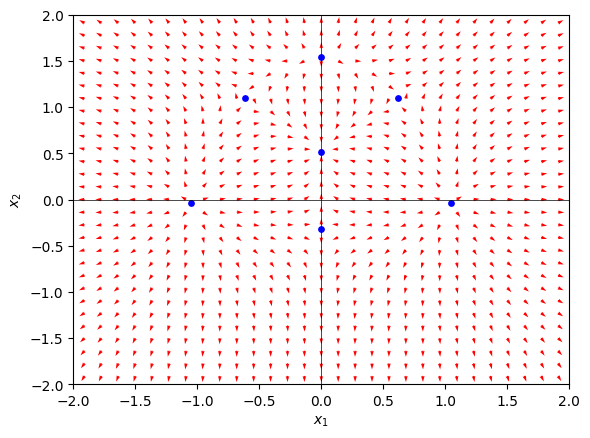

In [33]:
# Define the system of equations
Y, X = np.mgrid[-3:3:45j, -3:3:45j] 
U, V = system(0, (X, Y))

# Normalize arrows
N = np.sqrt(U**2 + V**2)
U = U / N
V = V / N

plt.quiver(X, Y, U, V, color='r')

# Highlight critical points
plt.scatter([-1.04805, 1.04805, 0, 0, 0.61727, -0.61727, 0], [-0.04209, -0.04209, 1.53708, 0.51919, 1.10273, 1.10273, -0.31582], color='blue', s=15) 

# Add axes
plt.axhline(0, color='black',linewidth=0.5)
plt.axvline(0, color='black',linewidth=0.5)

plt.xlim([-2, 2])  # x-axis limits include negative values
plt.ylim([-2, 2])  # y-axis limits include negative values
plt.xlabel('$x_{1}$')
plt.ylabel('$x_{2}$')

plt.show()

In [34]:
point = (0.1747122153123808,0.6110848307408023)
soln = solve_ivp(system, (0, 1500), (0.1747122153123808, 0.6110848307408023),dense_output=True, rtol=1e-10, atol=1e-10)
t = np.linspace(0, 1500, 100000)
x, y= soln.sol(t)
print(x[99999], y[99999])
print(is_attracted(x[99999], y[99999]))
result = (x[99999], y[99999])
print(euclidean_distance(result, attractor))
print(attractor)


1.6884143749533722e-11 0.5191867418920727
True
3.2581079273834635e-06
(0, 0.51919)


In [35]:
## Generate 10,000 uniformly sampled points in the square [-2, 2] x [-2, 2]
np.random.seed(0)
X = np.random.uniform(-1.5, 1.5, 10000)
Y = np.random.uniform(-0.5, 2, 10000)

# Create the dataset
df = pd.DataFrame(columns=['x0', 'y0', 'attracted'])
for i in tqdm(range(10000)):  # wrap range with tqdm for progress bar
    x0, y0 = X[i], Y[i]
    attracted_result = simulation(x0, y0)
    attracted_result = 1 if attracted_result else -1  # map True to 1 and False to -1
    df.loc[i] = [x0, y0, attracted_result]

# Save the DataFrame to a CSV file
df.to_csv('dataset_triplewell_general_10000.csv', index=False)


100%|██████████| 10000/10000 [31:49<00:00,  5.24it/s]


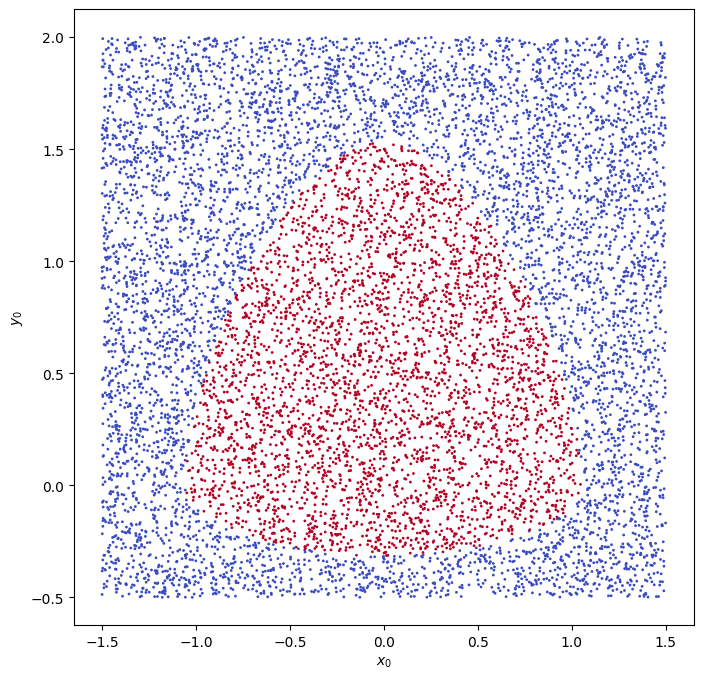

In [36]:
## Plot the sampled datapoints
df = pd.read_csv('dataset_triplewell_general_10000.csv')
plt.figure(figsize=(8, 8))
plt.scatter(df['x0'], df['y0'], c=df['attracted'], cmap='coolwarm', s=1)
plt.xlabel('$x_0$')
plt.ylabel('$y_0$')
plt.show()

In [37]:
df_data = pd.read_csv('dataset_triplewell_general_10000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(50)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(50)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'])
        a, b = bisection(a, b, delta=0.01)
        dataset_near.append([a[0], a[1], 1])
        dataset_near.append([b[0], b[1], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'attracted'])
df_near.to_csv('dataset_triplewell_near_5000_0.01.csv', index=False)

Processing df_1: 100%|██████████| 50/50 [1:09:06<00:00, 82.93s/it]


In [38]:
df_data = pd.read_csv('dataset_triplewell_general_10000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(50)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(50)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'])
        a, b = bisection(a, b, delta=0.02)
        dataset_near.append([a[0], a[1], 1])
        dataset_near.append([b[0], b[1], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'attracted'])
df_near.to_csv('dataset_triplewell_near_5000_0.02.csv', index=False)

Processing df_1: 100%|██████████| 50/50 [58:55<00:00, 70.71s/it]


In [39]:
df_data = pd.read_csv('dataset_triplewell_general_10000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(50)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(50)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'])
        a, b = bisection(a, b, delta=0.03)
        dataset_near.append([a[0], a[1], 1])
        dataset_near.append([b[0], b[1], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'attracted'])
df_near.to_csv('dataset_triplewell_near_5000_0.03.csv', index=False)

Processing df_1: 100%|██████████| 50/50 [55:52<00:00, 67.05s/it]


In [40]:
df_data = pd.read_csv('dataset_triplewell_general_10000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(50)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(50)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'])
        a, b = bisection(a, b, delta=0.04)
        dataset_near.append([a[0], a[1], 1])
        dataset_near.append([b[0], b[1], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'attracted'])
df_near.to_csv('dataset_triplewell_near_5000_0.04.csv', index=False)

Processing df_1: 100%|██████████| 50/50 [49:39<00:00, 59.59s/it]


In [41]:
df_data = pd.read_csv('dataset_triplewell_general_10000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(50)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(50)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'])
        a, b = bisection(a, b, delta=0.05)
        dataset_near.append([a[0], a[1], 1])
        dataset_near.append([b[0], b[1], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'attracted'])
df_near.to_csv('dataset_triplewell_near_5000_0.05.csv', index=False)

Processing df_1: 100%|██████████| 50/50 [45:27<00:00, 54.55s/it]


In [42]:
df_data = pd.read_csv('dataset_triplewell_general_10000.csv')

df_data_1 = df_data[df_data['attracted'] == 1].sample(50)
df_data_n1 = df_data[df_data['attracted'] == -1].sample(50)

dataset_near = []
for i in tqdm(range(len(df_data_1)), desc="Processing df_1"):
    for j in range(len(df_data_n1)):
        a = (df_data_1.iloc[i]['x0'], df_data_1.iloc[i]['y0'])
        b = (df_data_n1.iloc[j]['x0'], df_data_n1.iloc[j]['y0'])
        a, b = bisection(a, b, delta=0.1)
        dataset_near.append([a[0], a[1], 1])
        dataset_near.append([b[0], b[1], -1])

df_near = pd.DataFrame(dataset_near, columns=['x0', 'y0', 'attracted'])
df_near.to_csv('dataset_triplewell_near_5000_0.1.csv', index=False)

Processing df_1: 100%|██████████| 50/50 [36:11<00:00, 43.43s/it]


In [43]:
class SystemDataset(Dataset):
    def __init__(self, csv_file):
        self.data = pd.read_csv(csv_file)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        x = torch.from_numpy(self.data.iloc[idx, 0:2].values).float()
        y = torch.tensor(self.data.iloc[idx, 2]).float()
        return x, y

In [44]:
'''
dataset_train: uniformly sampled 200 points
dataset_validation_uniform: uniformly sampled 1,000 points
dataset_test_uniform: uniformly sampled 1,000 points
dataset_validation_near: 1,000 points near the boundary
dataset_test_near: 1,000 points near the boundary
Each dataset above are mutually independent
'''

def filter_points_within_bounds(df, x_bounds=(-1.5, 1.5), y_bounds=(-0.5, 2)):
    # Filter the DataFrame to include only points within the specified bounds
    within_bounds = (df['x0'] >= x_bounds[0]) & (df['x0'] <= x_bounds[1]) & \
                    (df['y0'] >= y_bounds[0]) & (df['y0'] <= y_bounds[1])
    filtered_df = df[within_bounds]
    return filtered_df




df_uniform = pd.read_csv('dataset_triplewell_general_10000.csv')
df_uniform = filter_points_within_bounds(df_uniform)
df_uniform_train = df_uniform.sample(n=200)
remaining_df = df_uniform.drop(df_uniform_train.index)
df_uniform_validation = remaining_df.sample(n=1000)
remaining_df = remaining_df.drop(df_uniform_validation.index)
df_uniform_test = remaining_df.sample(n=1000)

df_001 = pd.read_csv('dataset_triplewell_near_5000_0.01.csv')
df_001 = filter_points_within_bounds(df_001)
df_001_validation = df_001.sample(n=1000)
remaining_df = df_001.drop(df_001_validation.index)
df_001_test = remaining_df.sample(n=1000)

df_002 = pd.read_csv('dataset_triplewell_near_5000_0.02.csv')
df_002 = filter_points_within_bounds(df_002)
df_002_validation = df_002.sample(n=1000)
remaining_df = df_002.drop(df_002_validation.index)
df_002_test = remaining_df.sample(n=1000)

df_003 = pd.read_csv('dataset_triplewell_near_5000_0.03.csv')
df_003 = filter_points_within_bounds(df_003)
df_003_validation = df_003.sample(n=1000)
remaining_df = df_003.drop(df_003_validation.index)
df_003_test = remaining_df.sample(n=1000)

df_004 = pd.read_csv('dataset_triplewell_near_5000_0.04.csv')
df_004 = filter_points_within_bounds(df_004)
df_004_validation = df_004.sample(n=1000)
remaining_df = df_004.drop(df_004_validation.index)
df_004_test = remaining_df.sample(n=1000)

df_005 = pd.read_csv('dataset_triplewell_near_5000_0.05.csv')
df_005 = filter_points_within_bounds(df_005)
df_005_validation = df_005.sample(n=1000)
remaining_df = df_005.drop(df_005_validation.index)
df_005_test = remaining_df.sample(n=1000)

df_010 = pd.read_csv('dataset_triplewell_near_5000_0.1.csv')
df_010 = filter_points_within_bounds(df_010)
df_010_validation = df_010.sample(n=1000)
remaining_df = df_010.drop(df_010_validation.index)
df_010_test = remaining_df.sample(n=1000)


dataset_train = SystemDataset('dataset_doublewell_general_100000.csv')
dataset_train.data = df_uniform_train

dataset_validation_uniform = SystemDataset('dataset_doublewell_general_100000.csv')
dataset_validation_uniform.data = df_uniform_validation

dataset_test_uniform = SystemDataset('dataset_doublewell_general_100000.csv')
dataset_test_uniform.data = df_uniform_test

dataset_validation_near_001 = SystemDataset('dataset_doublewell_near_5000_0.01.csv')
dataset_validation_near_001.data = df_001_validation
dataset_test_near_001 = SystemDataset('dataset_doublewell_near_5000_0.01.csv')
dataset_test_near_001.data = df_001_test

dataset_validation_near_002 = SystemDataset('dataset_doublewell_near_5000_0.02.csv')
dataset_validation_near_002.data = df_002_validation
dataset_test_near_002 = SystemDataset('dataset_doublewell_near_5000_0.02.csv')
dataset_test_near_002.data = df_002_test

dataset_validation_near_003 = SystemDataset('dataset_doublewell_near_5000_0.03.csv')
dataset_validation_near_003.data = df_003_validation
dataset_test_near_003 = SystemDataset('dataset_doublewell_near_5000_0.03.csv')
dataset_test_near_003.data = df_003_test

dataset_validation_near_004 = SystemDataset('dataset_doublewell_near_5000_0.04.csv')
dataset_validation_near_004.data = df_004_validation
dataset_test_near_004 = SystemDataset('dataset_doublewell_near_5000_0.04.csv')
dataset_test_near_004.data = df_004_test

dataset_validation_near_005 = SystemDataset('dataset_doublewell_near_5000_0.05.csv')
dataset_validation_near_005.data = df_005_validation
dataset_test_near_005 = SystemDataset('dataset_doublewell_near_5000_0.05.csv')
dataset_test_near_005.data = df_005_test

dataset_validation_near_010 = SystemDataset('dataset_doublewell_near_5000_0.1.csv')
dataset_validation_near_010.data = df_010_validation
dataset_test_near_010 = SystemDataset('dataset_doublewell_near_5000_0.1.csv')
dataset_test_near_010.data = df_010_test

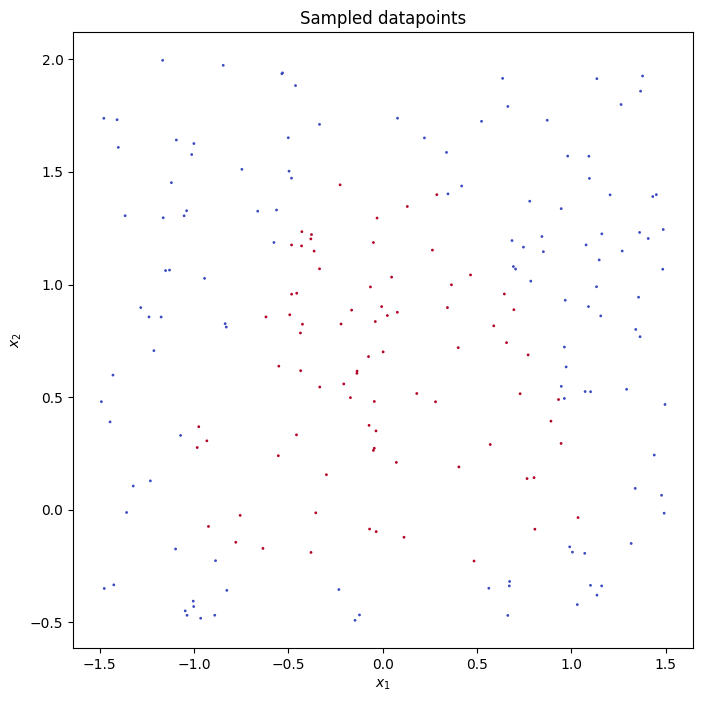

In [45]:
plt.figure(figsize=(8, 8))
plt.scatter(df_uniform_train['x0'], df_uniform_train['y0'], c=df_uniform_train['attracted'], cmap='coolwarm', s=1)
plt.xlabel('$x_1$')
plt.ylabel('$x_2$')
plt.title('Sampled datapoints')
plt.show()

In [46]:
## Define the neural network. The complexity of the network is a hyperparameter.
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.fc1 = nn.Linear(2, 16)
        self.fc2 = nn.Linear(16, 16)
        self.fc3 = nn.Linear(16, 1)

        #self.bn1 = nn.BatchNorm1d(32)
        #self.bn2 = nn.BatchNorm1d(32)
        #self.bn3 = nn.BatchNorm1d(32)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        #x = self.bn1(x)
        x = torch.relu(self.fc2(x))
        #x = self.bn2(x)
        x = self.fc3(x)
        #x = self.bn3(x)
        return x

In [47]:
def train_model_bce(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002, dataset_validation003,
                    dataset_validation004, dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion = nn.BCEWithLogitsLoss()
    #optimizer = optim.Adam(net.parameters(), lr=lr)
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)
    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []

    training_loss_over_epochs = []
    validation1_loss_over_epochs = []
    validation001_loss_over_epochs = []
    validation002_loss_over_epochs = []
    validation003_loss_over_epochs = []
    validation004_loss_over_epochs = []
    validation005_loss_over_epochs = []
    validation010_loss_over_epochs = []
    
    # Set up the overall progress bar
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train = 0
        for features, labels in dataloader_train:
            labels = ((labels + 1) / 2).float()
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = (outputs > 0).float()
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)
            loss = criterion(outputs, labels)
            avg_loss_train += loss.item()
            loss.backward()
            optimizer.step()
                    
        training_accuracy = correct_train / total_train
        training_loss = avg_loss_train / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_over_epochs.append(training_loss)

        
        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation1:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation1 += (predicted == labels).sum().item()
                total_validation1 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation1 += loss.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss = avg_loss_validation1 / len(dataloader_validation1)
        validation1_loss_over_epochs.append(validation1_loss)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation001:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation001 += (predicted == labels).sum().item()
                total_validation001 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation001 += loss.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss = avg_loss_validation001 / len(dataloader_validation001)
        validation001_loss_over_epochs.append(validation001_loss)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation002:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation002 += (predicted == labels).sum().item()
                total_validation002 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation002 += loss.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss = avg_loss_validation002 / len(dataloader_validation002)
        validation002_loss_over_epochs.append(validation002_loss)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation003:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation003 += (predicted == labels).sum().item()
                total_validation003 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation003 += loss.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss = avg_loss_validation003 / len(dataloader_validation003)
        validation003_loss_over_epochs.append(validation003_loss)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation004:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation004 += (predicted == labels).sum().item()
                total_validation004 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation004 += loss.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss = avg_loss_validation004 / len(dataloader_validation004)
        validation004_loss_over_epochs.append(validation004_loss)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation005:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation005 += (predicted == labels).sum().item()
                total_validation005 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation005 += loss.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss = avg_loss_validation005 / len(dataloader_validation005)
        validation005_loss_over_epochs.append(validation005_loss)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation010:
                labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = (outputs > 0).float()
                correct_validation010 += (predicted == labels).sum().item()
                total_validation010 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation010 += loss.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss = avg_loss_validation010 / len(dataloader_validation010)
        validation010_loss_over_epochs.append(validation010_loss)
        
        # Update the overall progress bar after each epoch
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy, 
                                      'Validation1 Accuracy': validation1_accuracy, 
                                      'Validation001 Accuracy': validation001_accuracy, 
                                      'Validation002 Accuracy': validation002_accuracy, 
                                      'Validation003 Accuracy': validation003_accuracy, 
                                      'Validation004 Accuracy': validation004_accuracy, 
                                      'Validation005 Accuracy': validation005_accuracy, 
                                      'Validation010 Accuracy': validation010_accuracy})
    
    overall_progress.close()
    
    # Plot training and validation accuracy over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    # Plot training and validation loss over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_over_epochs, label='Training')
    plt.plot(validation1_loss_over_epochs, label='Uniform')
    plt.plot(validation001_loss_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()
    
    test_model(net, dataset_train)
    test_model(net, dataset_validation001)
    test_model(net, dataset_validation002)
    test_model(net, dataset_validation003)
    test_model(net, dataset_validation004)
    test_model(net, dataset_validation005)
    test_model(net, dataset_validation010)

In [48]:
def test_model(net, dataset_test):
    net.eval()
    dataloader_test = DataLoader(dataset_test, batch_size=32, shuffle=False)
    features_list = []
    labels_list = []
    probability_list = []
    predictions_list = []
    acc = Accuracy(task = 'binary')

    with torch.no_grad():
        for features, labels in dataloader_test:
            labels = ((labels + 1) / 2).float()
            probability = net(features)
            outputs = (probability > 0).float()
            outputs = outputs.squeeze()

            acc.update(outputs, labels)

            features_list.append(features.numpy())
            labels_list.append(labels.numpy())
            probability_list.append(probability.numpy())
            predictions_list.append(outputs.numpy())
    accuracy = acc.compute()
    print(f'Accuracy: {accuracy}')

    # Concatenate all batches
    features = np.concatenate(features_list, axis=0)
    labels = np.concatenate(labels_list, axis=0)
    probability = np.concatenate(probability_list, axis=0)
    predictions = np.concatenate(predictions_list, axis=0)

    # Create a 2D scatter plot
    fig = plt.figure()
    ax = fig.add_subplot(111)

    # Plot the features colored by the predictions
    scatter = ax.scatter(features[:, 0], features[:, 1], c=probability, cmap='coolwarm', vmin=-np.max(np.abs(probability)), vmax=np.max(np.abs(probability)))

    plt.colorbar(scatter)
    plt.xlim([-1.5, 1.5])
    plt.ylim([-0.5, 2])

    plt.show()

    plt.hist(probability, bins=20)
    plt.show()
    return accuracy

Overall Training Progress: 100%|██████████| 1000/1000 [05:23<00:00,  3.09it/s, Training Accuracy=1, Validation1 Accuracy=0.97, Validation001 Accuracy=0.582, Validation002 Accuracy=0.609, Validation003 Accuracy=0.684, Validation004 Accuracy=0.674, Validation005 Accuracy=0.709, Validation010 Accuracy=0.802]    


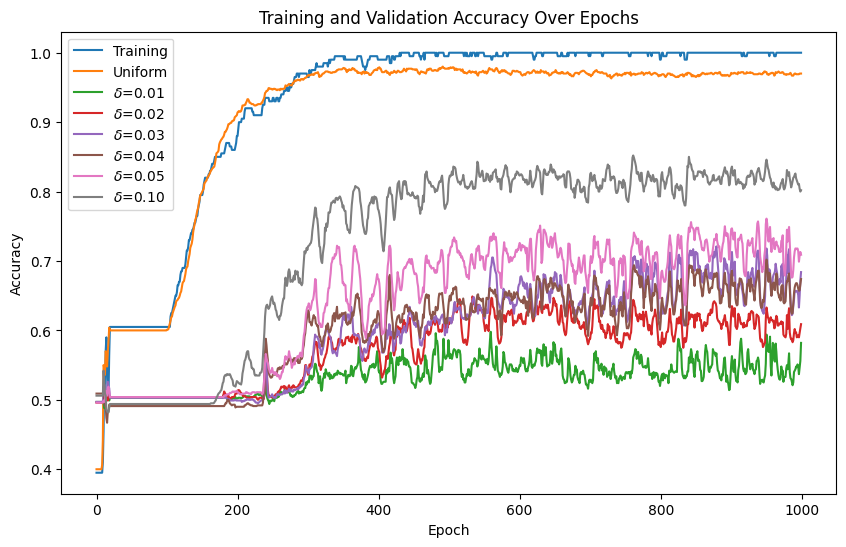

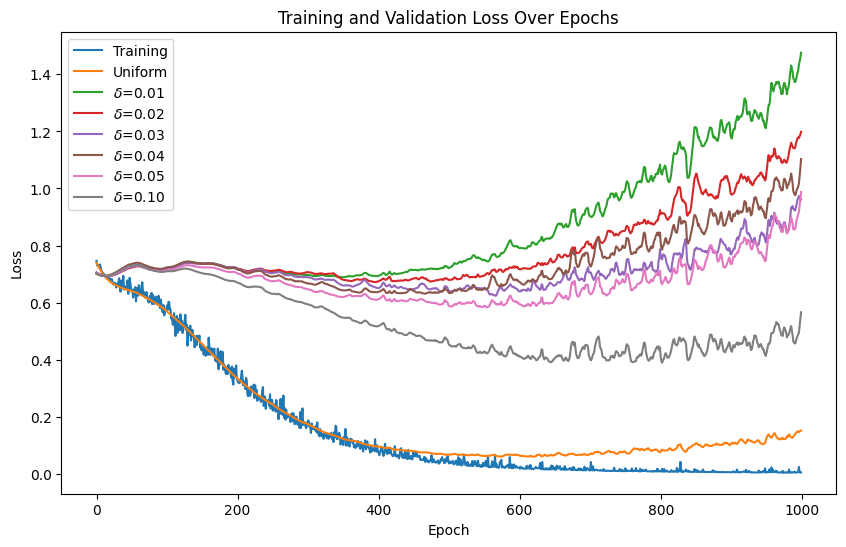

Accuracy: 1.0


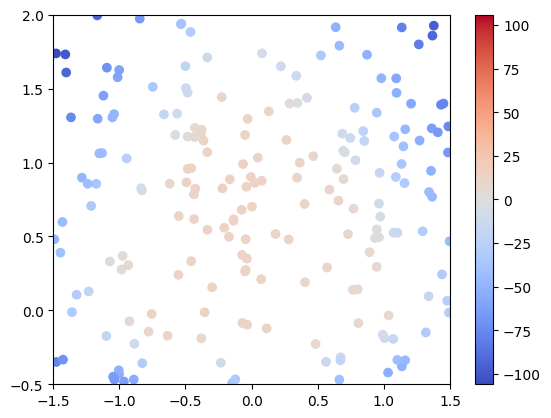

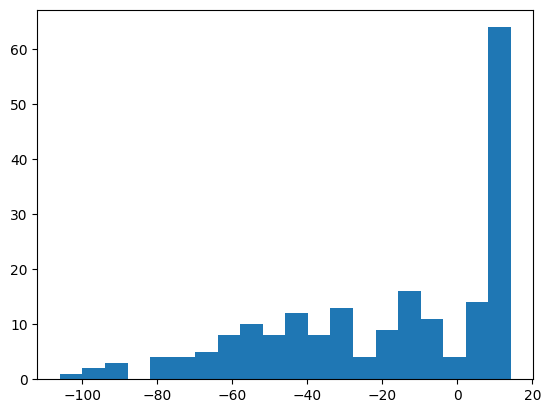

Accuracy: 0.5820000171661377


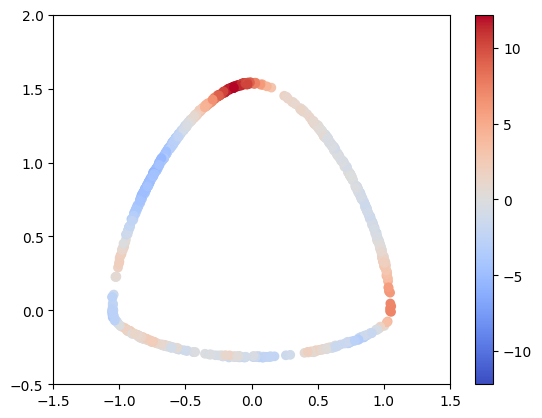

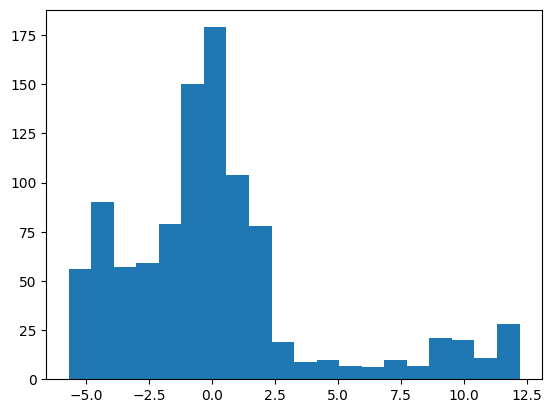

Accuracy: 0.609000027179718


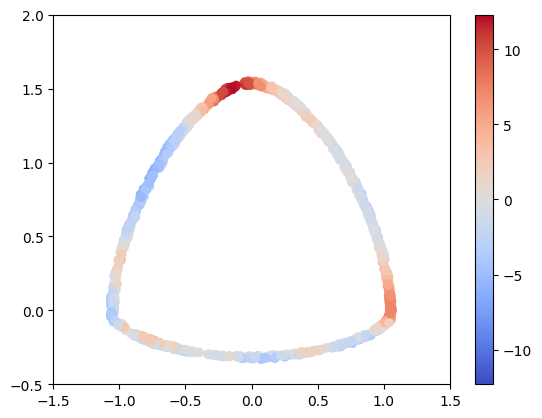

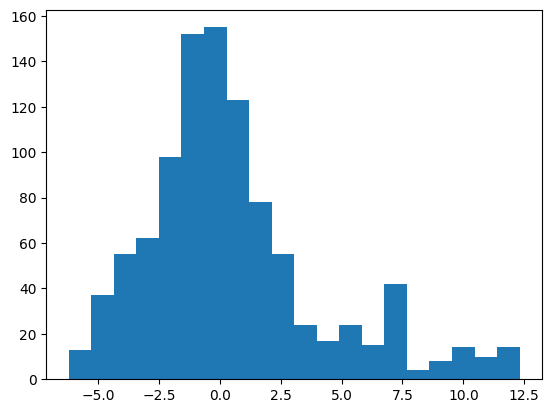

Accuracy: 0.6840000152587891


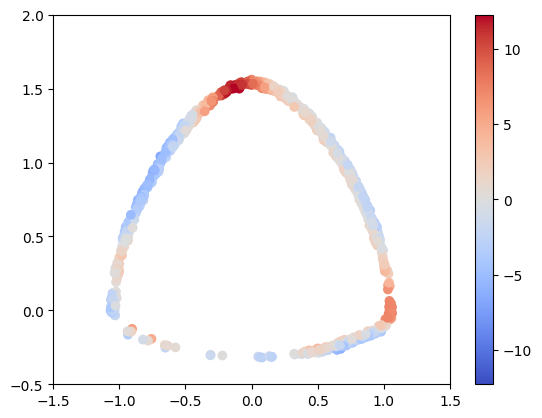

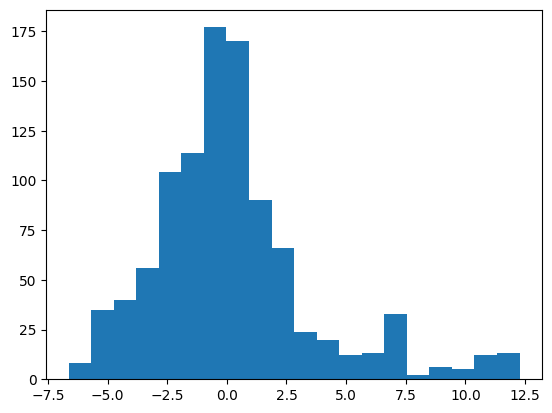

Accuracy: 0.6740000247955322


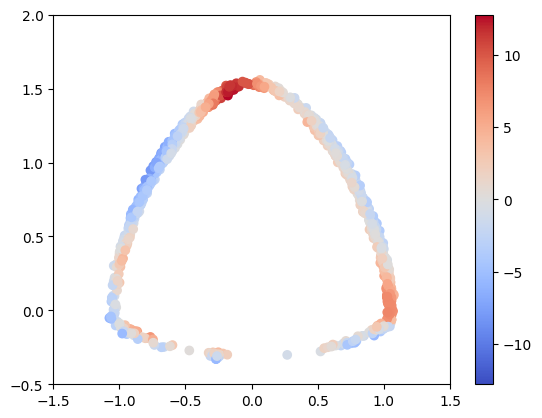

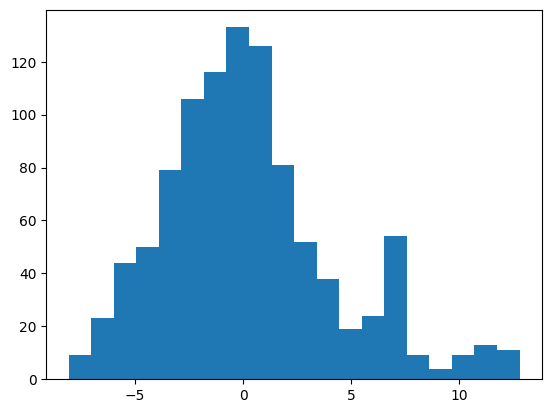

Accuracy: 0.7089999914169312


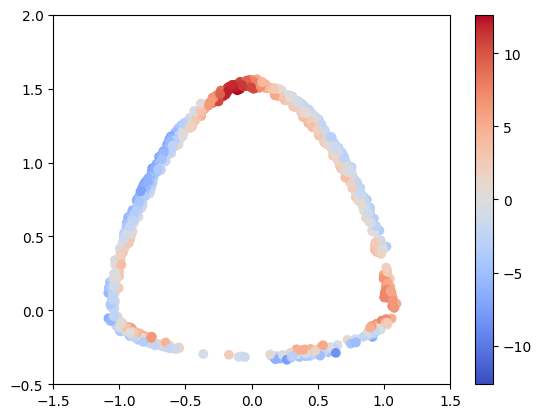

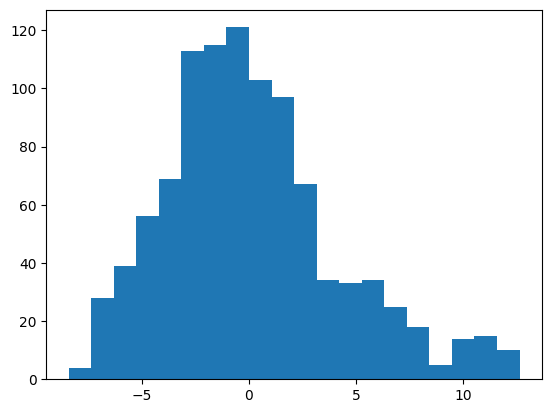

Accuracy: 0.8019999861717224


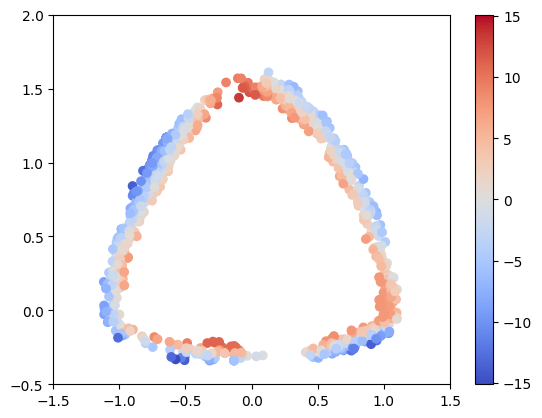

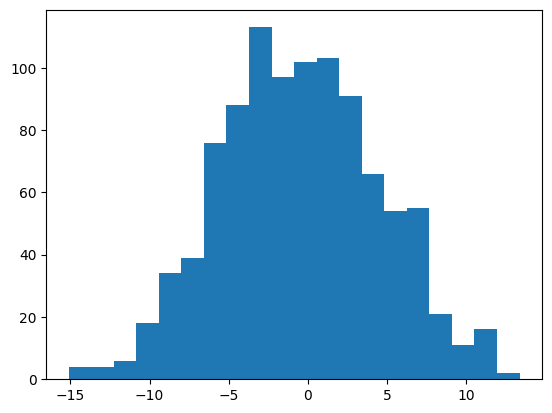

In [49]:
net_1 = Net()
train_model_bce(net_1, dataset_train, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1000, lr=0.0005)

Accuracy: 0.9829999804496765


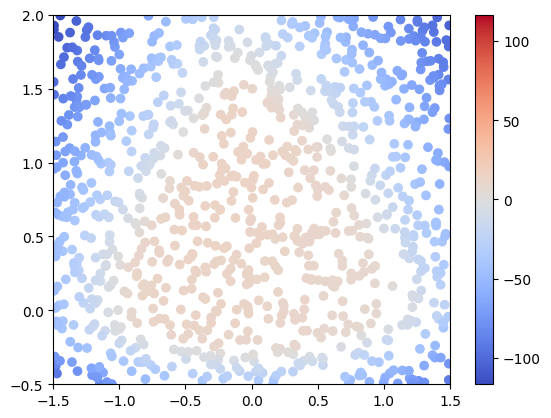

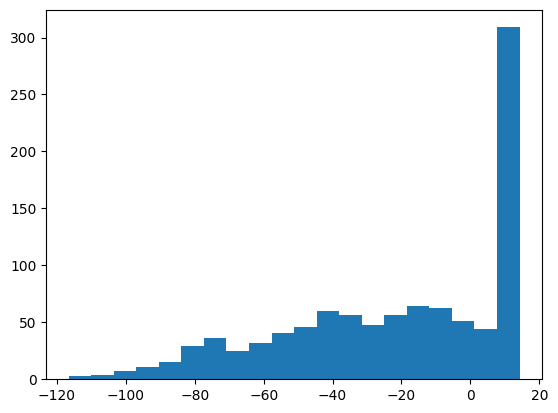

tensor(0.9830)

In [50]:
test_model(net_1, dataset_test_uniform)

Accuracy: 0.5490000247955322


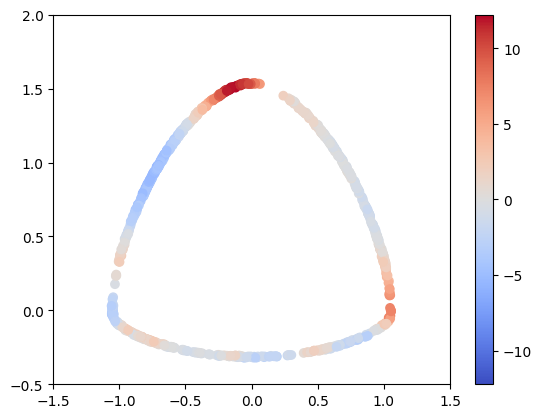

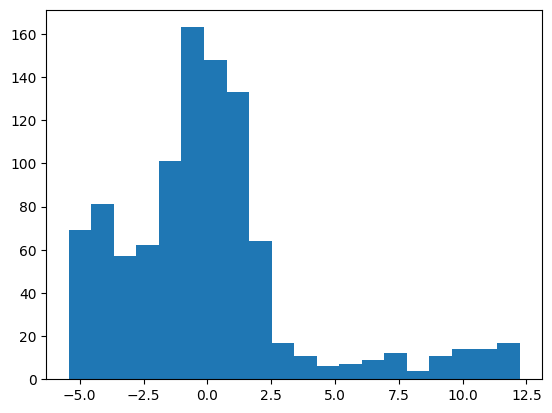

tensor(0.5490)

In [51]:
test_model(net_1, dataset_test_near_001)

Accuracy: 0.6010000109672546


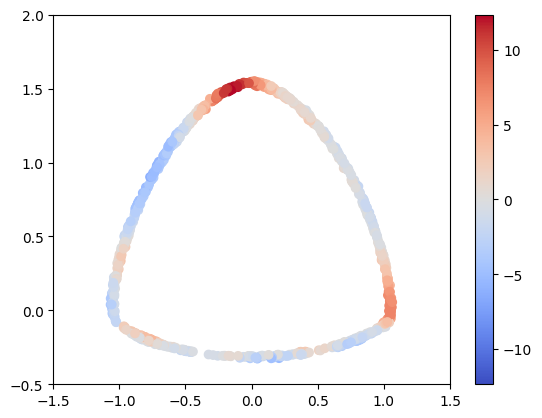

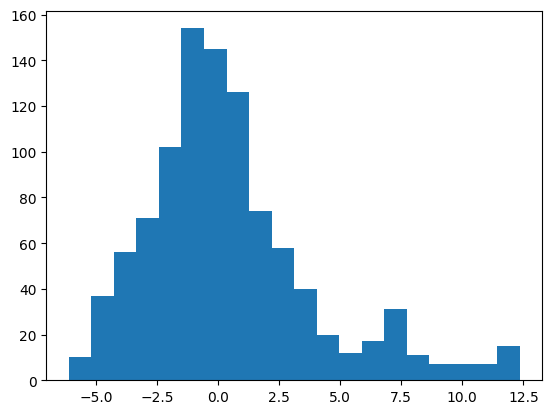

tensor(0.6010)

In [52]:
test_model(net_1, dataset_test_near_002)

Accuracy: 0.6660000085830688


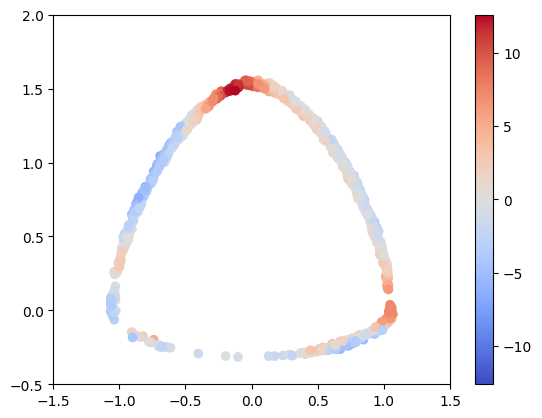

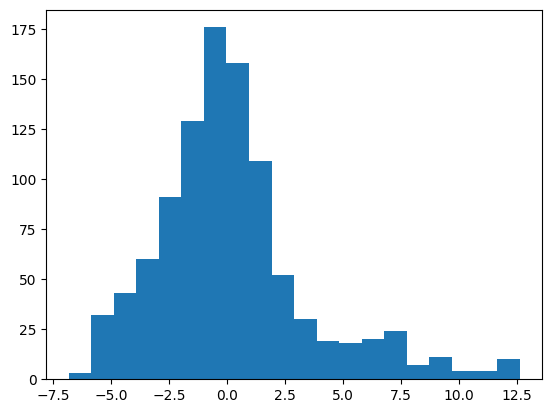

tensor(0.6660)

In [53]:
test_model(net_1, dataset_test_near_003)

Accuracy: 0.7070000171661377


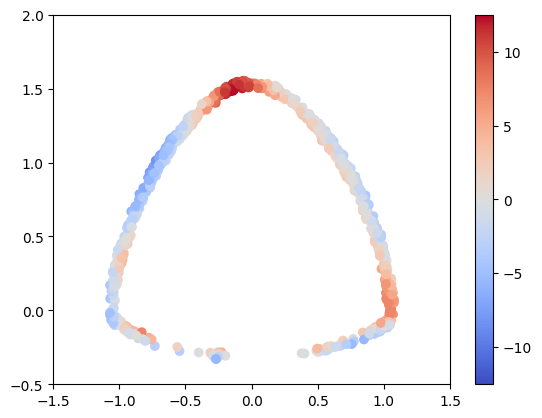

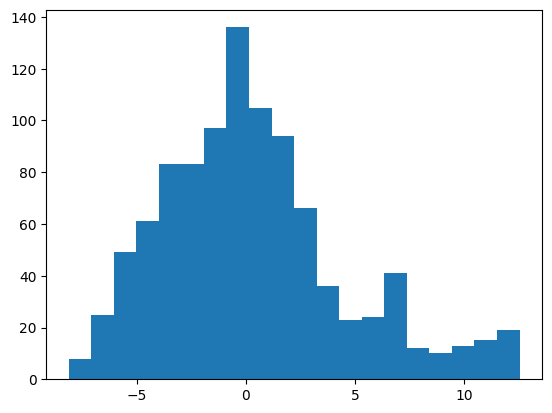

tensor(0.7070)

In [54]:
test_model(net_1, dataset_test_near_004)

Accuracy: 0.7099999785423279


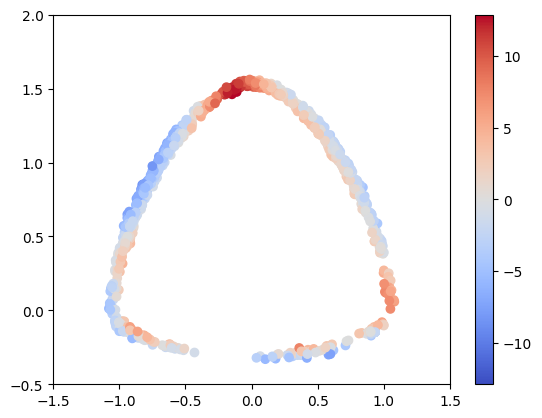

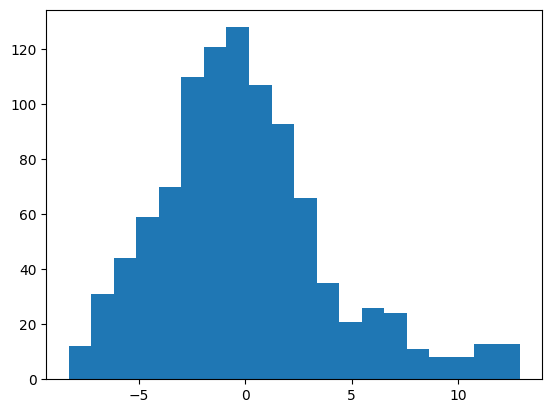

tensor(0.7100)

In [55]:
test_model(net_1, dataset_test_near_005)

Accuracy: 0.8240000009536743


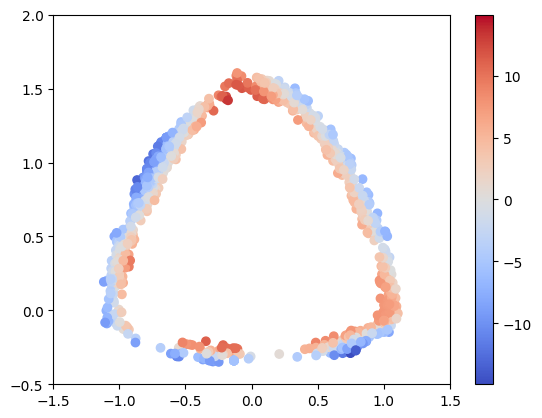

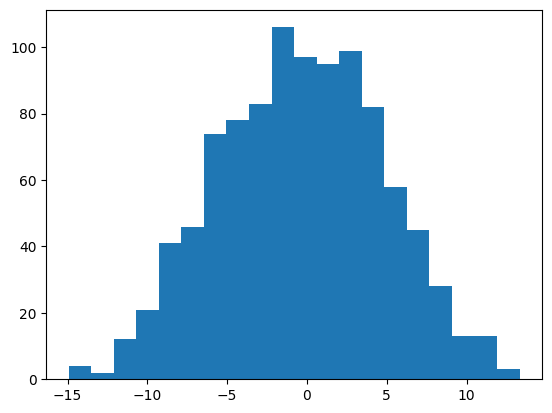

tensor(0.8240)

In [56]:
test_model(net_1, dataset_test_near_010)

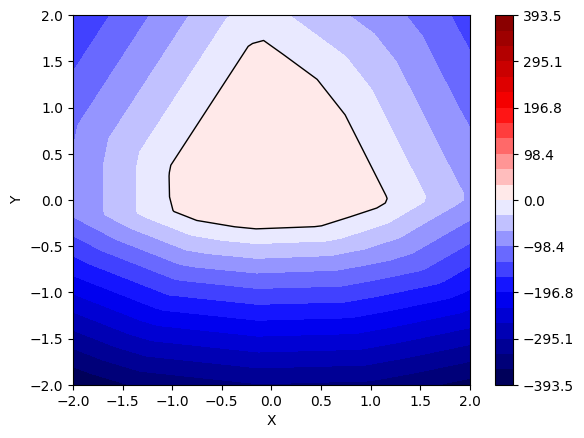

In [57]:
def plot_contour(net):
    x_min, x_max = -2, 2
    y_min, y_max = -2, 2
    resolution = 2000
    x_range = np.linspace(x_min, x_max, resolution)
    y_range = np.linspace(y_min, y_max, resolution)
    xx, yy = np.meshgrid(x_range, y_range)
    grid_points = np.c_[xx.ravel(), yy.ravel()]
    grid_points_tensor = torch.tensor(grid_points, dtype=torch.float)
    
    with torch.no_grad():
        predictions = net(grid_points_tensor).numpy()
    
    predictions_reshaped = predictions.reshape(xx.shape)
    
    # Ensure the color scale is centered around 0
    vmin = -max(abs(predictions_reshaped.min()), abs(predictions_reshaped.max()))
    vmax = max(abs(predictions_reshaped.min()), abs(predictions_reshaped.max()))
    
    plt.contourf(xx, yy, predictions_reshaped, levels=np.linspace(vmin, vmax, 25), cmap='seismic', vmin=vmin, vmax=vmax)
    plt.colorbar()

    # Draw the decision boundary (contour line at level 0)
    plt.contour(xx, yy, predictions_reshaped, levels=[0], colors='black', linewidths=1)

    plt.xlabel("X")
    plt.ylabel("Y")
    plt.show()

plot_contour(net_1)

In [58]:
class HingeLoss(nn.Module):
    def __init__(self):
        super(HingeLoss, self).__init__()
    
    def forward(self, y_pred, y_true):
        loss = nn.functional.relu(1-y_true * y_pred)
        mean_loss = torch.mean(loss)
        return mean_loss
    
class QuadraticHingeLoss(nn.Module):
    def __init__(self):
        super(QuadraticHingeLoss, self).__init__()

    def forward(self, y_pred, y_true):
        loss = nn.functional.relu(1-y_true * y_pred) ** 2
        mean_loss = torch.mean(loss)
        return mean_loss

In [59]:
def train_model_hinge(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                      dataset_validation003, dataset_validation004, dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion = HingeLoss()
    #optimizer = optim.Adam(net.parameters(), lr=lr)
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)

    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []
    training_loss_over_epochs = []
    validation1_loss_over_epochs = []
    validation001_loss_over_epochs = []
    validation002_loss_over_epochs = []
    validation003_loss_over_epochs = []
    validation004_loss_over_epochs = []
    validation005_loss_over_epochs = []
    validation010_loss_over_epochs = []
    
    # Set up the overall progress bar
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train = 0
        for features, labels in dataloader_train:
            #labels = ((labels + 1) / 2).float()
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)
            loss = criterion(outputs, labels)
            avg_loss_train += loss.item()
            loss.backward()
            optimizer.step()
                    
        training_accuracy = correct_train / total_train
        training_loss = avg_loss_train / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_over_epochs.append(training_loss)

        
        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation1:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation1 += (predicted == labels).sum().item()
                total_validation1 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation1 += loss.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss = avg_loss_validation1 / len(dataloader_validation1)
        validation1_loss_over_epochs.append(validation1_loss)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation001:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation001 += (predicted == labels).sum().item()
                total_validation001 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation001 += loss.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss = avg_loss_validation001 / len(dataloader_validation001)
        validation001_loss_over_epochs.append(validation001_loss)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation002:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation002 += (predicted == labels).sum().item()
                total_validation002 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation002 += loss.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss = avg_loss_validation002 / len(dataloader_validation002)
        validation002_loss_over_epochs.append(validation002_loss)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation003:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation003 += (predicted == labels).sum().item()
                total_validation003 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation003 += loss.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss = avg_loss_validation003 / len(dataloader_validation003)
        validation003_loss_over_epochs.append(validation003_loss)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation004:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation004 += (predicted == labels).sum().item()
                total_validation004 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation004 += loss.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss = avg_loss_validation004 / len(dataloader_validation004)
        validation004_loss_over_epochs.append(validation004_loss)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation005:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation005 += (predicted == labels).sum().item()
                total_validation005 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation005 += loss.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss = avg_loss_validation005 / len(dataloader_validation005)
        validation005_loss_over_epochs.append(validation005_loss)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation010:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation010 += (predicted == labels).sum().item()
                total_validation010 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation010 += loss.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss = avg_loss_validation010 / len(dataloader_validation010)
        validation010_loss_over_epochs.append(validation010_loss)
        
        # Update the overall progress bar after each epoch
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy,
                                       'Validation1 Accuracy': validation1_accuracy,
                                        'Validation001 Accuracy': validation001_accuracy, 
                                        'Validation002 Accuracy': validation002_accuracy, 
                                        'Validation003 Accuracy': validation003_accuracy, 
                                        'Validation004 Accuracy': validation004_accuracy, 
                                        'Validation005 Accuracy': validation005_accuracy, 
                                        'Validation010 Accuracy': validation010_accuracy})
    
    overall_progress.close()
    
    # Plot training and validation accuracy over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    # Plot training and validation loss over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_over_epochs, label='Training')
    plt.plot(validation1_loss_over_epochs, label='Uniform')
    plt.plot(validation001_loss_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()
    
    test_model(net, dataset_train)
    test_model(net, dataset_validation1)
    test_model(net, dataset_validation001)
    test_model(net, dataset_validation002)
    test_model(net, dataset_validation003)
    test_model(net, dataset_validation004)
    test_model(net, dataset_validation005)
    test_model(net, dataset_validation010)

Overall Training Progress: 100%|██████████| 1000/1000 [05:06<00:00,  3.26it/s, Training Accuracy=1, Validation1 Accuracy=0.97, Validation001 Accuracy=0.548, Validation002 Accuracy=0.567, Validation003 Accuracy=0.592, Validation004 Accuracy=0.648, Validation005 Accuracy=0.682, Validation010 Accuracy=0.777]    


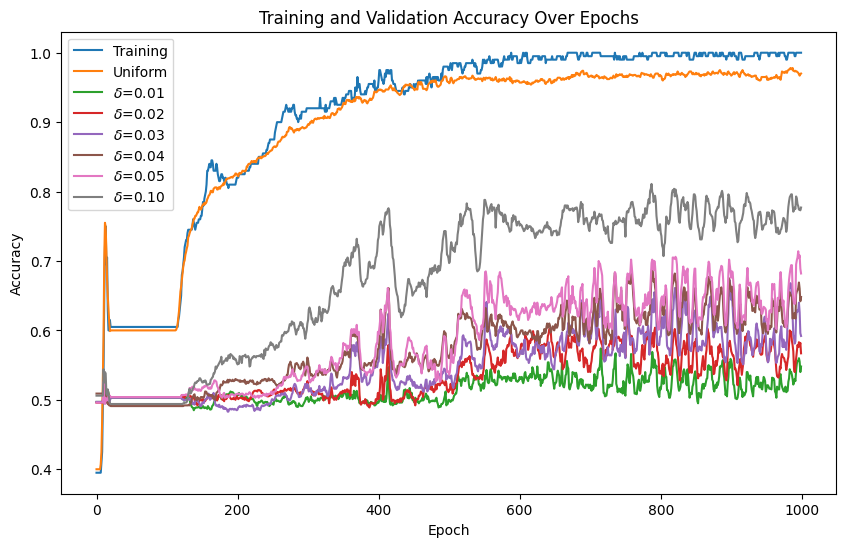

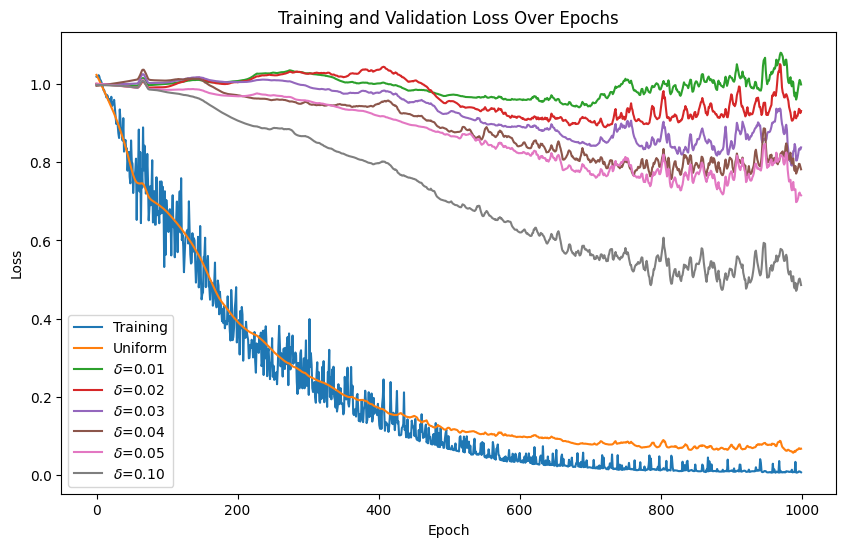

Accuracy: 1.0


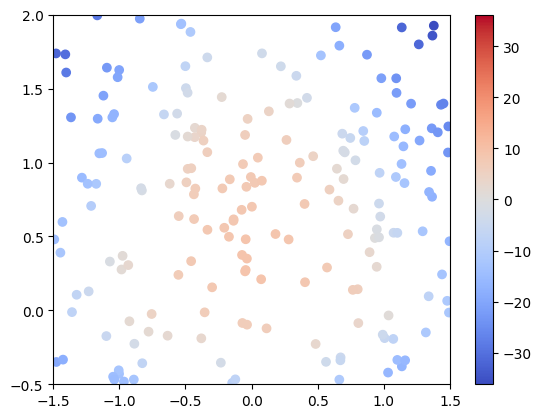

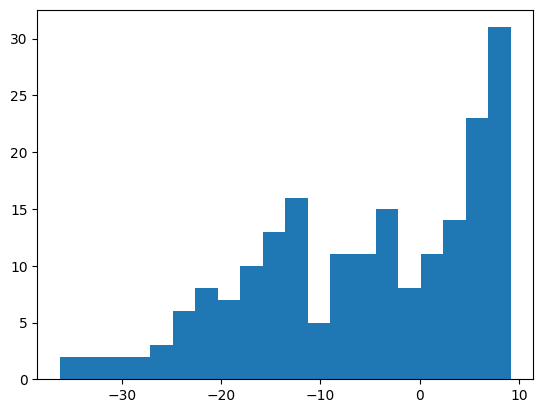

Accuracy: 0.9700000286102295


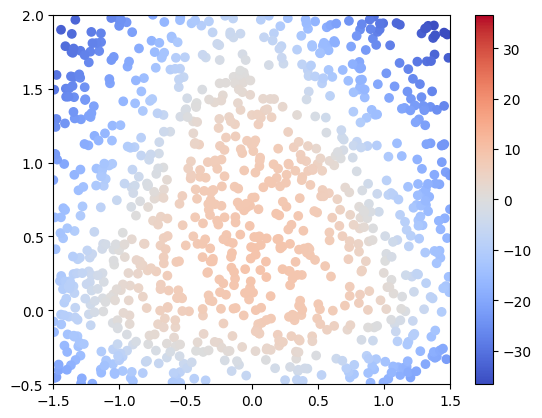

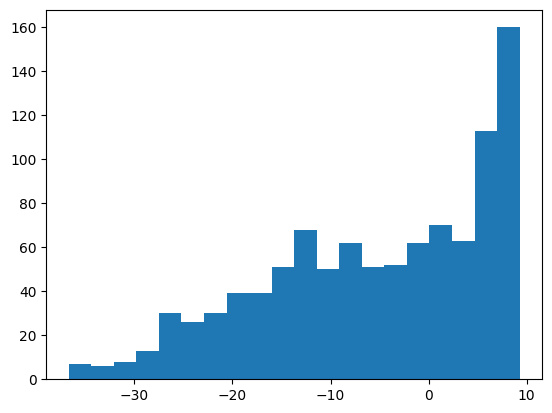

Accuracy: 0.5479999780654907


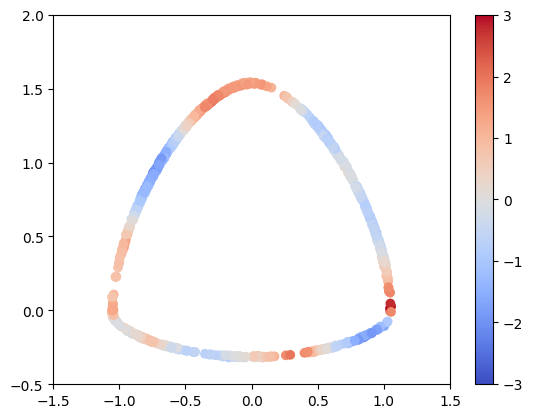

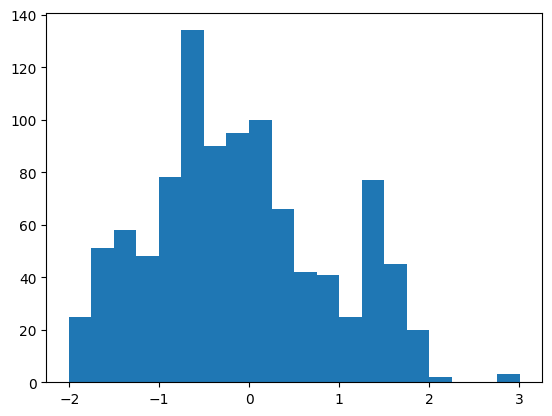

Accuracy: 0.5669999718666077


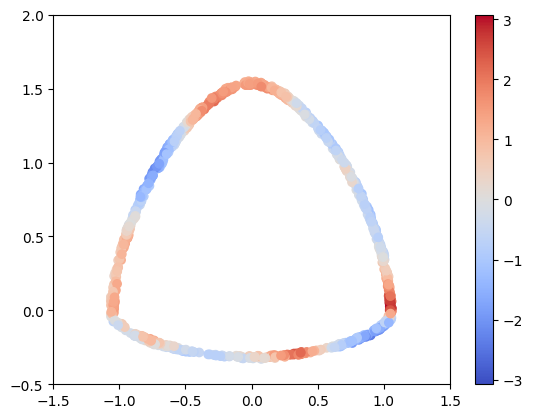

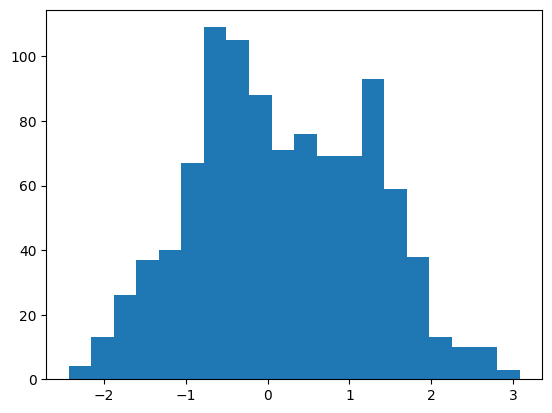

Accuracy: 0.5920000076293945


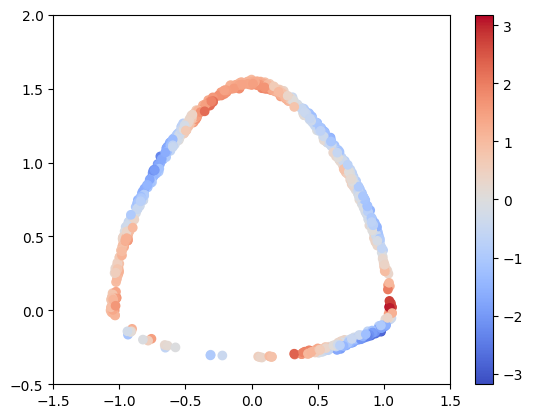

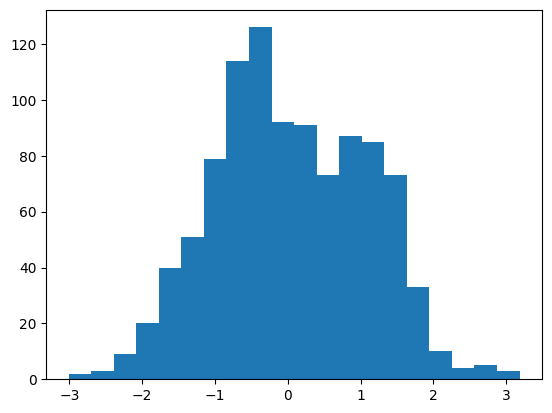

Accuracy: 0.6480000019073486


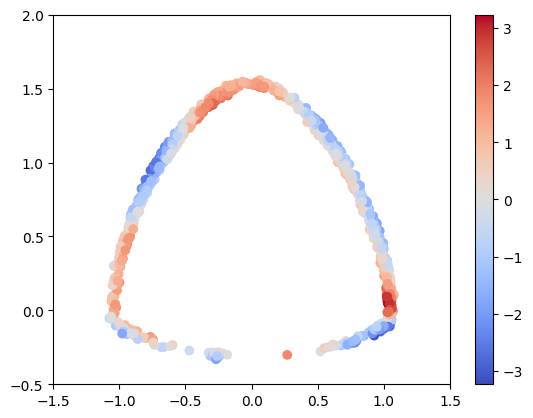

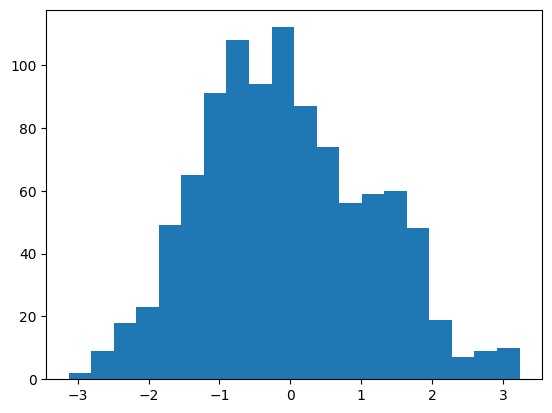

Accuracy: 0.6819999814033508


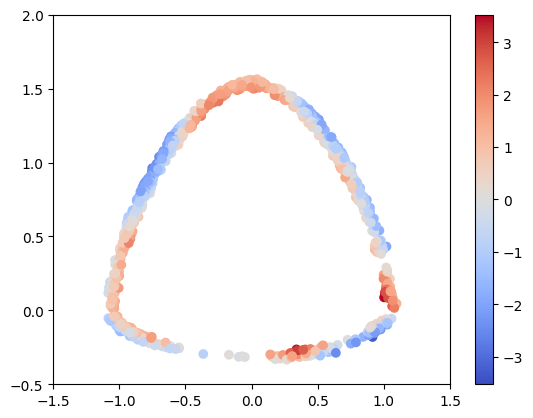

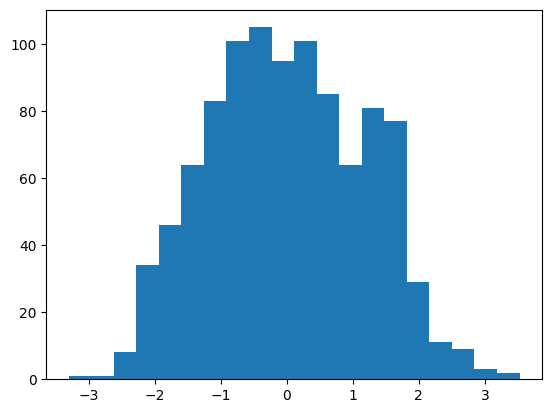

Accuracy: 0.7770000100135803


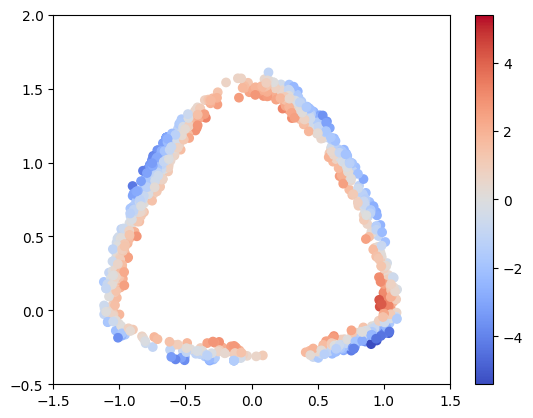

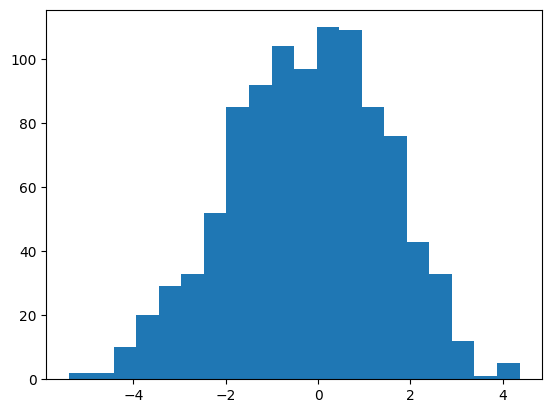

In [60]:
net_hinge = Net()
train_model_hinge(net_hinge, dataset_train, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1000, lr=0.0005)

Accuracy: 0.9869999885559082


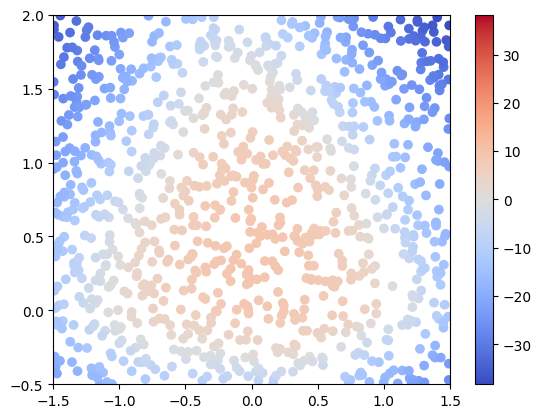

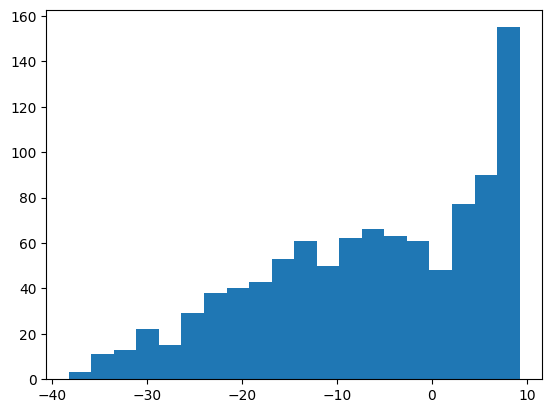

tensor(0.9870)

In [61]:
test_model(net_hinge, dataset_test_uniform)

Accuracy: 0.531000018119812


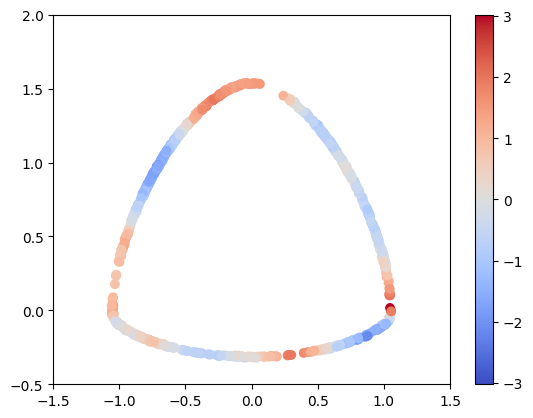

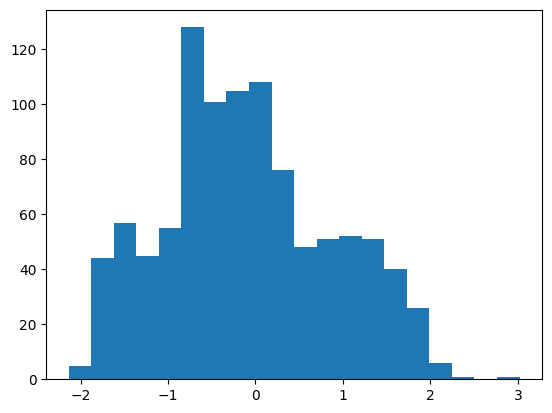

tensor(0.5310)

In [62]:
test_model(net_hinge, dataset_test_near_001)

Accuracy: 0.5600000023841858


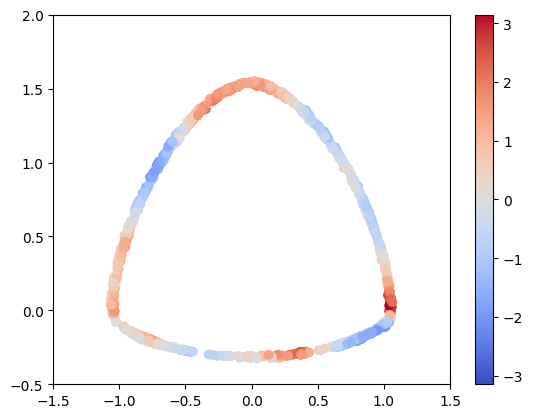

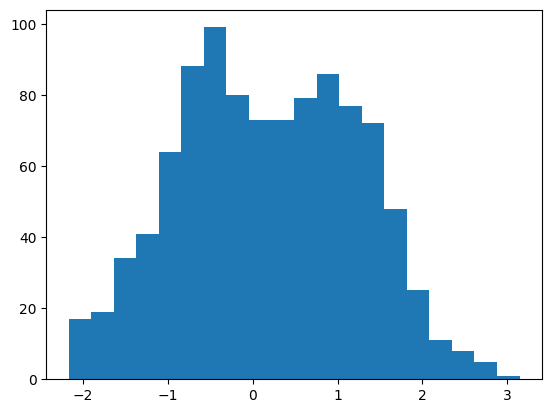

tensor(0.5600)

In [63]:
test_model(net_hinge, dataset_test_near_002)

Accuracy: 0.6119999885559082


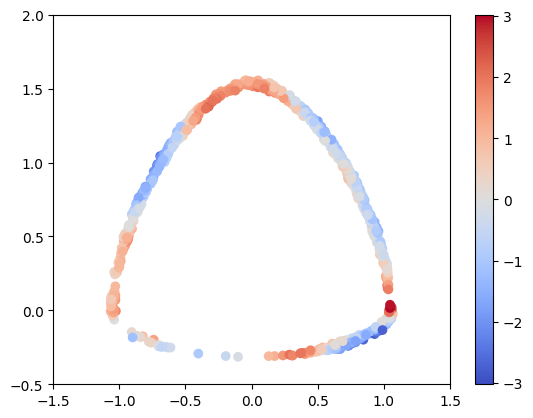

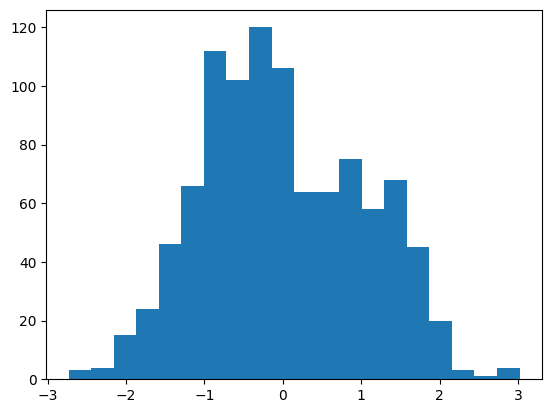

tensor(0.6120)

In [64]:
test_model(net_hinge, dataset_test_near_003)

Accuracy: 0.6449999809265137


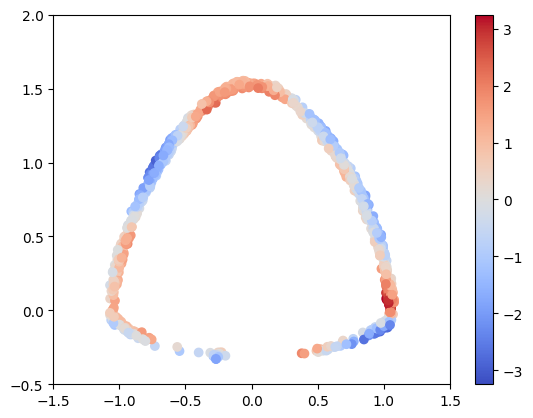

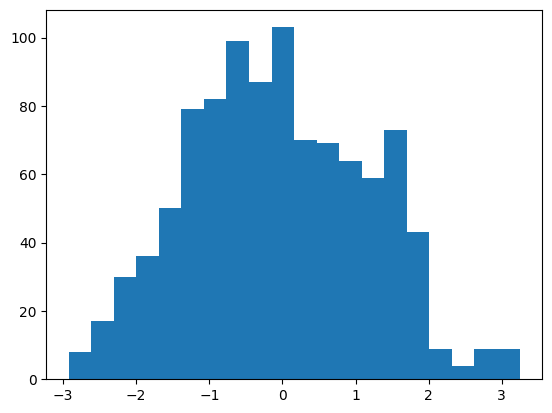

tensor(0.6450)

In [65]:
test_model(net_hinge, dataset_test_near_004)

Accuracy: 0.6800000071525574


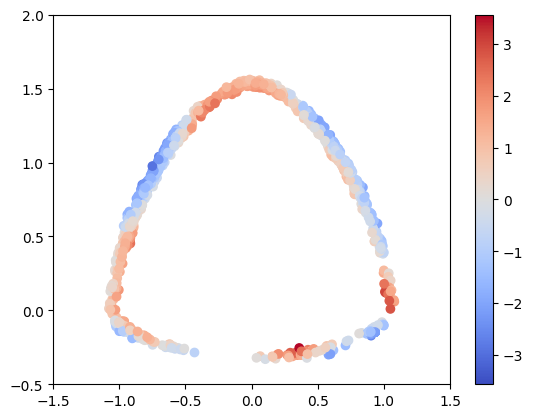

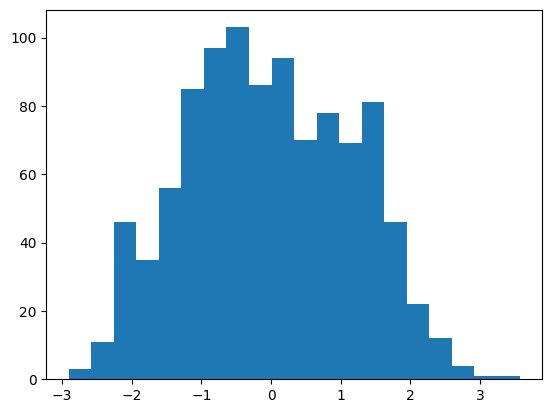

tensor(0.6800)

In [66]:
test_model(net_hinge, dataset_test_near_005)

Accuracy: 0.7789999842643738


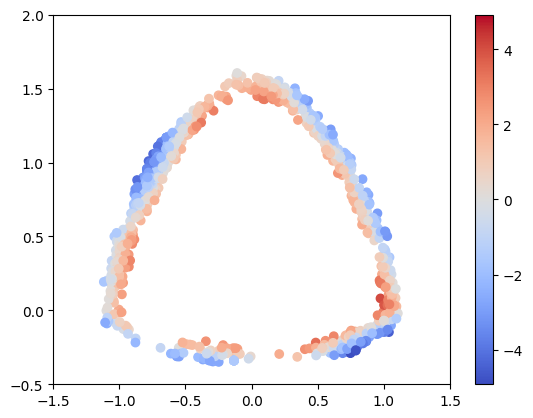

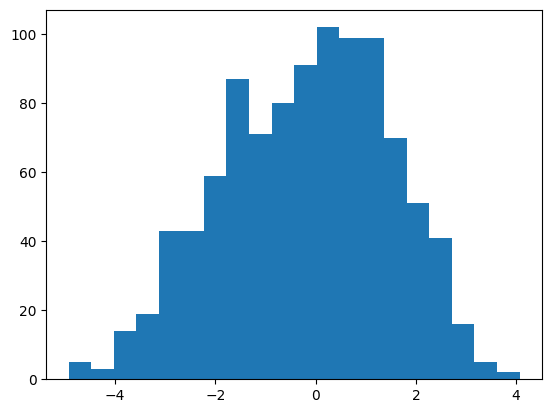

tensor(0.7790)

In [67]:
test_model(net_hinge, dataset_test_near_010)

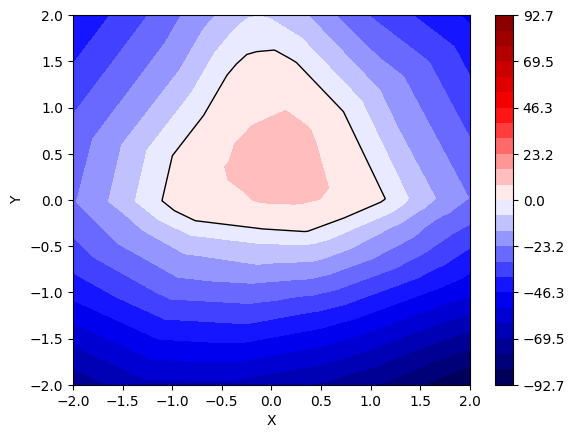

In [68]:
plot_contour(net_hinge)

In [69]:
def train_model_hinge_square(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                      dataset_validation003, dataset_validation004, dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion = QuadraticHingeLoss()
    #optimizer = optim.Adam(net.parameters(), lr=lr)
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)

    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []
    training_loss_over_epochs = []
    validation1_loss_over_epochs = []
    validation001_loss_over_epochs = []
    validation002_loss_over_epochs = []
    validation003_loss_over_epochs = []
    validation004_loss_over_epochs = []
    validation005_loss_over_epochs = []
    validation010_loss_over_epochs = []
    
    # Set up the overall progress bar
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train = 0
        for features, labels in dataloader_train:
            #labels = ((labels + 1) / 2).float()
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)
            loss = criterion(outputs, labels)
            avg_loss_train += loss.item()
            loss.backward()
            optimizer.step()
                    
        training_accuracy = correct_train / total_train
        training_loss = avg_loss_train / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_over_epochs.append(training_loss)

        
        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation1:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation1 += (predicted == labels).sum().item()
                total_validation1 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation1 += loss.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss = avg_loss_validation1 / len(dataloader_validation1)
        validation1_loss_over_epochs.append(validation1_loss)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation001:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation001 += (predicted == labels).sum().item()
                total_validation001 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation001 += loss.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss = avg_loss_validation001 / len(dataloader_validation001)
        validation001_loss_over_epochs.append(validation001_loss)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation002:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation002 += (predicted == labels).sum().item()
                total_validation002 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation002 += loss.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss = avg_loss_validation002 / len(dataloader_validation002)
        validation002_loss_over_epochs.append(validation002_loss)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation003:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation003 += (predicted == labels).sum().item()
                total_validation003 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation003 += loss.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss = avg_loss_validation003 / len(dataloader_validation003)
        validation003_loss_over_epochs.append(validation003_loss)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation004:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation004 += (predicted == labels).sum().item()
                total_validation004 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation004 += loss.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss = avg_loss_validation004 / len(dataloader_validation004)
        validation004_loss_over_epochs.append(validation004_loss)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation005:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation005 += (predicted == labels).sum().item()
                total_validation005 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation005 += loss.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss = avg_loss_validation005 / len(dataloader_validation005)
        validation005_loss_over_epochs.append(validation005_loss)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010 = 0
        with torch.no_grad():
            for features, labels in dataloader_validation010:
                #labels = ((labels + 1) / 2).float()
                labels = labels.view(-1)
                outputs = net(features).view(-1)
                predicted = ((outputs > 0).float() * 2) - 1
                correct_validation010 += (predicted == labels).sum().item()
                total_validation010 += labels.size(0)
                loss = criterion(outputs, labels)
                avg_loss_validation010 += loss.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss = avg_loss_validation010 / len(dataloader_validation010)
        validation010_loss_over_epochs.append(validation010_loss)
        
        # Update the overall progress bar after each epoch
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy,
                                       'Validation1 Accuracy': validation1_accuracy,
                                        'Validation001 Accuracy': validation001_accuracy, 
                                        'Validation002 Accuracy': validation002_accuracy, 
                                        'Validation003 Accuracy': validation003_accuracy, 
                                        'Validation004 Accuracy': validation004_accuracy, 
                                        'Validation005 Accuracy': validation005_accuracy, 
                                        'Validation010 Accuracy': validation010_accuracy})
    
    overall_progress.close()
    
    # Plot training and validation accuracy over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    # Plot training and validation loss over epochs
    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_over_epochs, label='Training')
    plt.plot(validation1_loss_over_epochs, label='Uniform')
    plt.plot(validation001_loss_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()
    
    test_model(net, dataset_train)
    test_model(net, dataset_validation1)
    test_model(net, dataset_validation001)
    test_model(net, dataset_validation002)
    test_model(net, dataset_validation003)
    test_model(net, dataset_validation004)
    test_model(net, dataset_validation005)
    test_model(net, dataset_validation010)

Overall Training Progress: 100%|██████████| 1000/1000 [05:07<00:00,  3.25it/s, Training Accuracy=1, Validation1 Accuracy=0.962, Validation001 Accuracy=0.511, Validation002 Accuracy=0.529, Validation003 Accuracy=0.563, Validation004 Accuracy=0.576, Validation005 Accuracy=0.601, Validation010 Accuracy=0.737]   


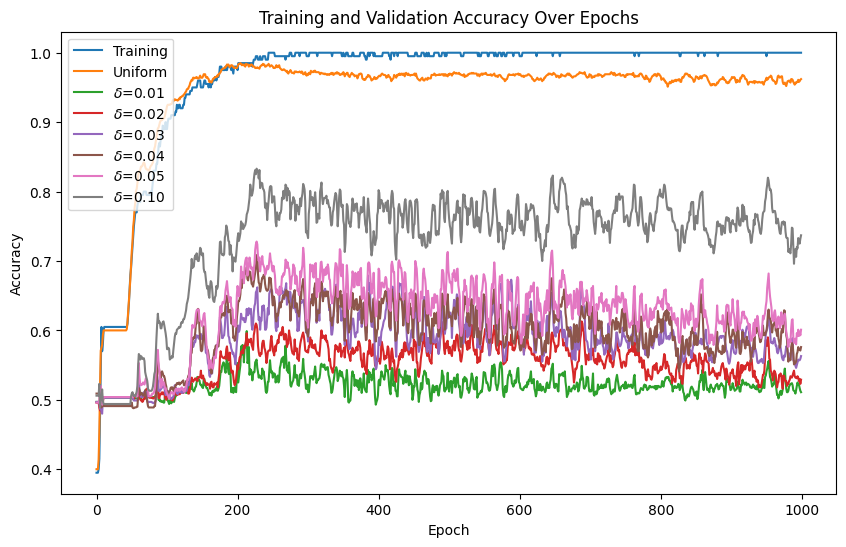

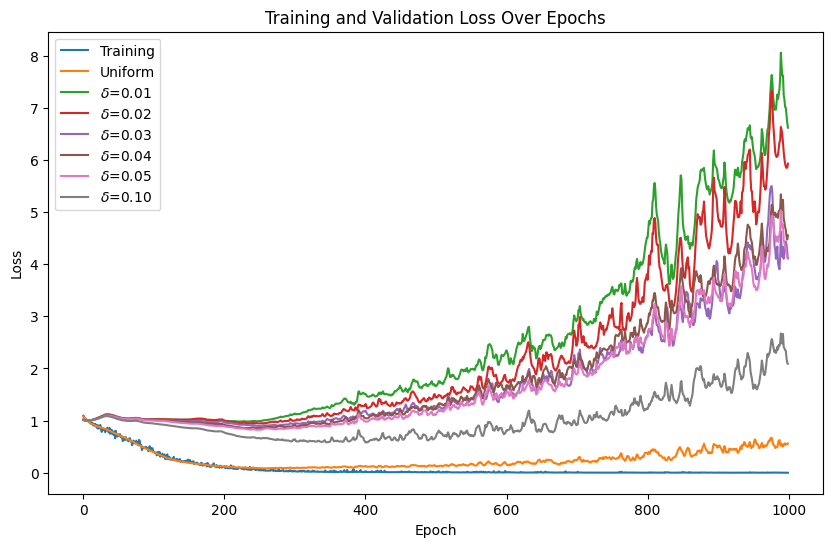

Accuracy: 1.0


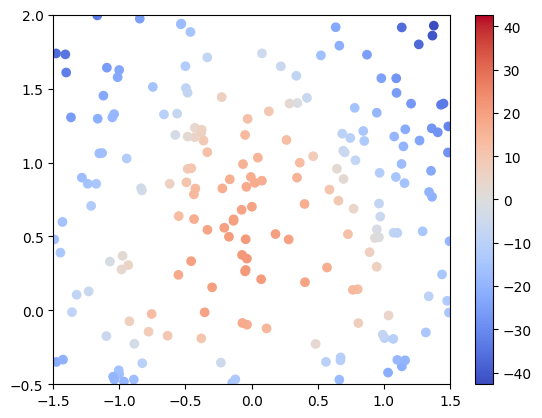

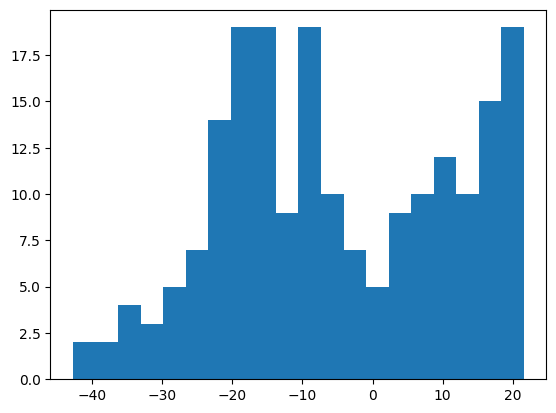

Accuracy: 0.9620000123977661


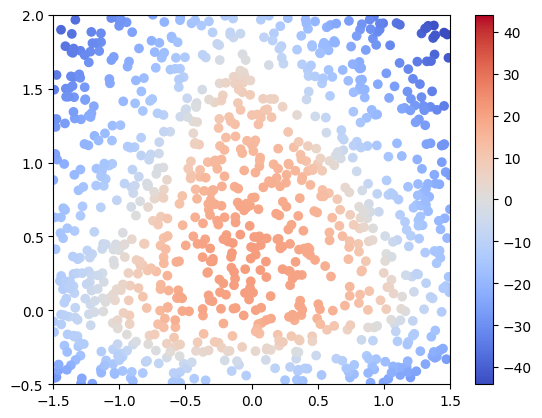

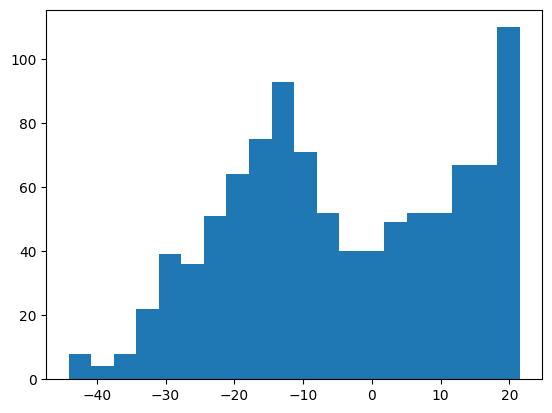

Accuracy: 0.5109999775886536


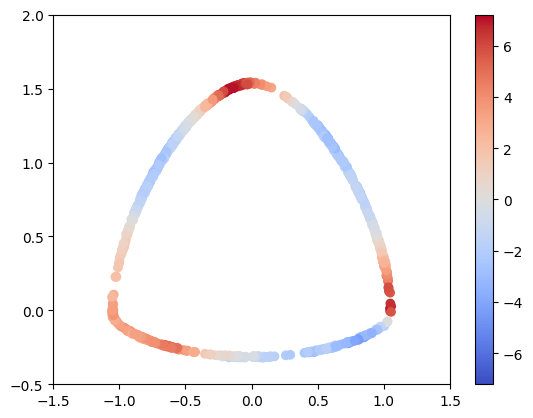

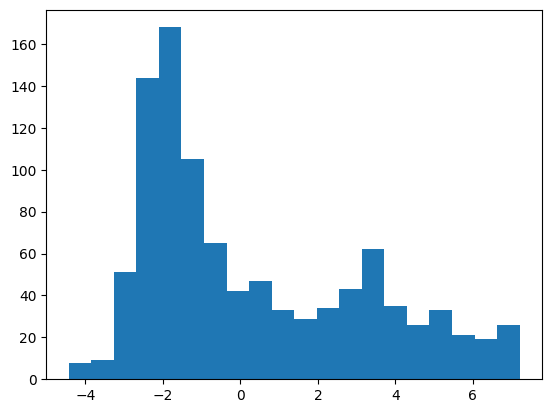

Accuracy: 0.5289999842643738


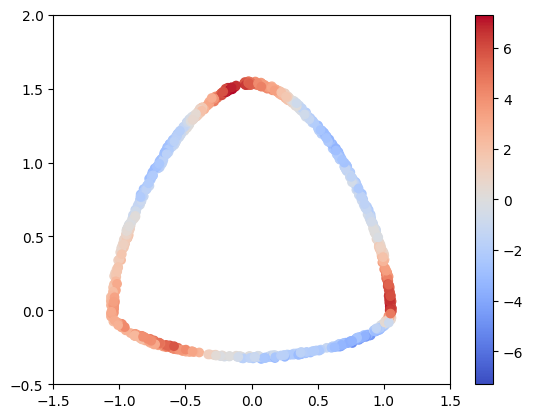

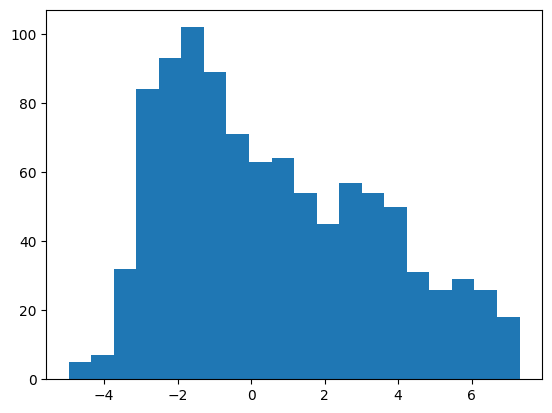

Accuracy: 0.5630000233650208


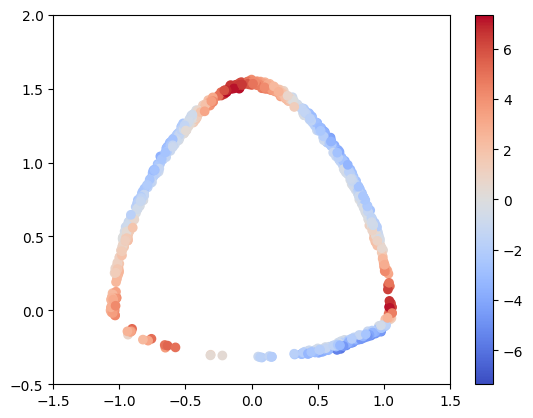

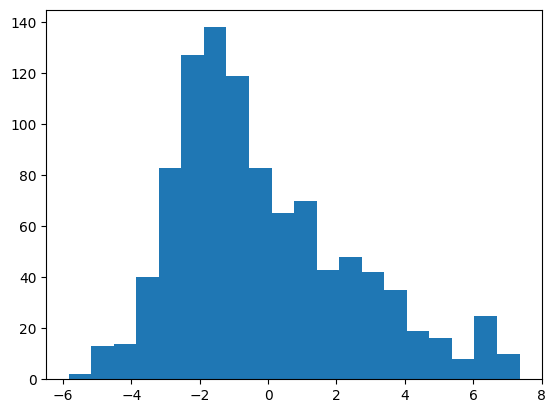

Accuracy: 0.5759999752044678


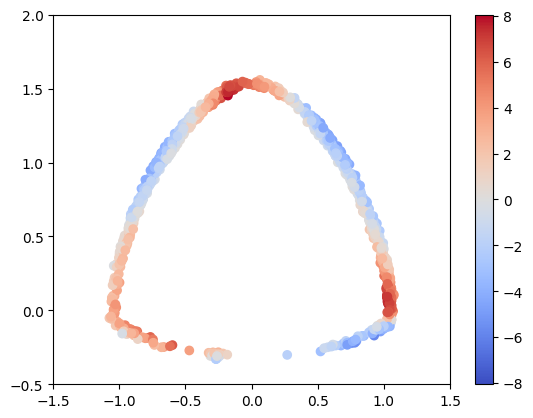

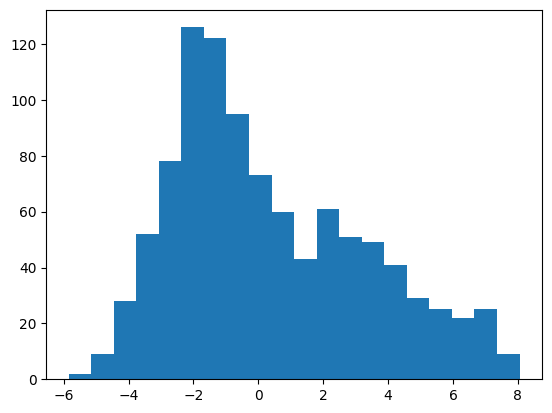

Accuracy: 0.6010000109672546


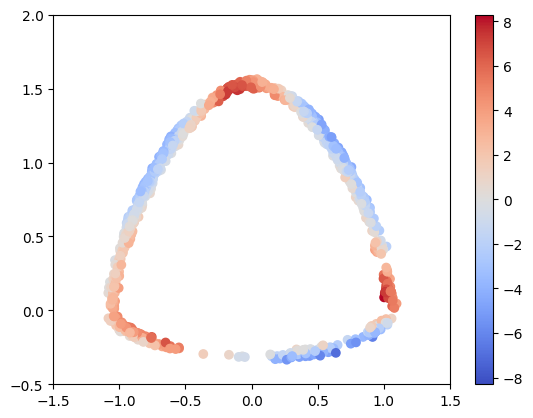

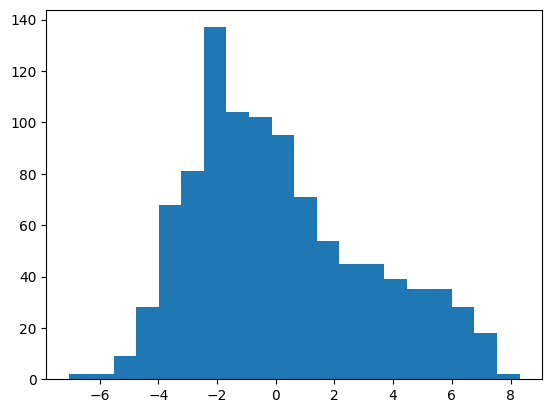

Accuracy: 0.7369999885559082


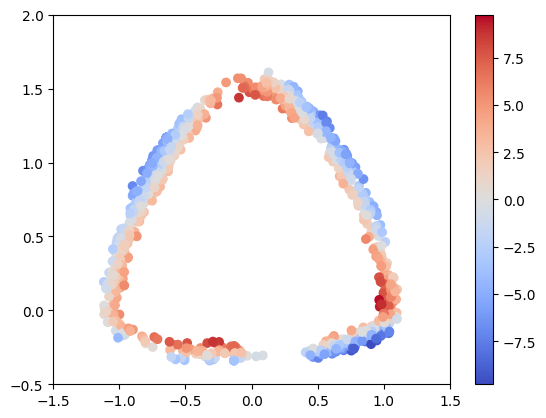

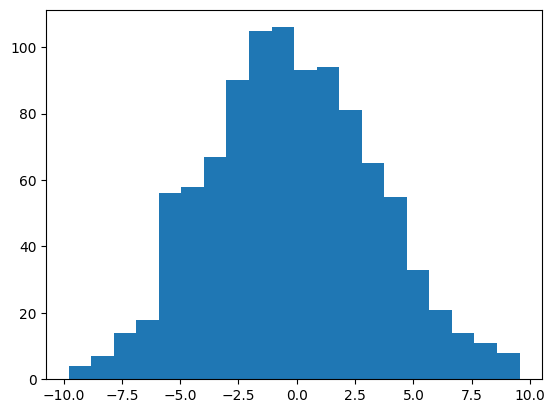

In [70]:
net_hinge_square = Net()
train_model_hinge_square(net_hinge_square, dataset_train, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1000, lr=0.0005)

Accuracy: 0.9670000076293945


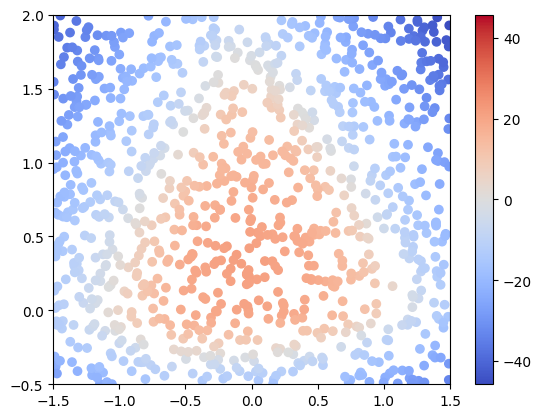

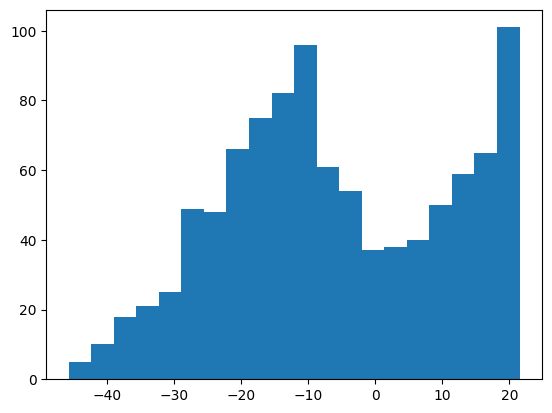

tensor(0.9670)

In [71]:
test_model(net_hinge_square, dataset_test_uniform)

Accuracy: 0.4950000047683716


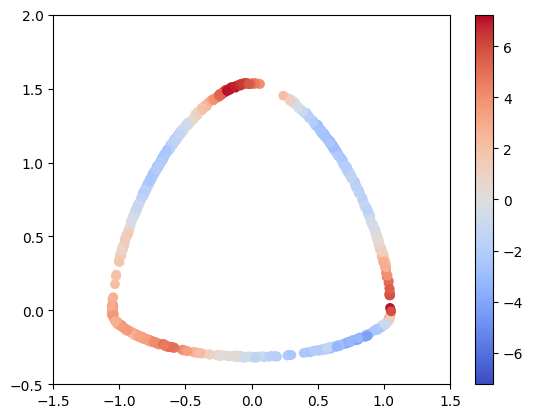

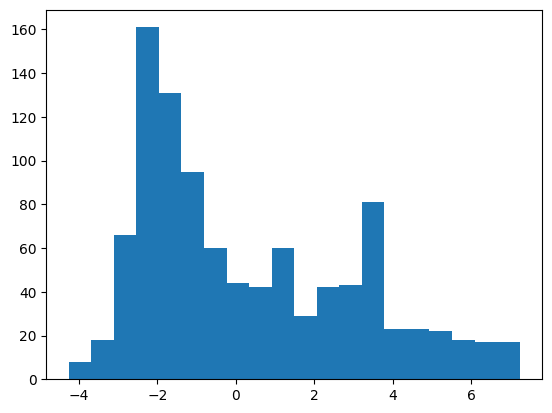

tensor(0.4950)

In [72]:
test_model(net_hinge_square, dataset_test_near_001)

Accuracy: 0.5460000038146973


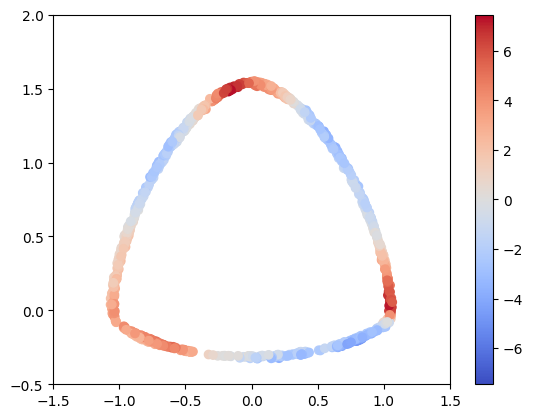

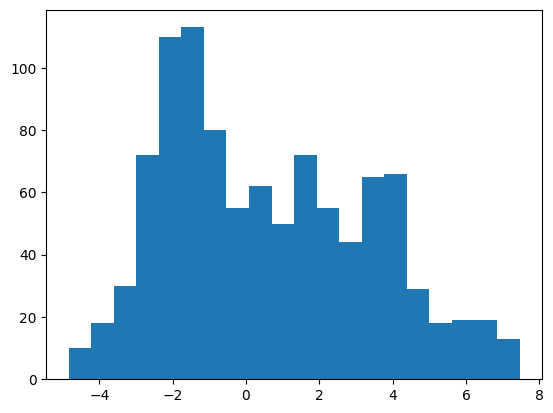

tensor(0.5460)

In [73]:
test_model(net_hinge_square, dataset_test_near_002)

Accuracy: 0.5410000085830688


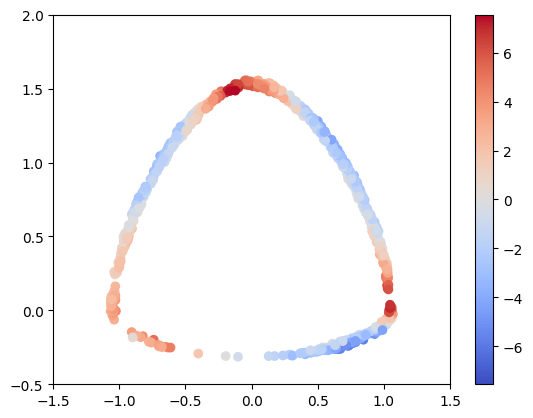

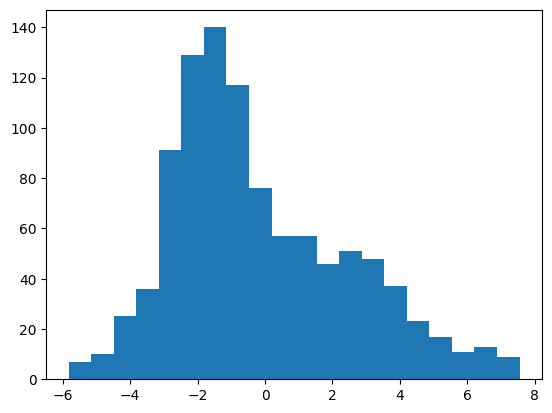

tensor(0.5410)

In [74]:
test_model(net_hinge_square, dataset_test_near_003)

Accuracy: 0.593999981880188


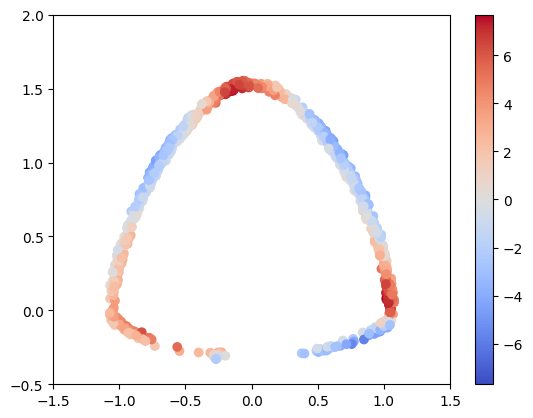

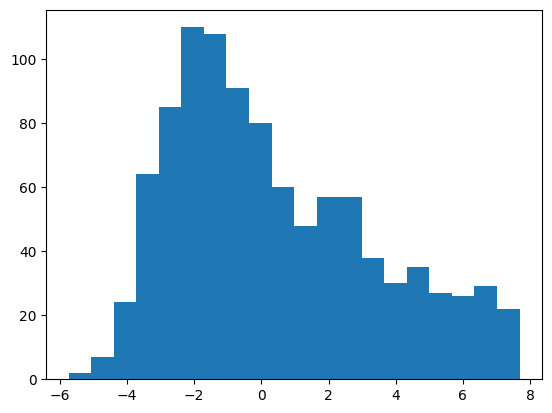

tensor(0.5940)

In [75]:
test_model(net_hinge_square, dataset_test_near_004)

Accuracy: 0.5839999914169312


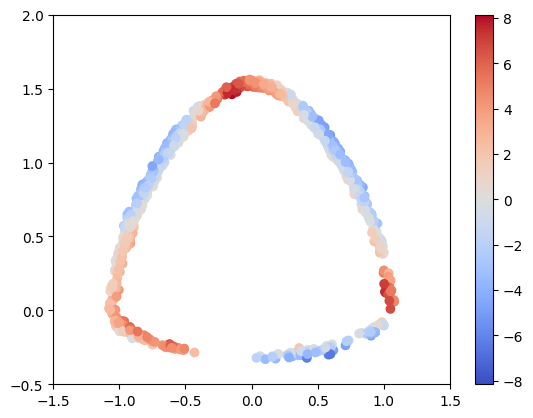

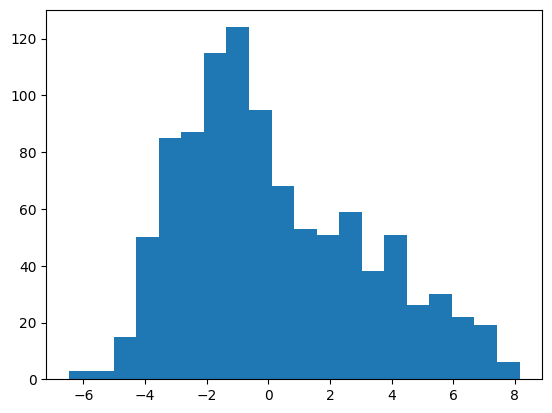

tensor(0.5840)

In [76]:
test_model(net_hinge_square, dataset_test_near_005)

Accuracy: 0.7390000224113464


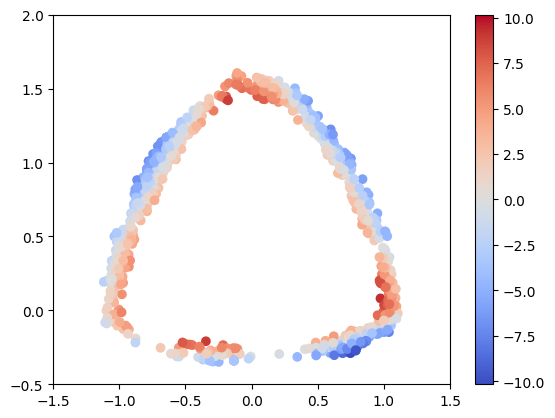

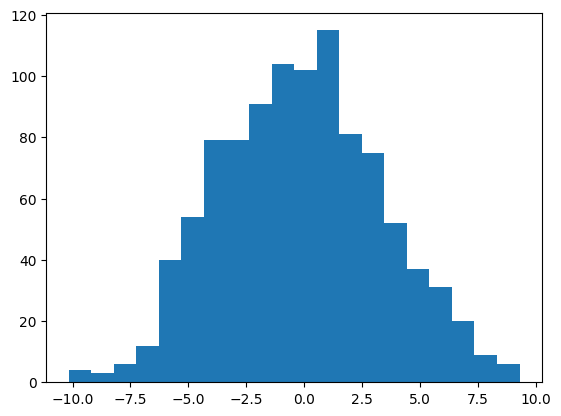

tensor(0.7390)

In [77]:
test_model(net_hinge_square, dataset_test_near_010)

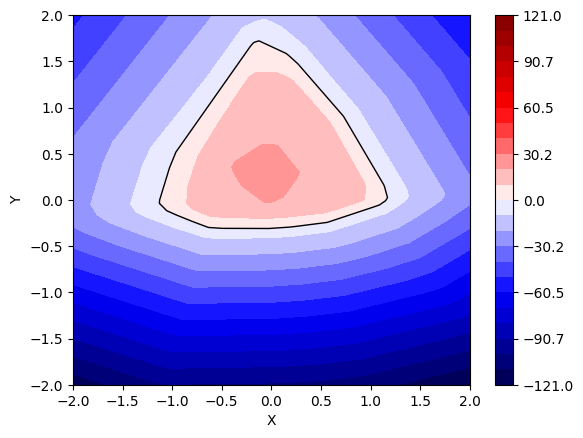

In [78]:
plot_contour(net_hinge_square)

In [79]:
def dynamical_system_vector(point):
    x,y = point[0], point[1]
    xp = (3 * torch.exp(-x**2 - (y - 1/3)**2) * (-2 * x)
           - 3 * torch.exp(-x**2 - (y - 5/3)**2) * (-2 * x)
           - 5 * torch.exp(-(x - 1)**2 - y**2) * (-2 * (x - 1))
           - 5 * torch.exp(-(x + 1)**2 - y**2) * (-2 * (x + 1))
           + 0.8 * x**3)
    yp = (3 * torch.exp(-x**2 - (y - 1/3)**2) * (-2 * (y - 1/3))
           - 3 * torch.exp(-x**2 - (y - 5/3)**2) * (-2 * (y - 5/3))
           - 5 * torch.exp(-(x - 1)**2 - y**2) * (-2 * y)
           - 5 * torch.exp(-(x + 1)**2 - y**2) * (-2 * y)
           + 0.8 * (y - 1/3)**3)
    return torch.tensor([xp, yp], dtype=torch.float32)

def custom_loss_function(model, batch_inputs):
    batch_loss = 0.0
    def dirac(value, var=0.1):
        return torch.exp(-(value)**2 / (2 * var**2)) / torch.sqrt(torch.tensor(2 * torch.pi * var**2))
    
    for input_point in batch_inputs:
        prediction = model(input_point.unsqueeze(0))
        grad_output = torch.ones_like(prediction)
        gradient = torch.autograd.grad(prediction, input_point, grad_outputs=grad_output, create_graph=True)[0]
        dynamical_vector = dynamical_system_vector(input_point)
        gradient_normalized = gradient / (torch.norm(gradient) + 1e-8)
        dynamical_vector_normalized = dynamical_vector / (torch.norm(dynamical_vector) + 1e-8)
        inner_product = torch.dot(gradient_normalized, dynamical_vector_normalized)
        dirac_value = dirac(prediction)
        gradient_norm = torch.norm(gradient)
        loss = (inner_product ** 2) * gradient_norm * dirac_value
        batch_loss += loss
    
    # Average the loss over the batch
    batch_loss /= len(batch_inputs)
    
    return batch_loss


In [80]:
def train_model_dynamical(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                        dataset_validation003, dataset_validation004, 
                        dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion_sqhinge = QuadraticHingeLoss()
    #criterion_sqhinge = nn.BCEWithLogitsLoss()
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)
    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []
    training_loss_dynamical_over_epochs = []
    validation1_loss_dynamical_over_epochs = []
    validation001_loss_dynamical_over_epochs = []
    validation002_loss_dynamical_over_epochs = []
    validation003_loss_dynamical_over_epochs = []
    validation004_loss_dynamical_over_epochs = []
    validation005_loss_dynamical_over_epochs = []
    validation010_loss_dynamical_over_epochs = []
    training_loss_hinge_over_epochs = []
    validation1_loss_hinge_over_epochs = []
    validation001_loss_hinge_over_epochs = []
    validation002_loss_hinge_over_epochs = []
    validation003_loss_hinge_over_epochs = []
    validation004_loss_hinge_over_epochs = []
    validation005_loss_hinge_over_epochs = []
    validation010_loss_hinge_over_epochs = []
    
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train_dynamical = 0
        avg_loss_train_hinge = 0
        for features, labels in dataloader_train:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_train += (predicted == labels).sum().item()
            total_train += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            loss = 0.01*loss_dynamic + 1*loss_hinge # C=constant
            avg_loss_train_dynamical += loss_dynamic.item()
            avg_loss_train_hinge += loss_hinge.item()
            loss.backward()
            optimizer.step()
    
                    
        training_accuracy = correct_train / total_train
        training_loss_dynamical = avg_loss_train_dynamical / len(dataloader_train)
        training_loss_hinge = avg_loss_train_hinge / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_dynamical_over_epochs.append(training_loss_dynamical)
        training_loss_hinge_over_epochs.append(training_loss_hinge)


        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1_dynamical = 0
        avg_loss_validation1_hinge = 0
        for features, labels in dataloader_validation1:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation1 += (predicted == labels).sum().item()
            total_validation1 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            #loss = loss_dynamic + loss_hinge
            avg_loss_validation1_dynamical += loss_dynamic.item()
            avg_loss_validation1_hinge += loss_hinge.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss_dynamical = avg_loss_validation1_dynamical / len(dataloader_validation1)
        validation1_loss_dynamical_over_epochs.append(validation1_loss_dynamical)
        validation1_loss_hinge = avg_loss_validation1_hinge / len(dataloader_validation1)
        validation1_loss_hinge_over_epochs.append(validation1_loss_hinge)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001_dynamical = 0
        avg_loss_validation001_hinge = 0
        for features, labels in dataloader_validation001:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation001 += (predicted == labels).sum().item()
            total_validation001 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation001_dynamical += loss_dynamic.item()
            avg_loss_validation001_hinge += loss_hinge.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss_dynamical = avg_loss_validation001_dynamical / len(dataloader_validation001)
        validation001_loss_dynamical_over_epochs.append(validation001_loss_dynamical)
        validation001_loss_hinge = avg_loss_validation001_hinge / len(dataloader_validation001)
        validation001_loss_hinge_over_epochs.append(validation001_loss_hinge)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002_dynamical = 0
        avg_loss_validation002_hinge = 0
        for features, labels in dataloader_validation002:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation002 += (predicted == labels).sum().item()
            total_validation002 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation002_dynamical += loss_dynamic.item()
            avg_loss_validation002_hinge += loss_hinge.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss_dynamical = avg_loss_validation002_dynamical / len(dataloader_validation002)
        validation002_loss_dynamical_over_epochs.append(validation002_loss_dynamical)
        validation002_loss_hinge = avg_loss_validation002_hinge / len(dataloader_validation002)
        validation002_loss_hinge_over_epochs.append(validation002_loss_hinge)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003_dynamical = 0
        avg_loss_validation003_hinge = 0
        for features, labels in dataloader_validation003:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation003 += (predicted == labels).sum().item()
            total_validation003 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation003_dynamical += loss_dynamic.item()
            avg_loss_validation003_hinge += loss_hinge.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss_dynamical = avg_loss_validation003_dynamical / len(dataloader_validation003)
        validation003_loss_dynamical_over_epochs.append(validation003_loss_dynamical)
        validation003_loss_hinge = avg_loss_validation003_hinge / len(dataloader_validation003)
        validation003_loss_hinge_over_epochs.append(validation003_loss_hinge)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004_dynamical = 0
        avg_loss_validation004_hinge = 0
        for features, labels in dataloader_validation004:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation004 += (predicted == labels).sum().item()
            total_validation004 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation004_dynamical += loss_dynamic.item()
            avg_loss_validation004_hinge += loss_hinge.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss_dynamical = avg_loss_validation004_dynamical / len(dataloader_validation004)
        validation004_loss_dynamical_over_epochs.append(validation004_loss_dynamical)
        validation004_loss_hinge = avg_loss_validation004_hinge / len(dataloader_validation004)
        validation004_loss_hinge_over_epochs.append(validation004_loss_hinge)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005_dynamical = 0
        avg_loss_validation005_hinge = 0
        for features, labels in dataloader_validation005:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation005 += (predicted == labels).sum().item()
            total_validation005 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation005_dynamical += loss_dynamic.item()
            avg_loss_validation005_hinge += loss_hinge.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss_dynamical = avg_loss_validation005_dynamical / len(dataloader_validation005)
        validation005_loss_dynamical_over_epochs.append(validation005_loss_dynamical)
        validation005_loss_hinge = avg_loss_validation005_hinge / len(dataloader_validation005)
        validation005_loss_hinge_over_epochs.append(validation005_loss_hinge)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010_dynamical = 0
        avg_loss_validation010_hinge = 0
        for features, labels in dataloader_validation010:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation010 += (predicted == labels).sum().item()
            total_validation010 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation010_dynamical += loss_dynamic.item()
            avg_loss_validation010_hinge += loss_hinge.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss_dynamical = avg_loss_validation010_dynamical / len(dataloader_validation010)
        validation010_loss_dynamical_over_epochs.append(validation010_loss_dynamical)
        validation010_loss_hinge = avg_loss_validation010_hinge / len(dataloader_validation010)
        validation010_loss_hinge_over_epochs.append(validation010_loss_hinge)
        
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy,
                                        'Validation1 Accuracy': validation1_accuracy,
                                         'Validation001 Accuracy': validation001_accuracy, 
                                         'Validation002 Accuracy': validation002_accuracy, 
                                         'Validation003 Accuracy': validation003_accuracy, 
                                         'Validation004 Accuracy': validation004_accuracy, 
                                         'Validation005 Accuracy': validation005_accuracy, 
                                         'Validation010 Accuracy': validation010_accuracy})
    
    overall_progress.close()
    
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_dynamical_over_epochs, label='Training')
    plt.plot(validation1_loss_dynamical_over_epochs, label='Uniform')
    plt.plot(validation001_loss_dynamical_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_dynamical_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_dynamical_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_dynamical_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_dynamical_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_dynamical_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Dynamical Loss Over Epochs')
    plt.legend()
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_hinge_over_epochs, label='Training')
    plt.plot(validation1_loss_hinge_over_epochs, label='Uniform')
    plt.plot(validation001_loss_hinge_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_hinge_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_hinge_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_hinge_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_hinge_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_hinge_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Square Hinge Loss Over Epochs')
    plt.legend()
    plt.show()
    
    test_model(net, dataset_train)
    test_model(net, dataset_validation1)
    test_model(net, dataset_validation001)
    test_model(net, dataset_validation002)
    test_model(net, dataset_validation003)
    test_model(net, dataset_validation004)
    test_model(net, dataset_validation005)
    test_model(net, dataset_validation010)

Overall Training Progress: 100%|██████████| 1000/1000 [36:06<00:00,  2.17s/it, Training Accuracy=1, Validation1 Accuracy=0.966, Validation001 Accuracy=0.528, Validation002 Accuracy=0.567, Validation003 Accuracy=0.569, Validation004 Accuracy=0.598, Validation005 Accuracy=0.628, Validation010 Accuracy=0.73]    


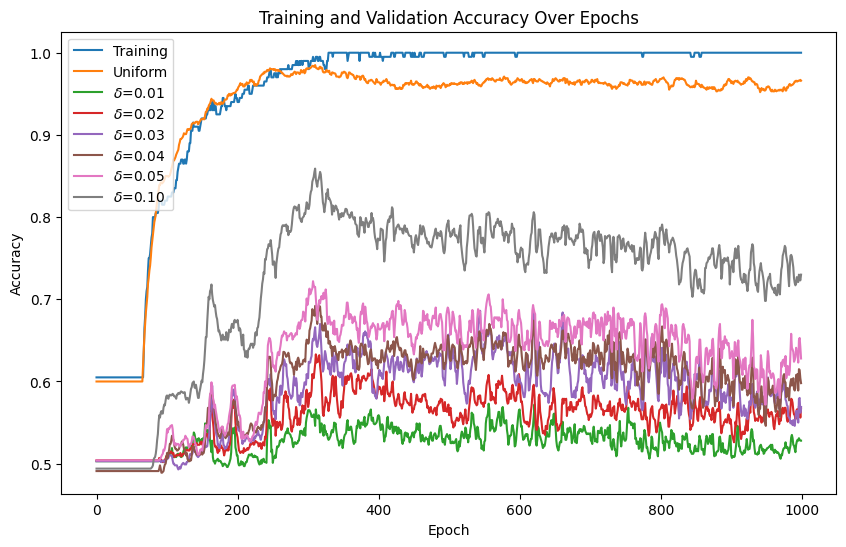

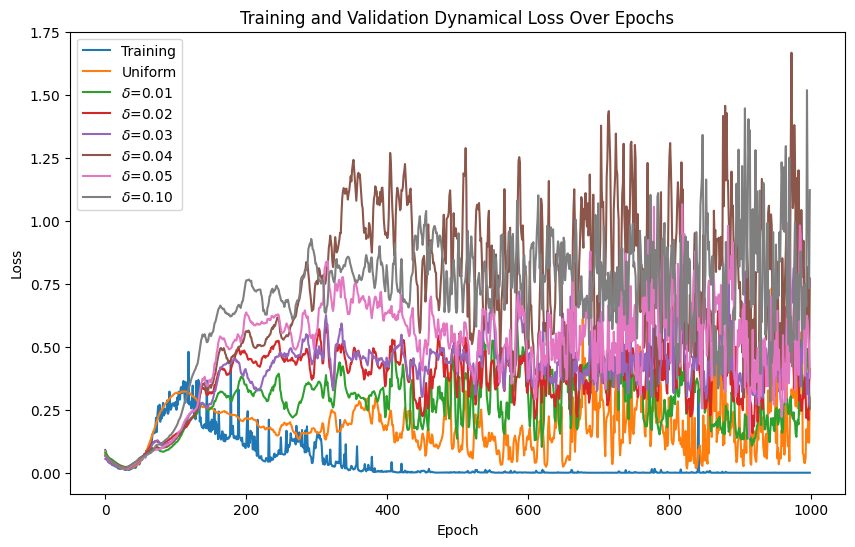

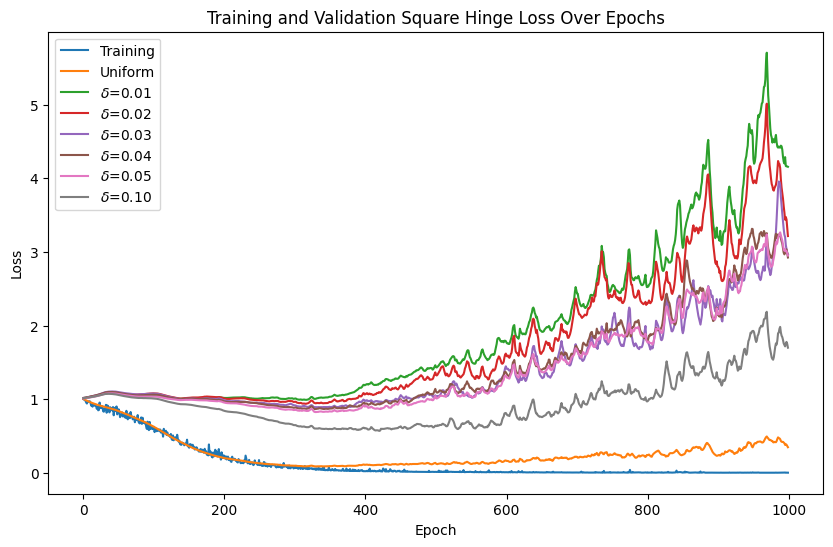

Accuracy: 1.0


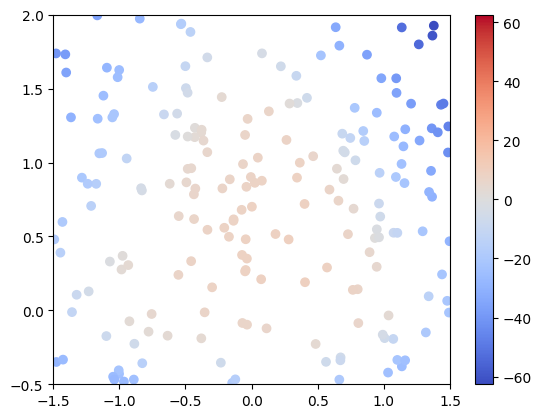

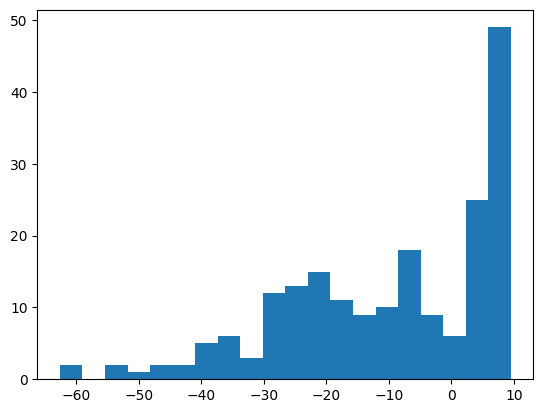

Accuracy: 0.9660000205039978


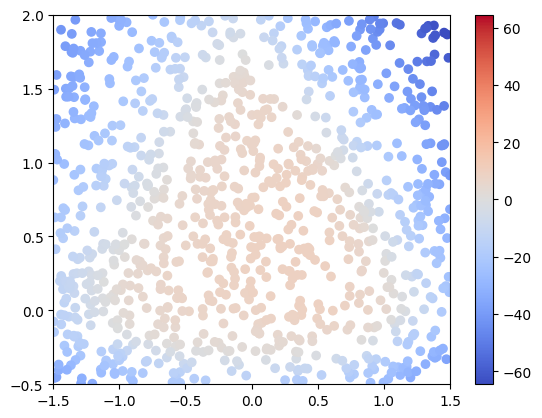

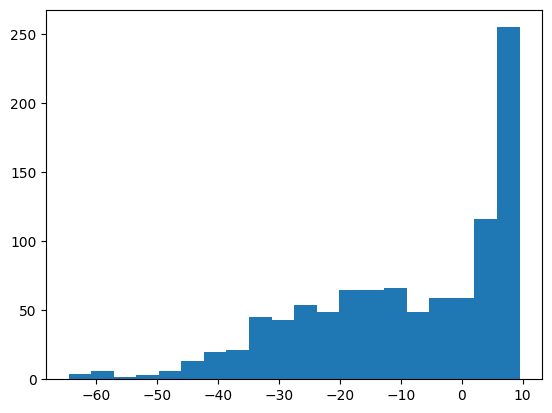

Accuracy: 0.527999997138977


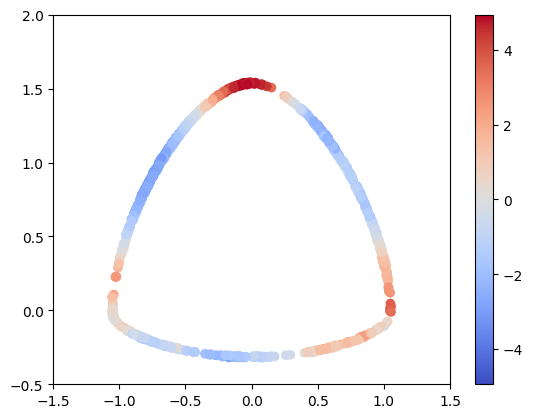

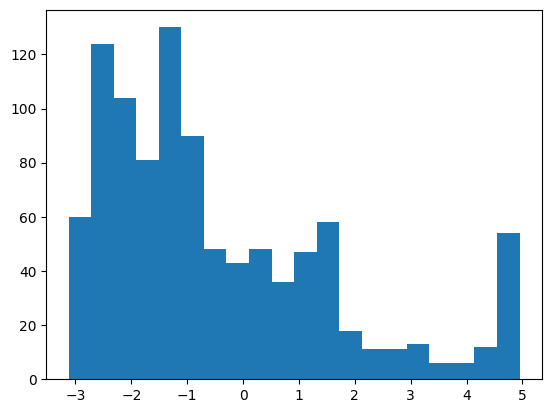

Accuracy: 0.5669999718666077


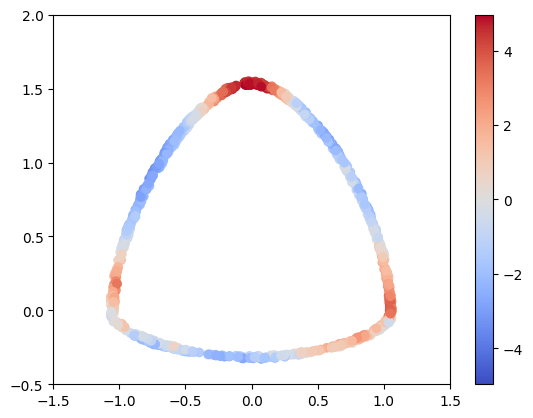

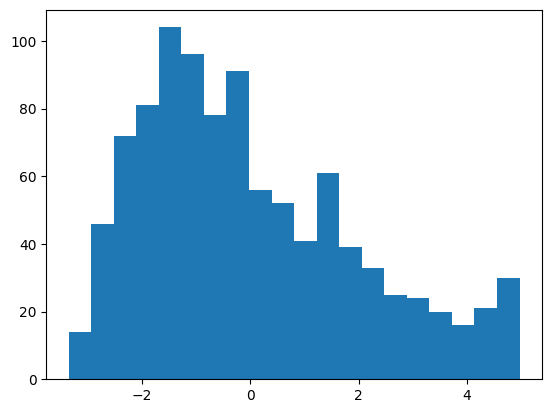

Accuracy: 0.5690000057220459


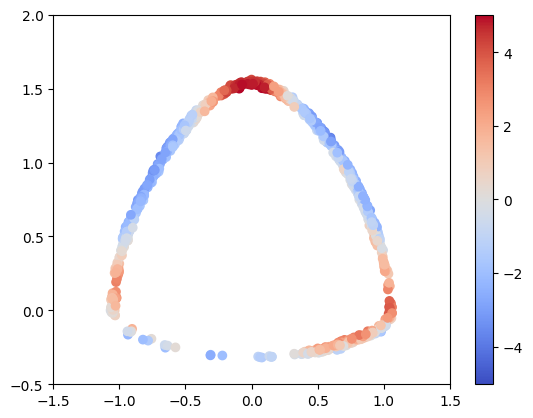

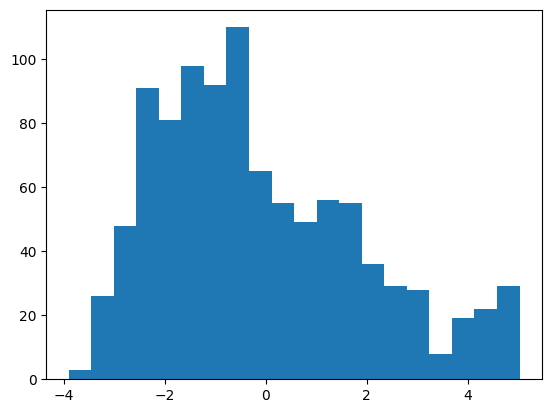

Accuracy: 0.5979999899864197


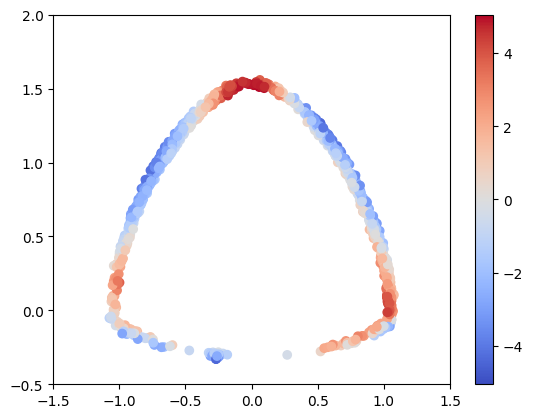

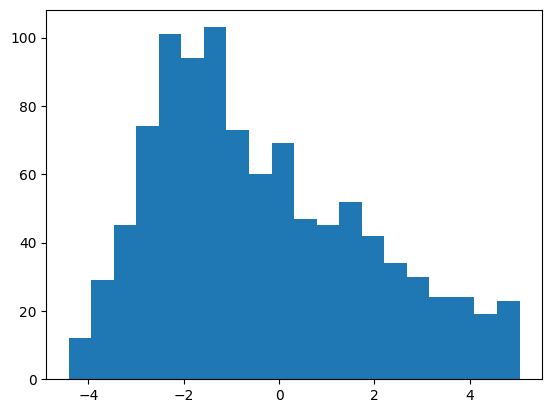

Accuracy: 0.628000020980835


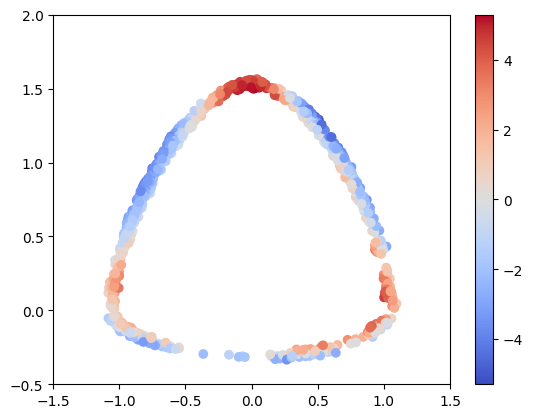

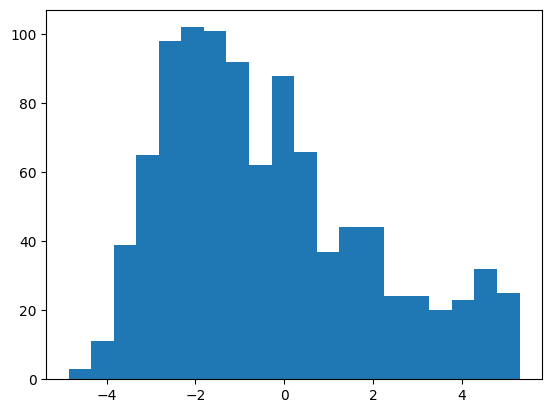

Accuracy: 0.7300000190734863


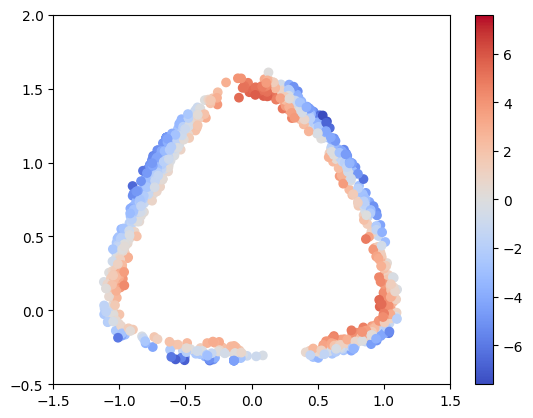

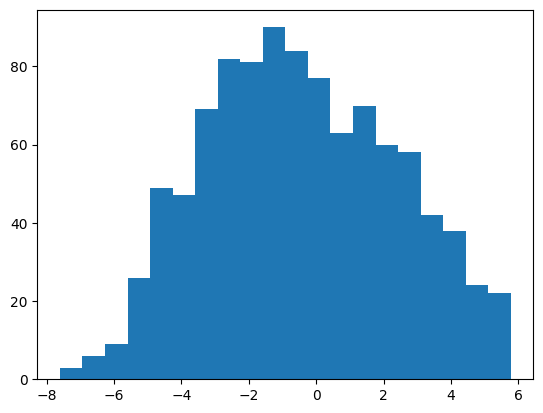

In [81]:
net_4 = Net()

train_model_dynamical(net_4, dataset_train, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1000, lr=0.0005)

Accuracy: 0.9679999947547913


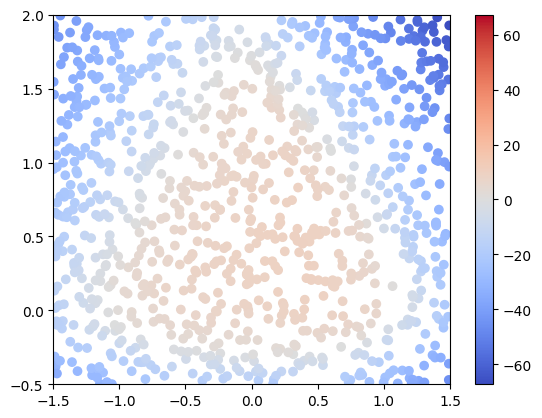

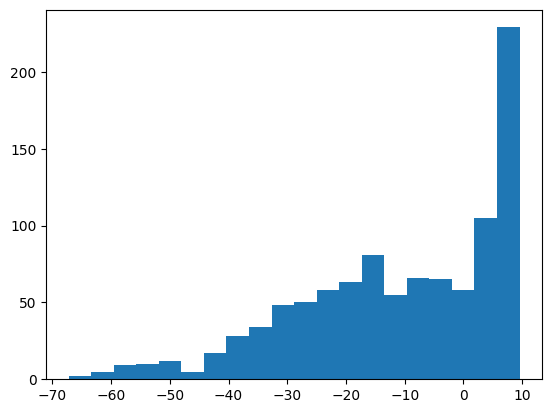

tensor(0.9680)

In [82]:
test_model(net_4, dataset_test_uniform)

Accuracy: 0.4970000088214874


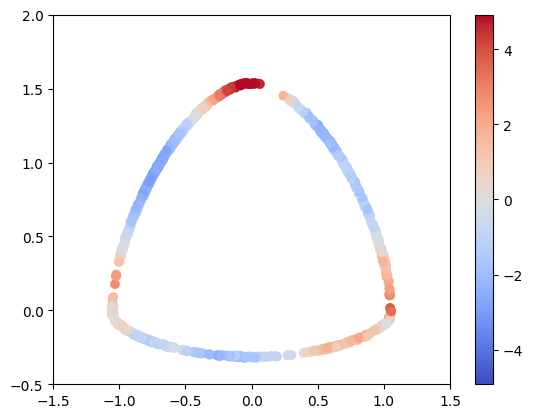

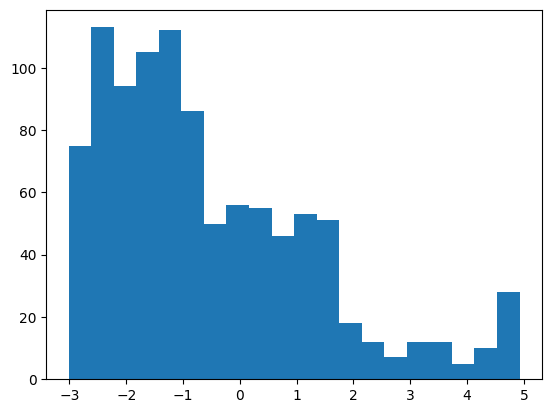

tensor(0.4970)

In [83]:
test_model(net_4, dataset_test_near_001)

Accuracy: 0.5339999794960022


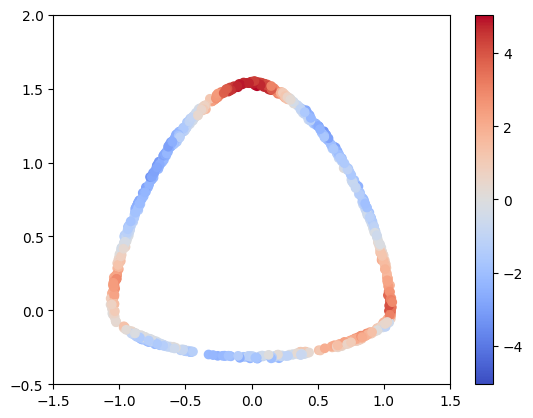

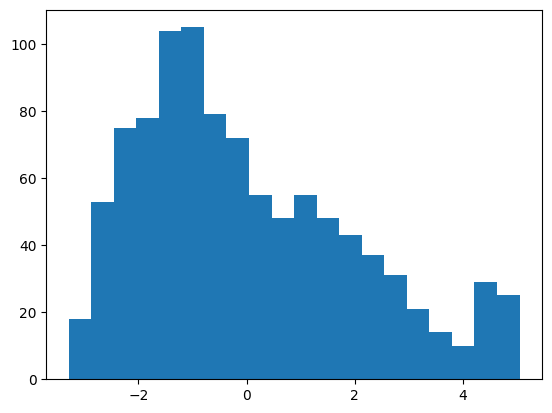

tensor(0.5340)

In [84]:
test_model(net_4, dataset_test_near_002)

Accuracy: 0.578000009059906


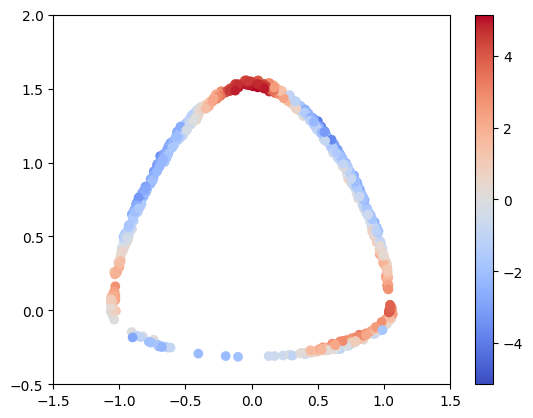

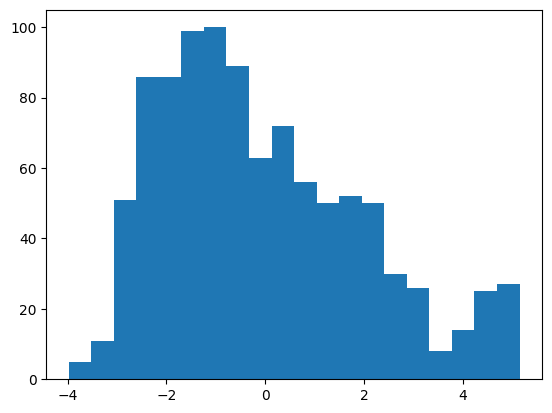

tensor(0.5780)

In [85]:
test_model(net_4, dataset_test_near_003)

Accuracy: 0.6060000061988831


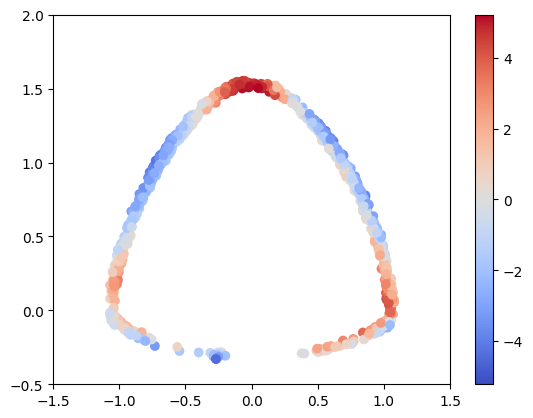

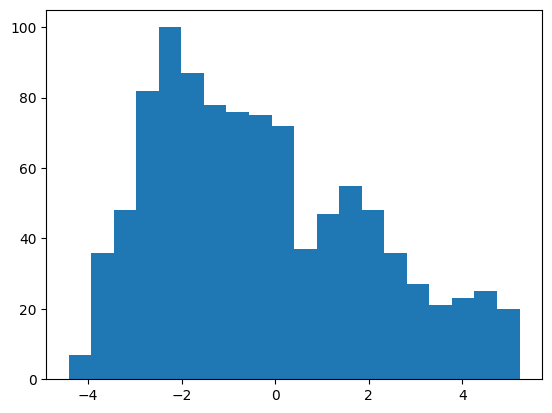

tensor(0.6060)

In [86]:
test_model(net_4, dataset_test_near_004)

Accuracy: 0.6190000176429749


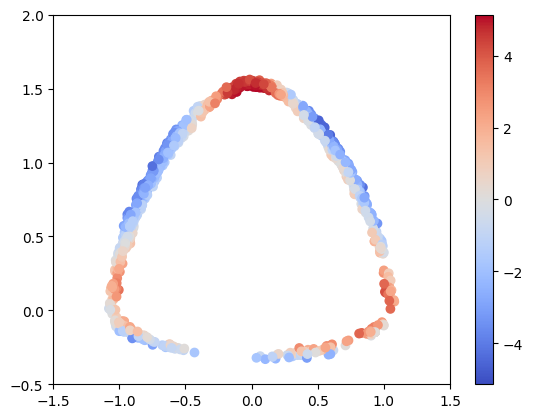

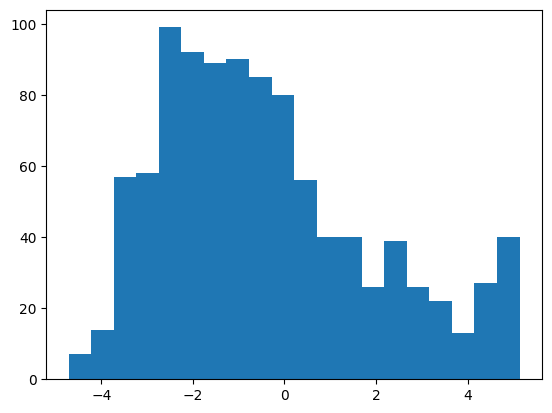

tensor(0.6190)

In [87]:
test_model(net_4, dataset_test_near_005)

Accuracy: 0.7210000157356262


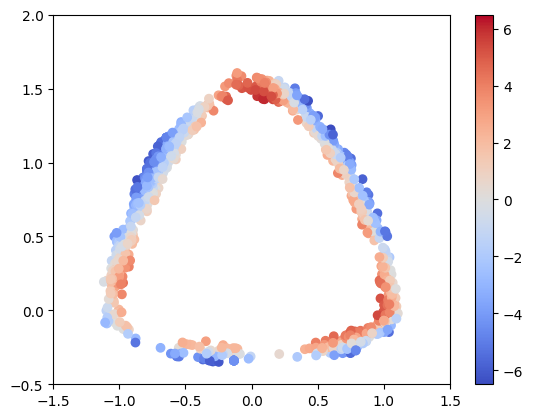

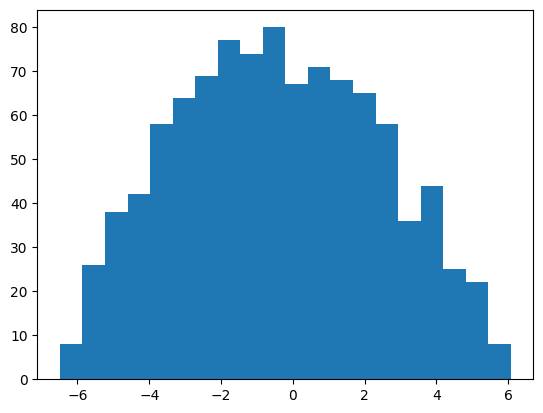

tensor(0.7210)

In [88]:
test_model(net_4, dataset_test_near_010)

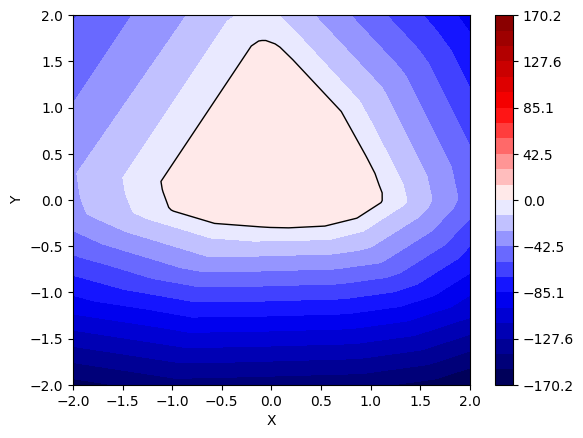

In [89]:
plot_contour(net_4)

In [90]:
from torch.autograd import Variable

def find_decision_boundary_batch(f, initial_points, lr=0.001, threshold=0.0001, max_iter=1000):
    f.eval()
    x = Variable(initial_points.clone(), requires_grad=True)
    optimizer = torch.optim.Adam([x], lr=lr)
    converged = torch.zeros(initial_points.size(0), dtype=torch.bool)
    
    for i in range(max_iter):
        optimizer.zero_grad()
        output = f(x)
        loss = (output) ** 2
        loss = loss.mean(dim=1)  # Assuming f returns a tensor of shape (n_points,)
        loss.backward(torch.ones_like(loss))
        optimizer.step()
        
        # Check convergence for each point
        converged |= (loss < threshold)
        
        # Check if points are within the range [-2, 2] x [-2, 2]
        within_bounds = (x[:, 0] >= -2) & (x[:, 0] <= 2) & (x[:, 1] >= -2) & (x[:, 1] <= 2)
        converged &= within_bounds  # Only consider points within bounds as converged
        
        if converged.all():
            print(f"All converged after {i+1} iterations.")
            break
    
    return x, converged


#def collect_converged_points(f, target_count=20):
    #collected_points = []
    #while len(collected_points) < target_count:
        #n_points_needed = 10000
        #initial_points = (torch.rand(n_points_needed, 2) * 4) - 2  # Generate more points
        #x_star_batch, converged = find_decision_boundary_batch(f, initial_points)
        #converged_points = x_star_batch[converged]
        
        # Generate random shifts
        #shifts = (torch.rand(converged_points.size()) * 0.02) - 0.01  # Shifts in the range [-0.01, 0.01]
        #converged_points_shifted = converged_points + shifts
        
        #collected_points.extend(converged_points_shifted.detach().numpy().tolist())  # Convert to list and append
        
    #return torch.tensor(collected_points[:target_count])  # Return the first 1,000 converged points

# Example usage
#collected_points = collect_converged_points(net_4)
#print(f"Collected {len(collected_points)} converged points.")
#outputs = net_4(collected_points)
# Assuming collected_points and outputs are already defined as shown above
#for point, output in zip(collected_points, outputs):
    #print(f"Point: {point}, Output: {output.item()}")

def collect_converged_points_without_noise(f, target_count=20):
    collected_points = []
    while len(collected_points) < target_count:
        n_points_needed = 10000
        initial_points = (torch.rand(n_points_needed, 2) * 4) - 2  # Generate more points
        x_star_batch, converged = find_decision_boundary_batch(f, initial_points)
        converged_points = x_star_batch[converged]
        collected_points.extend(converged_points.detach().numpy().tolist())  # Convert to list and append
        
    return torch.tensor(collected_points[:target_count])  

# Example usage
collected_points = collect_converged_points_without_noise(net_4, target_count=10)
print(f"Collected {len(collected_points)} converged points.")
outputs = net_4(collected_points)
# Assuming collected_points and outputs are already defined as shown above
for point, output in zip(collected_points, outputs):
    print(f"Point: {point}, Output: {output.item()}")

Collected 10 converged points.
Point: tensor([ 0.9595, -0.1308]), Output: 1.6093254089355469e-06
Point: tensor([-0.7037, -0.2120]), Output: 1.7881393432617188e-07
Point: tensor([-0.0967,  1.7252]), Output: -0.0012753605842590332
Point: tensor([-0.6967, -0.2142]), Output: -3.159046173095703e-06
Point: tensor([-0.4053, -0.2678]), Output: -3.874301910400391e-06
Point: tensor([-0.2161, -0.2831]), Output: 4.172325134277344e-07
Point: tensor([-0.6183,  0.9956]), Output: -6.026029586791992e-05
Point: tensor([-0.6519,  0.9415]), Output: -6.35981559753418e-05
Point: tensor([-0.4020, -0.2680]), Output: -3.3974647521972656e-06
Point: tensor([-1.0651,  0.2764]), Output: 3.7550926208496094e-06


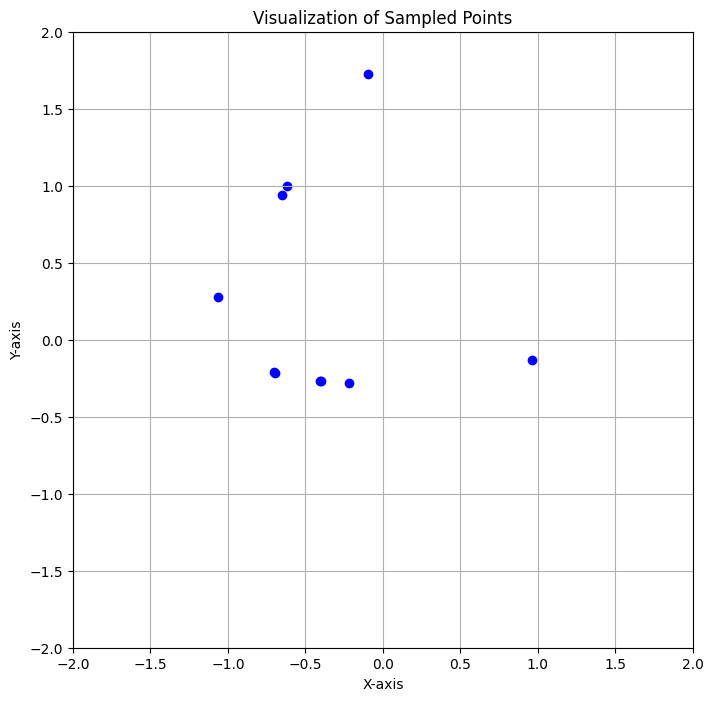

In [91]:
# Assuming collected_points is a tensor of shape (n_points, 2) where n_points >= 1000
x_coords = collected_points[:, 0].numpy()  # Extract x-coordinates
y_coords = collected_points[:, 1].numpy()  # Extract y-coordinates

plt.figure(figsize=(8, 8))  # Set the figure size for better visibility
plt.scatter(x_coords, y_coords, color='blue', label='Converged Points')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.xlim(-2, 2)
plt.ylim(-2, 2)
plt.title('Visualization of Sampled Points')
plt.grid(True)
plt.show()

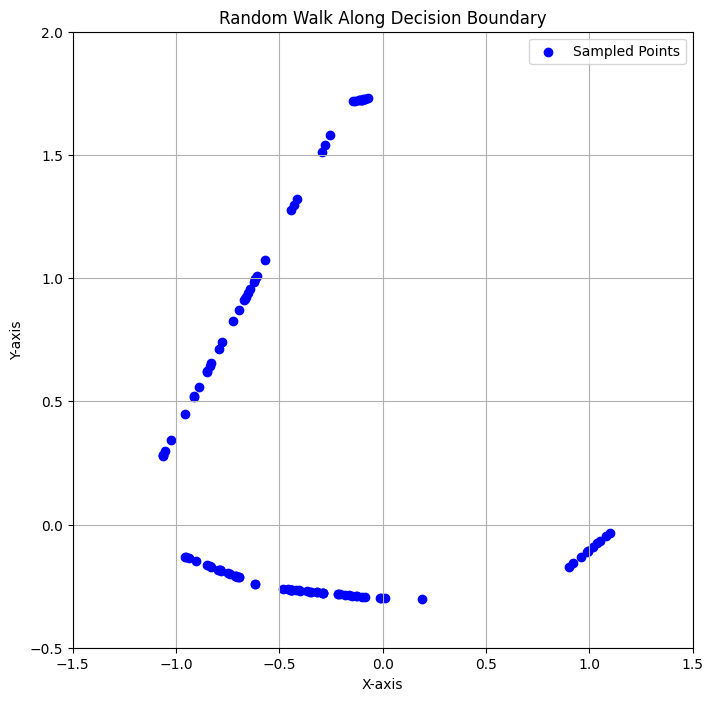

In [92]:
def remove_component_along_direction(a, b):
    projection = (torch.dot(a, b) / torch.dot(b, b)) * b
    return a - projection

def compute_input_gradient(net, input_point):
    input_point = input_point.clone().detach().requires_grad_(True)
    output = net(input_point.unsqueeze(0))
    output.backward()
    gradient = input_point.grad
    return gradient

def random_walk_along_boundary(net, input_tensor, k, learning_rate=0.001, threshold=0.01):
    all_sampled_points = []
    
    for x in input_tensor:
        current_point = x.clone().detach()
        points_collected = [current_point]
        
        while len(points_collected) < k + 1:  # +1 because we start with the initial point
            # Generate random perturbation
            perturbation = torch.randn(2)
            step_size = torch.rand(1).item()
            perturbation = step_size * (perturbation / torch.norm(perturbation))
            
            # Compute gradient vector of f with respect to x
            gradient = compute_input_gradient(net, current_point)
            
            # Compute actual perturbation
            actual_perturbation = remove_component_along_direction(perturbation, gradient)
            
            # Update point to y
            y = current_point + actual_perturbation
            
            #Perform gradient descent to bring y close to decision boundary
            #y = y.clone().detach().requires_grad_(True)
            #optimizer = optim.SGD([y], lr=learning_rate)
            
            #while True:
                #optimizer.zero_grad()
                #output = net(y.unsqueeze(0))
                #loss = torch.abs(output)
                #loss.backward()
                #optimizer.step()
                
                #if loss.item() < threshold:
                    #break
            
            #y = y.clone().detach()
            
            # Check if the point is within the range [-1.5, 1.5] x [-0.5, 2]
            if -1.5 <= y[0].item() <= 1.5 and -0.5 <= y[1].item() <= 2 and -0.3 <= net(y.unsqueeze(0)).item() <= 0.3:
                current_point = y
                points_collected.append(current_point)
            else:
                current_point = x.clone().detach()
        
        all_sampled_points.extend(points_collected)
    
    return torch.stack(all_sampled_points)

# Example usage
# Assuming net is your trained neural network and input_tensor is a tensor of 2D points
input_tensor = collected_points  # Example input tensor
sampled_points = random_walk_along_boundary(net_4, input_tensor, k=10)

# Visualize the sampled points
x_coords = sampled_points[:, 0].numpy()
y_coords = sampled_points[:, 1].numpy()

plt.figure(figsize=(8, 8))
plt.scatter(x_coords, y_coords, color='blue', label='Sampled Points')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.xlim(-1.5, 1.5)
plt.ylim(-0.5, 2)
plt.title('Random Walk Along Decision Boundary')
plt.grid(True)
plt.legend()
plt.show()

In [93]:
def update_data(dataset_train, collected_points):
    x0 = collected_points[:, 0].flatten()
    y0 = collected_points[:, 1].flatten()
    labels = [0 for i in range(len(x0))]
    data = {'x0': x0, 'y0': y0, 'attracted': labels}
    df_new = pd.DataFrame(data)
    dataset_train.data = pd.concat([dataset_train.data, df_new], ignore_index=True)
    return dataset_train

In [94]:
class QuadraticHingeLossAdaptive(nn.Module):
    def __init__(self):
        super(QuadraticHingeLossAdaptive, self).__init__()

    def forward(self, y_pred, y_true):
        loss = nn.functional.relu(1-y_true * y_pred) ** 2
        y_true = torch.abs(y_true)
        loss = loss * y_true
        if y_true.sum() == 0:
            return torch.tensor(0.0)
        mean_loss = loss.sum() / y_true.sum()
        return mean_loss

In [95]:
def train_model_dynamical_adaptive_sub(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                        dataset_validation003, dataset_validation004, 
                        dataset_validation005, dataset_validation010, batchsize, epochs, lr):
    criterion_sqhinge = QuadraticHingeLossAdaptive()
    #criterion_sqhinge = nn.BCEWithLogitsLoss()
    optimizer = Lion(net.parameters(), lr=lr)
    dataloader_train = DataLoader(dataset_train, batch_size=batchsize, shuffle=True)
    dataloader_validation1 = DataLoader(dataset_validation1, batch_size=batchsize, shuffle=False)
    dataloader_validation001 = DataLoader(dataset_validation001, batch_size=batchsize, shuffle=False)
    dataloader_validation002 = DataLoader(dataset_validation002, batch_size=batchsize, shuffle=False)
    dataloader_validation003 = DataLoader(dataset_validation003, batch_size=batchsize, shuffle=False)
    dataloader_validation004 = DataLoader(dataset_validation004, batch_size=batchsize, shuffle=False)
    dataloader_validation005 = DataLoader(dataset_validation005, batch_size=batchsize, shuffle=False)
    dataloader_validation010 = DataLoader(dataset_validation010, batch_size=batchsize, shuffle=False)
    
    training_accuracy_over_epochs = []
    validation1_accuracy_over_epochs = []
    validation001_accuracy_over_epochs = []
    validation002_accuracy_over_epochs = []
    validation003_accuracy_over_epochs = []
    validation004_accuracy_over_epochs = []
    validation005_accuracy_over_epochs = []
    validation010_accuracy_over_epochs = []
    training_loss_dynamical_over_epochs = []
    validation1_loss_dynamical_over_epochs = []
    validation001_loss_dynamical_over_epochs = []
    validation002_loss_dynamical_over_epochs = []
    validation003_loss_dynamical_over_epochs = []
    validation004_loss_dynamical_over_epochs = []
    validation005_loss_dynamical_over_epochs = []
    validation010_loss_dynamical_over_epochs = []
    training_loss_hinge_over_epochs = []
    validation1_loss_hinge_over_epochs = []
    validation001_loss_hinge_over_epochs = []
    validation002_loss_hinge_over_epochs = []
    validation003_loss_hinge_over_epochs = []
    validation004_loss_hinge_over_epochs = []
    validation005_loss_hinge_over_epochs = []
    validation010_loss_hinge_over_epochs = []
    
    overall_progress = tqdm(total=epochs, desc='Overall Training Progress')
    
    for epoch in range(epochs):
        net.train()
        correct_train = 0
        total_train = 0
        avg_loss_train_dynamical = 0
        avg_loss_train_hinge = 0
        for features, labels in dataloader_train:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            optimizer.zero_grad()
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1 ##scale to -1, 1
            #predicted = (outputs > 0).float()
            labels_nonzero_mask = (labels != 0)
            labels_nonzero = labels[labels_nonzero_mask]
            predicted_nonzero = predicted[labels_nonzero_mask]
            correct_train += (predicted_nonzero == labels_nonzero).sum().item()
            total_train += labels_nonzero.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            loss = 0.01*loss_dynamic + 1*loss_hinge # C=constant
            avg_loss_train_dynamical += loss_dynamic.item()
            avg_loss_train_hinge += loss_hinge.item()
            loss.backward()
            optimizer.step()
    
                    
        training_accuracy = correct_train / total_train
        training_loss_dynamical = avg_loss_train_dynamical / len(dataloader_train)
        training_loss_hinge = avg_loss_train_hinge / len(dataloader_train)
        training_accuracy_over_epochs.append(training_accuracy)
        training_loss_dynamical_over_epochs.append(training_loss_dynamical)
        training_loss_hinge_over_epochs.append(training_loss_hinge)


        net.eval()
        correct_validation1 = 0
        total_validation1 = 0
        avg_loss_validation1_dynamical = 0
        avg_loss_validation1_hinge = 0
        for features, labels in dataloader_validation1:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation1 += (predicted == labels).sum().item()
            total_validation1 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            #loss = loss_dynamic + loss_hinge
            avg_loss_validation1_dynamical += loss_dynamic.item()
            avg_loss_validation1_hinge += loss_hinge.item()
        
        validation1_accuracy = correct_validation1 / total_validation1
        validation1_accuracy_over_epochs.append(validation1_accuracy)
        validation1_loss_dynamical = avg_loss_validation1_dynamical / len(dataloader_validation1)
        validation1_loss_dynamical_over_epochs.append(validation1_loss_dynamical)
        validation1_loss_hinge = avg_loss_validation1_hinge / len(dataloader_validation1)
        validation1_loss_hinge_over_epochs.append(validation1_loss_hinge)

        correct_validation001 = 0
        total_validation001 = 0
        avg_loss_validation001_dynamical = 0
        avg_loss_validation001_hinge = 0
        for features, labels in dataloader_validation001:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation001 += (predicted == labels).sum().item()
            total_validation001 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation001_dynamical += loss_dynamic.item()
            avg_loss_validation001_hinge += loss_hinge.item()
        
        validation001_accuracy = correct_validation001 / total_validation001
        validation001_accuracy_over_epochs.append(validation001_accuracy)
        validation001_loss_dynamical = avg_loss_validation001_dynamical / len(dataloader_validation001)
        validation001_loss_dynamical_over_epochs.append(validation001_loss_dynamical)
        validation001_loss_hinge = avg_loss_validation001_hinge / len(dataloader_validation001)
        validation001_loss_hinge_over_epochs.append(validation001_loss_hinge)

        correct_validation002 = 0
        total_validation002 = 0
        avg_loss_validation002_dynamical = 0
        avg_loss_validation002_hinge = 0
        for features, labels in dataloader_validation002:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation002 += (predicted == labels).sum().item()
            total_validation002 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation002_dynamical += loss_dynamic.item()
            avg_loss_validation002_hinge += loss_hinge.item()
        
        validation002_accuracy = correct_validation002 / total_validation002
        validation002_accuracy_over_epochs.append(validation002_accuracy)
        validation002_loss_dynamical = avg_loss_validation002_dynamical / len(dataloader_validation002)
        validation002_loss_dynamical_over_epochs.append(validation002_loss_dynamical)
        validation002_loss_hinge = avg_loss_validation002_hinge / len(dataloader_validation002)
        validation002_loss_hinge_over_epochs.append(validation002_loss_hinge)

        correct_validation003 = 0
        total_validation003 = 0
        avg_loss_validation003_dynamical = 0
        avg_loss_validation003_hinge = 0
        for features, labels in dataloader_validation003:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation003 += (predicted == labels).sum().item()
            total_validation003 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation003_dynamical += loss_dynamic.item()
            avg_loss_validation003_hinge += loss_hinge.item()
        
        validation003_accuracy = correct_validation003 / total_validation003
        validation003_accuracy_over_epochs.append(validation003_accuracy)
        validation003_loss_dynamical = avg_loss_validation003_dynamical / len(dataloader_validation003)
        validation003_loss_dynamical_over_epochs.append(validation003_loss_dynamical)
        validation003_loss_hinge = avg_loss_validation003_hinge / len(dataloader_validation003)
        validation003_loss_hinge_over_epochs.append(validation003_loss_hinge)

        correct_validation004 = 0
        total_validation004 = 0
        avg_loss_validation004_dynamical = 0
        avg_loss_validation004_hinge = 0
        for features, labels in dataloader_validation004:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation004 += (predicted == labels).sum().item()
            total_validation004 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation004_dynamical += loss_dynamic.item()
            avg_loss_validation004_hinge += loss_hinge.item()
        
        validation004_accuracy = correct_validation004 / total_validation004
        validation004_accuracy_over_epochs.append(validation004_accuracy)
        validation004_loss_dynamical = avg_loss_validation004_dynamical / len(dataloader_validation004)
        validation004_loss_dynamical_over_epochs.append(validation004_loss_dynamical)
        validation004_loss_hinge = avg_loss_validation004_hinge / len(dataloader_validation004)
        validation004_loss_hinge_over_epochs.append(validation004_loss_hinge)

        correct_validation005 = 0
        total_validation005 = 0
        avg_loss_validation005_dynamical = 0
        avg_loss_validation005_hinge = 0
        for features, labels in dataloader_validation005:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation005 += (predicted == labels).sum().item()
            total_validation005 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation005_dynamical += loss_dynamic.item()
            avg_loss_validation005_hinge += loss_hinge.item()
        
        validation005_accuracy = correct_validation005 / total_validation005
        validation005_accuracy_over_epochs.append(validation005_accuracy)
        validation005_loss_dynamical = avg_loss_validation005_dynamical / len(dataloader_validation005)
        validation005_loss_dynamical_over_epochs.append(validation005_loss_dynamical)
        validation005_loss_hinge = avg_loss_validation005_hinge / len(dataloader_validation005)
        validation005_loss_hinge_over_epochs.append(validation005_loss_hinge)

        correct_validation010 = 0
        total_validation010 = 0
        avg_loss_validation010_dynamical = 0
        avg_loss_validation010_hinge = 0
        for features, labels in dataloader_validation010:
            #labels = ((labels + 1) / 2).float()
            features.requires_grad = True
            labels = labels.view(-1)
            outputs = net(features).view(-1)
            predicted = ((outputs > 0).float() * 2) - 1
            #predicted = (outputs > 0).float()
            correct_validation010 += (predicted == labels).sum().item()
            total_validation010 += labels.size(0)
            loss_dynamic = custom_loss_function(net, features)
            loss_hinge =  criterion_sqhinge(outputs, labels)
            avg_loss_validation010_dynamical += loss_dynamic.item()
            avg_loss_validation010_hinge += loss_hinge.item()
        
        validation010_accuracy = correct_validation010 / total_validation010
        validation010_accuracy_over_epochs.append(validation010_accuracy)
        validation010_loss_dynamical = avg_loss_validation010_dynamical / len(dataloader_validation010)
        validation010_loss_dynamical_over_epochs.append(validation010_loss_dynamical)
        validation010_loss_hinge = avg_loss_validation010_hinge / len(dataloader_validation010)
        validation010_loss_hinge_over_epochs.append(validation010_loss_hinge)
        
        overall_progress.update(1)
        #overall_progress.set_postfix({'Training Accuracy': training_accuracy, 'Validation1 Accuracy': validation1_accuracy, 'Validation2 Accuracy': validation2_accuracy})
        overall_progress.set_postfix({'Training Accuracy': training_accuracy,
                                        'Validation1 Accuracy': validation1_accuracy,
                                         'Validation001 Accuracy': validation001_accuracy, 
                                         'Validation002 Accuracy': validation002_accuracy, 
                                         'Validation003 Accuracy': validation003_accuracy, 
                                         'Validation004 Accuracy': validation004_accuracy, 
                                         'Validation005 Accuracy': validation005_accuracy, 
                                         'Validation010 Accuracy': validation010_accuracy})
    
    overall_progress.close()
    
    plt.figure(figsize=(10, 6))
    plt.plot(training_accuracy_over_epochs, label='Training')
    plt.plot(validation1_accuracy_over_epochs, label='Uniform')
    plt.plot(validation001_accuracy_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_accuracy_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_accuracy_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_accuracy_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_accuracy_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_accuracy_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.legend()
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_dynamical_over_epochs, label='Training')
    plt.plot(validation1_loss_dynamical_over_epochs, label='Uniform')
    plt.plot(validation001_loss_dynamical_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_dynamical_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_dynamical_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_dynamical_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_dynamical_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_dynamical_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Dynamical Loss Over Epochs')
    plt.legend()
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.plot(training_loss_hinge_over_epochs, label='Training')
    plt.plot(validation1_loss_hinge_over_epochs, label='Uniform')
    plt.plot(validation001_loss_hinge_over_epochs, label='$\delta$=0.01')
    plt.plot(validation002_loss_hinge_over_epochs, label='$\delta$=0.02')
    plt.plot(validation003_loss_hinge_over_epochs, label='$\delta$=0.03')
    plt.plot(validation004_loss_hinge_over_epochs, label='$\delta$=0.04')
    plt.plot(validation005_loss_hinge_over_epochs, label='$\delta$=0.05')
    plt.plot(validation010_loss_hinge_over_epochs, label='$\delta$=0.10')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Square Hinge Loss Over Epochs')
    plt.legend()
    plt.show()
    
    #test_model(net, dataset_train)
    test_model(net, dataset_validation1)
    test_model(net, dataset_validation001)
    test_model(net, dataset_validation002)
    test_model(net, dataset_validation003)
    test_model(net, dataset_validation004)
    test_model(net, dataset_validation005)
    test_model(net, dataset_validation010)

    plot_contour(net)

In [96]:
def train_model_dynamical_adaptive(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                        dataset_validation003, dataset_validation004, 
                        dataset_validation005, dataset_validation010, batchsize, epochs, lr, iterations=20):
    C = 1
    for i in range(iterations):
        if (i > 0):
            epochs = 400
        train_model_dynamical_adaptive_sub(net, dataset_train, dataset_validation1, dataset_validation001, dataset_validation002,
                        dataset_validation003, dataset_validation004, 
                        dataset_validation005, dataset_validation010, batchsize, epochs, C*lr)
        collected_points = collect_converged_points_without_noise(net, target_count=20)
        collected_data = random_walk_along_boundary(net, collected_points, k=10)
        dataset_train = update_data(dataset_train, collected_data)
        #C = C * 0.9

Overall Training Progress: 100%|██████████| 1000/1000 [36:10<00:00,  2.17s/it, Training Accuracy=0.995, Validation1 Accuracy=0.956, Validation001 Accuracy=0.516, Validation002 Accuracy=0.565, Validation003 Accuracy=0.566, Validation004 Accuracy=0.588, Validation005 Accuracy=0.602, Validation010 Accuracy=0.743]


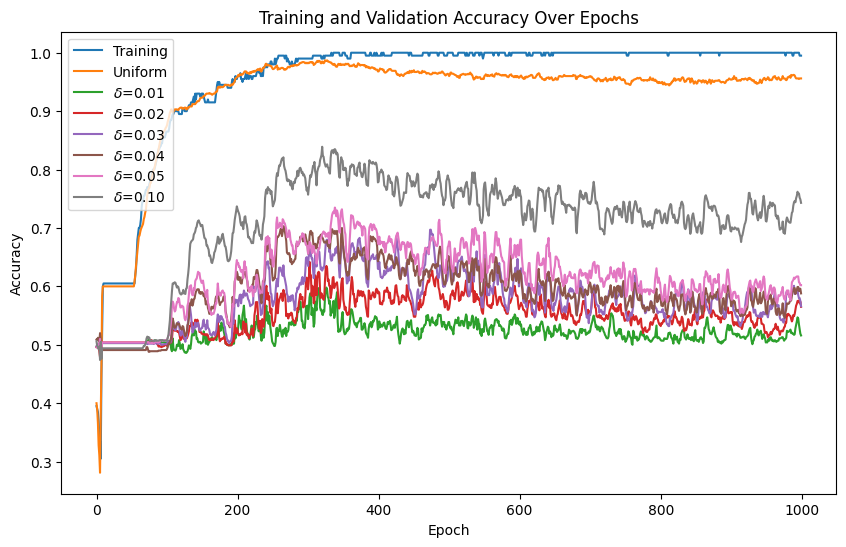

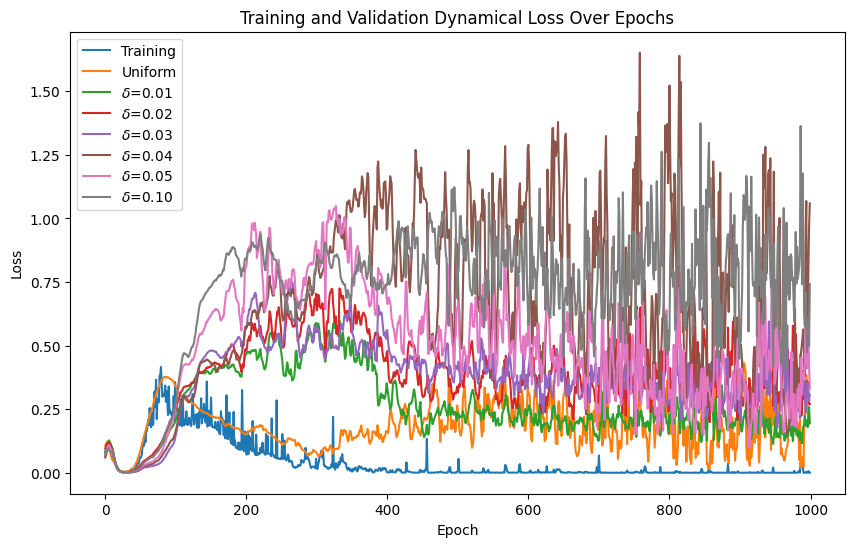

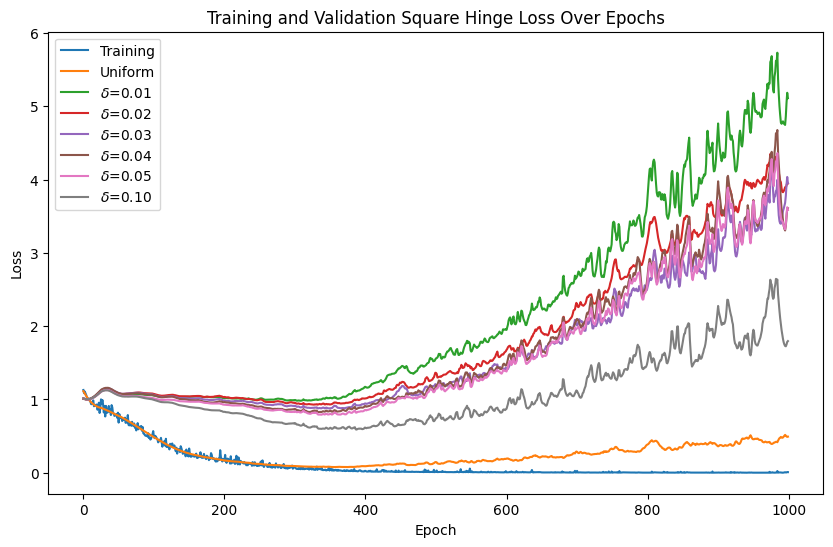

Accuracy: 0.9559999704360962


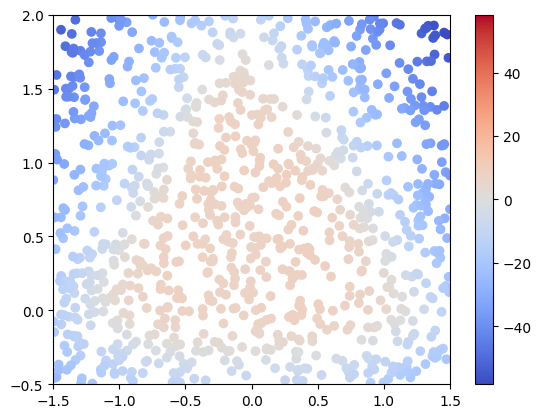

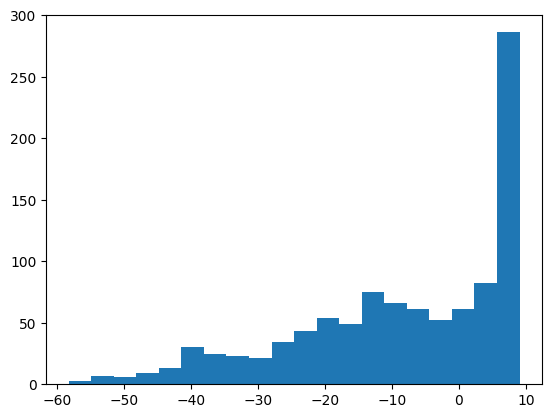

Accuracy: 0.515999972820282


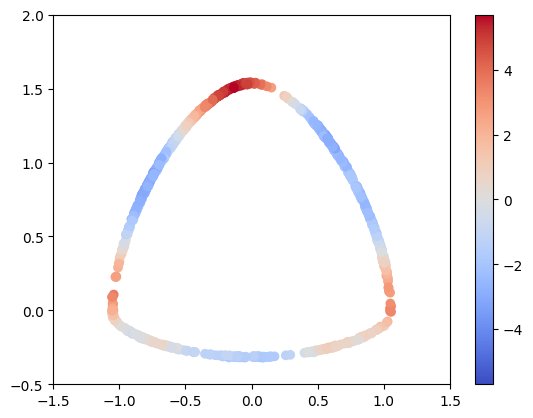

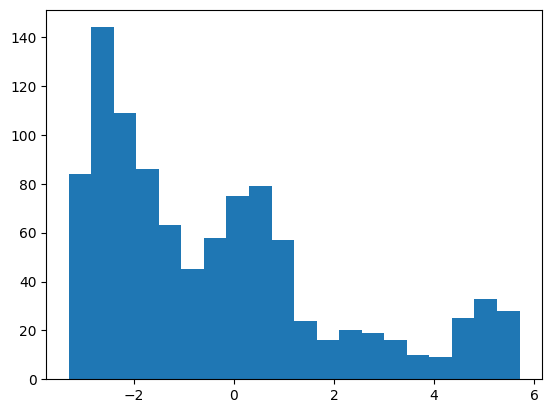

Accuracy: 0.5649999976158142


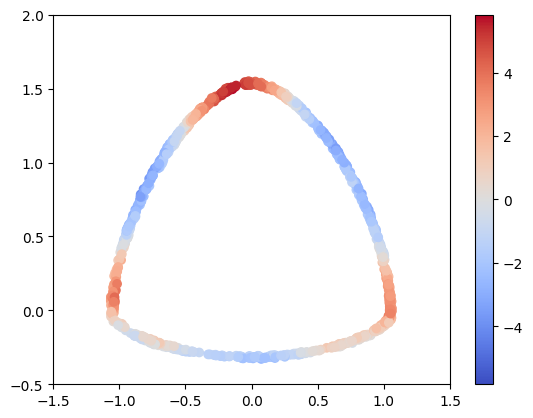

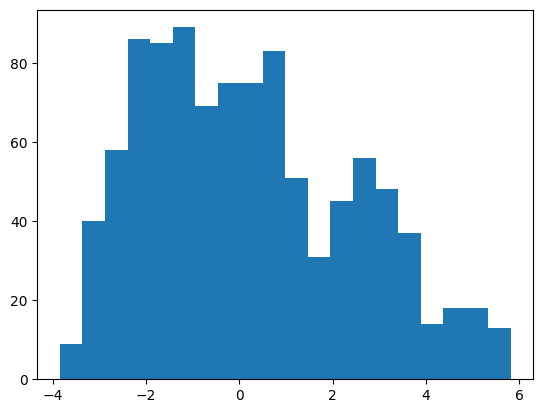

Accuracy: 0.5659999847412109


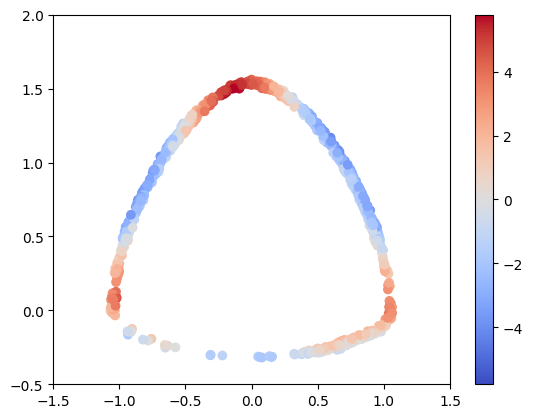

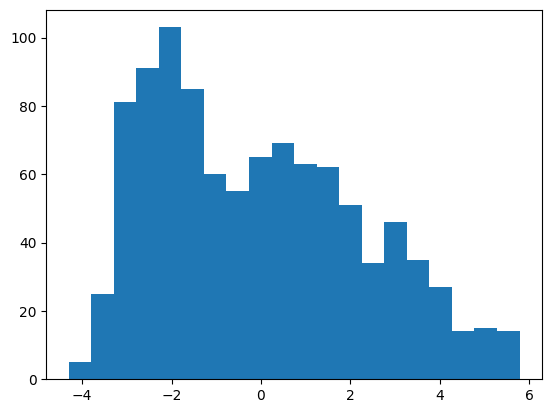

Accuracy: 0.5879999995231628


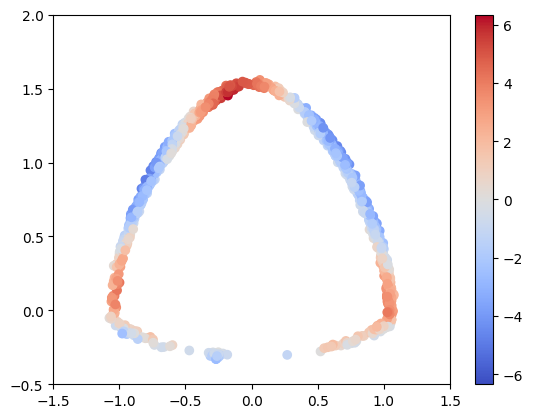

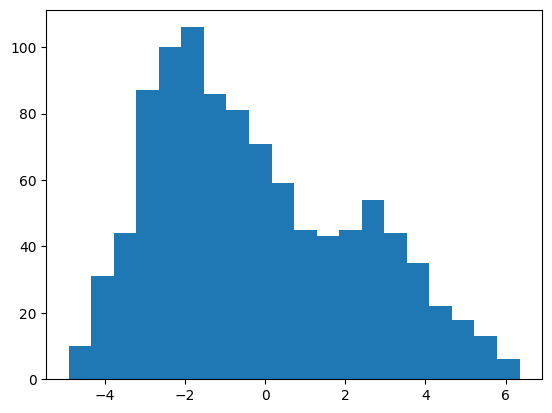

Accuracy: 0.6019999980926514


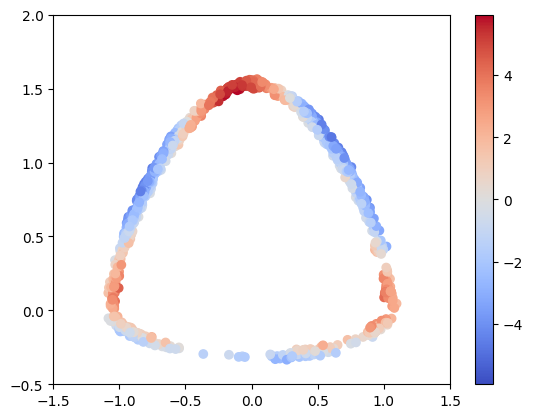

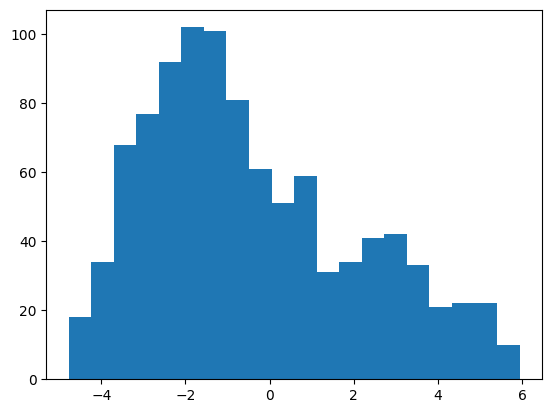

Accuracy: 0.7429999709129333


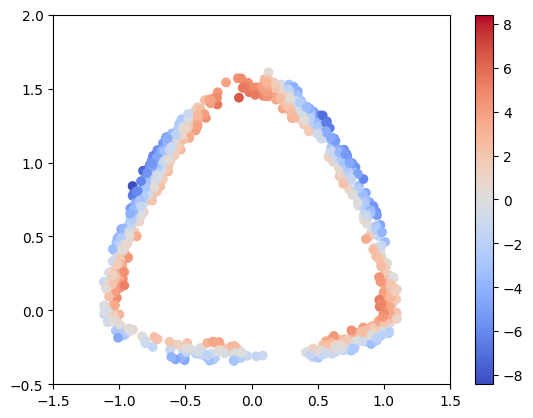

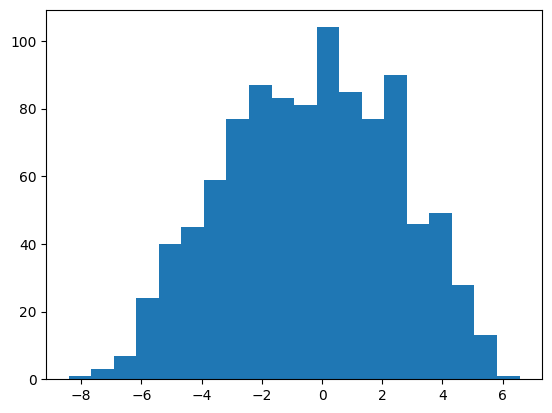

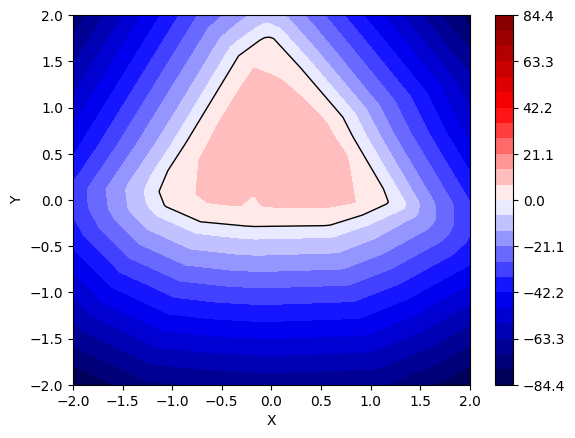

Overall Training Progress: 100%|██████████| 400/400 [15:05<00:00,  2.26s/it, Training Accuracy=1, Validation1 Accuracy=0.949, Validation001 Accuracy=0.51, Validation002 Accuracy=0.566, Validation003 Accuracy=0.548, Validation004 Accuracy=0.544, Validation005 Accuracy=0.593, Validation010 Accuracy=0.694]     


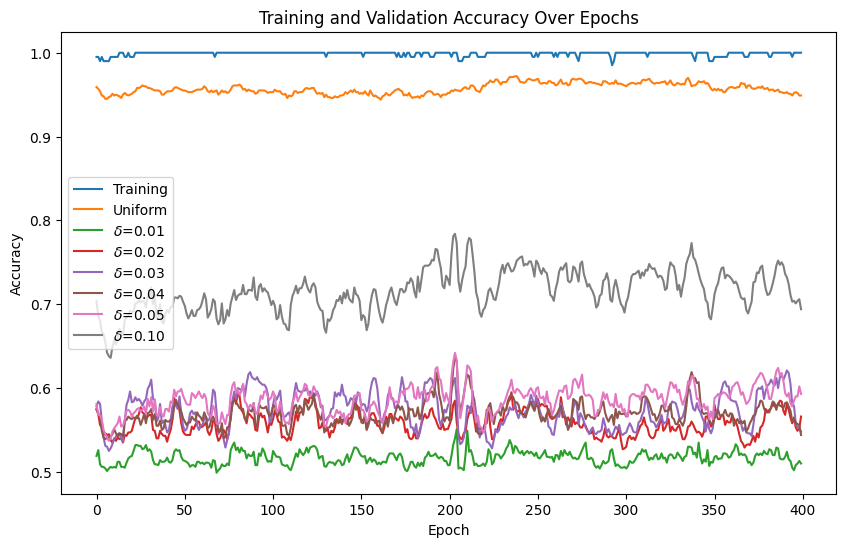

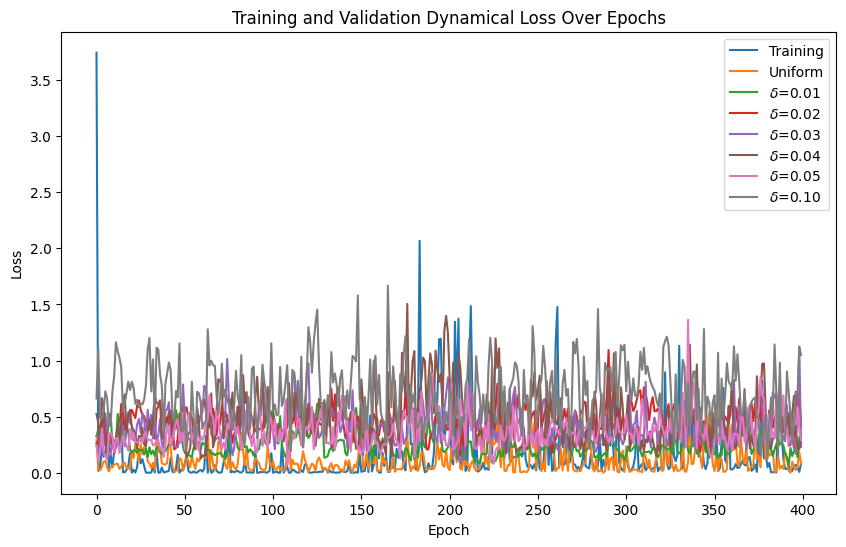

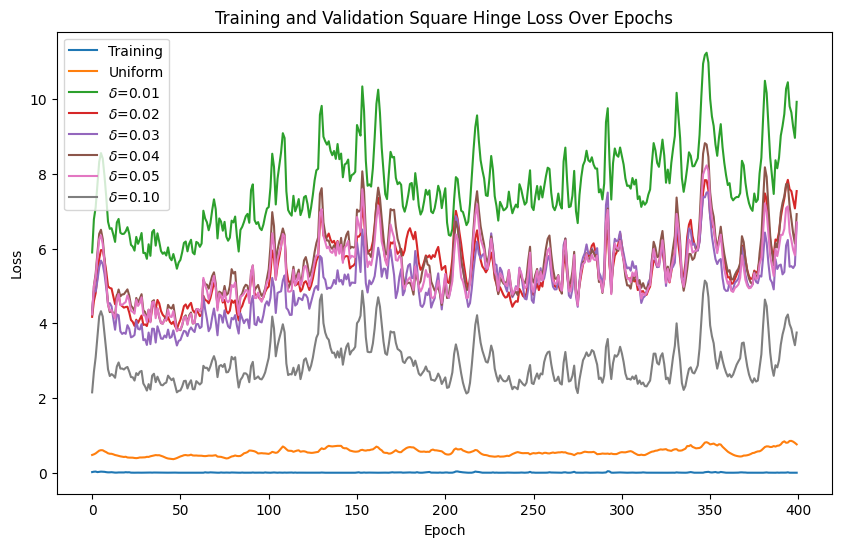

Accuracy: 0.9490000009536743


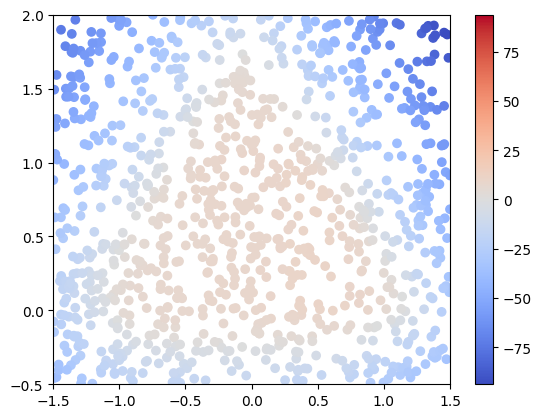

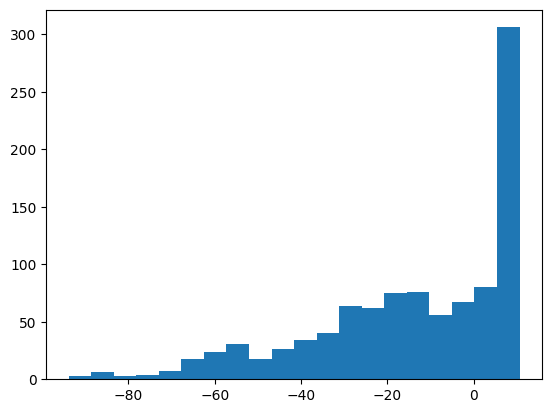

Accuracy: 0.5099999904632568


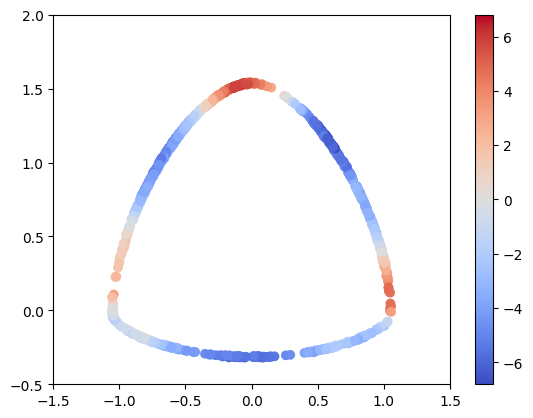

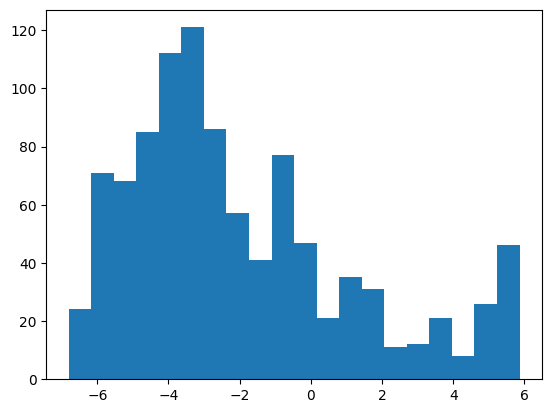

Accuracy: 0.5659999847412109


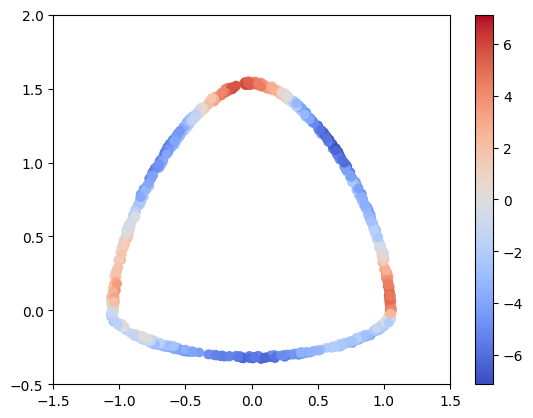

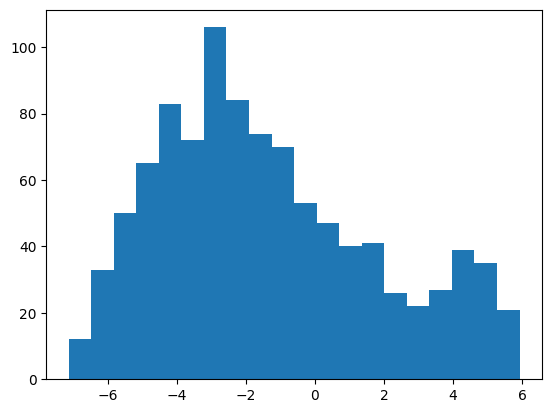

Accuracy: 0.5479999780654907


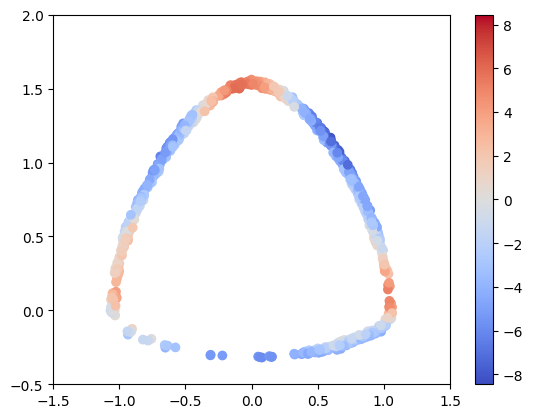

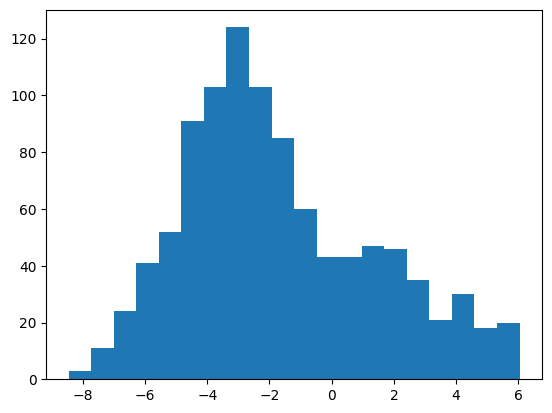

Accuracy: 0.5440000295639038


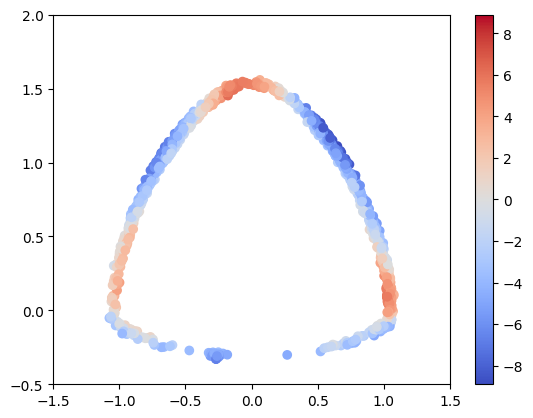

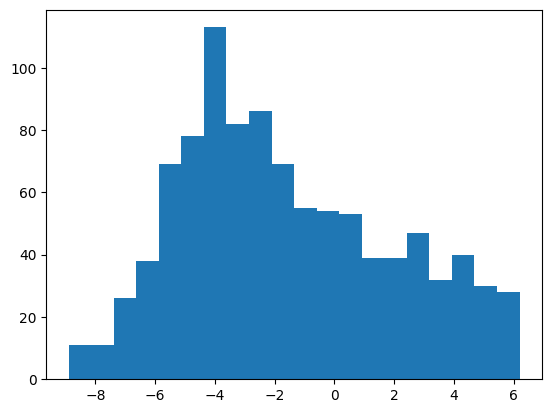

Accuracy: 0.5929999947547913


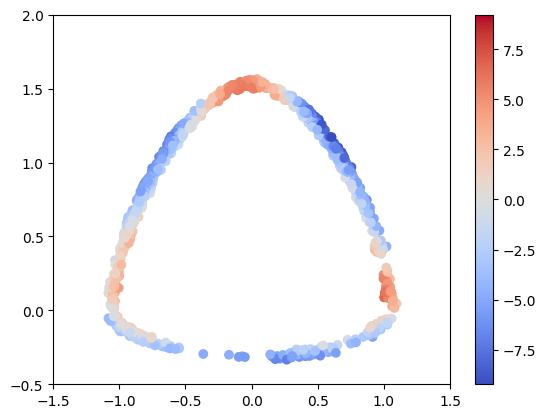

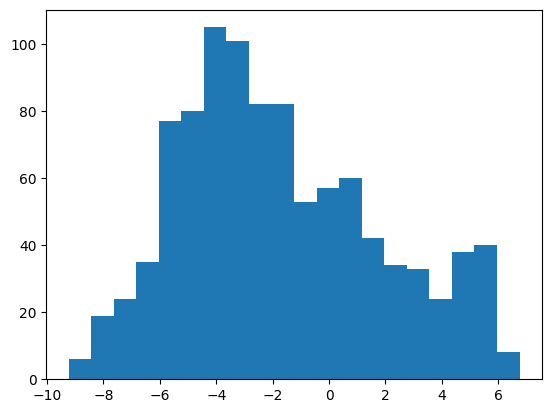

Accuracy: 0.6940000057220459


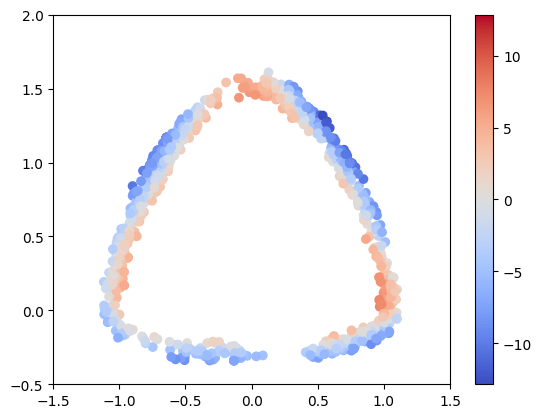

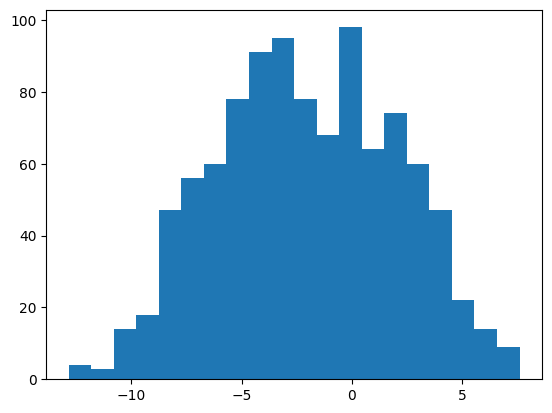

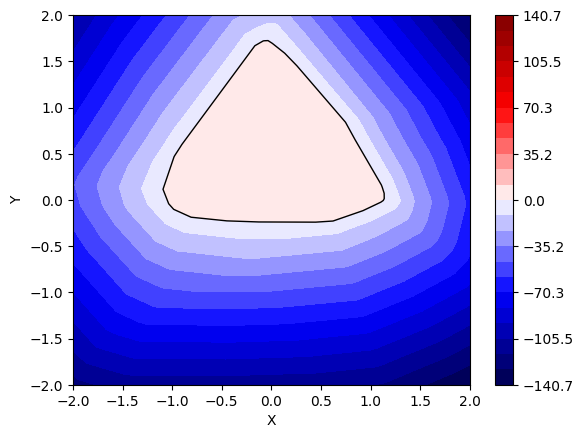

Overall Training Progress:  42%|████▏     | 168/400 [06:44<09:19,  2.41s/it, Training Accuracy=0.995, Validation1 Accuracy=0.967, Validation001 Accuracy=0.522, Validation002 Accuracy=0.539, Validation003 Accuracy=0.569, Validation004 Accuracy=0.574, Validation005 Accuracy=0.583, Validation010 Accuracy=0.733]

KeyboardInterrupt: 

In [97]:
dataset_train_copy = deepcopy(dataset_train)
net_5 = Net()
train_model_dynamical_adaptive(net_5, dataset_train_copy, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1000, lr=0.0005, iterations=5)

Accuracy: 0.9599999785423279


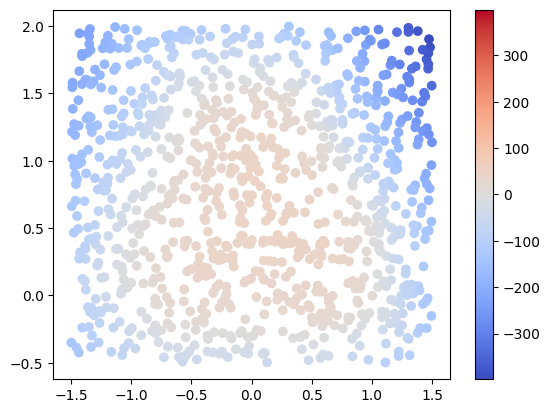

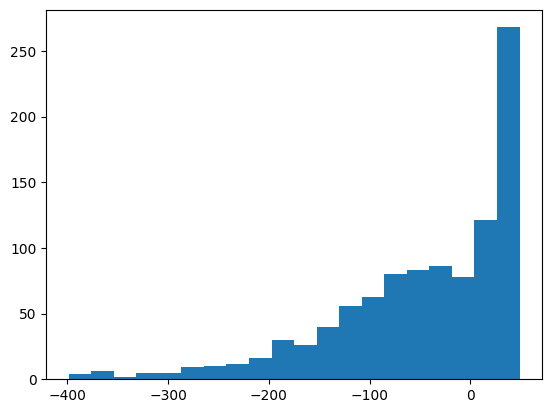

tensor(0.9600)

In [73]:
test_model(net_5, dataset_test_uniform)

Accuracy: 0.5339999794960022


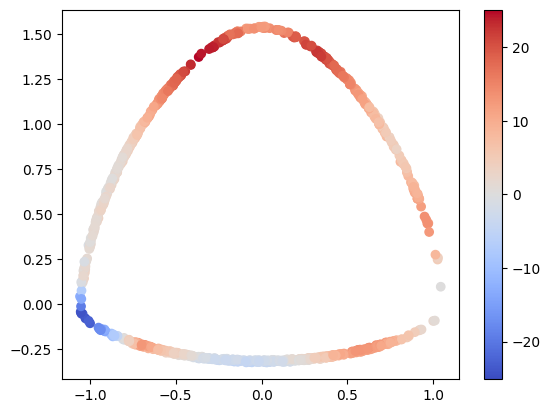

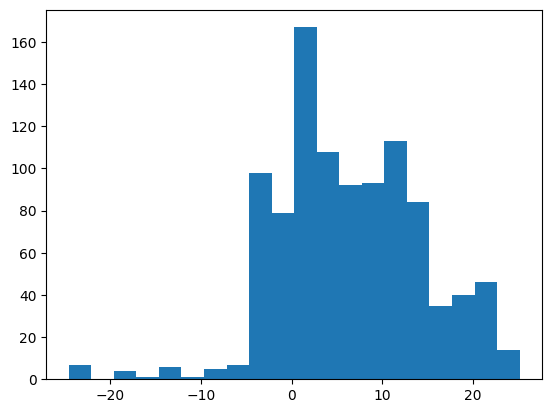

tensor(0.5340)

In [74]:
test_model(net_5, dataset_test_near_001)

Accuracy: 0.5910000205039978


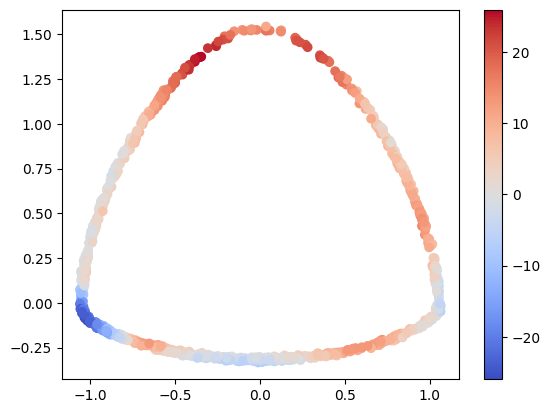

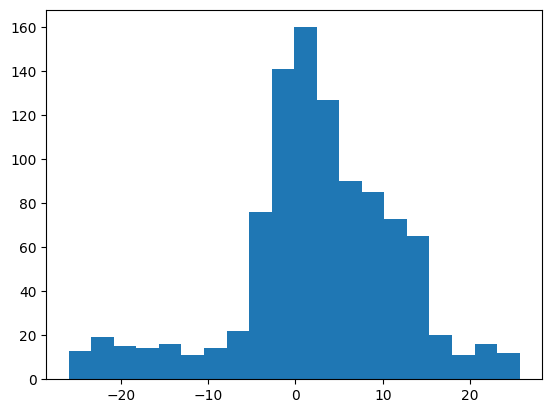

tensor(0.5910)

In [75]:
test_model(net_5, dataset_test_near_002)

Accuracy: 0.628000020980835


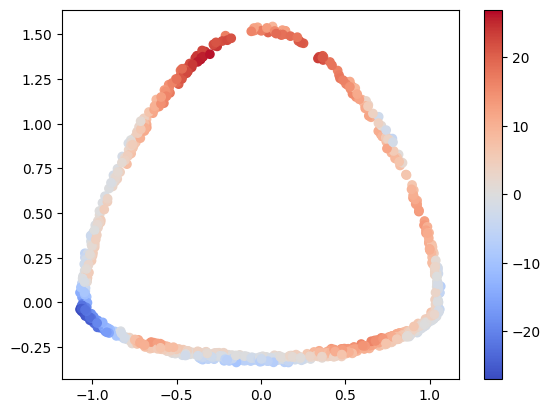

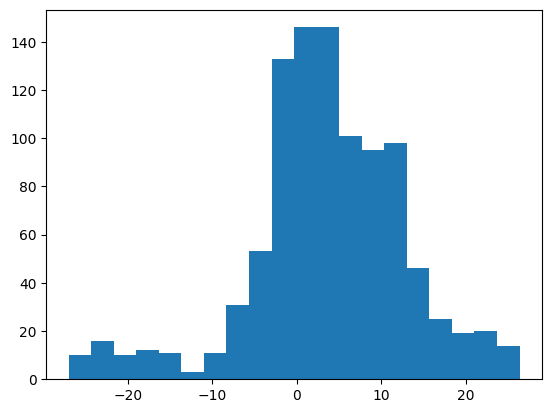

tensor(0.6280)

In [76]:
test_model(net_5, dataset_test_near_003)

Accuracy: 0.6449999809265137


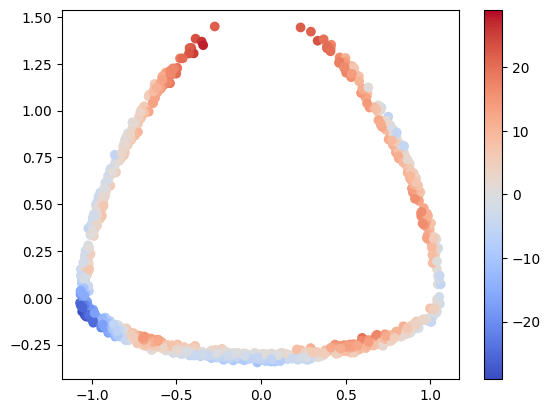

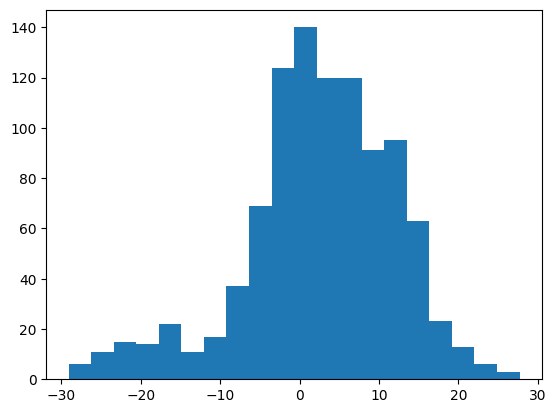

tensor(0.6450)

In [77]:
test_model(net_5, dataset_test_near_004)

Accuracy: 0.671999990940094


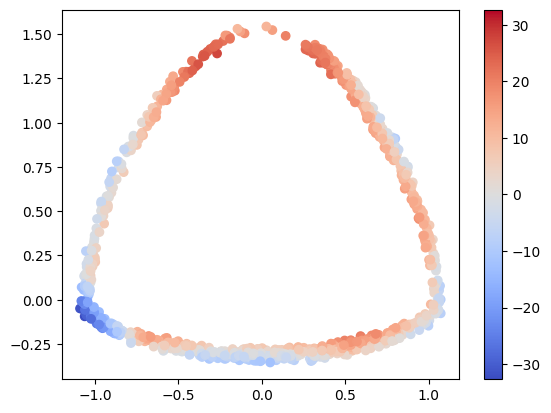

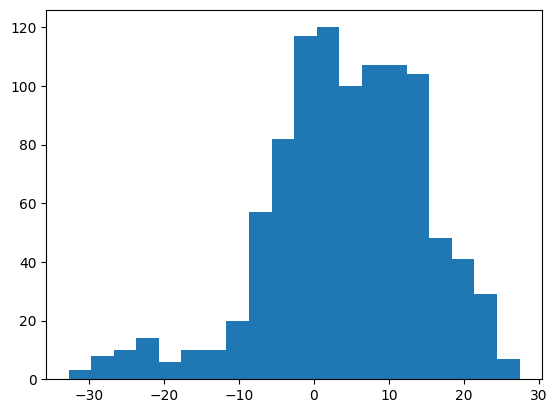

tensor(0.6720)

In [78]:
test_model(net_5, dataset_test_near_005)

Accuracy: 0.7850000262260437


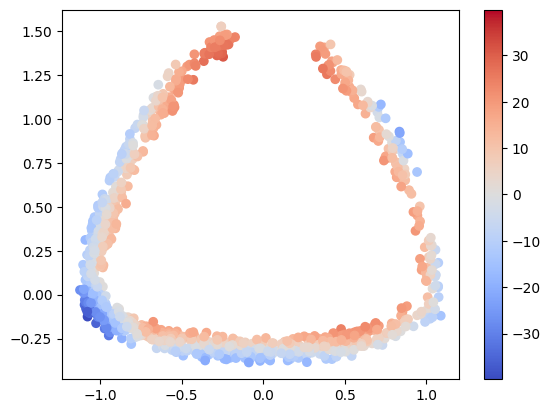

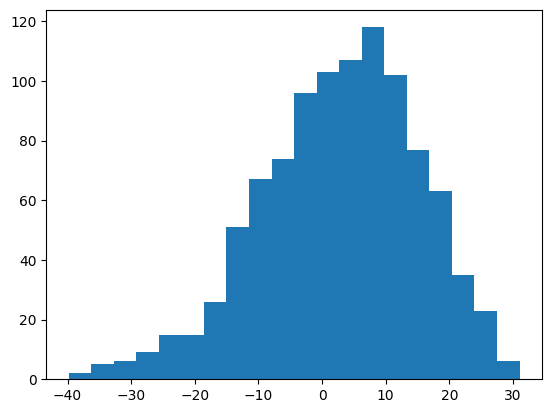

tensor(0.7850)

In [79]:
test_model(net_5, dataset_test_near_010)

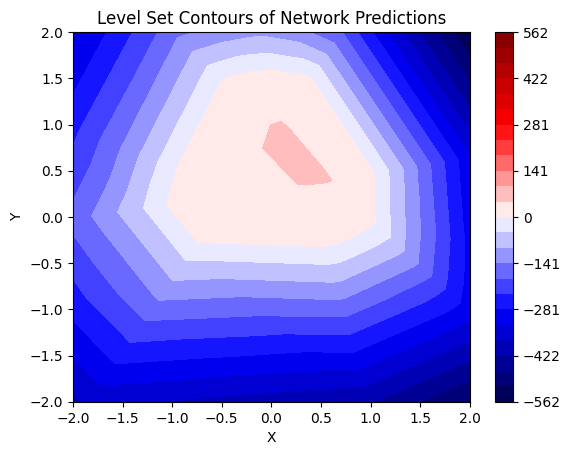

In [80]:
plot_contour(net_5)

Overall Training Progress: 100%|██████████| 1000/1000 [37:40<00:00,  2.26s/it, Training Accuracy=1, Validation1 Accuracy=0.961, Validation001 Accuracy=0.539, Validation002 Accuracy=0.546, Validation003 Accuracy=0.544, Validation004 Accuracy=0.562, Validation005 Accuracy=0.594, Validation010 Accuracy=0.713]   


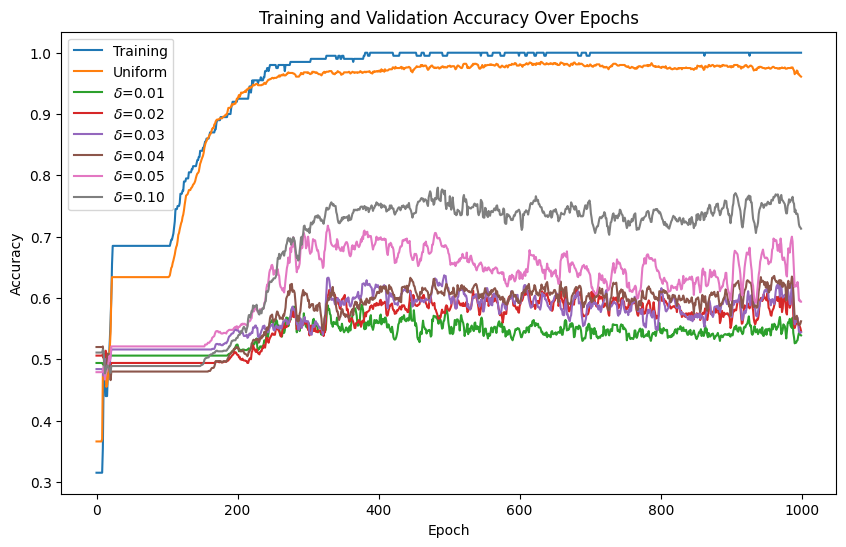

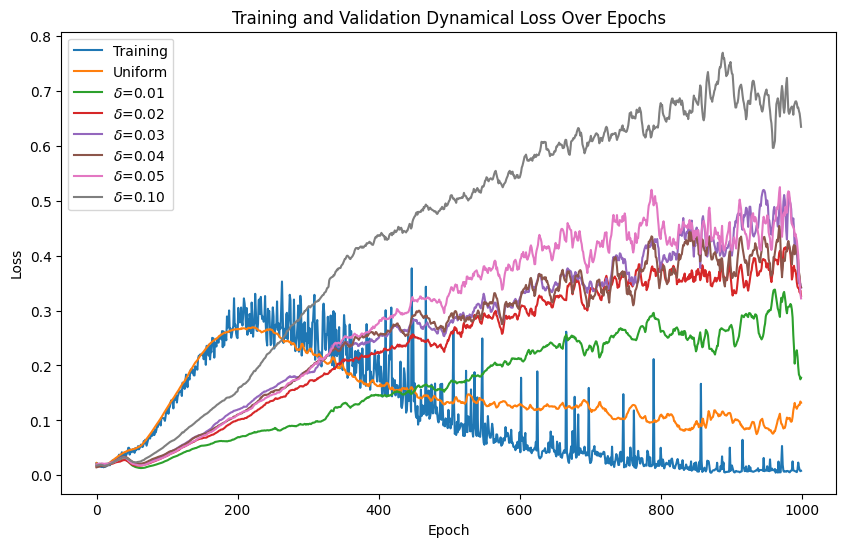

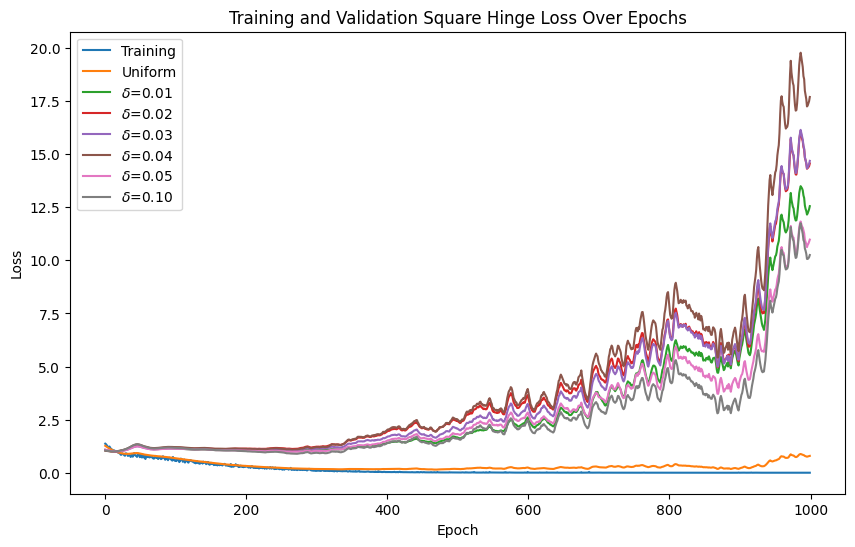

Accuracy: 0.9610000252723694


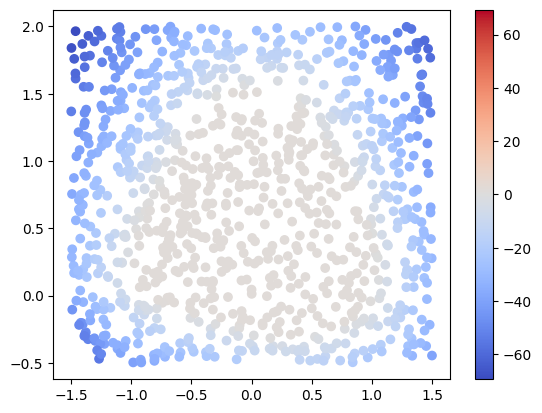

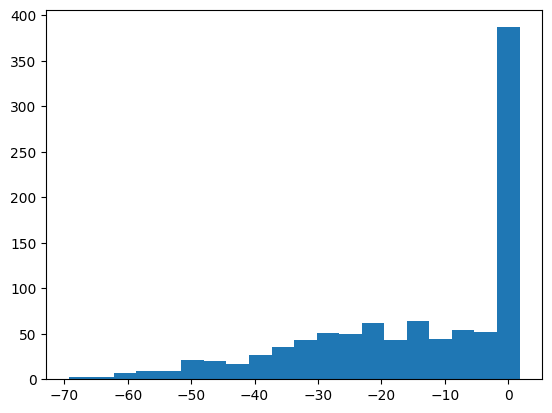

Accuracy: 0.5389999747276306


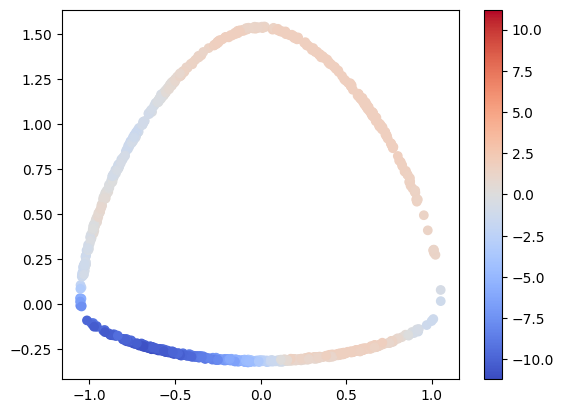

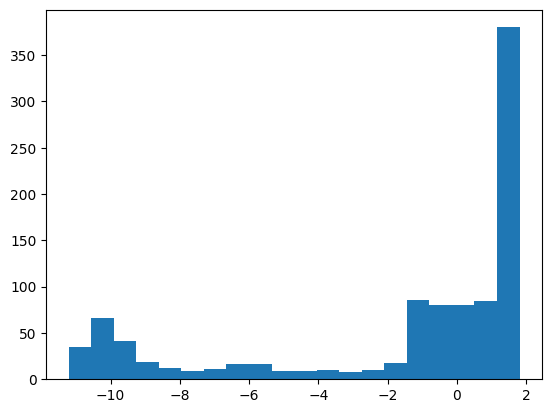

Accuracy: 0.5460000038146973


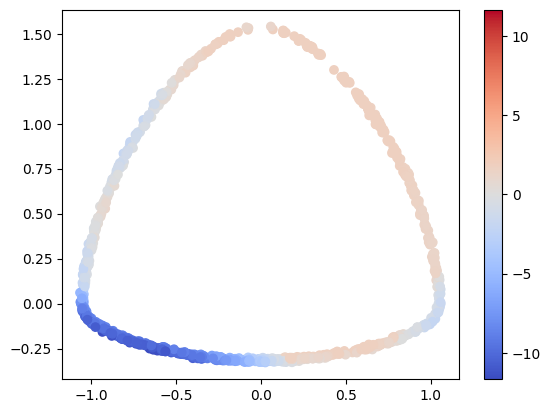

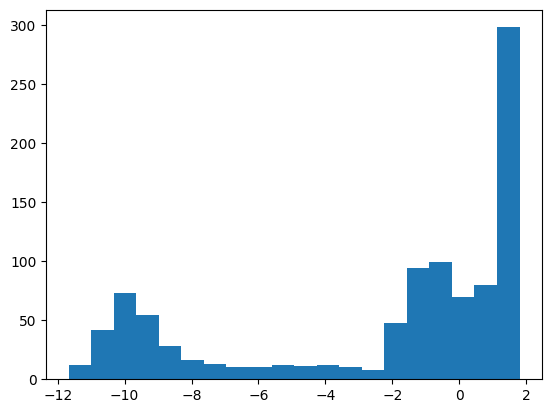

Accuracy: 0.5440000295639038


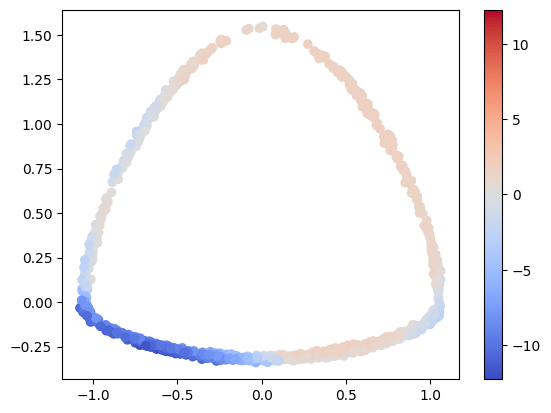

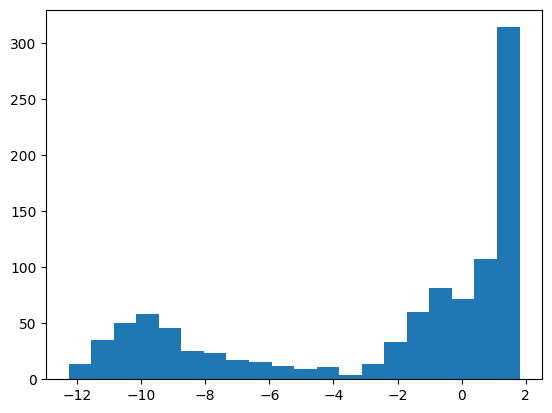

Accuracy: 0.5619999766349792


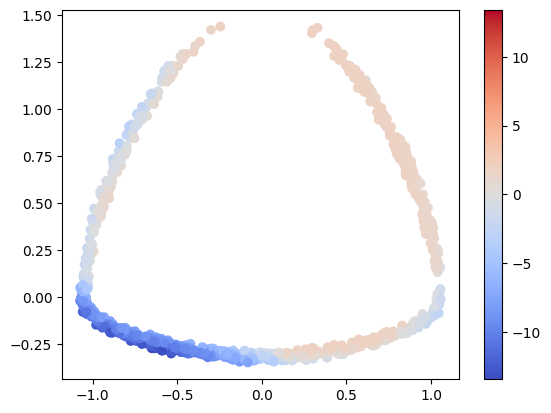

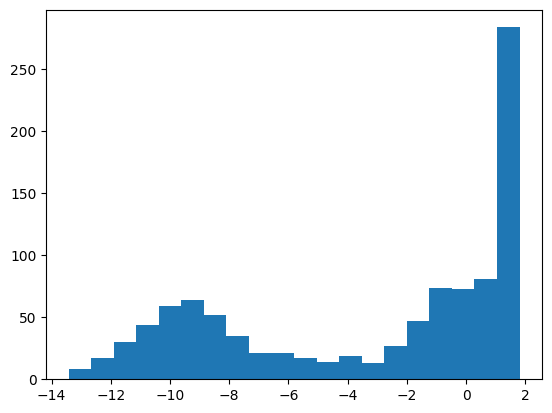

Accuracy: 0.593999981880188


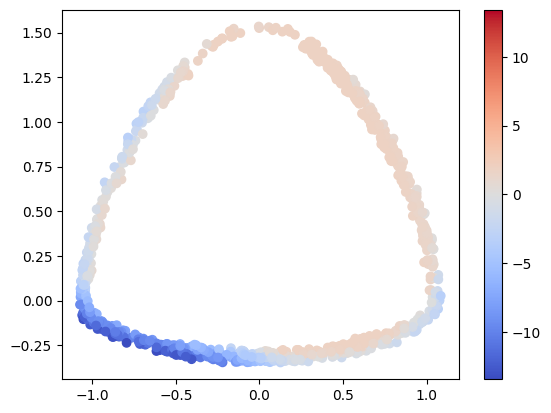

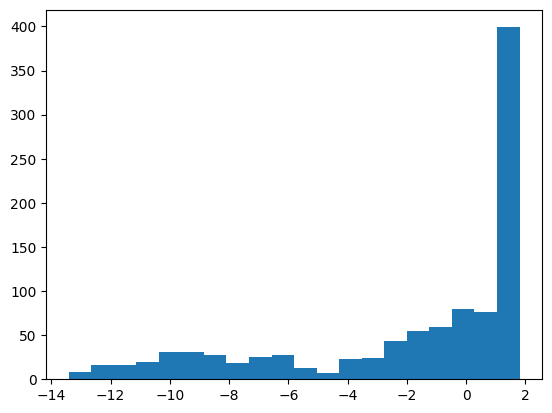

Accuracy: 0.7129999995231628


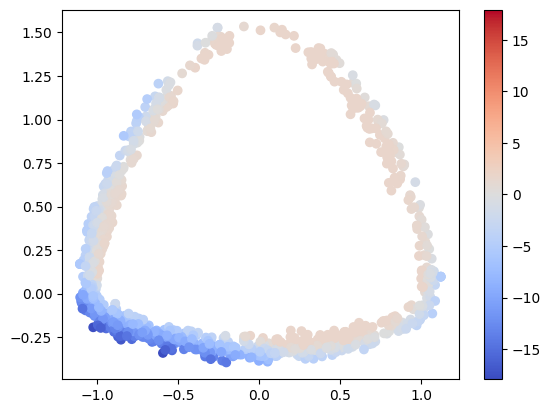

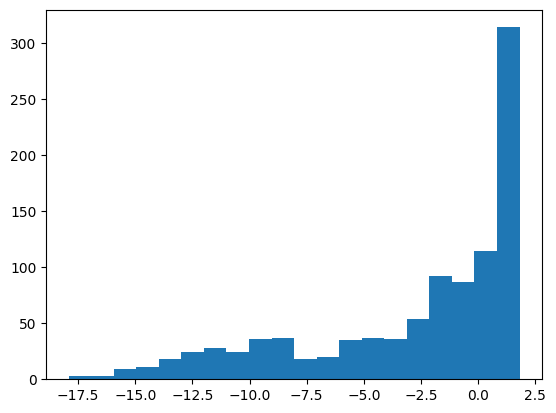

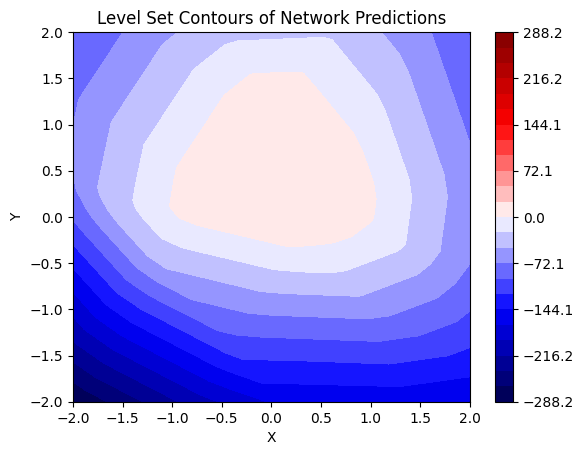

Overall Training Progress: 100%|██████████| 400/400 [15:43<00:00,  2.36s/it, Training Accuracy=1, Validation1 Accuracy=0.96, Validation001 Accuracy=0.582, Validation002 Accuracy=0.592, Validation003 Accuracy=0.649, Validation004 Accuracy=0.626, Validation005 Accuracy=0.657, Validation010 Accuracy=0.717]     


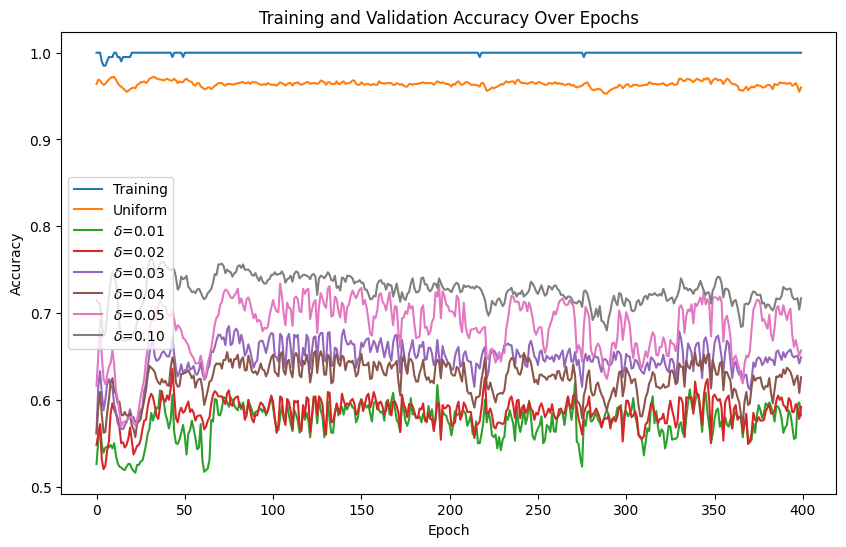

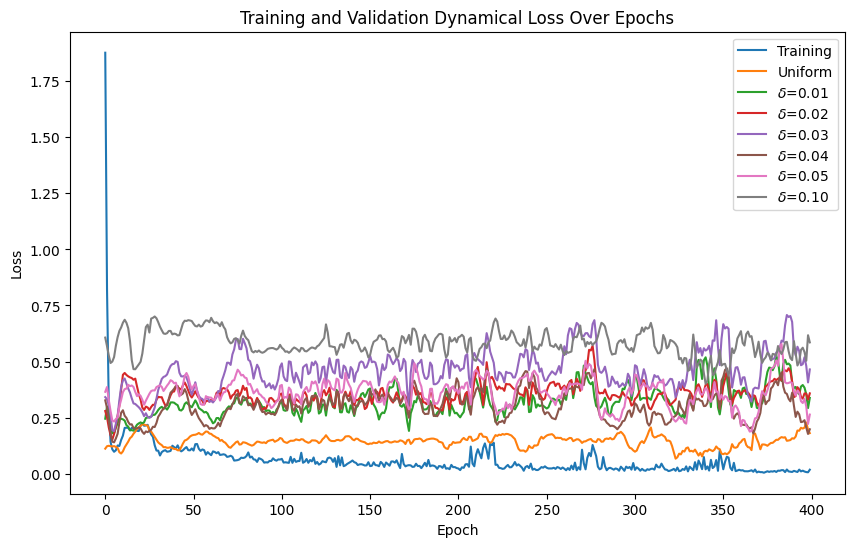

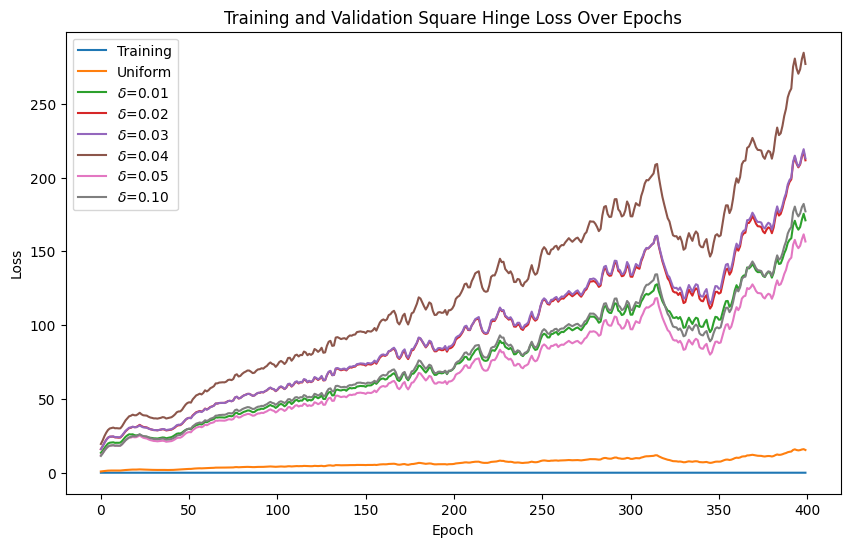

Accuracy: 0.9599999785423279


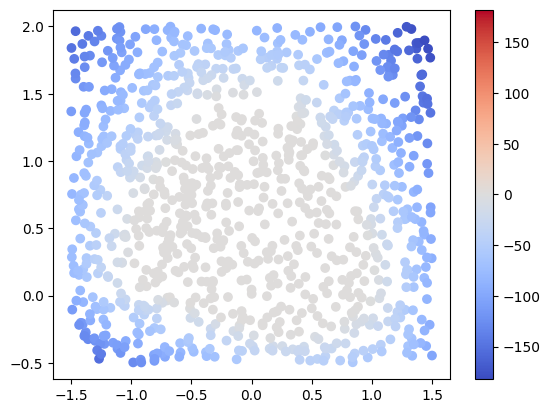

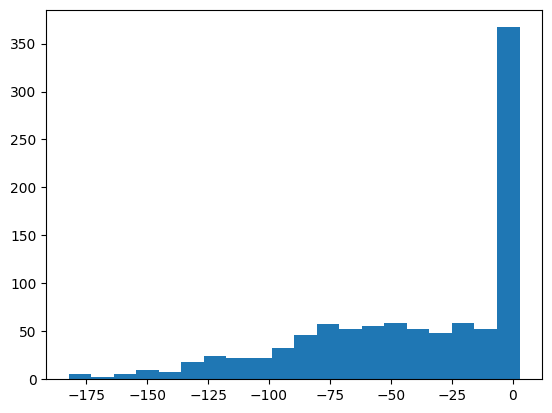

Accuracy: 0.5820000171661377


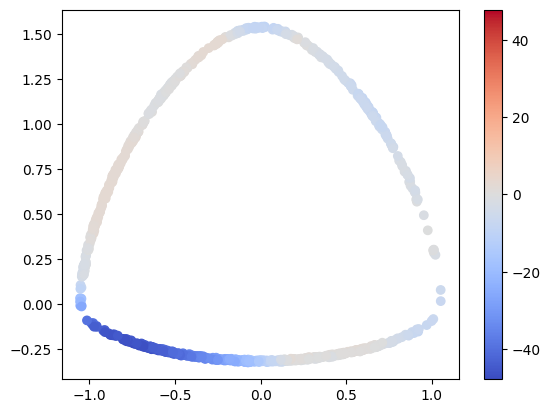

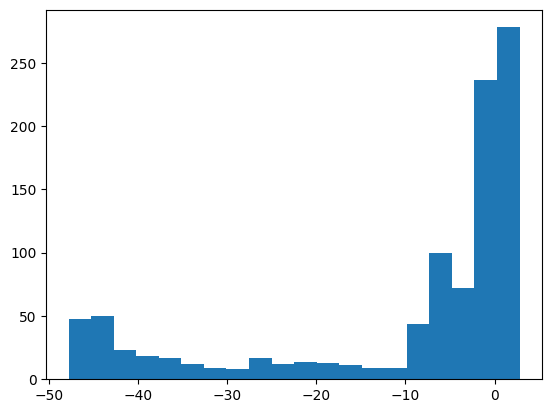

Accuracy: 0.5920000076293945


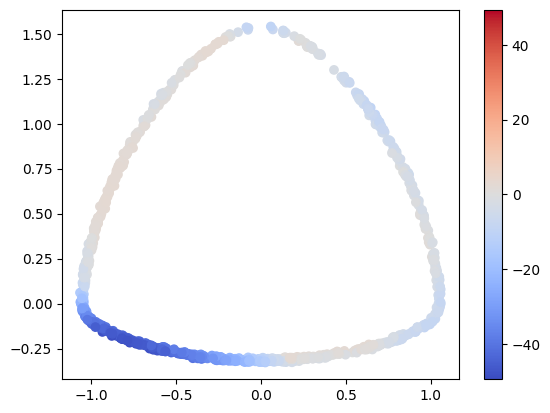

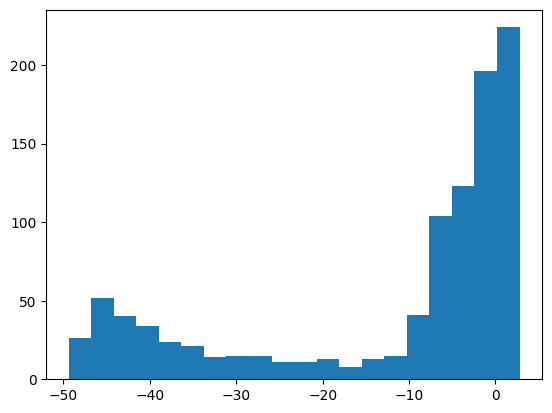

Accuracy: 0.6489999890327454


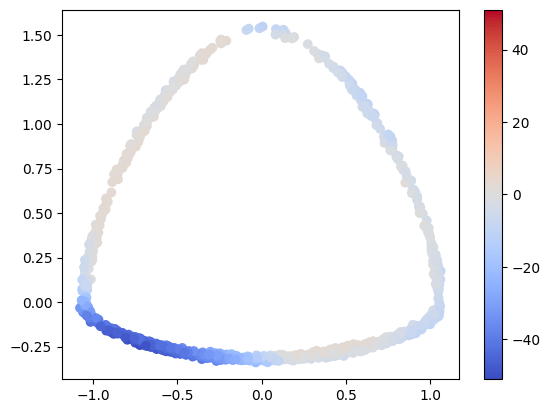

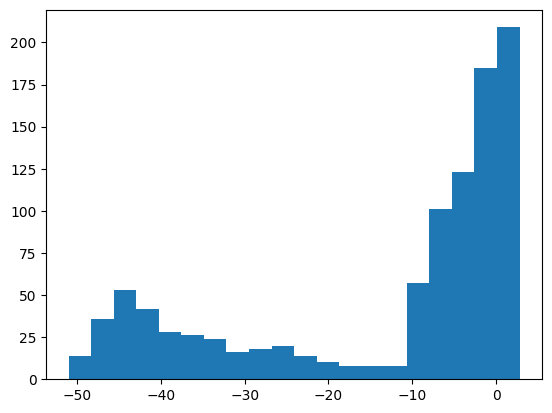

Accuracy: 0.6259999871253967


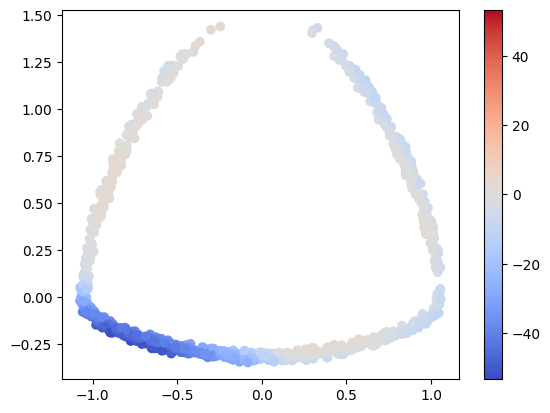

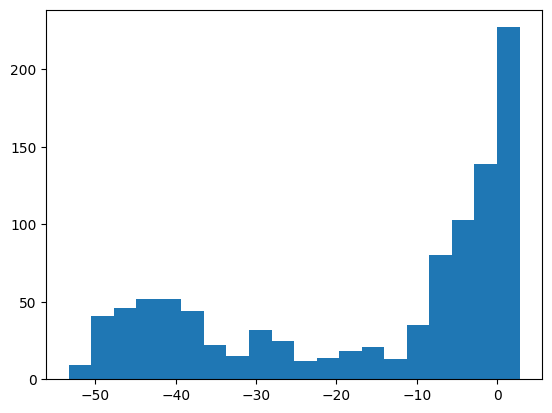

Accuracy: 0.6570000052452087


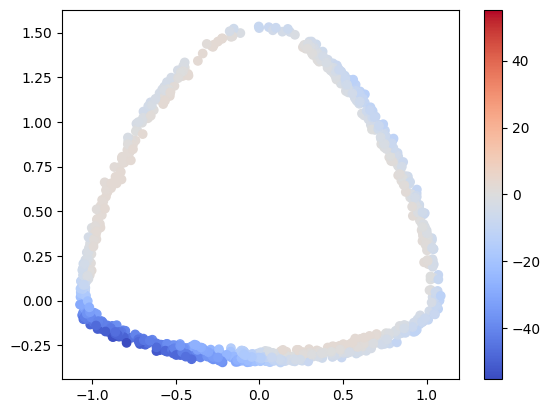

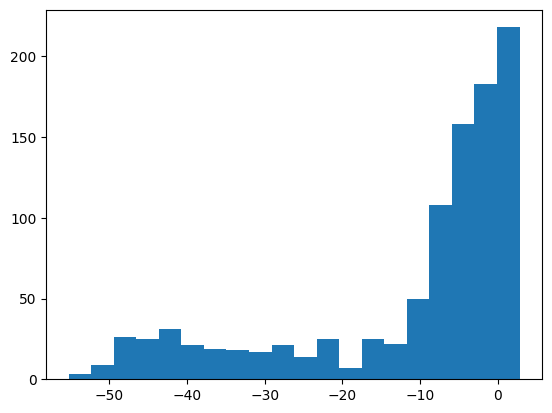

Accuracy: 0.7170000076293945


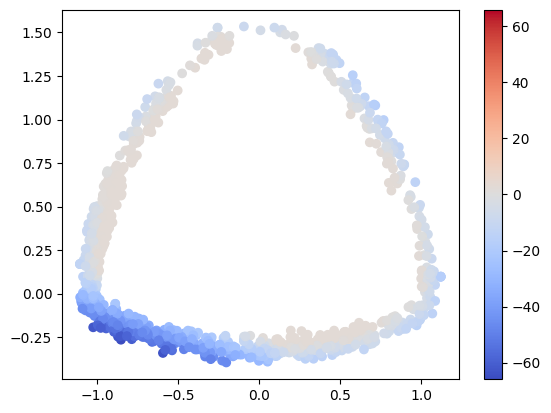

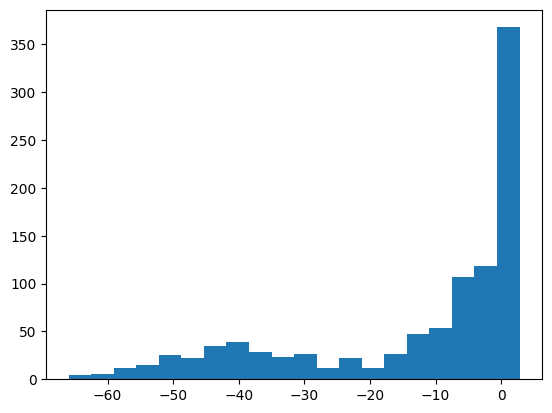

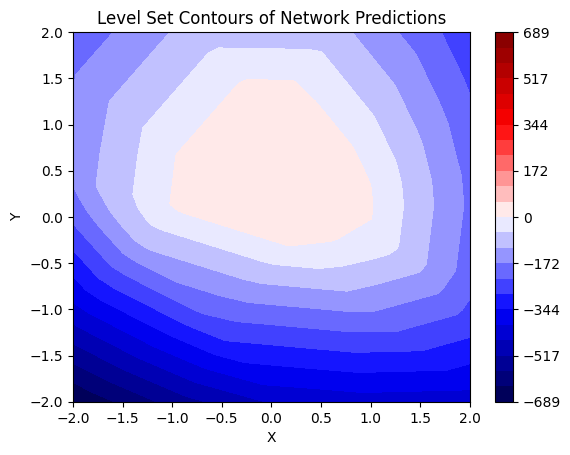

Overall Training Progress: 100%|██████████| 400/400 [16:21<00:00,  2.45s/it, Training Accuracy=1, Validation1 Accuracy=0.951, Validation001 Accuracy=0.534, Validation002 Accuracy=0.539, Validation003 Accuracy=0.583, Validation004 Accuracy=0.542, Validation005 Accuracy=0.597, Validation010 Accuracy=0.679]    


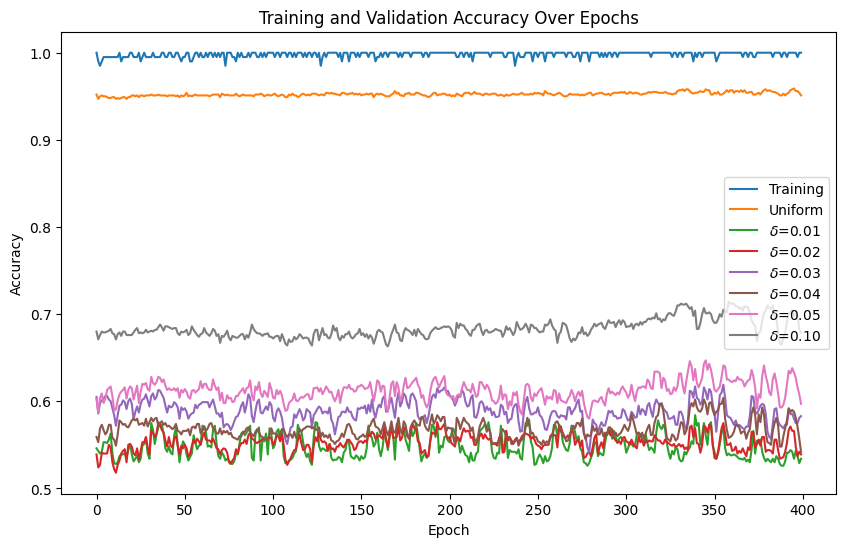

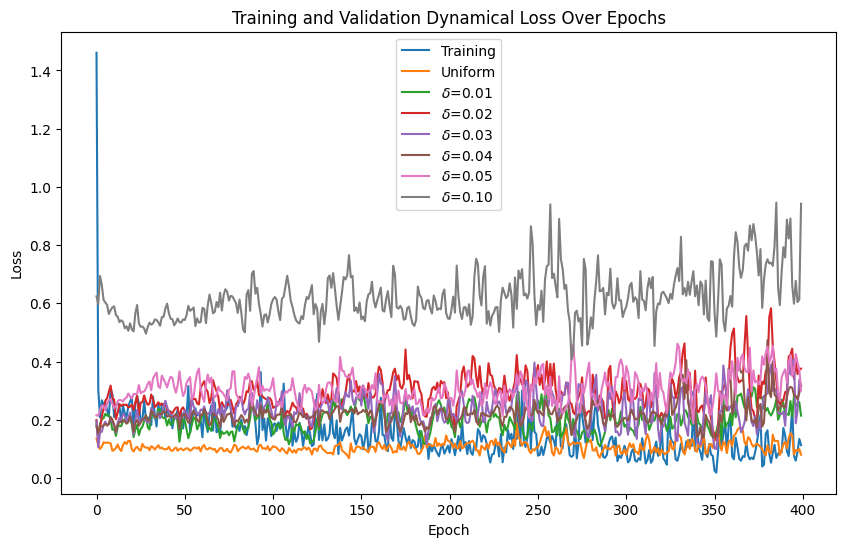

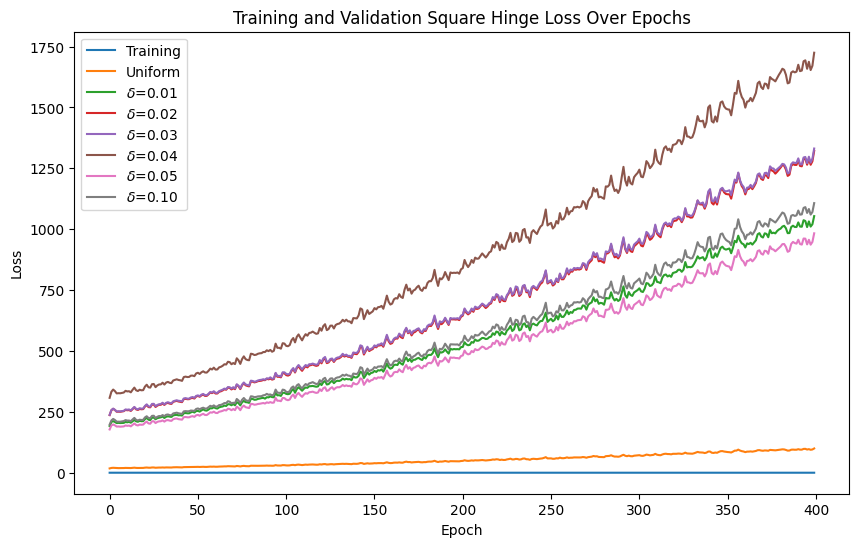

Accuracy: 0.9509999752044678


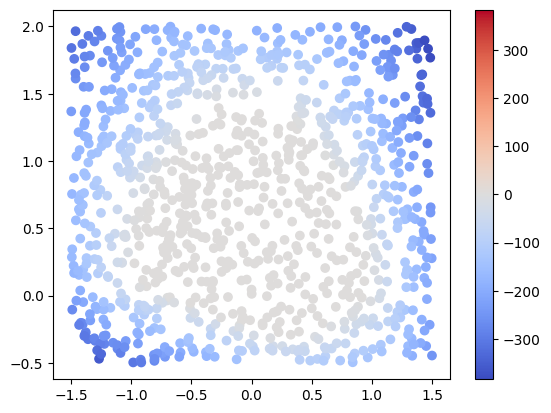

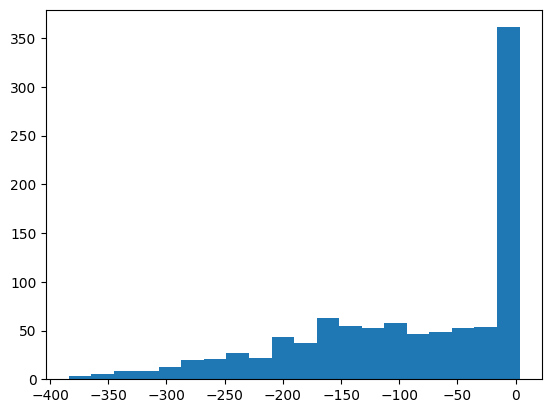

Accuracy: 0.5339999794960022


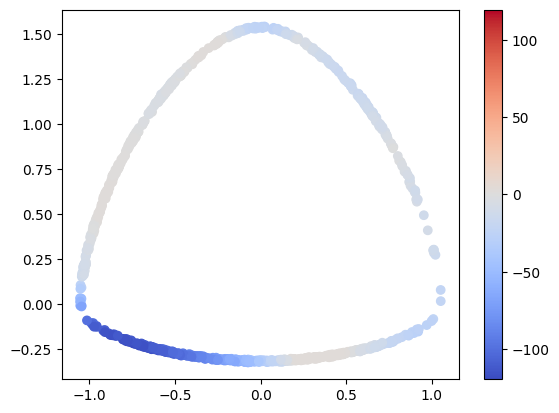

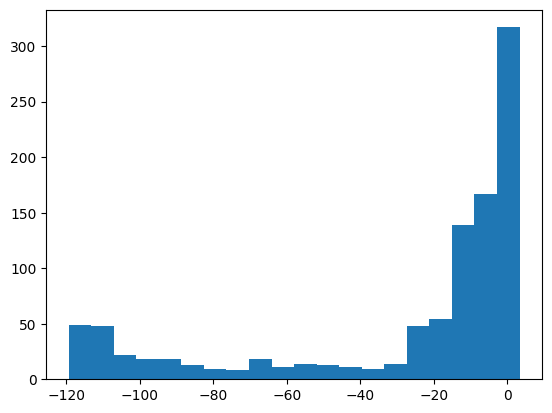

Accuracy: 0.5389999747276306


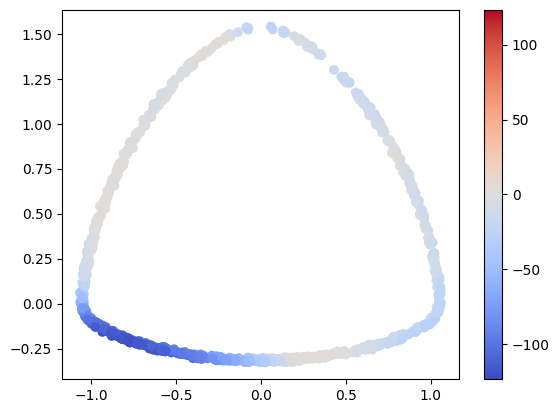

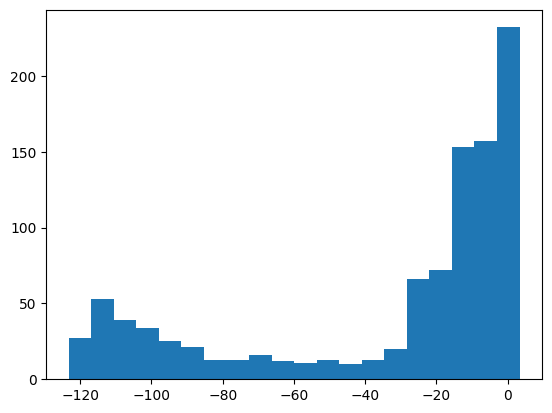

Accuracy: 0.5830000042915344


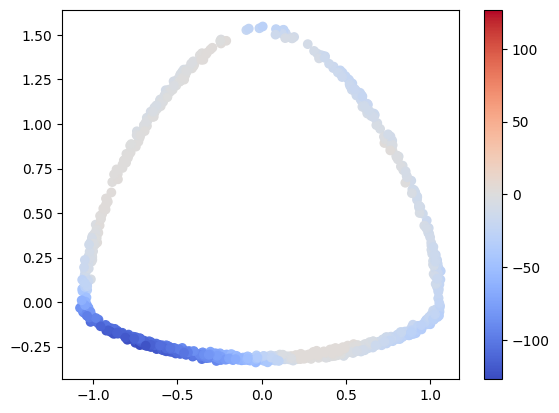

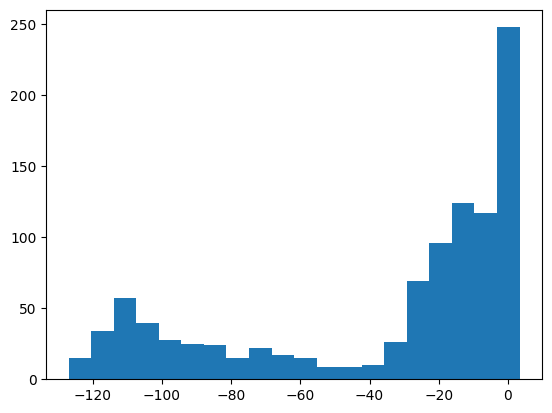

Accuracy: 0.5419999957084656


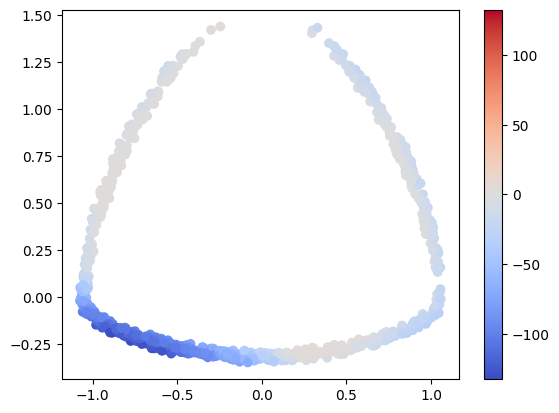

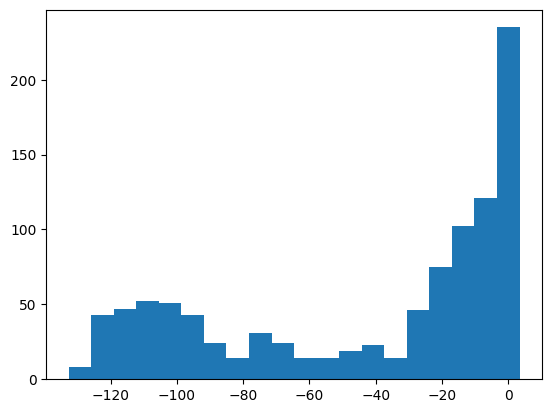

Accuracy: 0.597000002861023


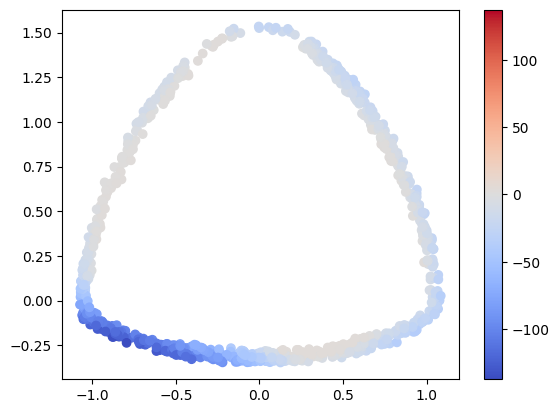

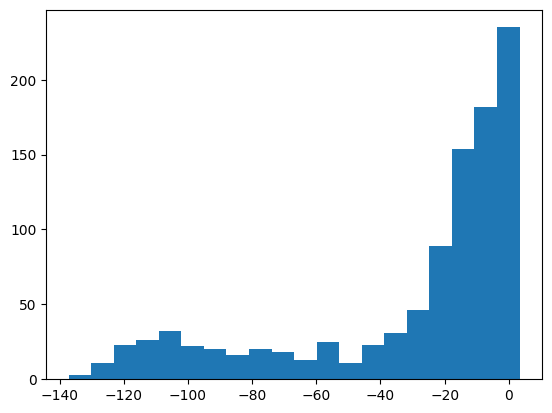

Accuracy: 0.6790000200271606


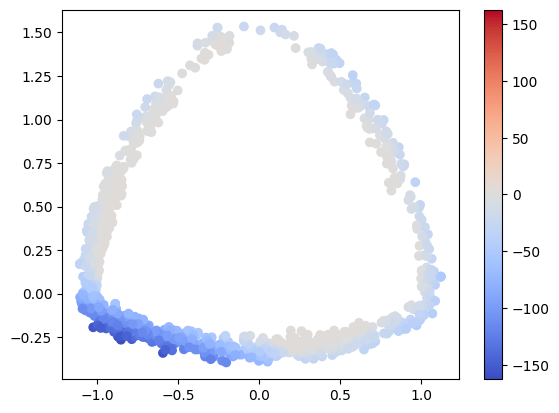

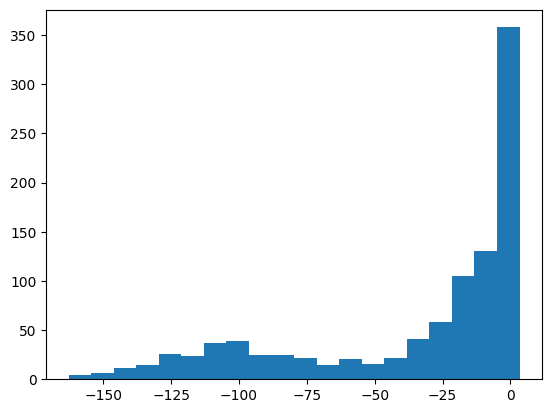

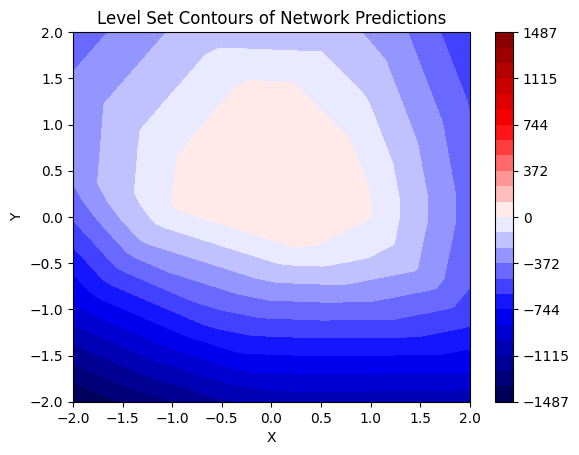

Overall Training Progress: 100%|██████████| 400/400 [16:54<00:00,  2.54s/it, Training Accuracy=0.995, Validation1 Accuracy=0.967, Validation001 Accuracy=0.544, Validation002 Accuracy=0.575, Validation003 Accuracy=0.557, Validation004 Accuracy=0.584, Validation005 Accuracy=0.63, Validation010 Accuracy=0.704] 


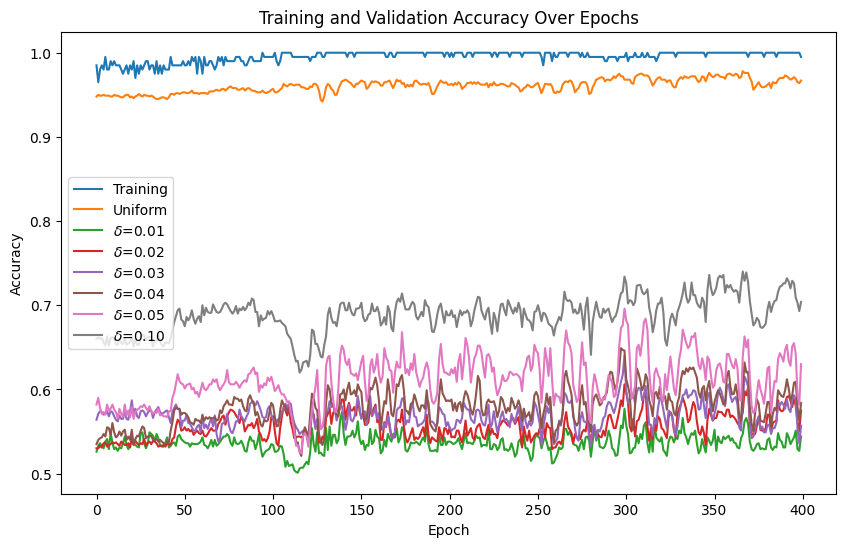

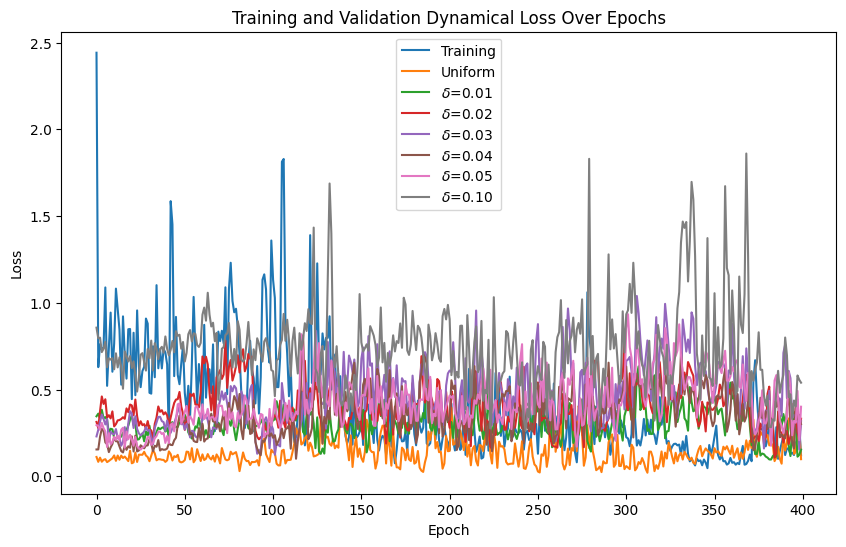

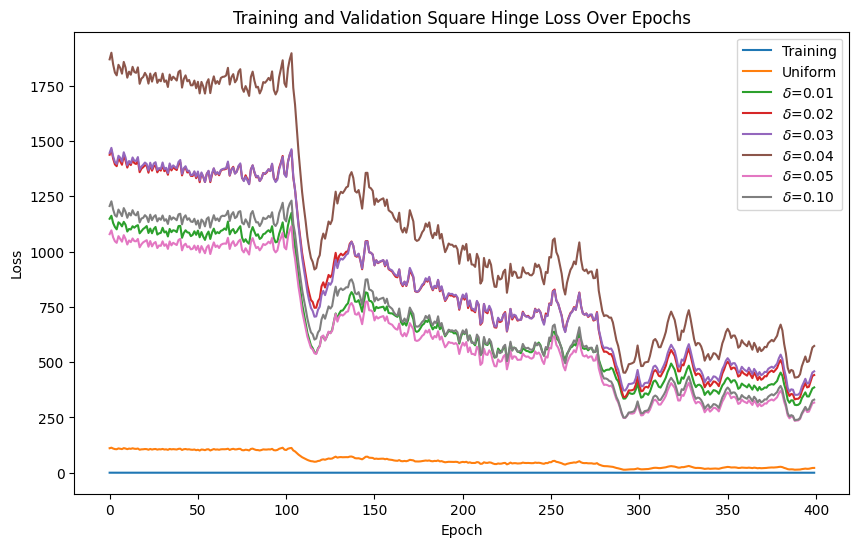

Accuracy: 0.9670000076293945


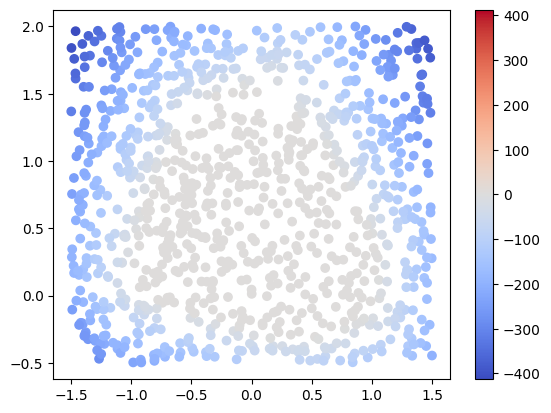

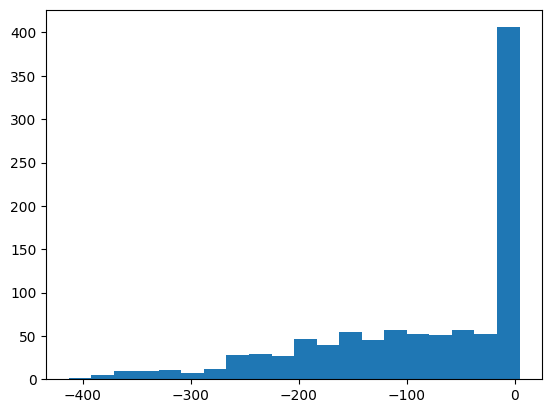

Accuracy: 0.5440000295639038


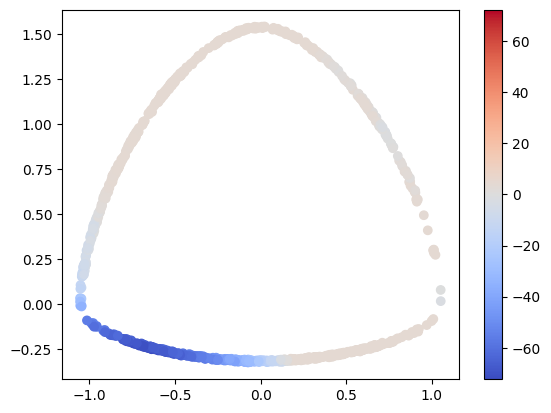

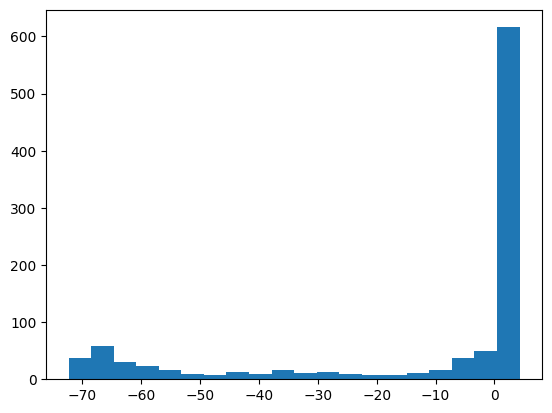

Accuracy: 0.574999988079071


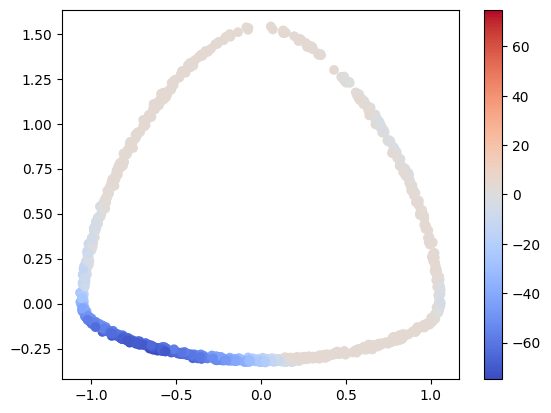

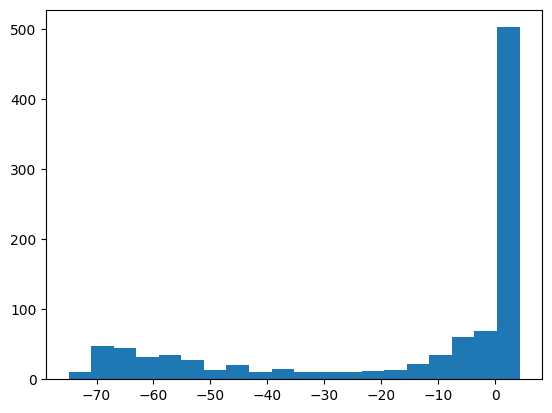

Accuracy: 0.5569999814033508


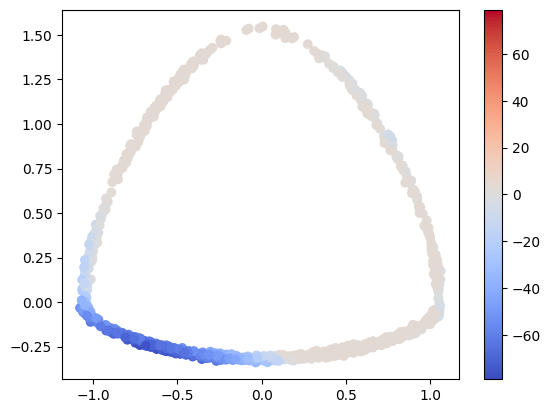

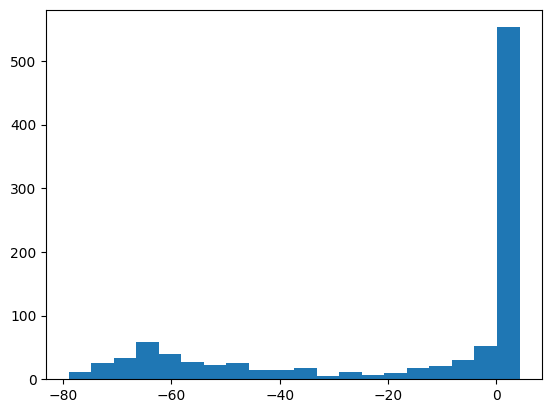

Accuracy: 0.5839999914169312


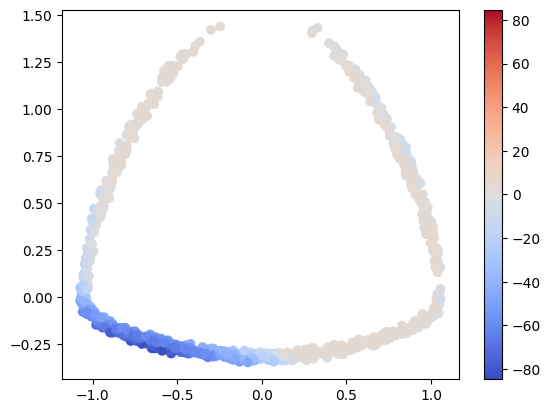

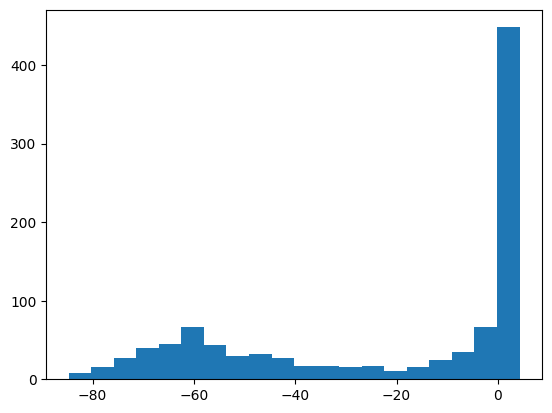

Accuracy: 0.6299999952316284


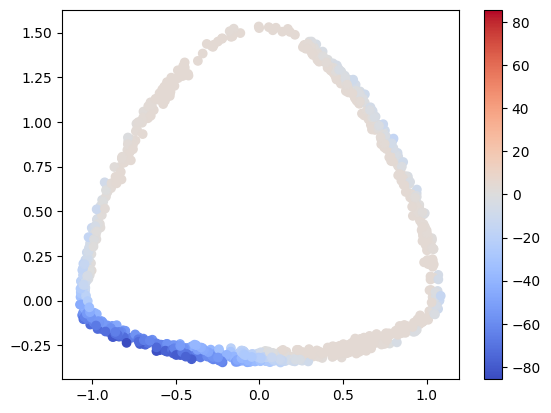

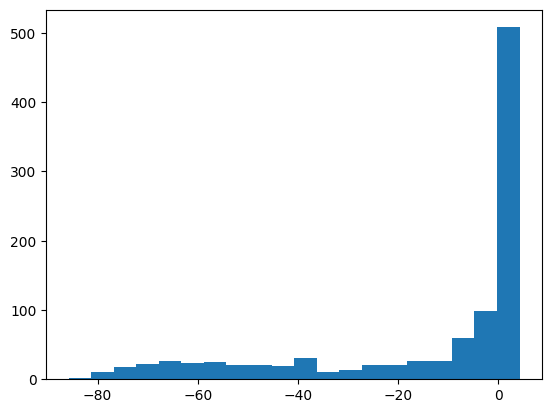

Accuracy: 0.7039999961853027


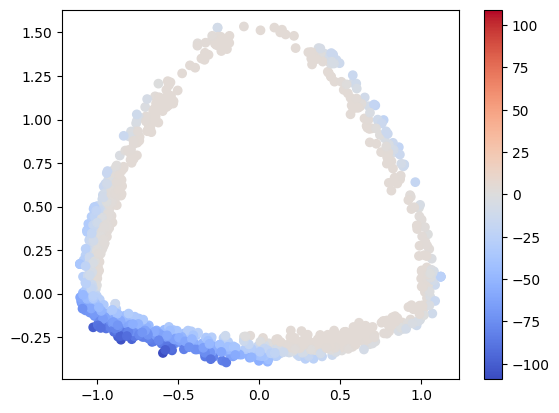

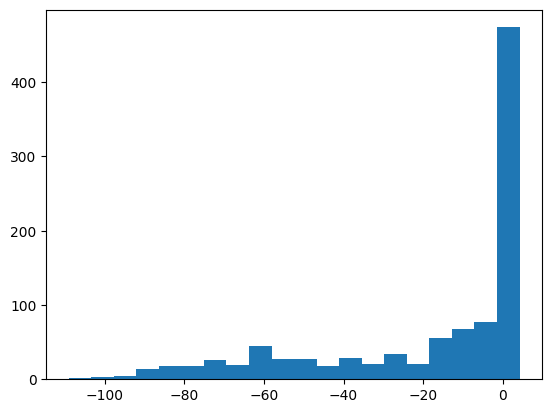

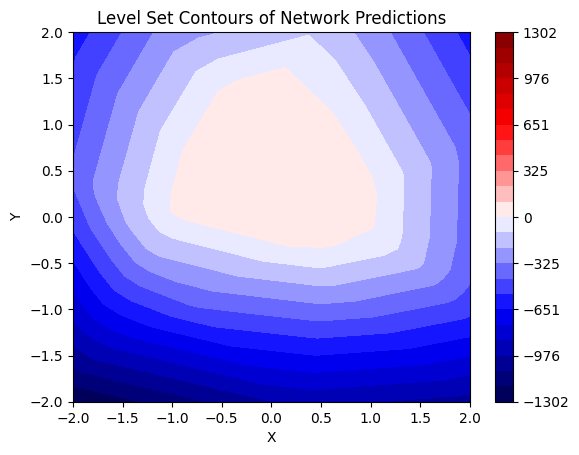

Overall Training Progress: 100%|██████████| 400/400 [17:33<00:00,  2.63s/it, Training Accuracy=1, Validation1 Accuracy=0.967, Validation001 Accuracy=0.537, Validation002 Accuracy=0.585, Validation003 Accuracy=0.576, Validation004 Accuracy=0.594, Validation005 Accuracy=0.63, Validation010 Accuracy=0.712]     


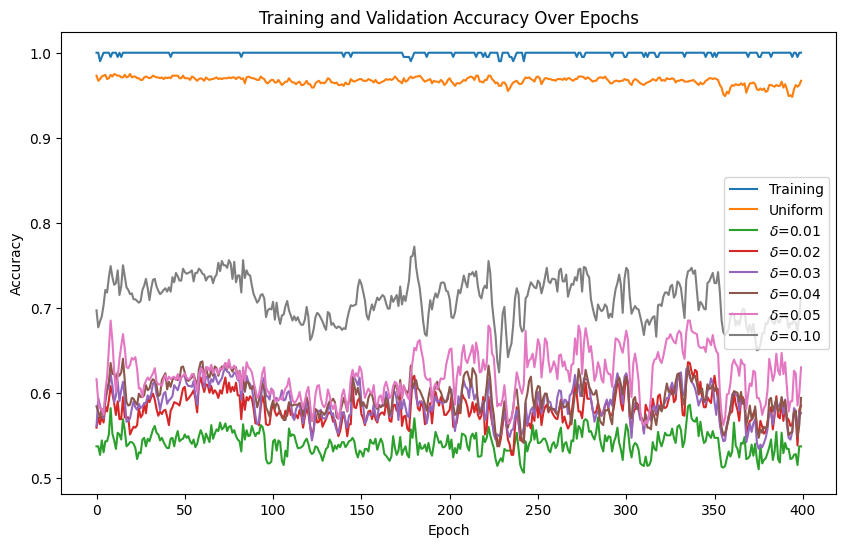

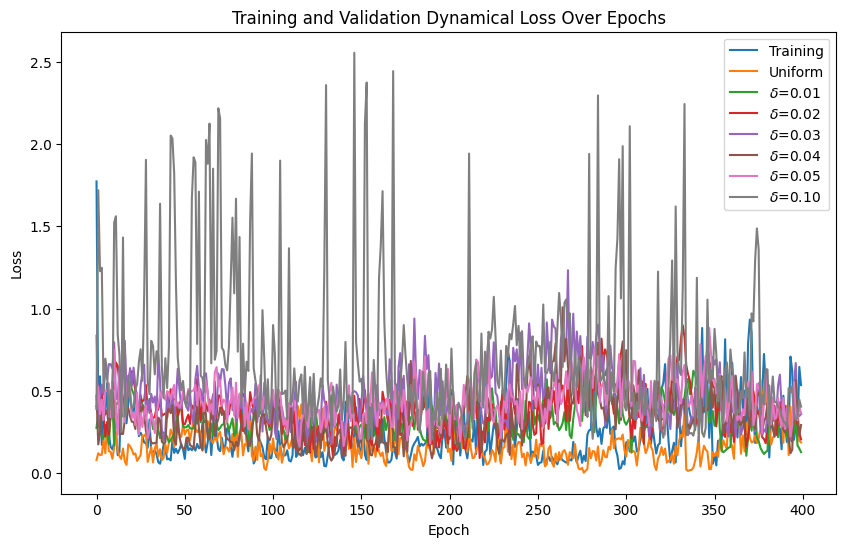

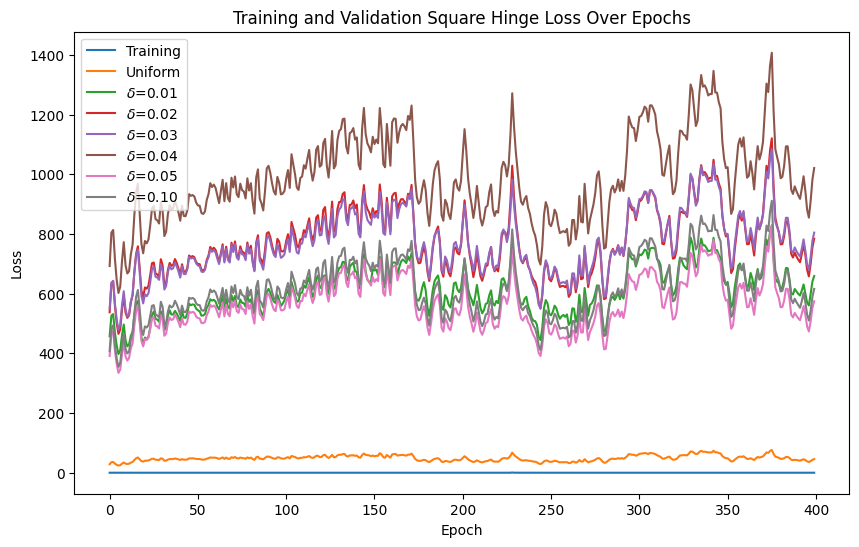

Accuracy: 0.9670000076293945


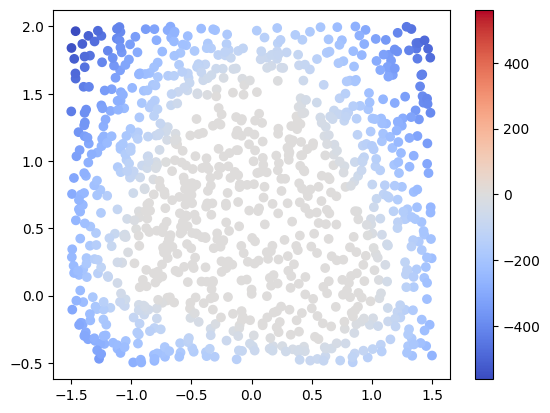

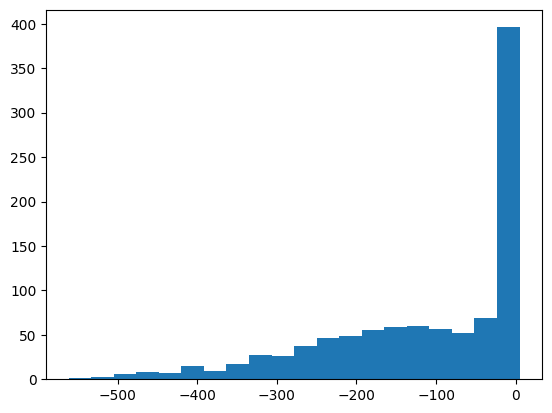

Accuracy: 0.5370000004768372


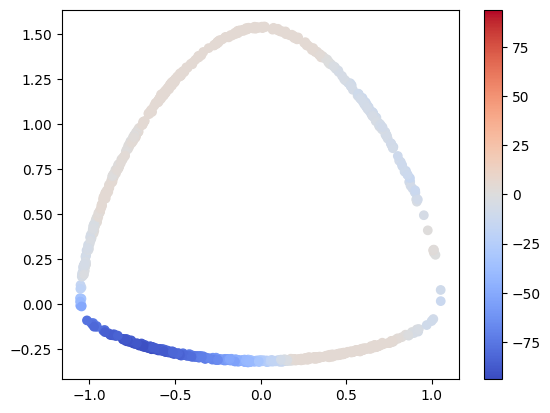

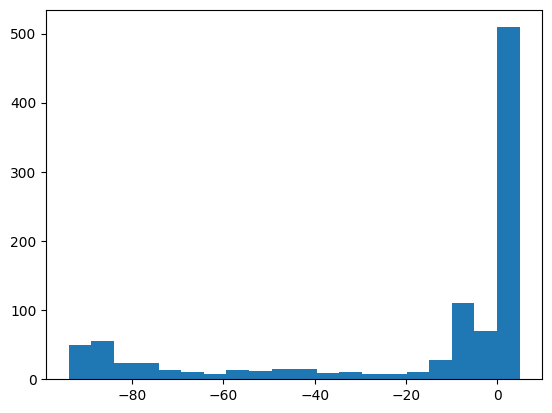

Accuracy: 0.5849999785423279


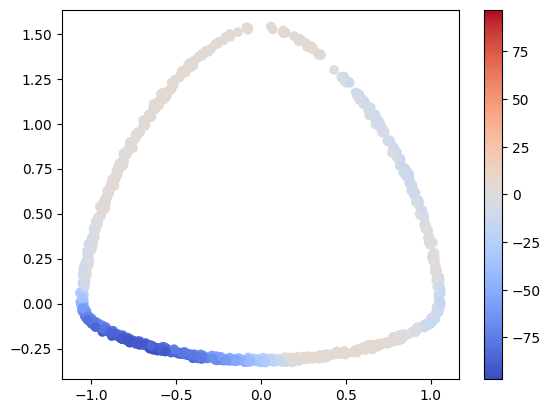

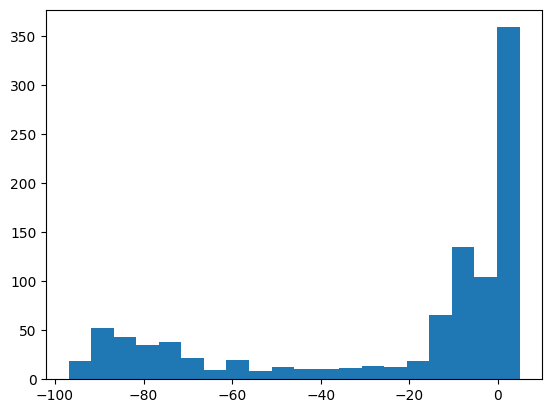

Accuracy: 0.5759999752044678


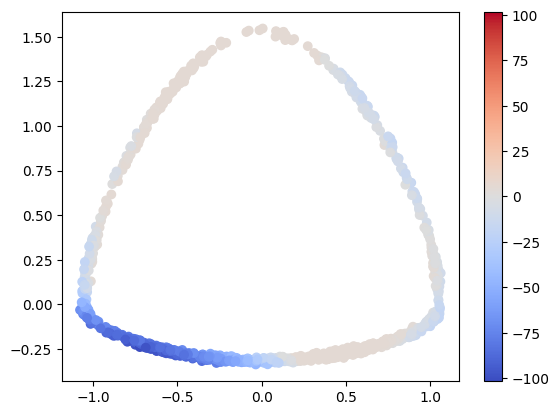

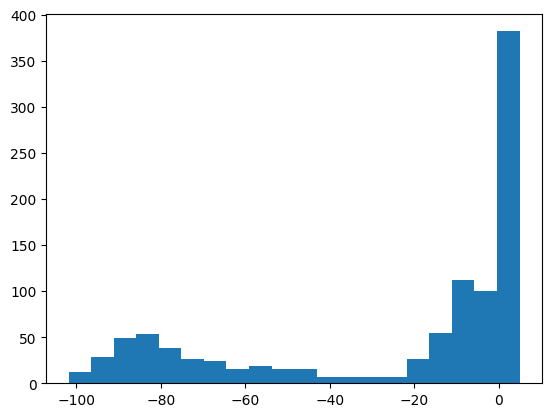

Accuracy: 0.593999981880188


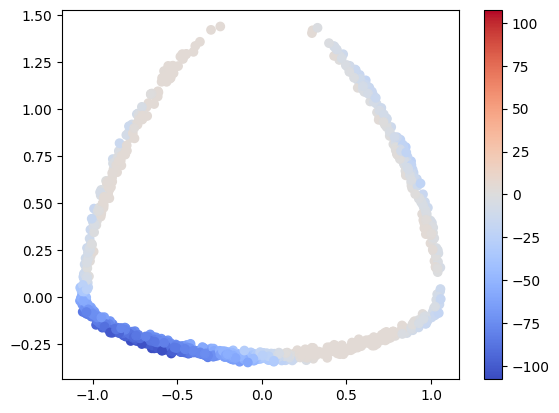

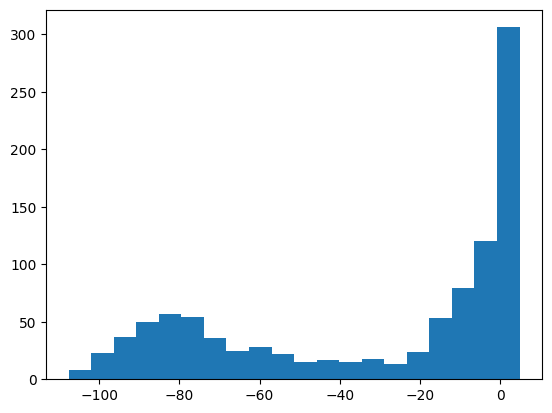

Accuracy: 0.6299999952316284


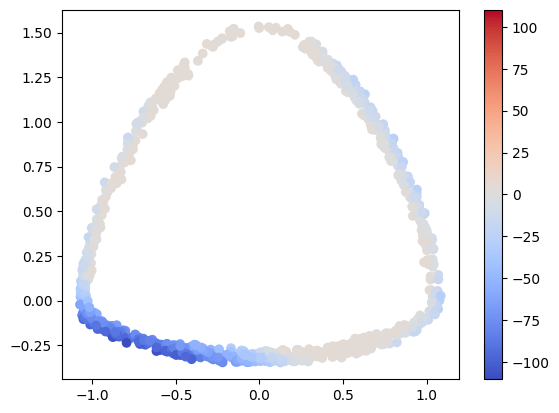

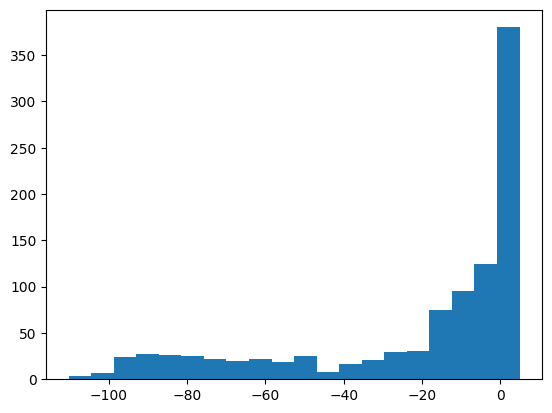

Accuracy: 0.7120000123977661


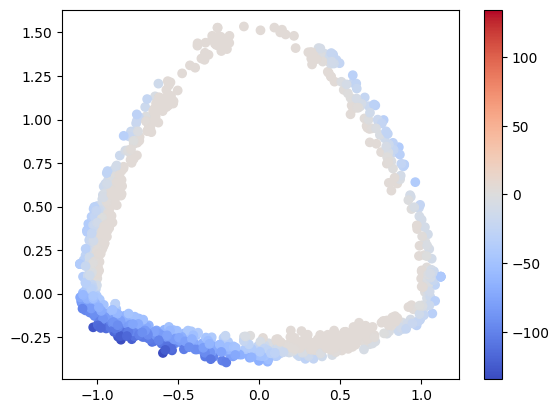

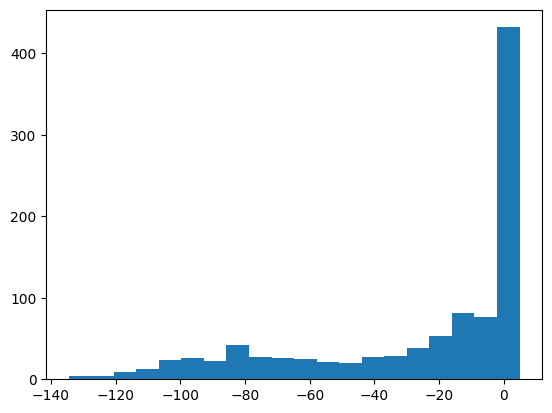

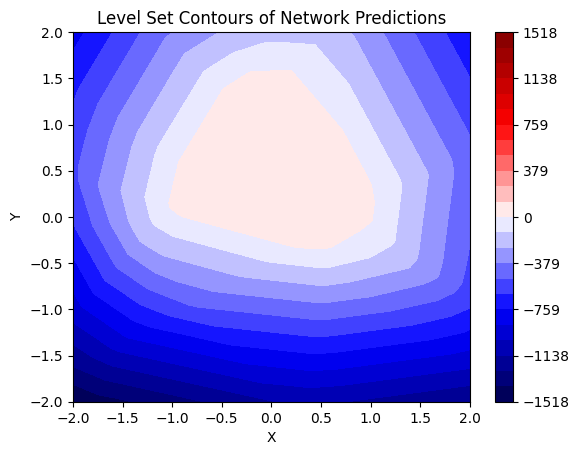

Overall Training Progress: 100%|██████████| 400/400 [18:05<00:00,  2.71s/it, Training Accuracy=1, Validation1 Accuracy=0.979, Validation001 Accuracy=0.557, Validation002 Accuracy=0.583, Validation003 Accuracy=0.61, Validation004 Accuracy=0.627, Validation005 Accuracy=0.688, Validation010 Accuracy=0.786]     


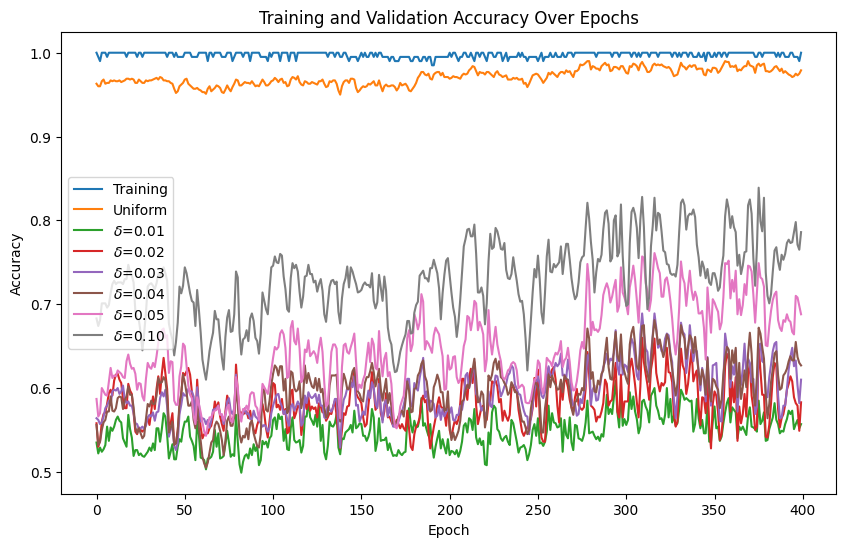

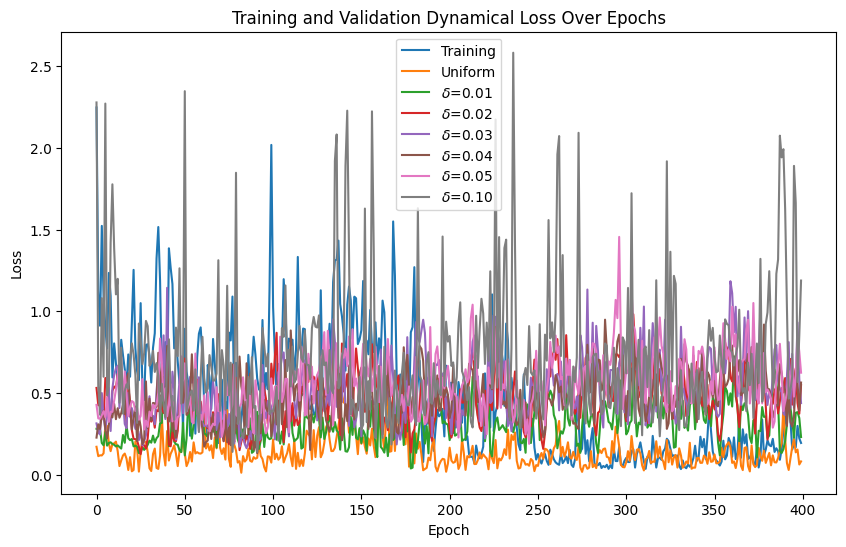

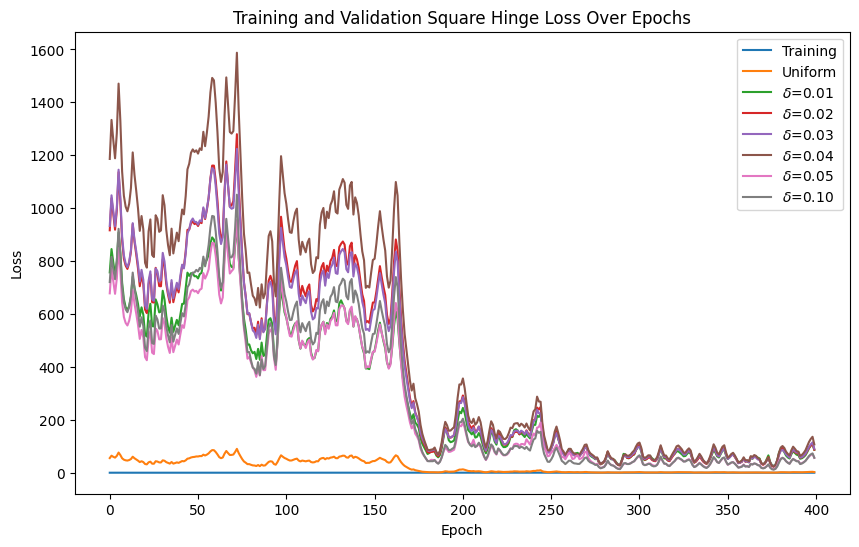

Accuracy: 0.9789999723434448


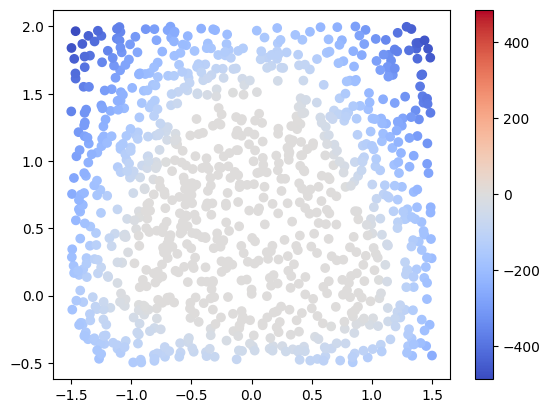

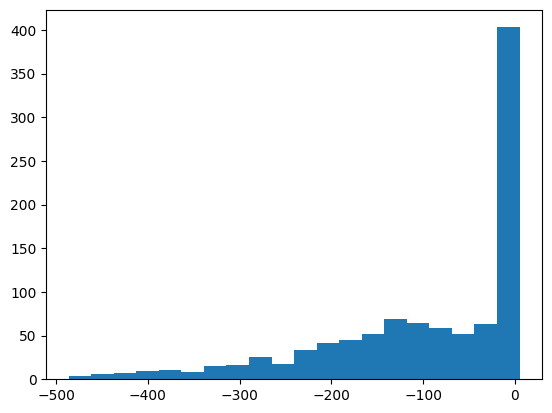

Accuracy: 0.5569999814033508


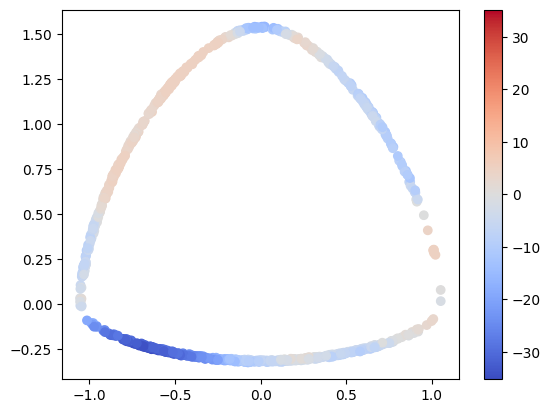

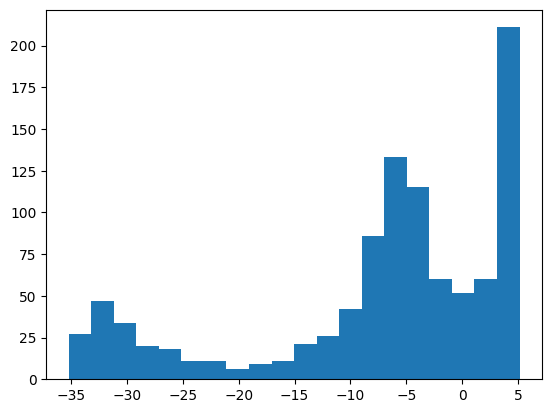

Accuracy: 0.5830000042915344


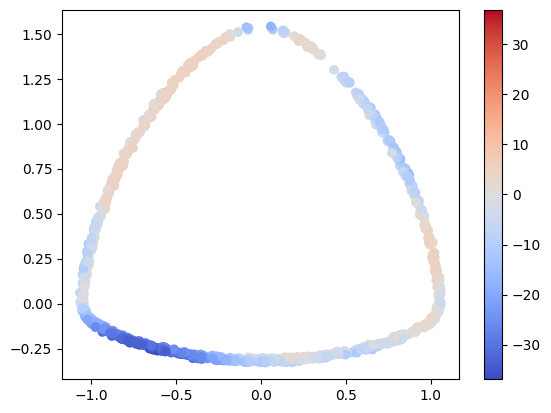

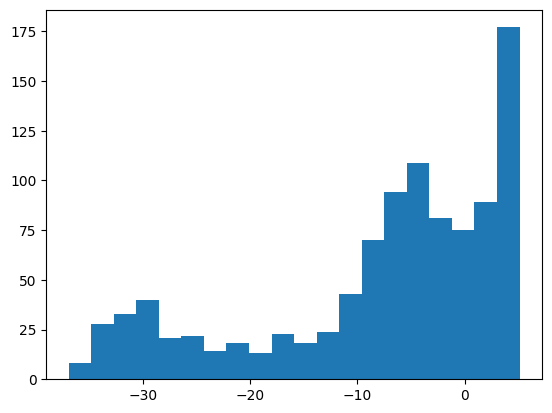

Accuracy: 0.6100000143051147


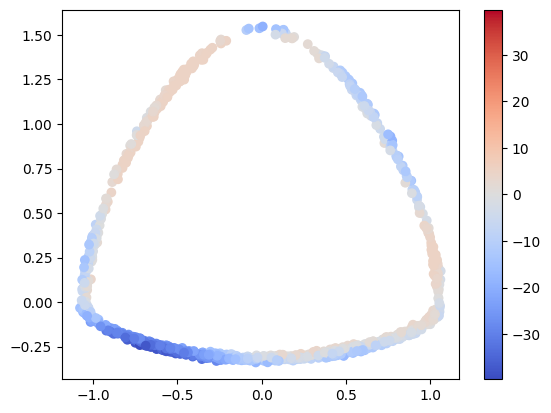

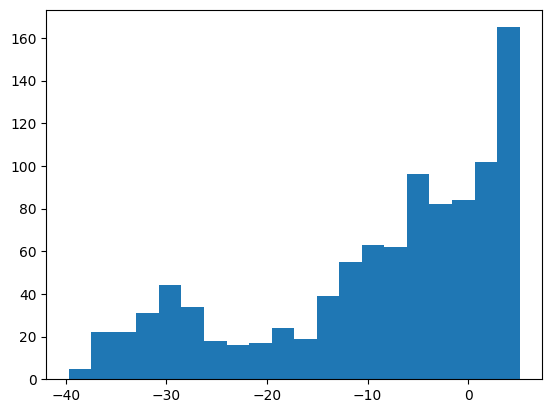

Accuracy: 0.6269999742507935


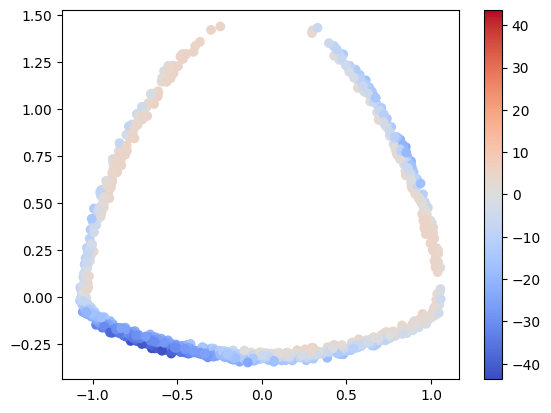

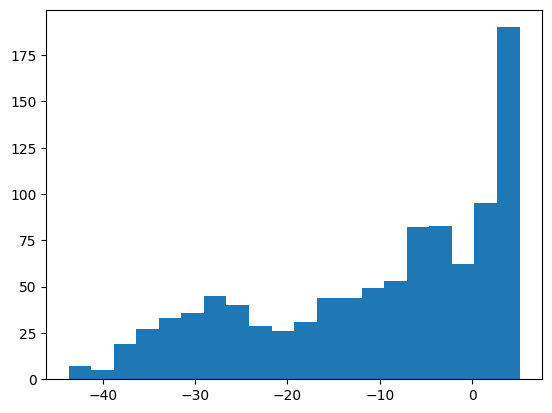

Accuracy: 0.6880000233650208


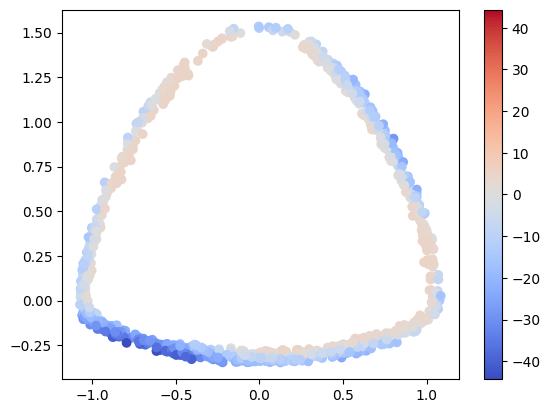

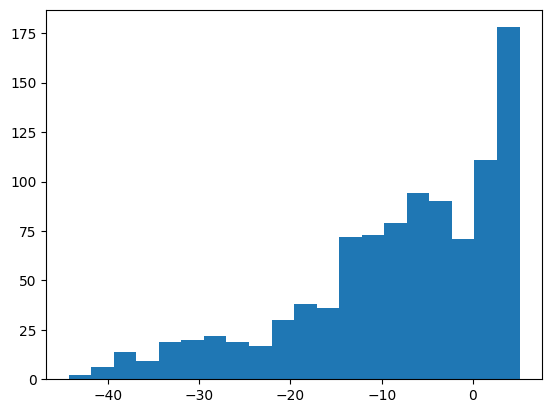

Accuracy: 0.7860000133514404


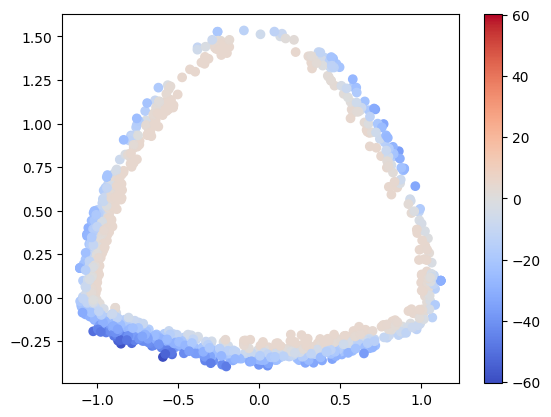

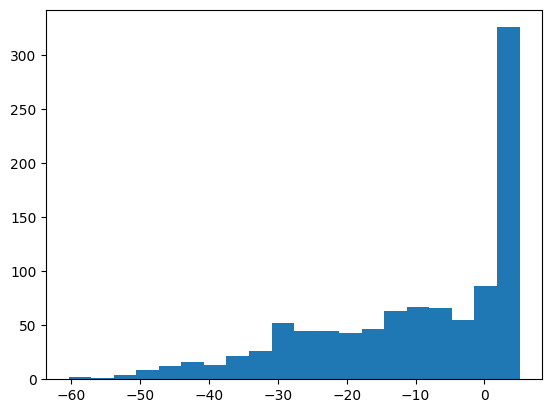

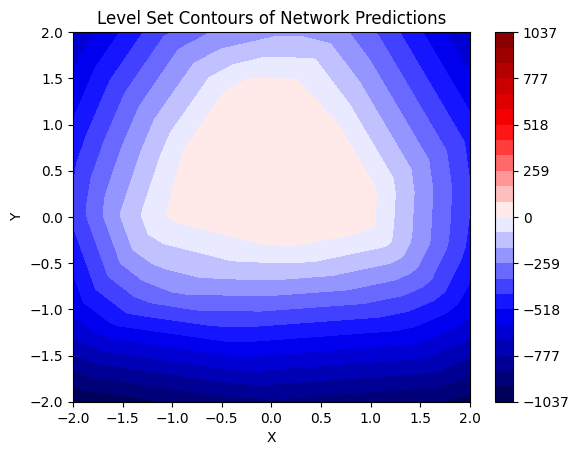

Overall Training Progress: 100%|██████████| 400/400 [18:44<00:00,  2.81s/it, Training Accuracy=1, Validation1 Accuracy=0.972, Validation001 Accuracy=0.535, Validation002 Accuracy=0.554, Validation003 Accuracy=0.575, Validation004 Accuracy=0.579, Validation005 Accuracy=0.625, Validation010 Accuracy=0.718]    


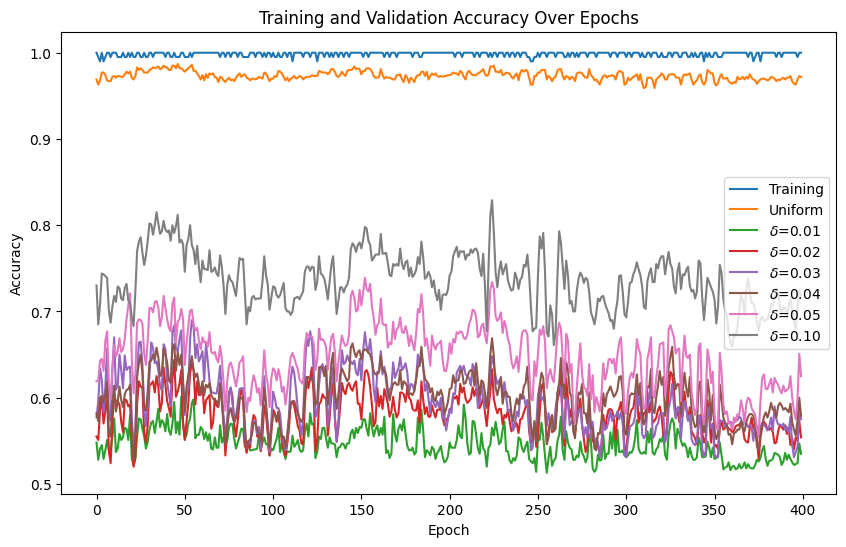

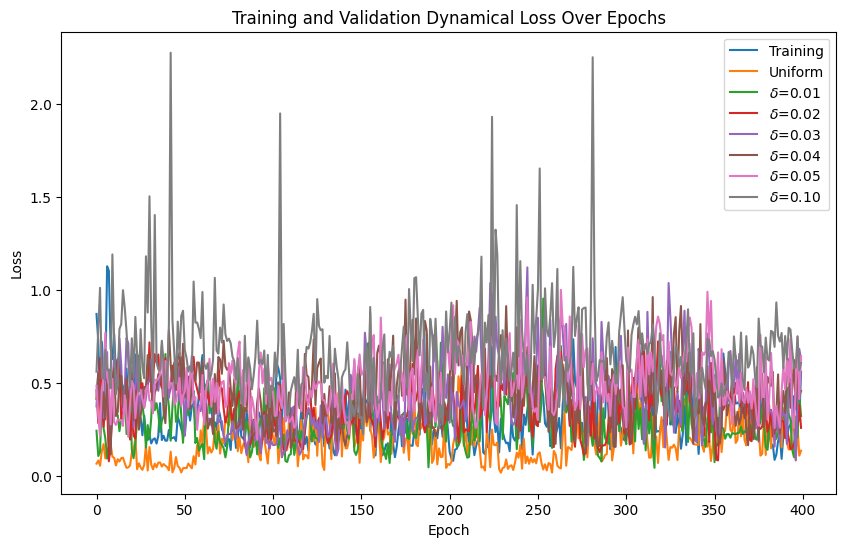

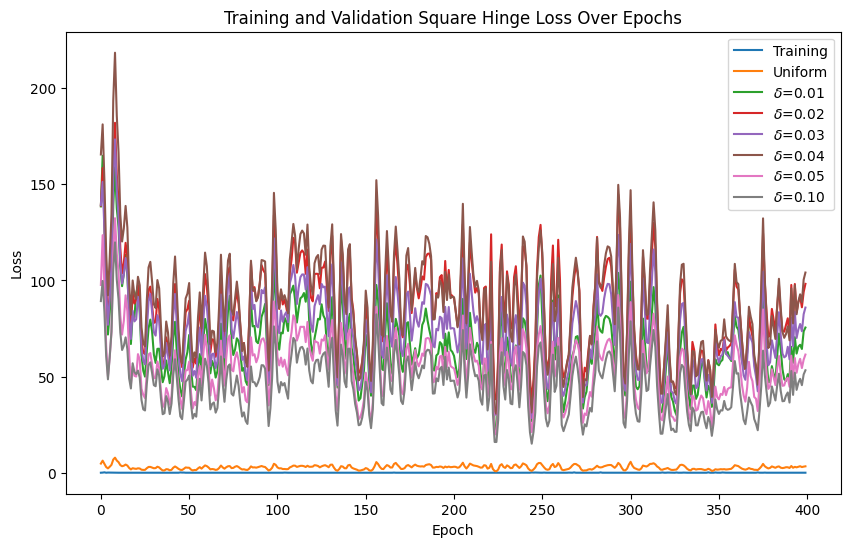

Accuracy: 0.972000002861023


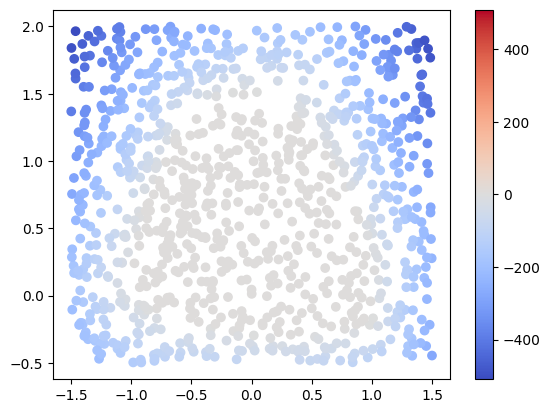

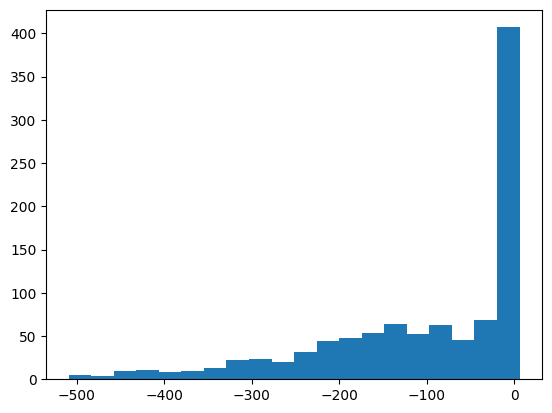

Accuracy: 0.5350000262260437


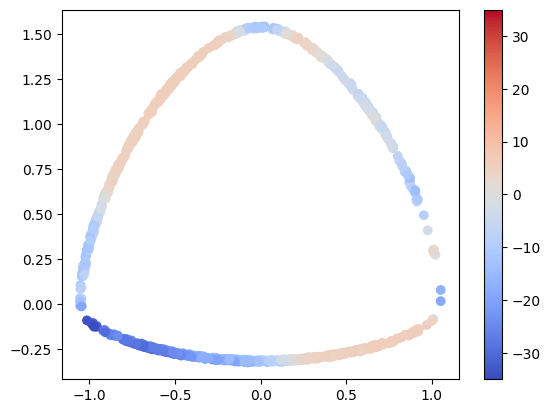

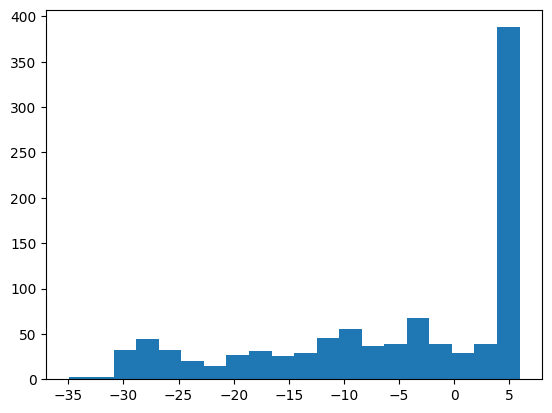

Accuracy: 0.5540000200271606


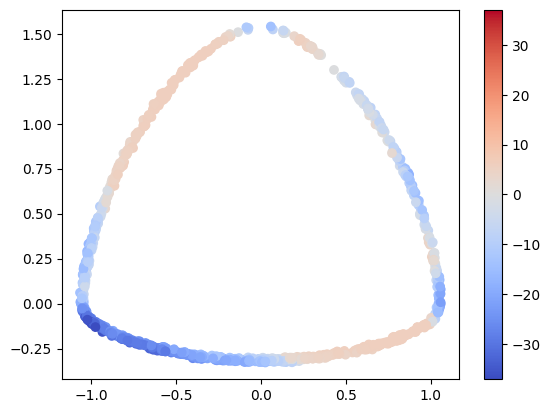

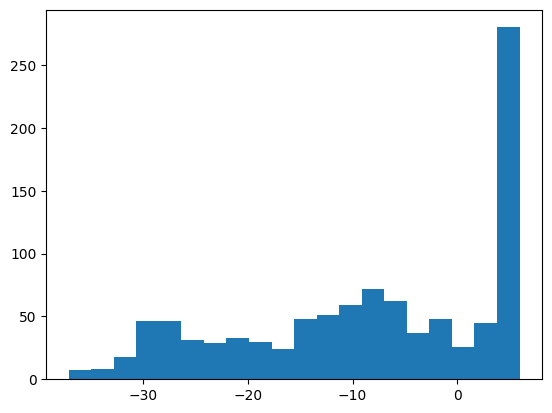

Accuracy: 0.574999988079071


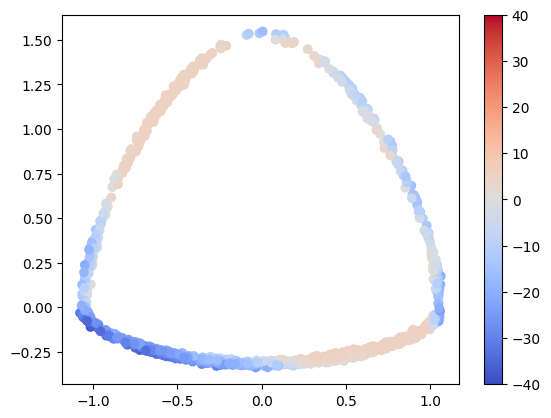

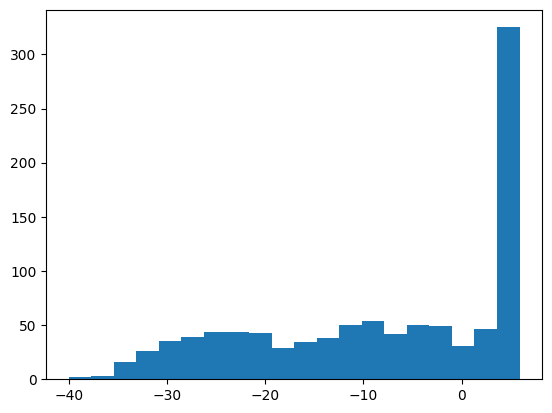

Accuracy: 0.5789999961853027


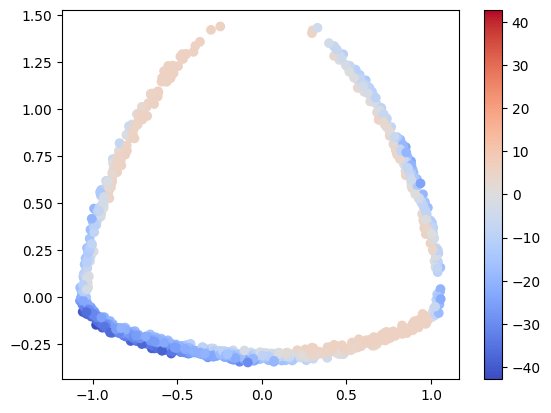

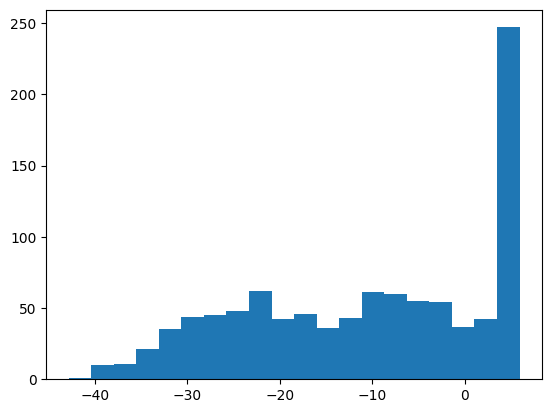

Accuracy: 0.625


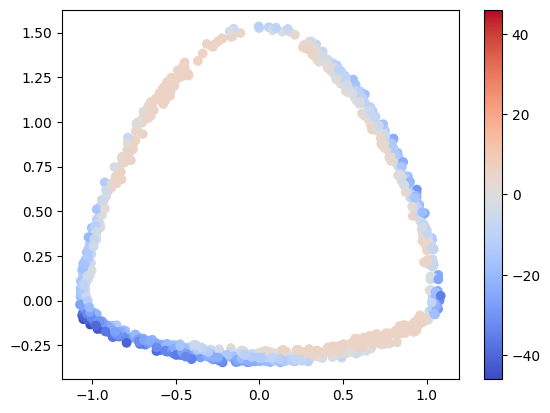

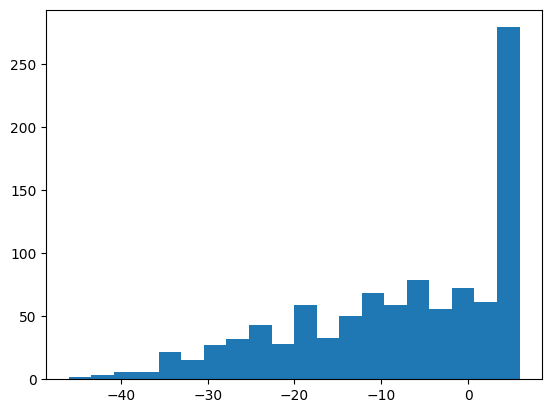

Accuracy: 0.7179999947547913


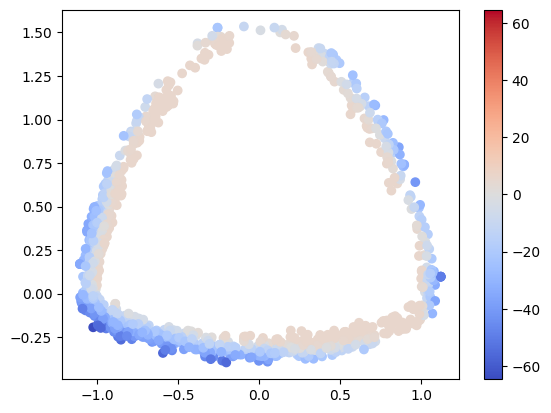

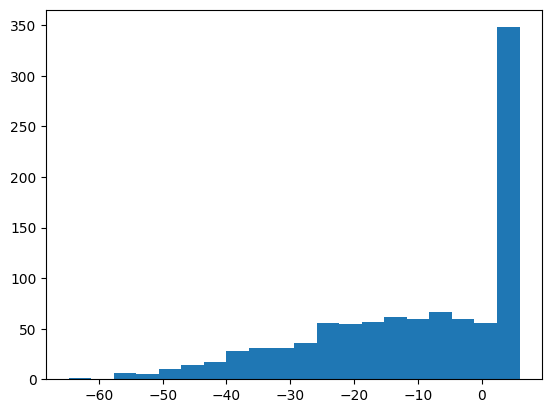

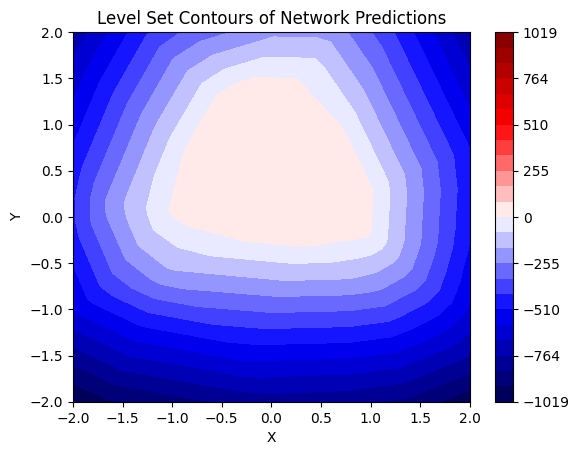

Overall Training Progress: 100%|██████████| 400/400 [19:17<00:00,  2.89s/it, Training Accuracy=1, Validation1 Accuracy=0.98, Validation001 Accuracy=0.569, Validation002 Accuracy=0.592, Validation003 Accuracy=0.61, Validation004 Accuracy=0.654, Validation005 Accuracy=0.696, Validation010 Accuracy=0.817]      


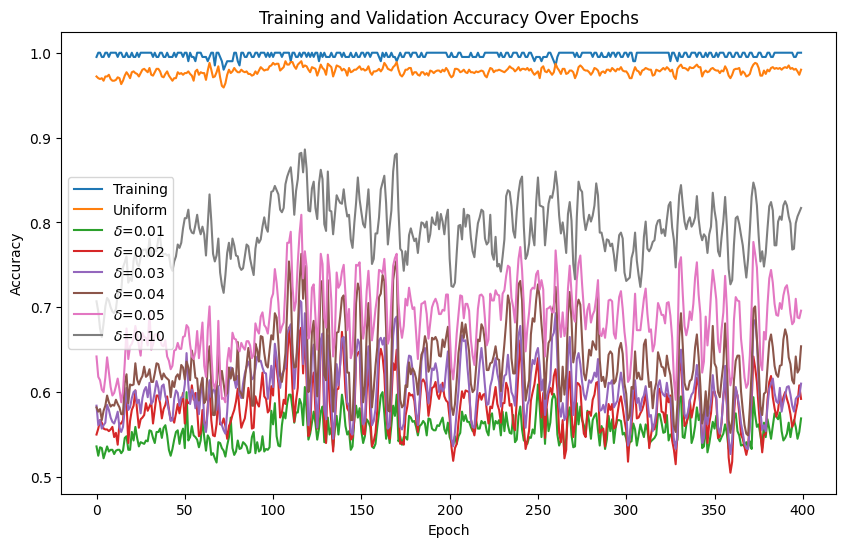

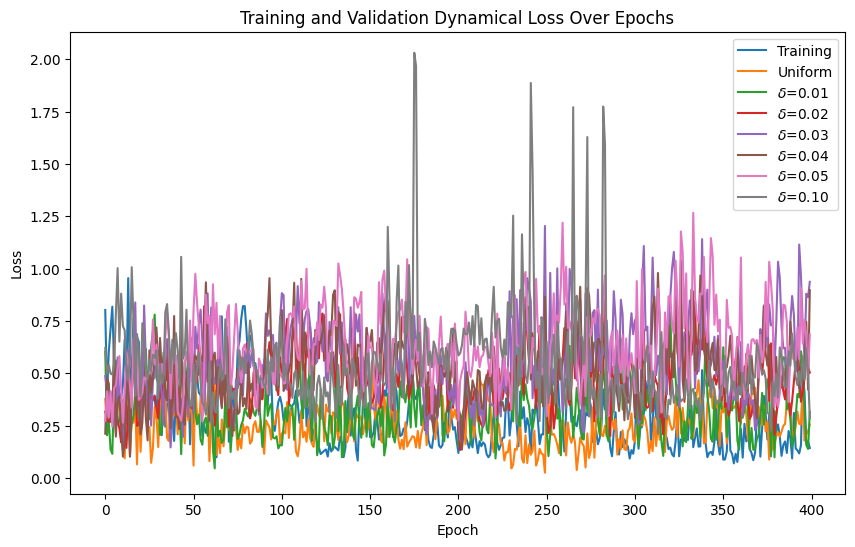

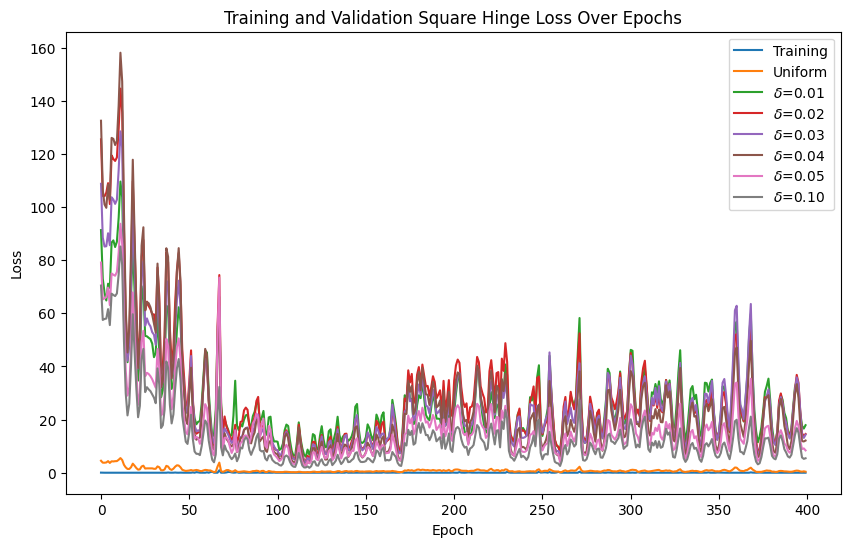

Accuracy: 0.9800000190734863


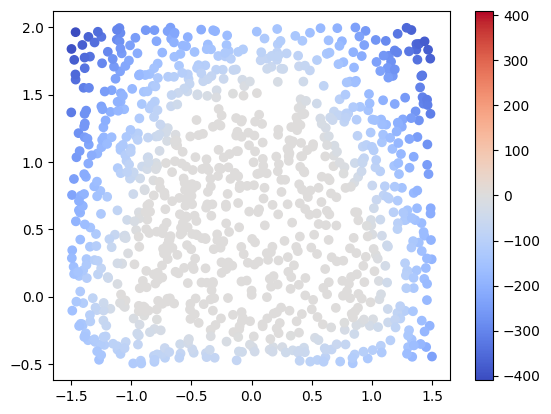

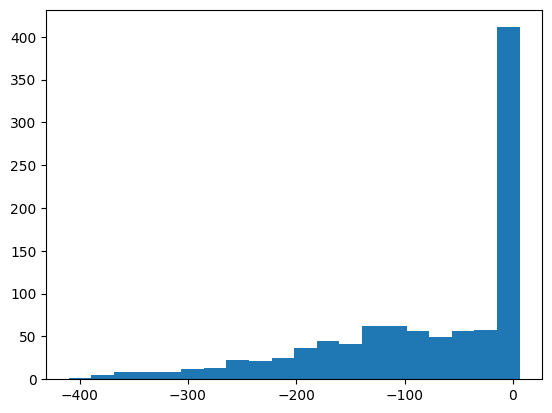

Accuracy: 0.5690000057220459


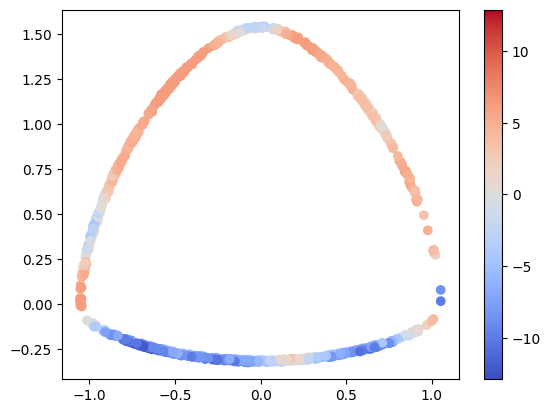

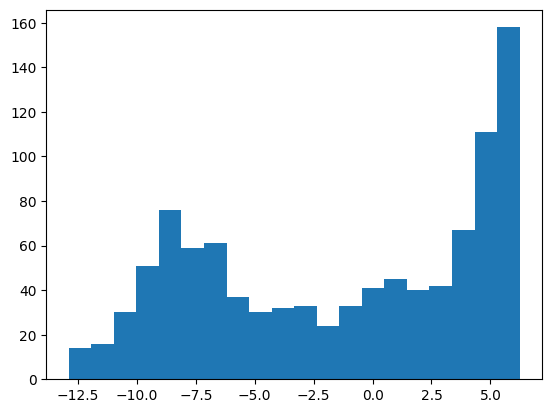

Accuracy: 0.5920000076293945


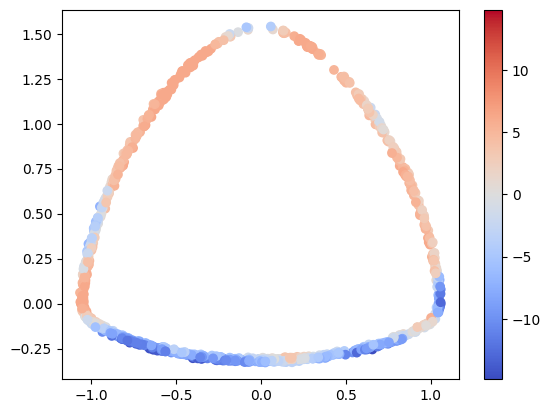

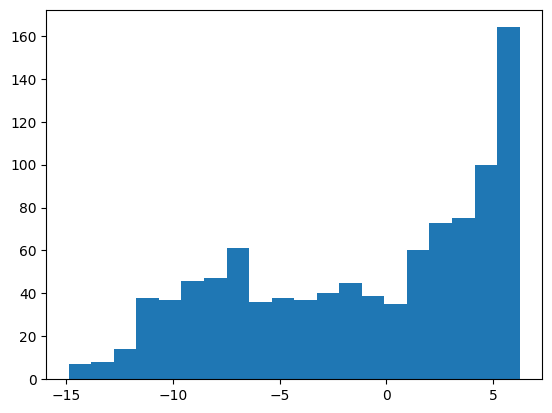

Accuracy: 0.6100000143051147


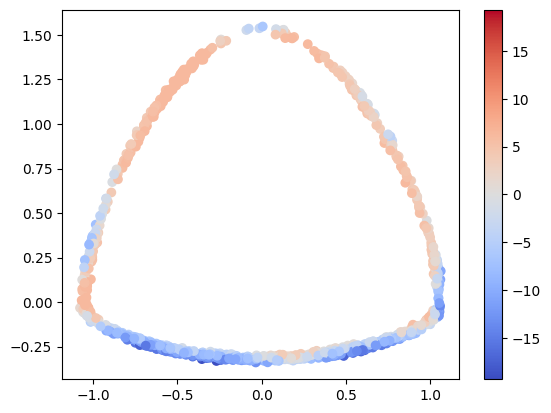

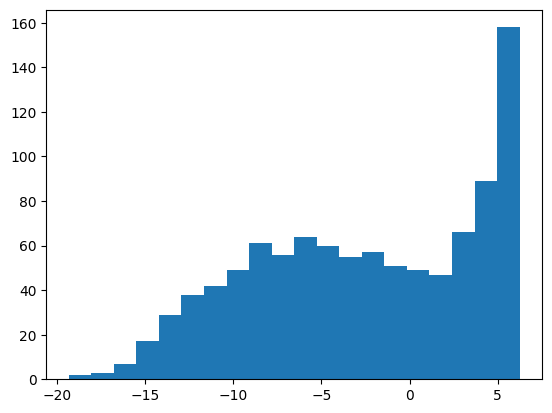

Accuracy: 0.6539999842643738


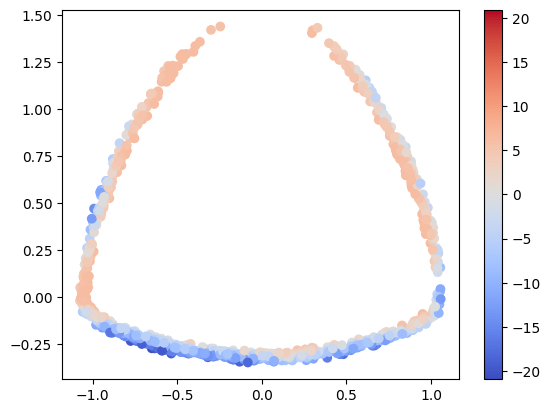

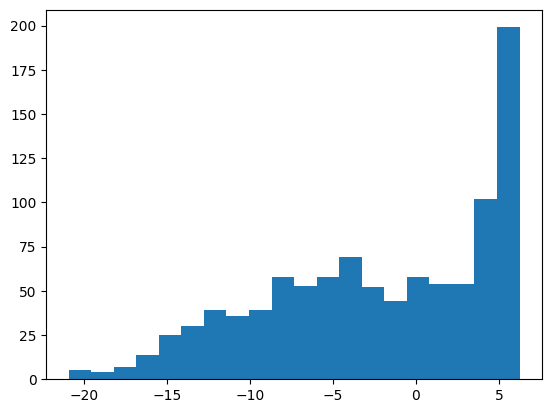

Accuracy: 0.6959999799728394


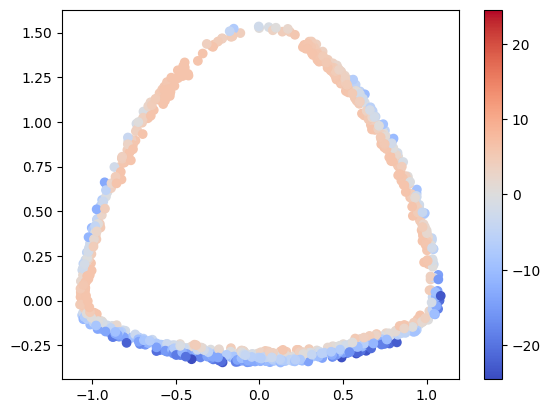

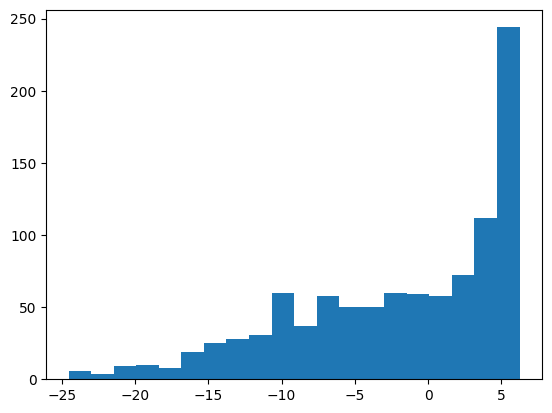

Accuracy: 0.8169999718666077


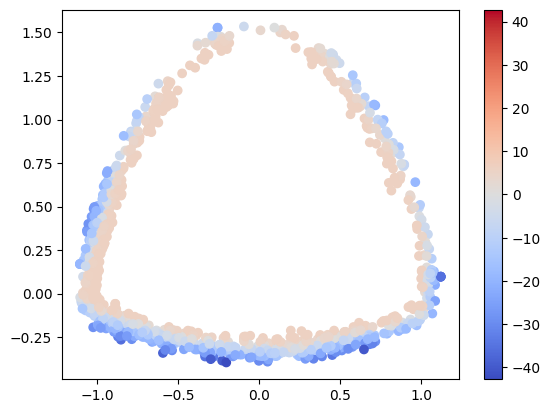

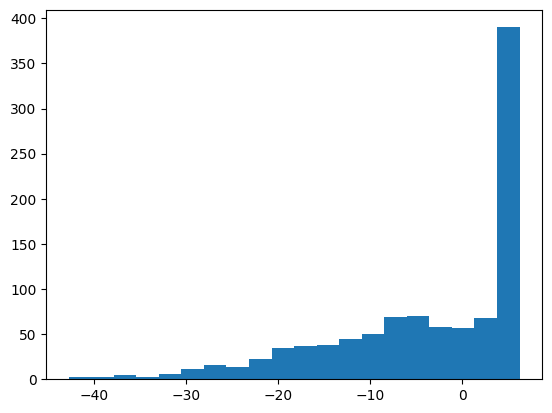

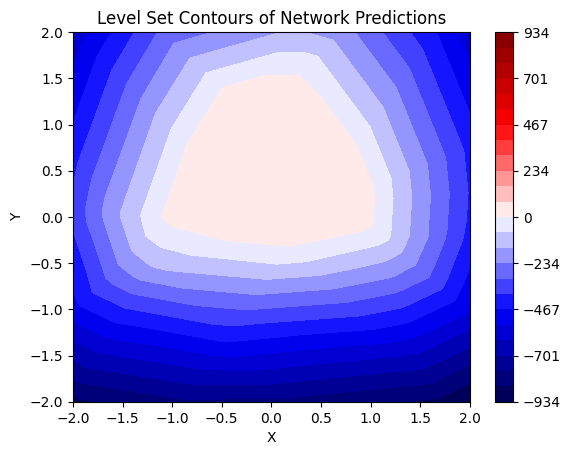

Overall Training Progress: 100%|██████████| 400/400 [19:56<00:00,  2.99s/it, Training Accuracy=0.995, Validation1 Accuracy=0.974, Validation001 Accuracy=0.588, Validation002 Accuracy=0.616, Validation003 Accuracy=0.636, Validation004 Accuracy=0.629, Validation005 Accuracy=0.685, Validation010 Accuracy=0.779]


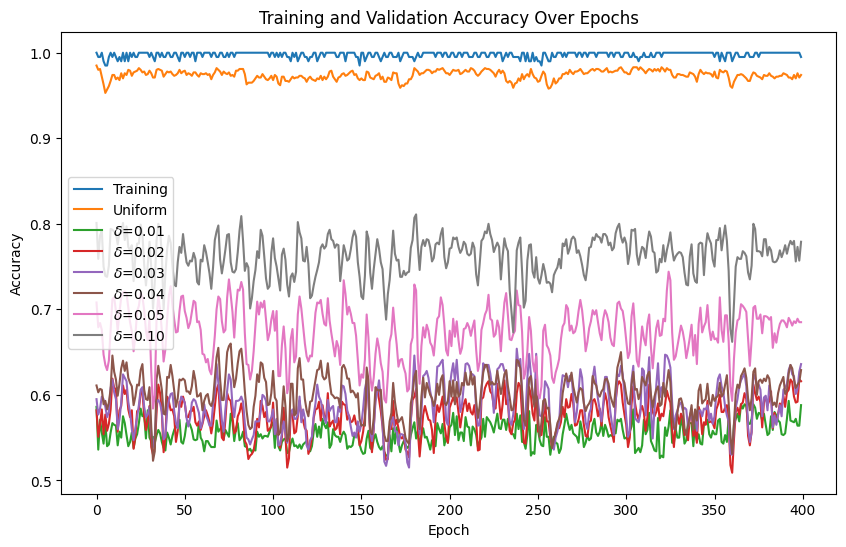

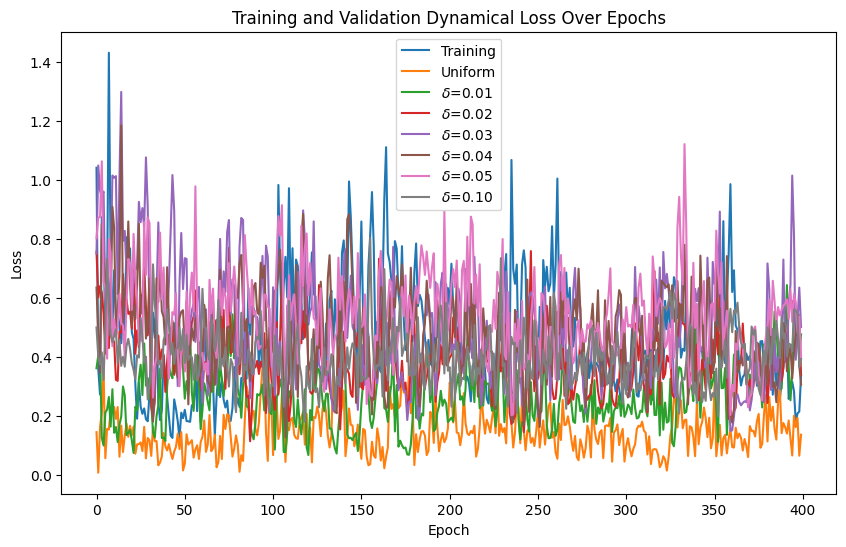

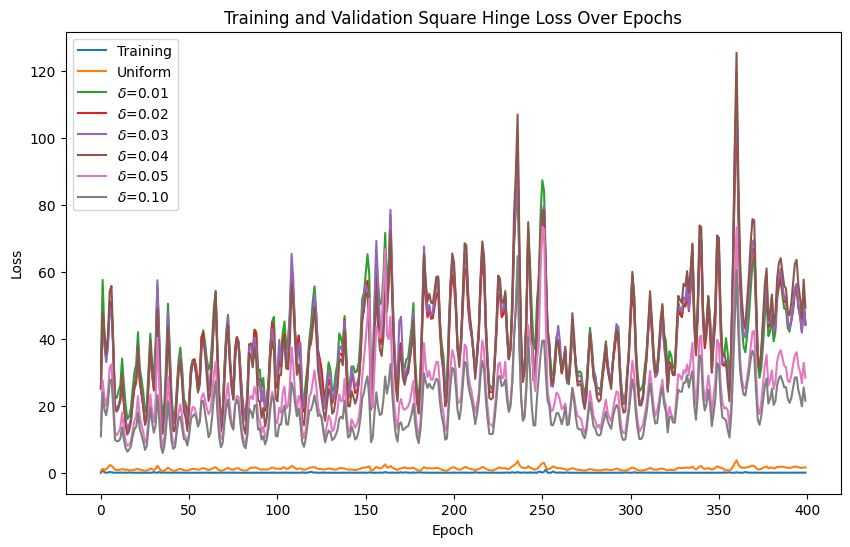

Accuracy: 0.9739999771118164


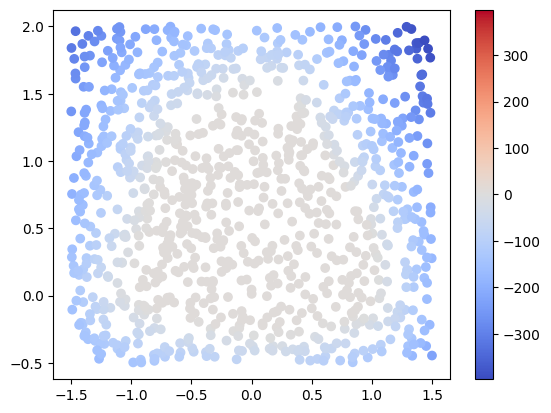

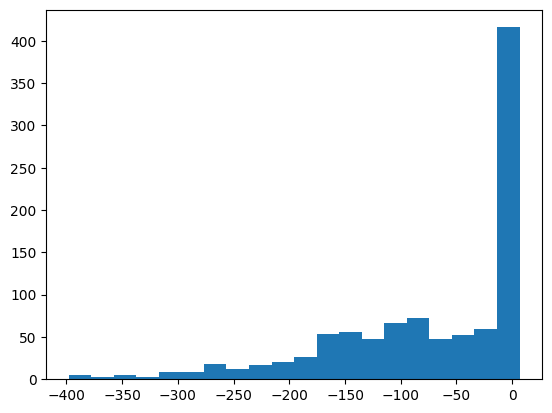

Accuracy: 0.5879999995231628


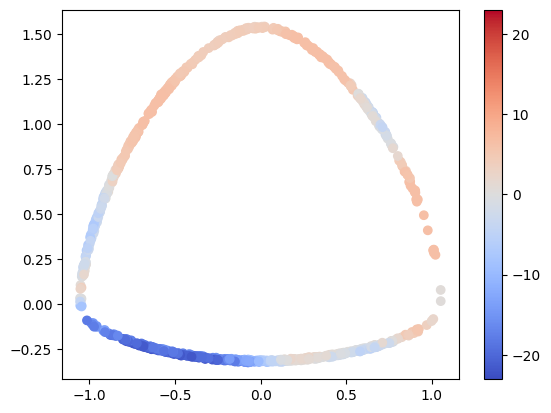

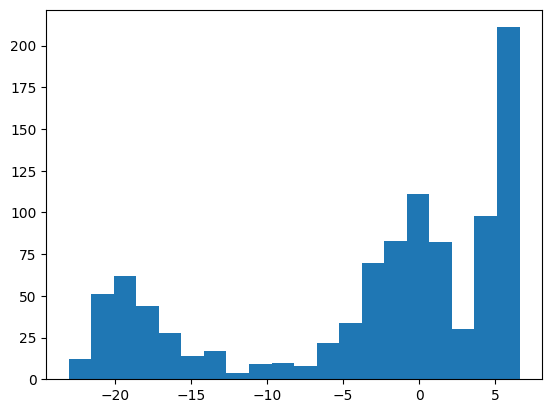

Accuracy: 0.6159999966621399


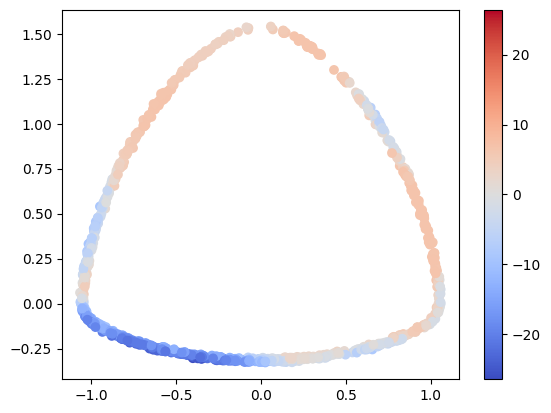

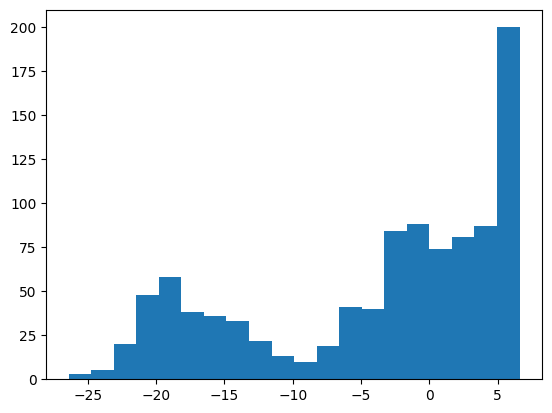

Accuracy: 0.6359999775886536


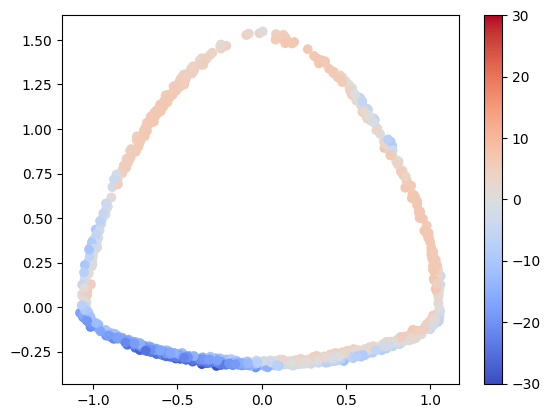

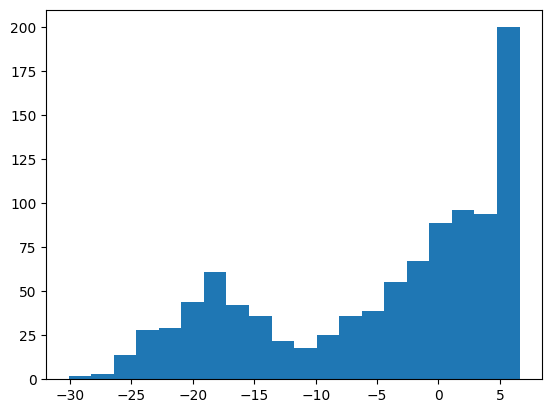

Accuracy: 0.6290000081062317


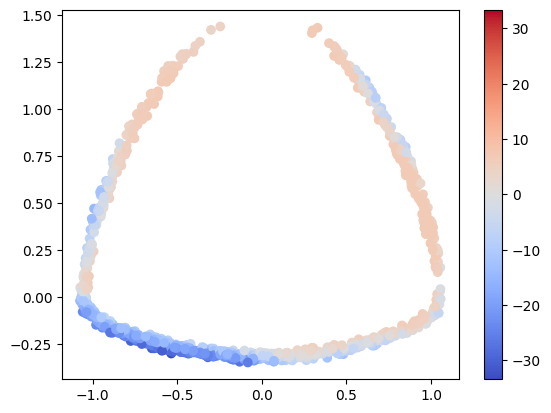

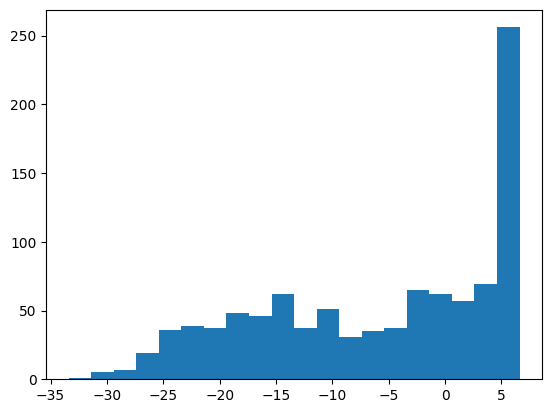

Accuracy: 0.6850000023841858


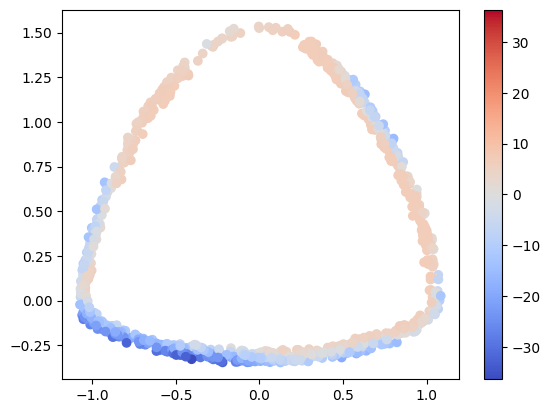

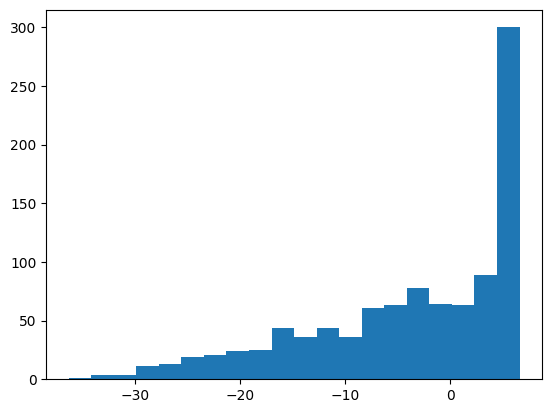

Accuracy: 0.7789999842643738


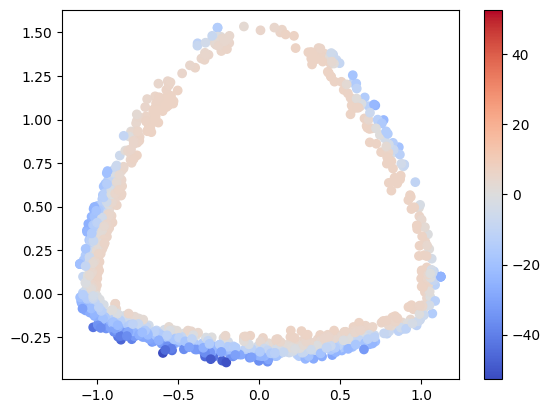

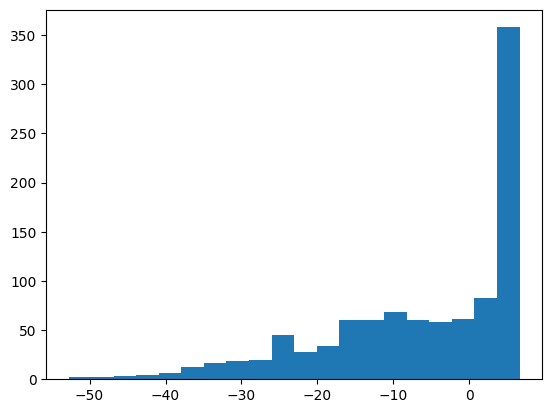

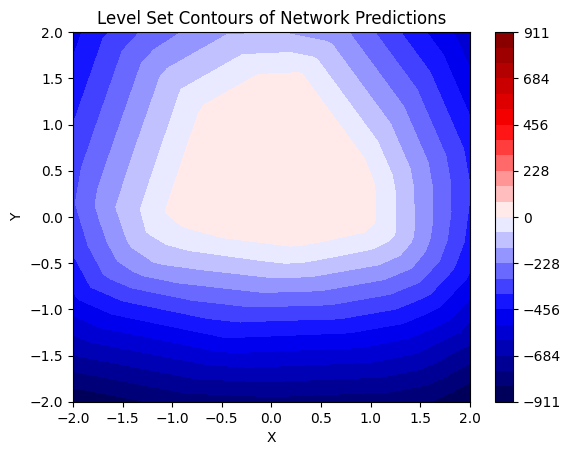

Overall Training Progress: 100%|██████████| 400/400 [20:28<00:00,  3.07s/it, Training Accuracy=1, Validation1 Accuracy=0.969, Validation001 Accuracy=0.556, Validation002 Accuracy=0.607, Validation003 Accuracy=0.59, Validation004 Accuracy=0.63, Validation005 Accuracy=0.705, Validation010 Accuracy=0.793]      


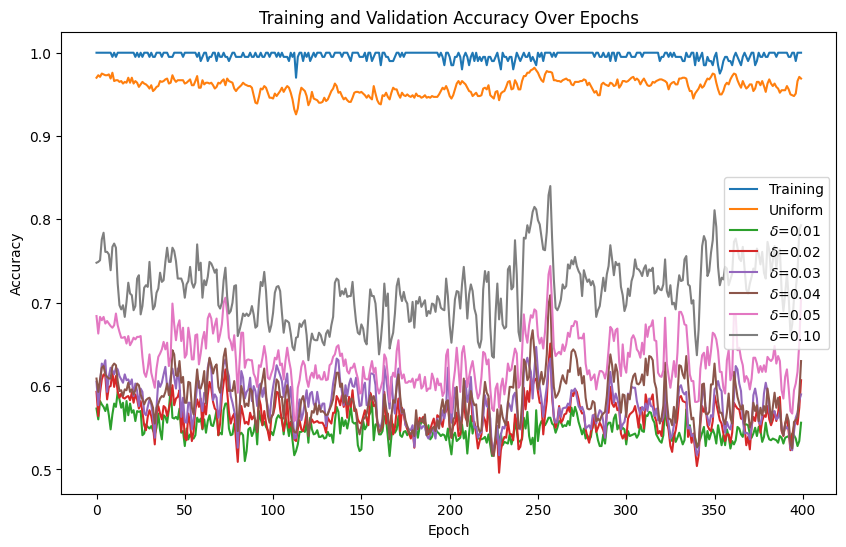

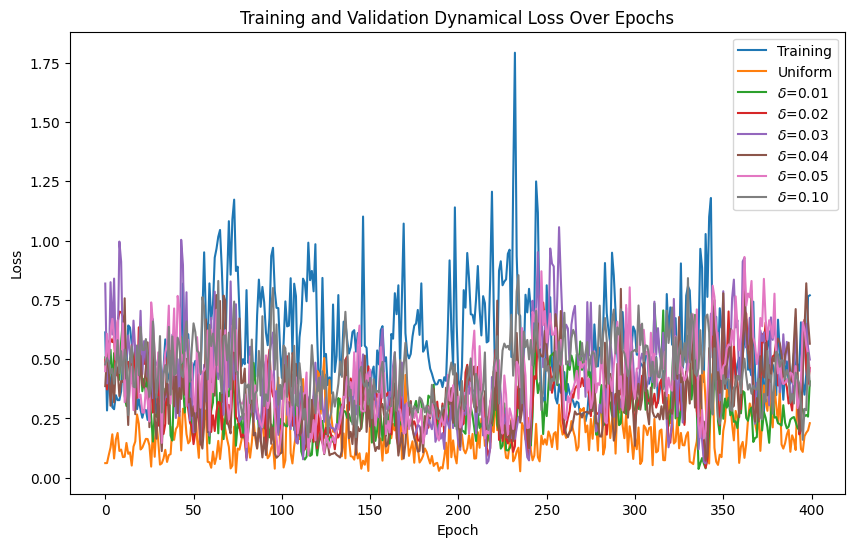

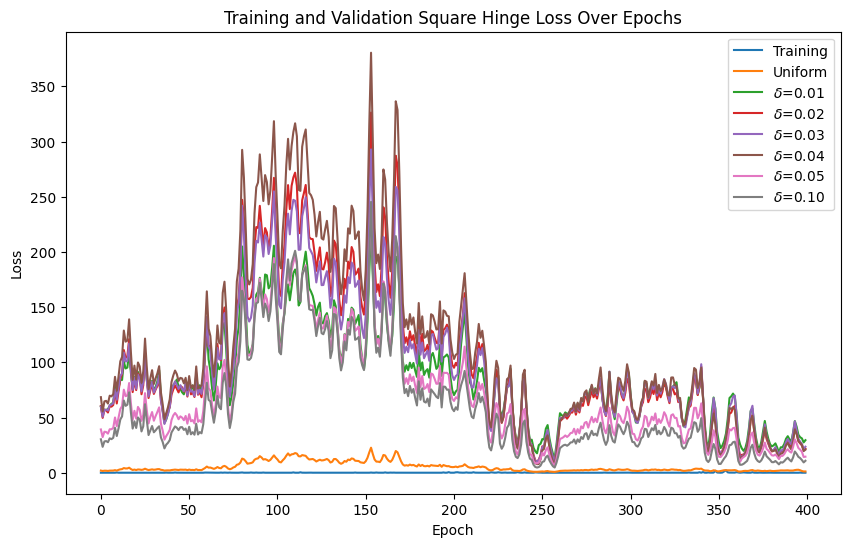

Accuracy: 0.968999981880188


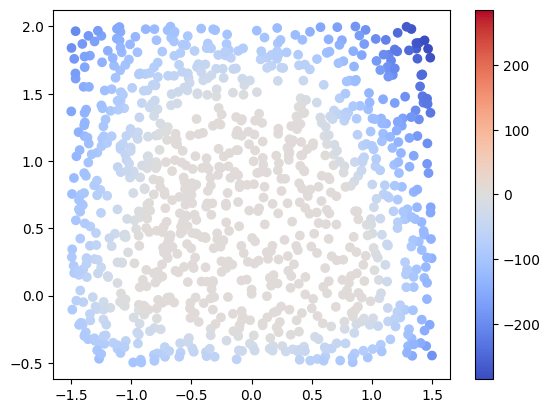

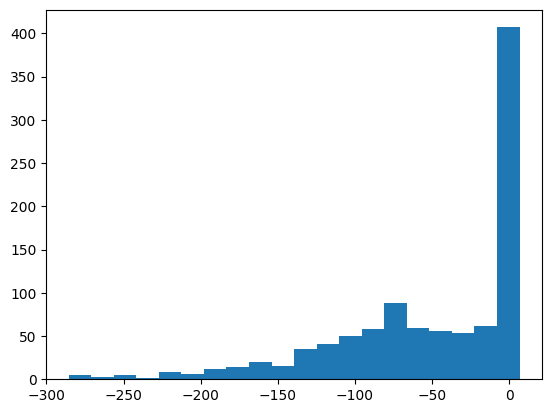

Accuracy: 0.5559999942779541


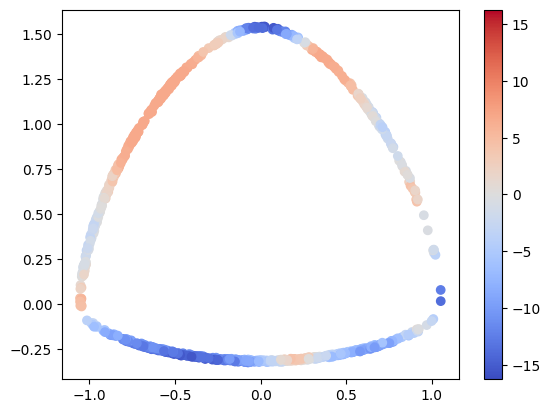

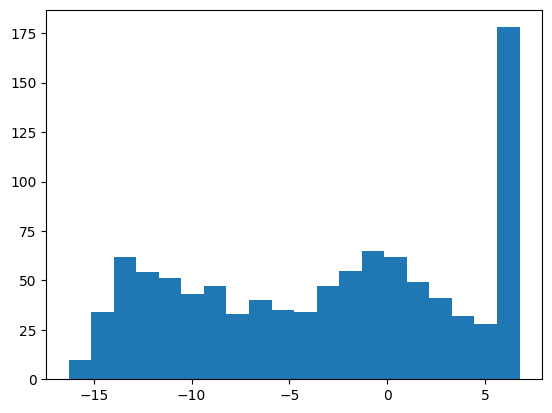

Accuracy: 0.6069999933242798


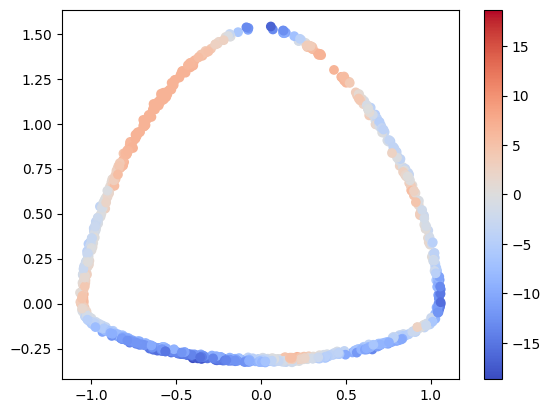

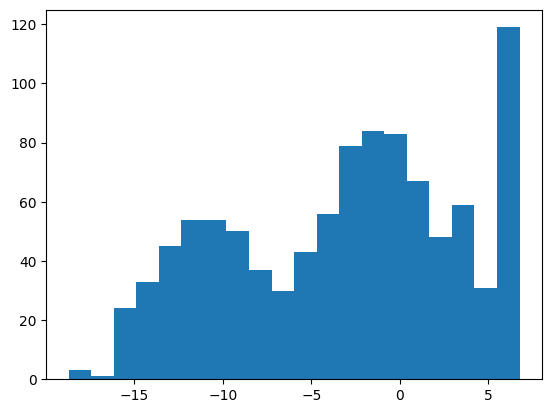

Accuracy: 0.5899999737739563


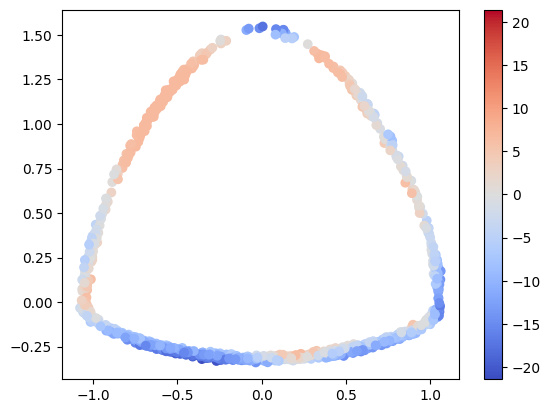

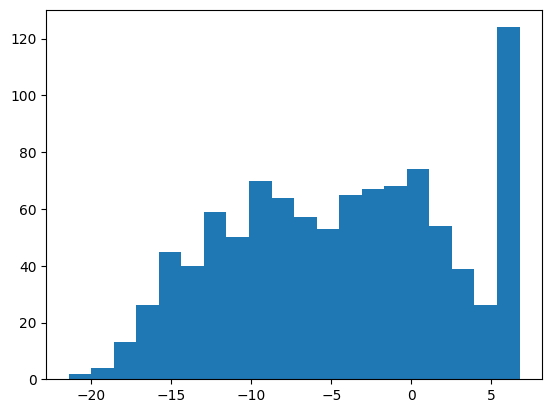

Accuracy: 0.6299999952316284


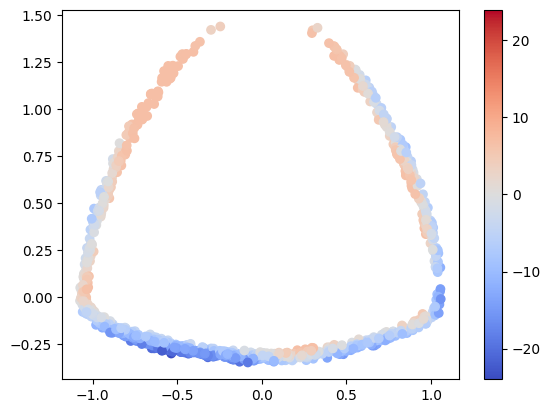

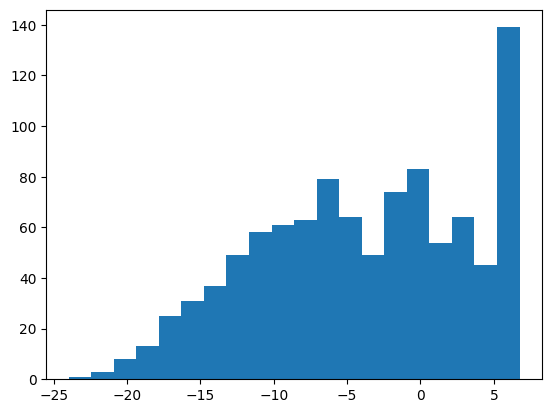

Accuracy: 0.7049999833106995


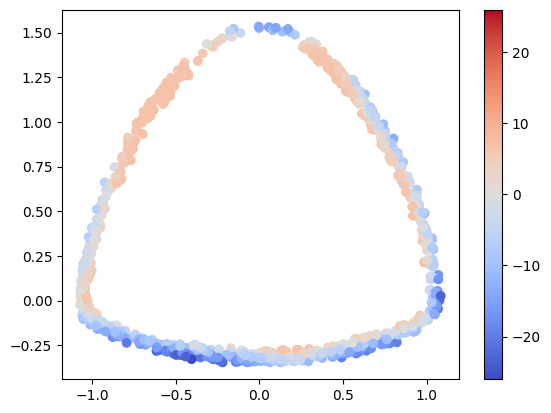

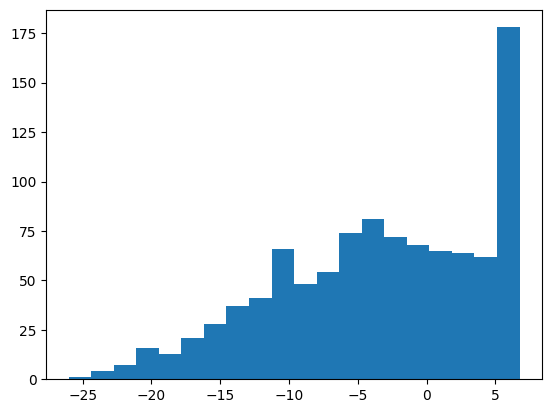

Accuracy: 0.7929999828338623


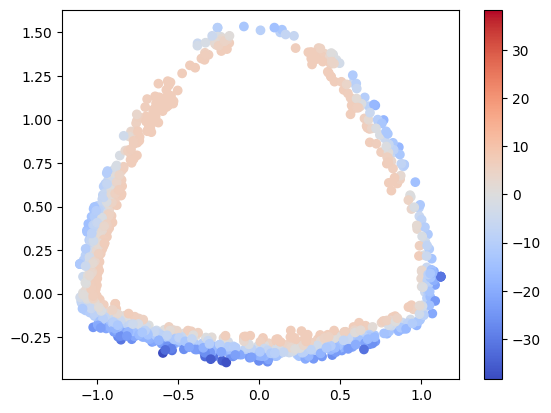

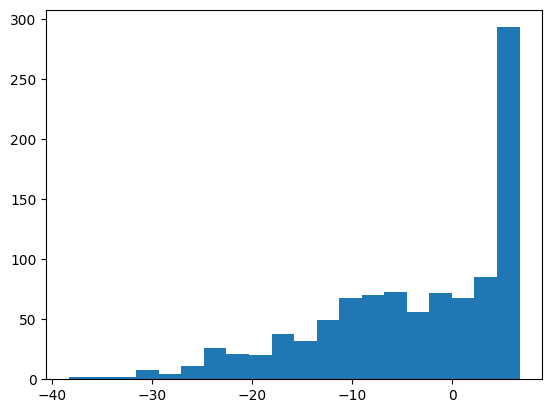

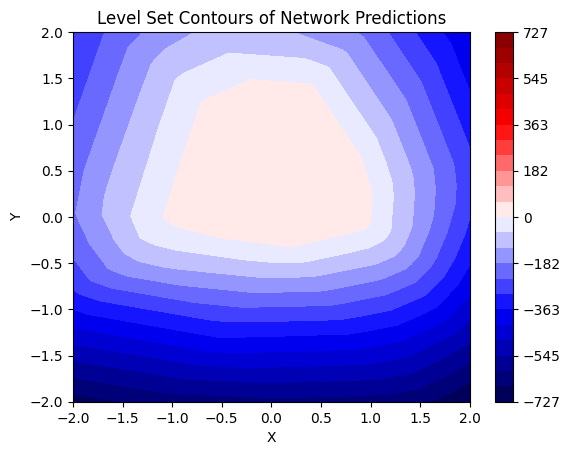

Overall Training Progress: 100%|██████████| 400/400 [21:08<00:00,  3.17s/it, Training Accuracy=0.995, Validation1 Accuracy=0.962, Validation001 Accuracy=0.52, Validation002 Accuracy=0.544, Validation003 Accuracy=0.554, Validation004 Accuracy=0.563, Validation005 Accuracy=0.587, Validation010 Accuracy=0.692] 


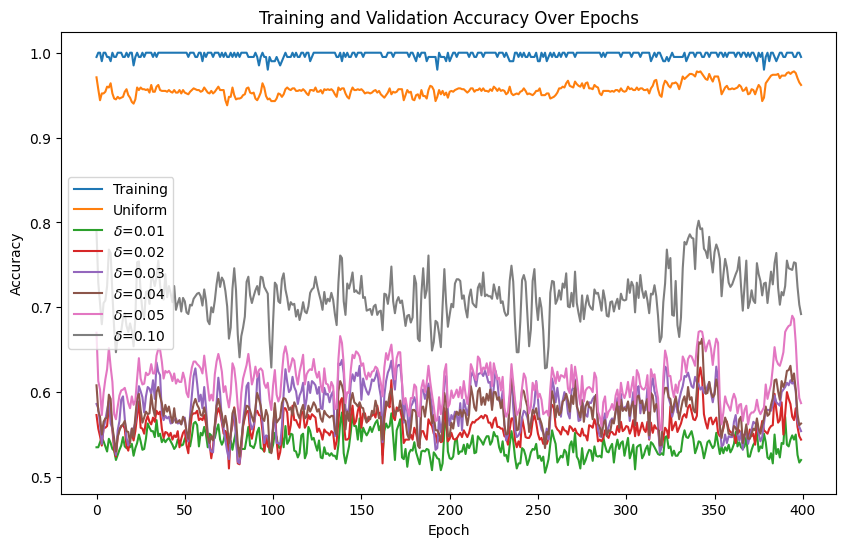

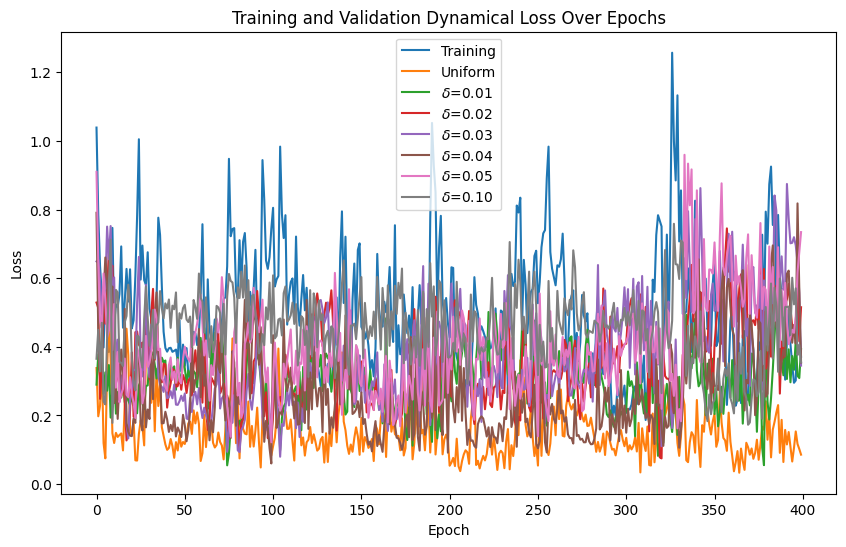

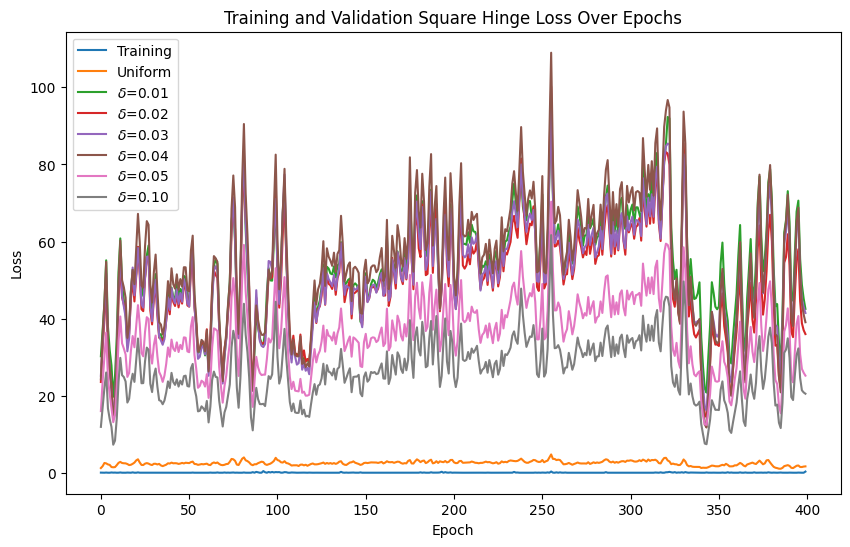

Accuracy: 0.9620000123977661


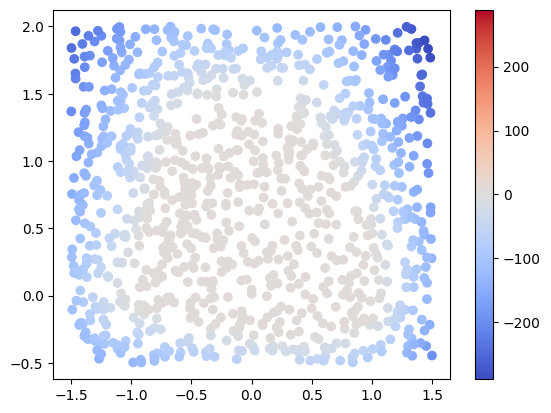

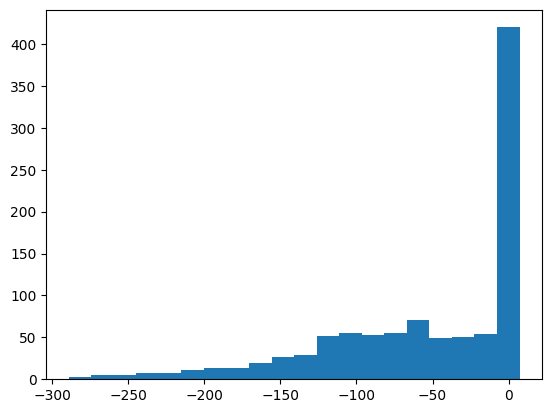

Accuracy: 0.5199999809265137


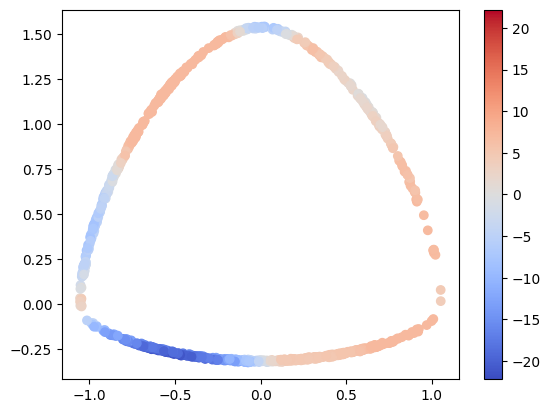

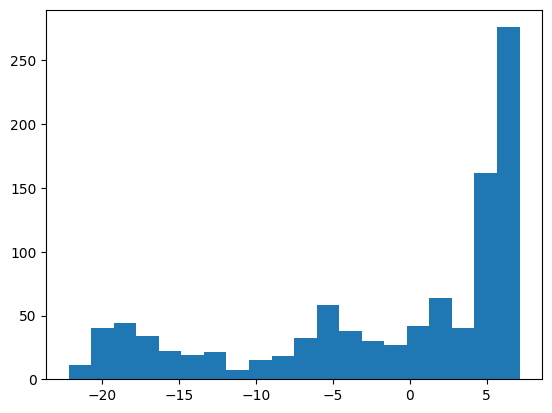

Accuracy: 0.5440000295639038


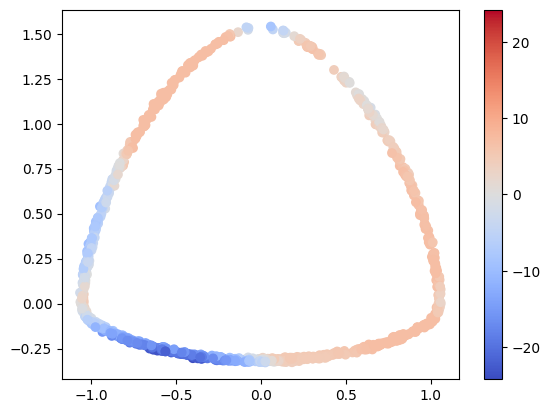

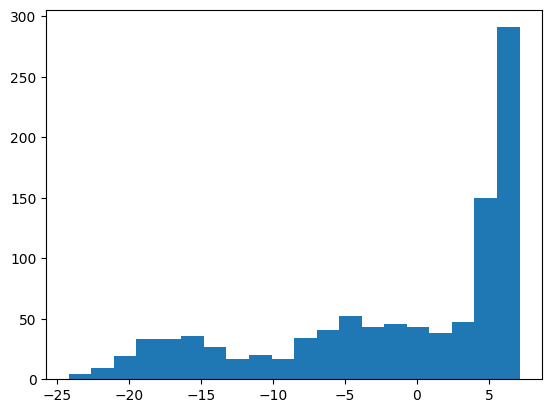

Accuracy: 0.5540000200271606


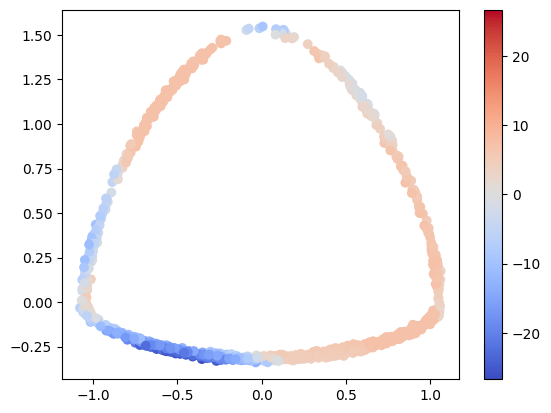

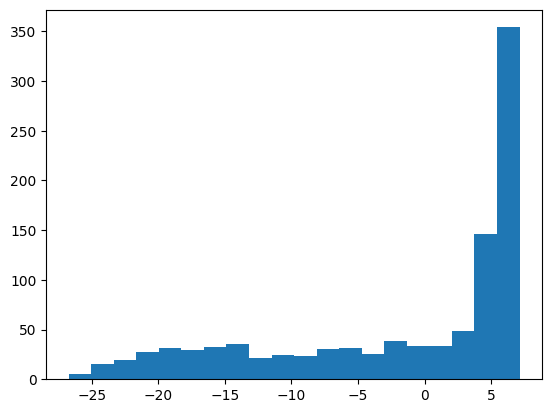

Accuracy: 0.5630000233650208


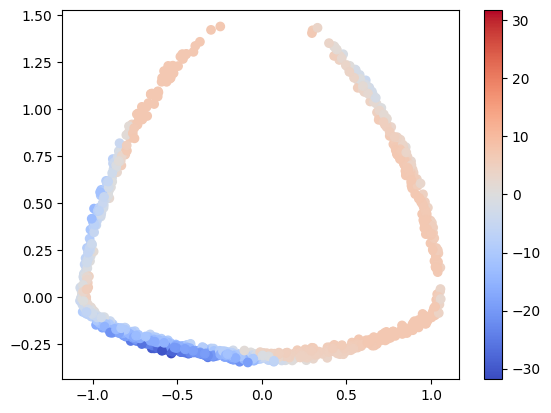

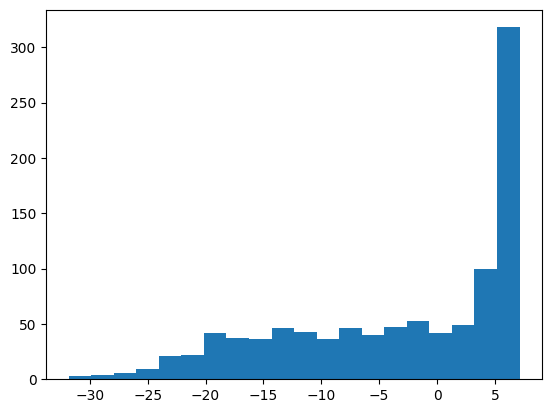

Accuracy: 0.5870000123977661


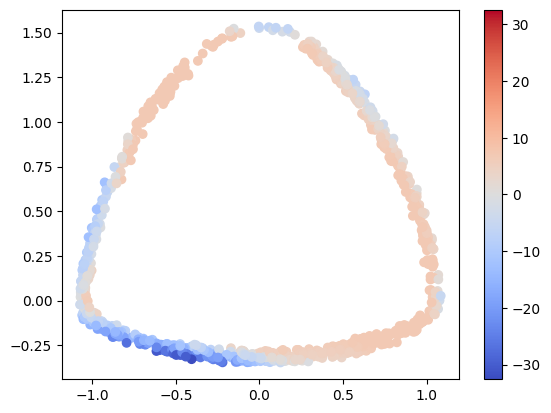

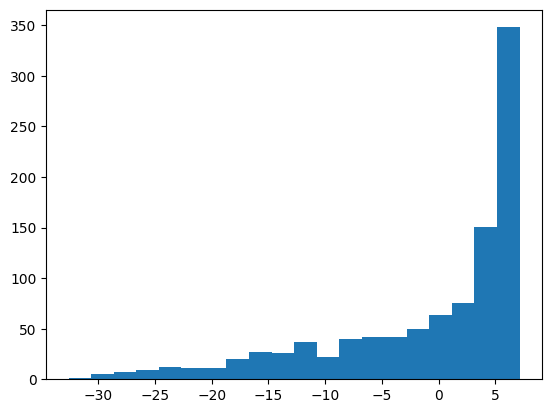

Accuracy: 0.6919999718666077


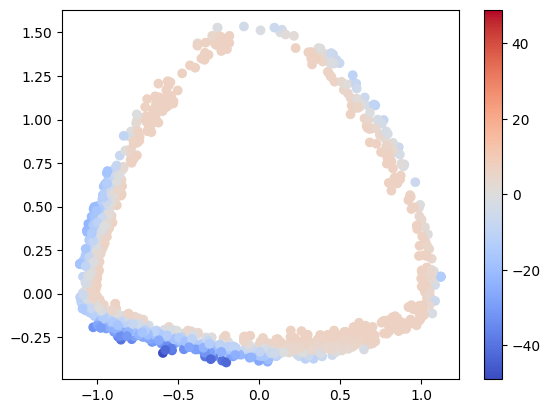

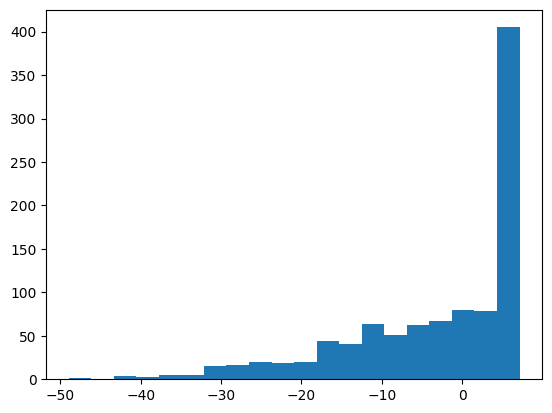

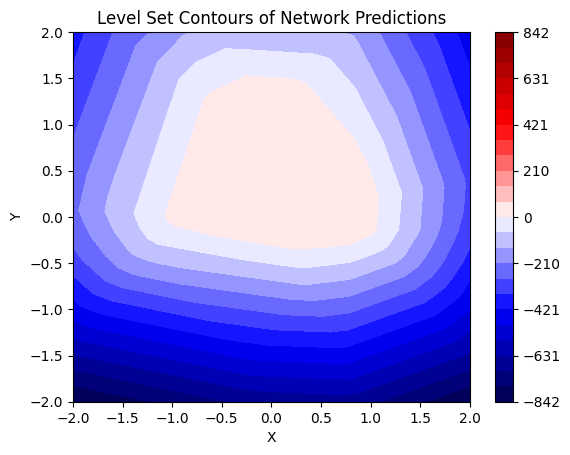

Overall Training Progress: 100%|██████████| 400/400 [21:47<00:00,  3.27s/it, Training Accuracy=1, Validation1 Accuracy=0.984, Validation001 Accuracy=0.513, Validation002 Accuracy=0.539, Validation003 Accuracy=0.542, Validation004 Accuracy=0.567, Validation005 Accuracy=0.608, Validation010 Accuracy=0.733]    


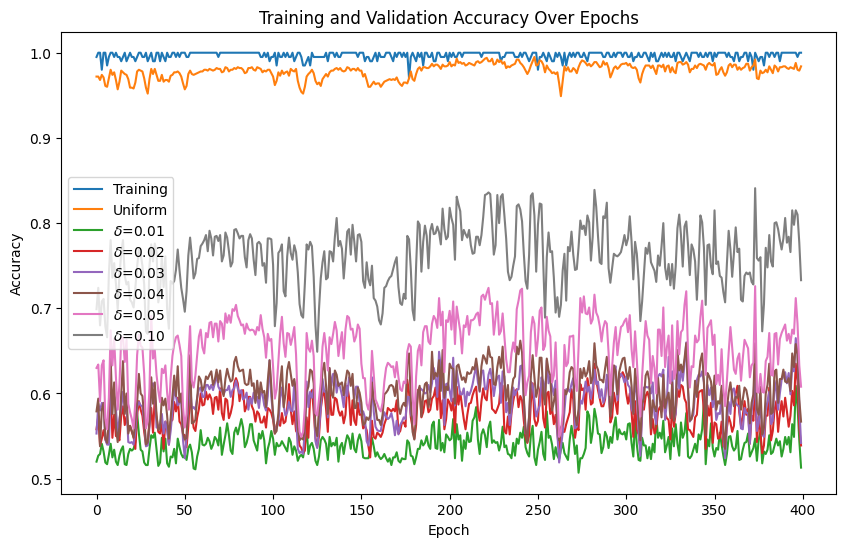

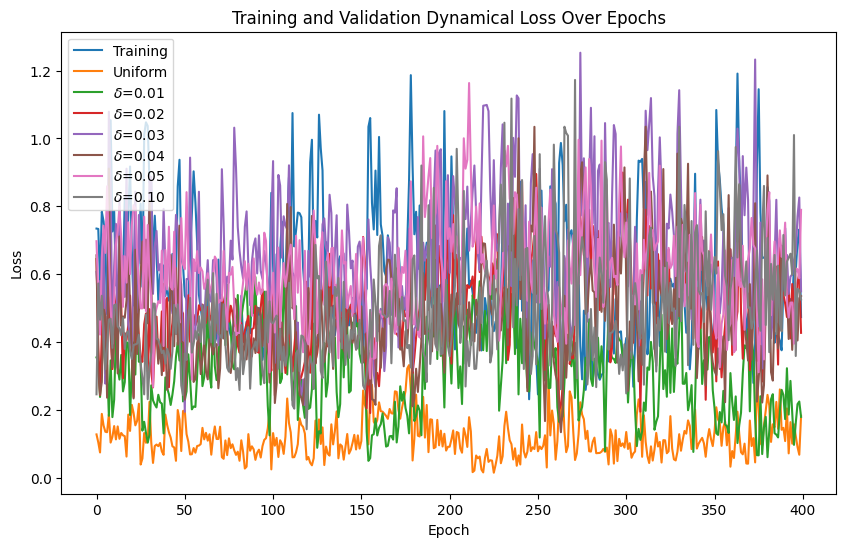

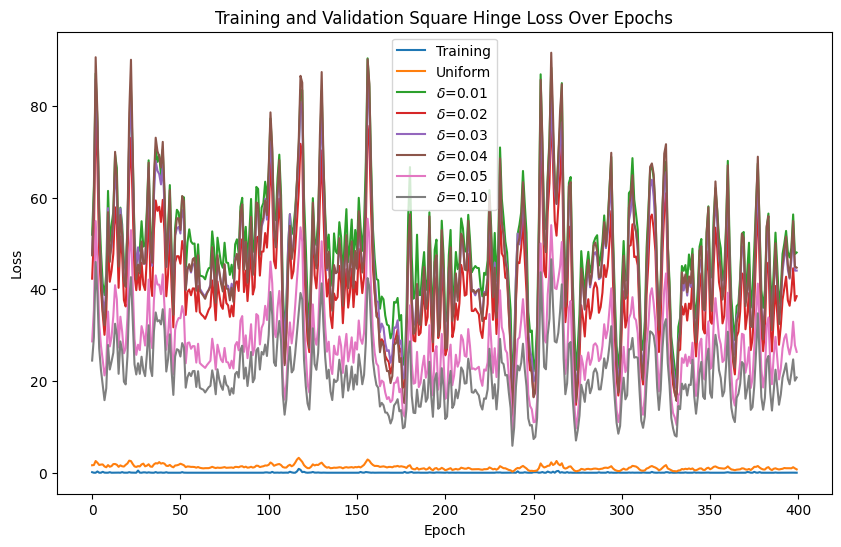

Accuracy: 0.984000027179718


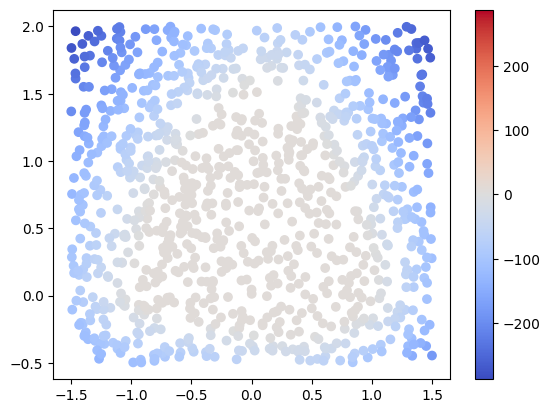

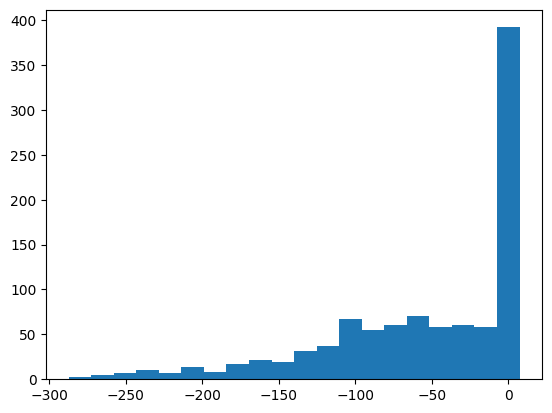

Accuracy: 0.5130000114440918


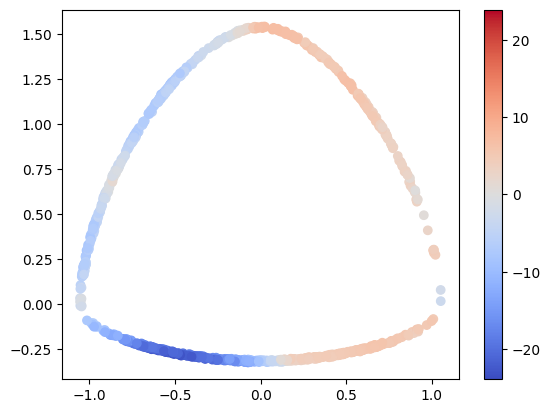

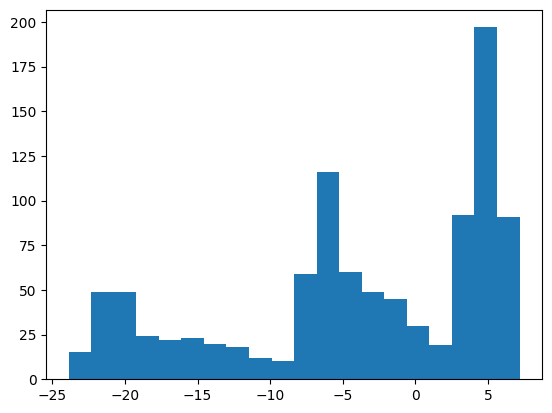

Accuracy: 0.5389999747276306


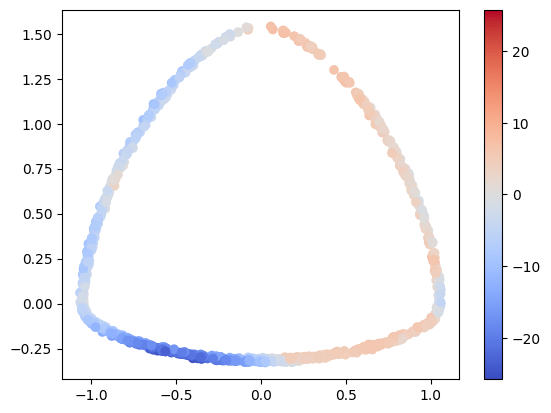

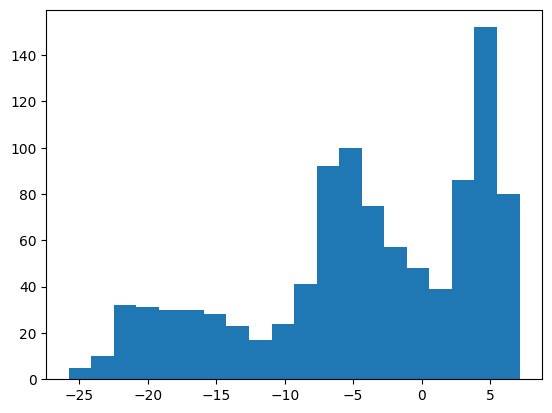

Accuracy: 0.5419999957084656


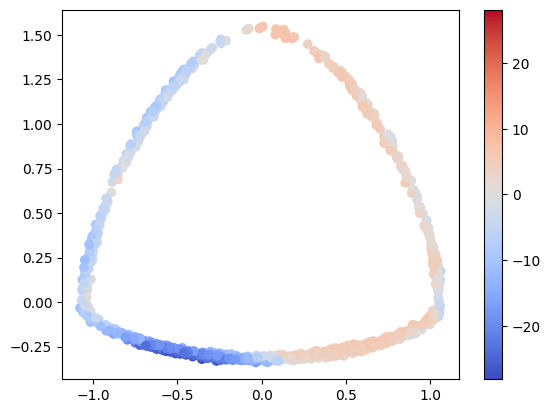

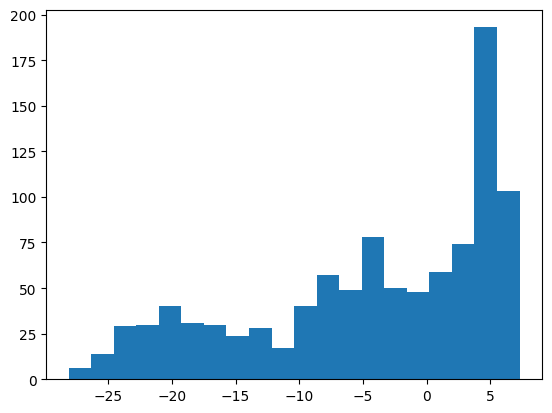

Accuracy: 0.5669999718666077


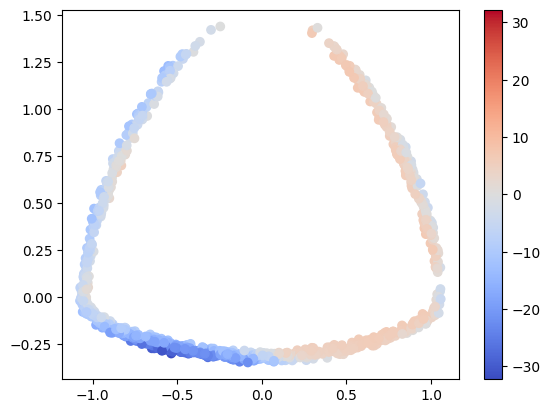

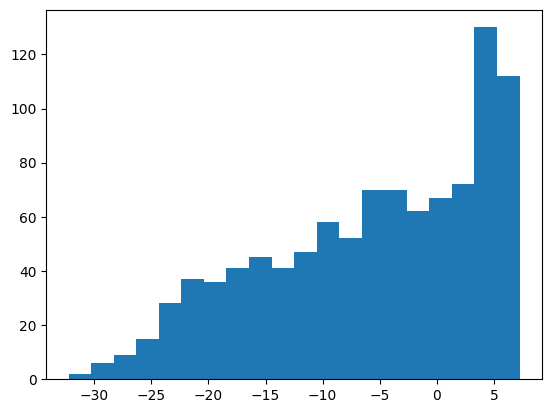

Accuracy: 0.6079999804496765


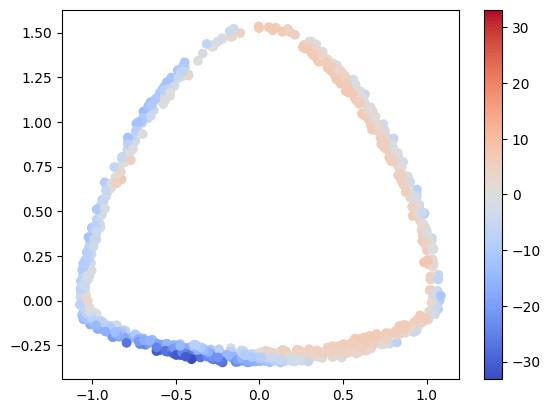

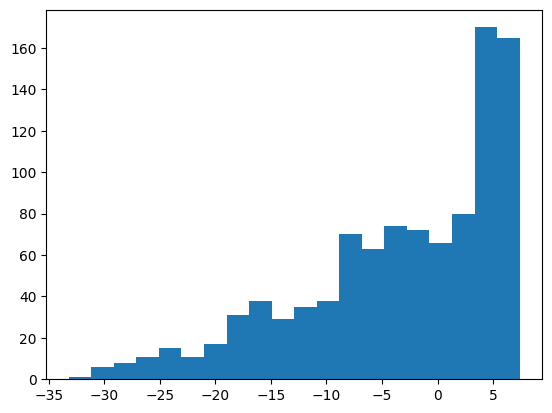

Accuracy: 0.7329999804496765


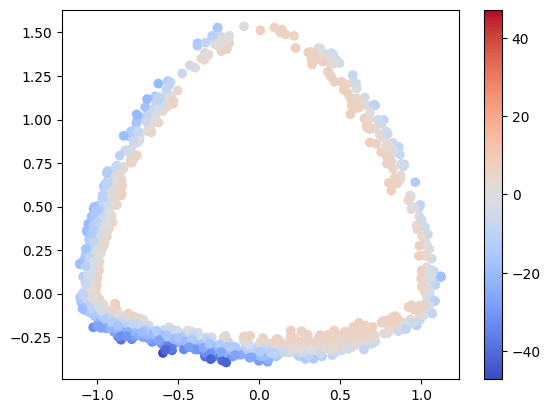

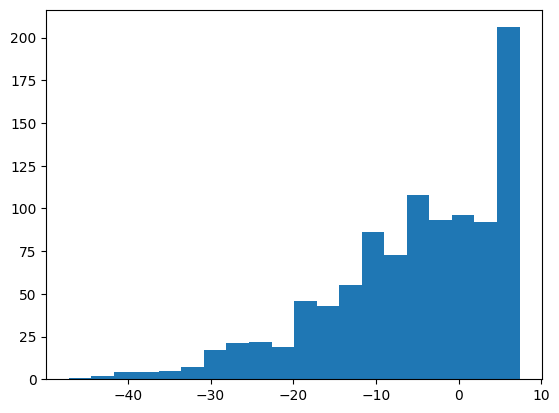

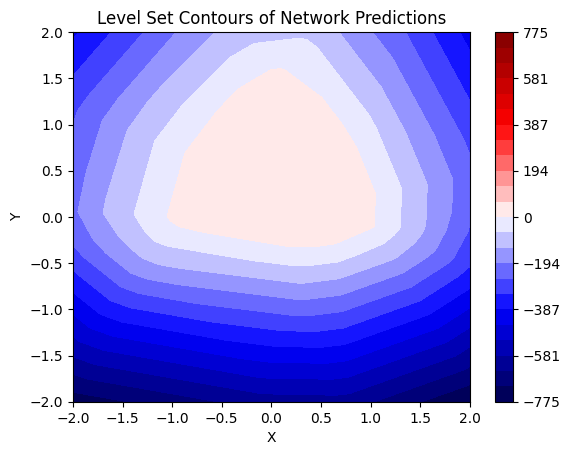

Overall Training Progress: 100%|██████████| 400/400 [22:20<00:00,  3.35s/it, Training Accuracy=1, Validation1 Accuracy=0.981, Validation001 Accuracy=0.546, Validation002 Accuracy=0.573, Validation003 Accuracy=0.571, Validation004 Accuracy=0.582, Validation005 Accuracy=0.671, Validation010 Accuracy=0.716]    


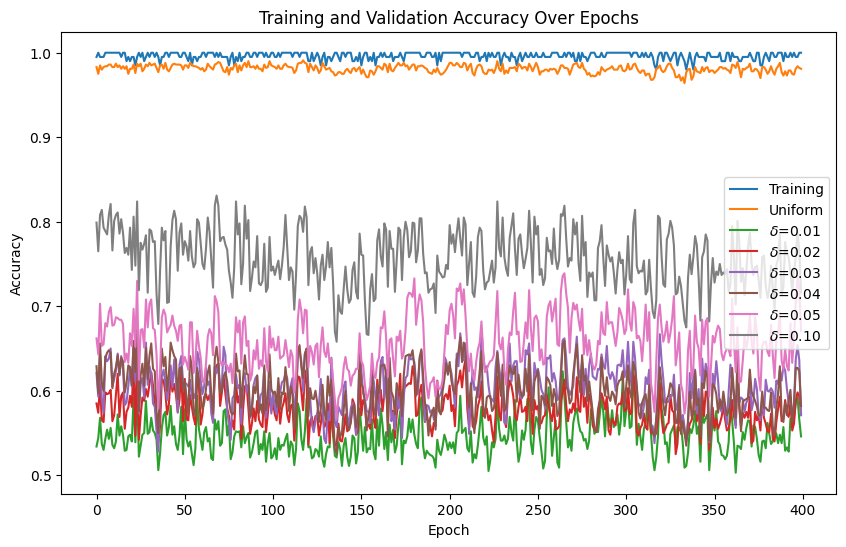

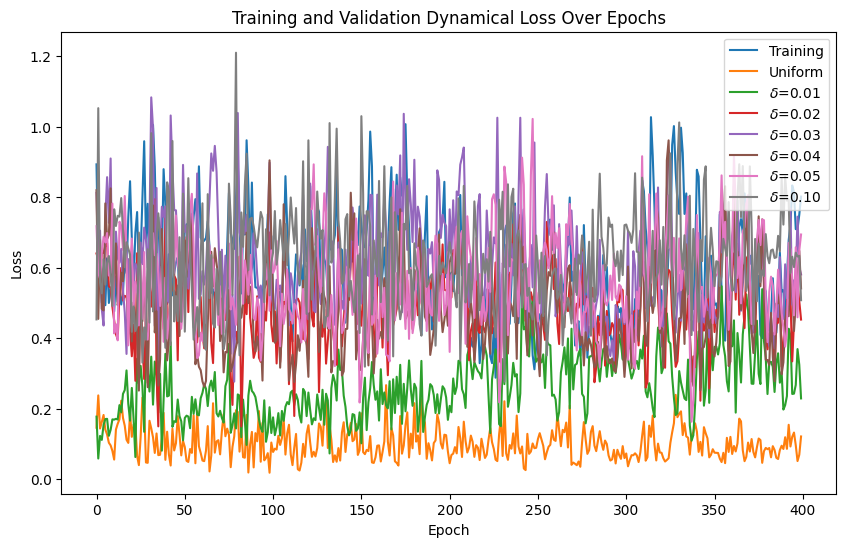

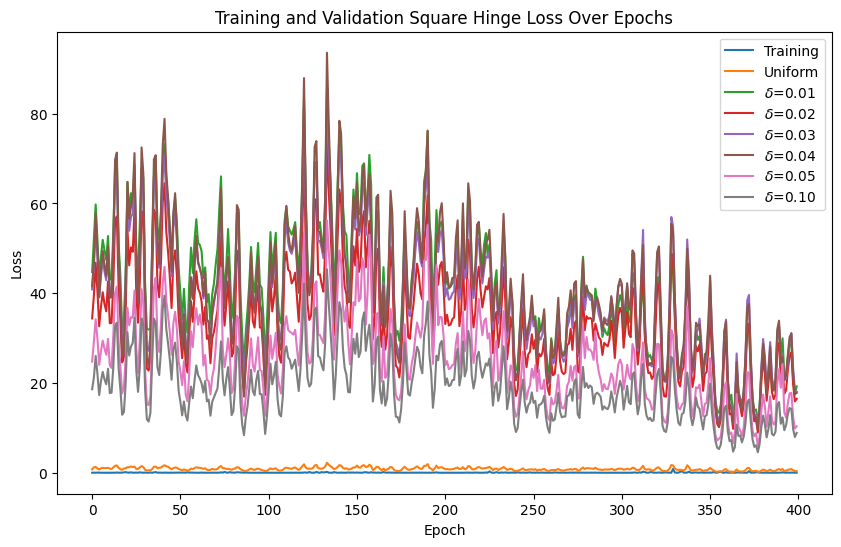

Accuracy: 0.9810000061988831


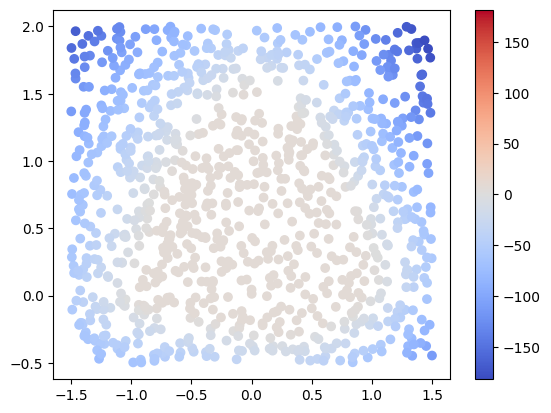

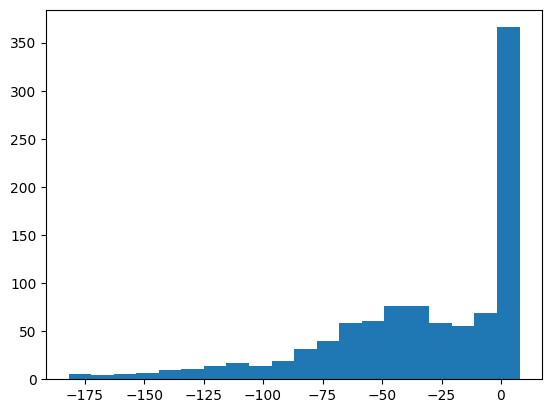

Accuracy: 0.5460000038146973


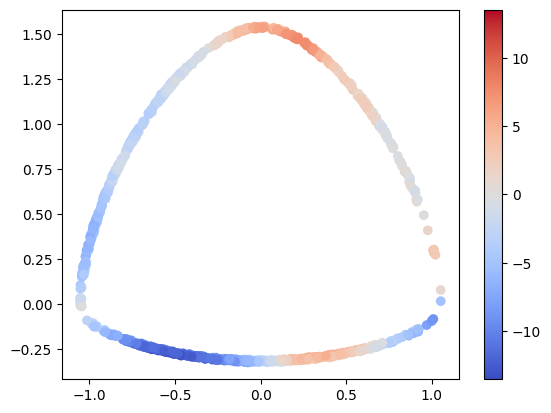

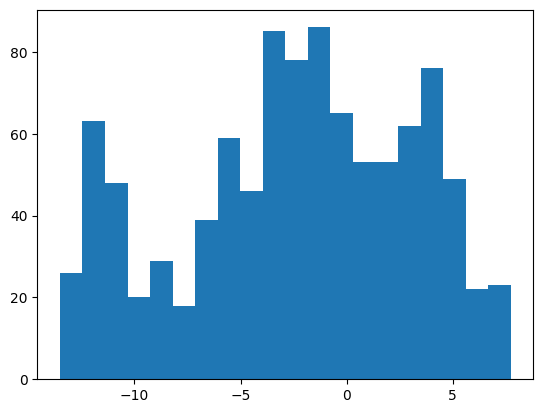

Accuracy: 0.5730000138282776


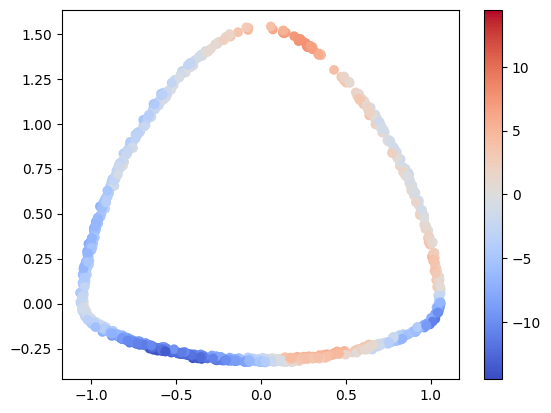

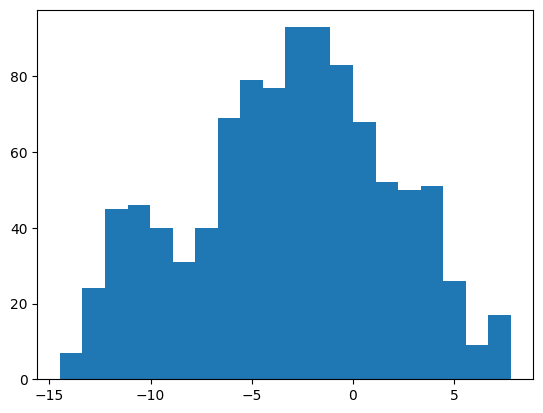

Accuracy: 0.5709999799728394


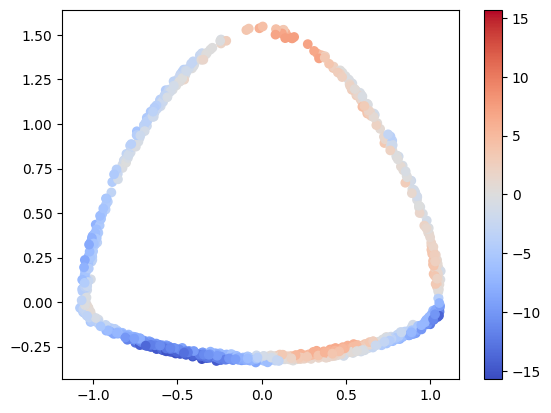

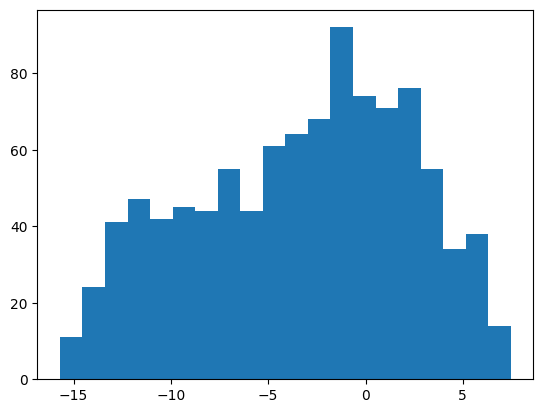

Accuracy: 0.5820000171661377


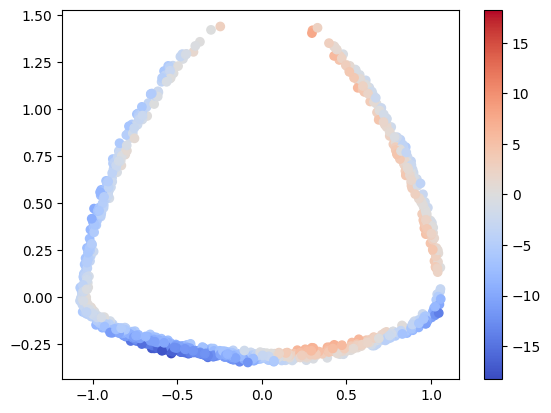

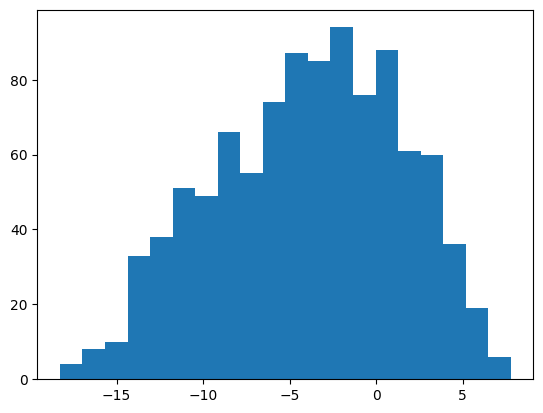

Accuracy: 0.6710000038146973


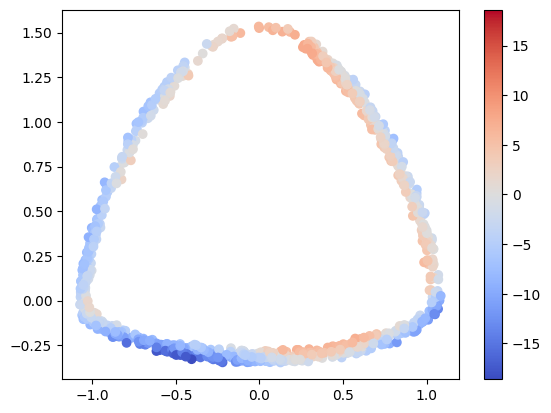

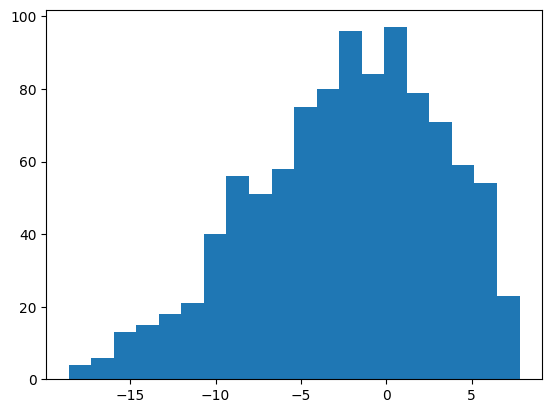

Accuracy: 0.7160000205039978


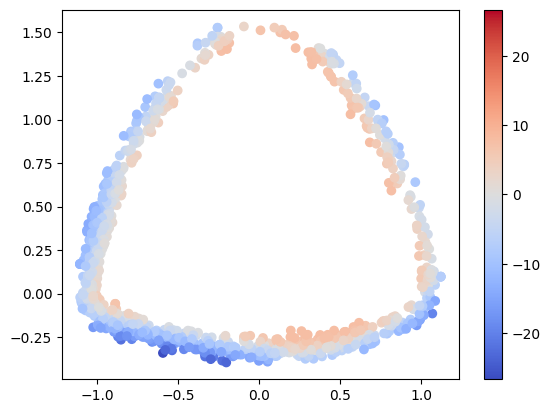

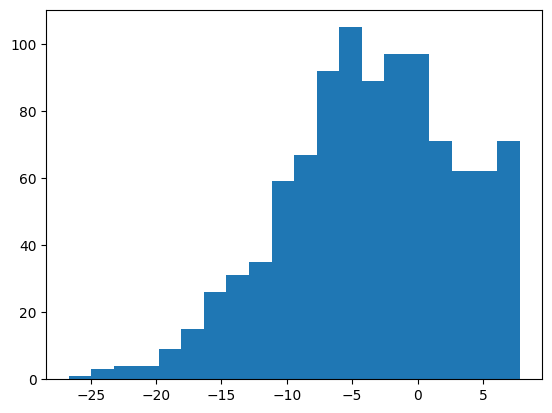

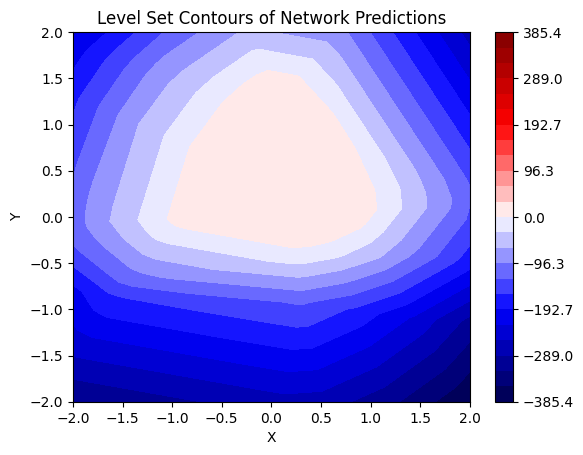

Overall Training Progress: 100%|██████████| 400/400 [22:58<00:00,  3.45s/it, Training Accuracy=1, Validation1 Accuracy=0.982, Validation001 Accuracy=0.587, Validation002 Accuracy=0.587, Validation003 Accuracy=0.628, Validation004 Accuracy=0.618, Validation005 Accuracy=0.73, Validation010 Accuracy=0.761]     


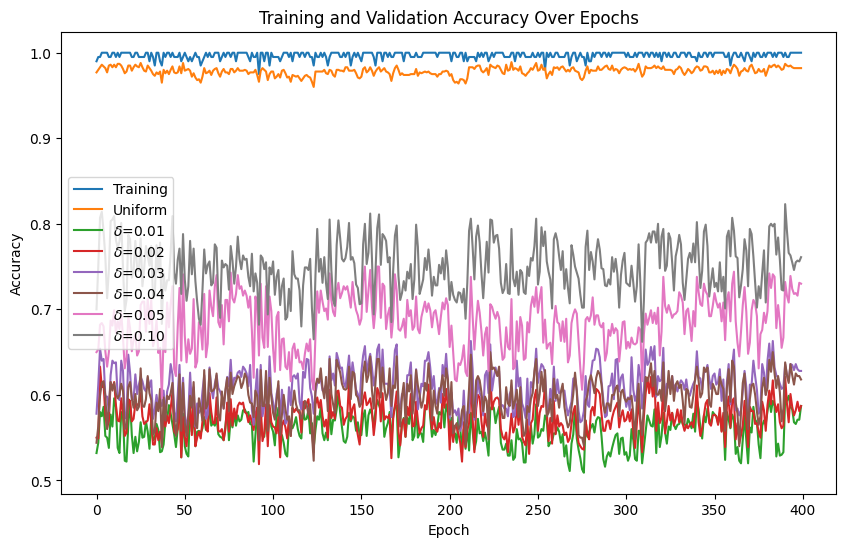

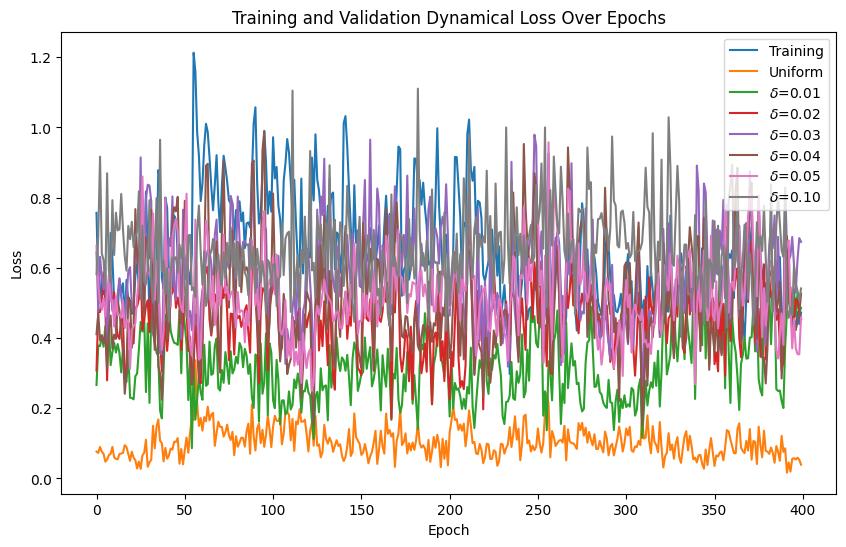

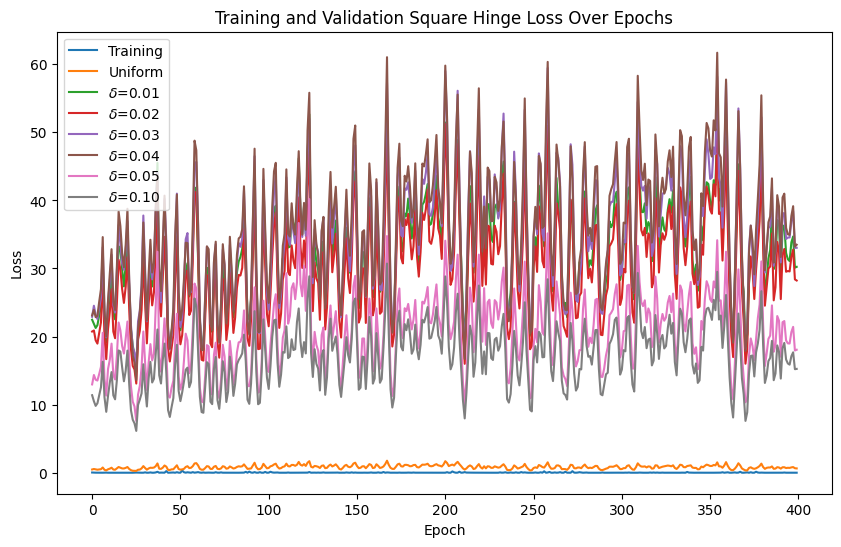

Accuracy: 0.9819999933242798


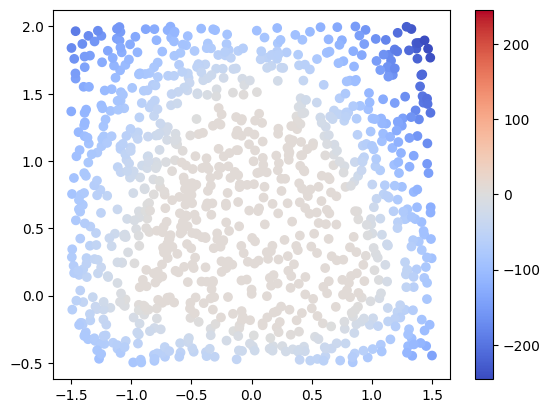

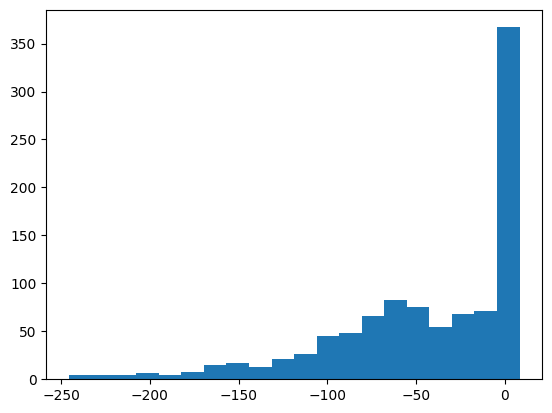

Accuracy: 0.5870000123977661


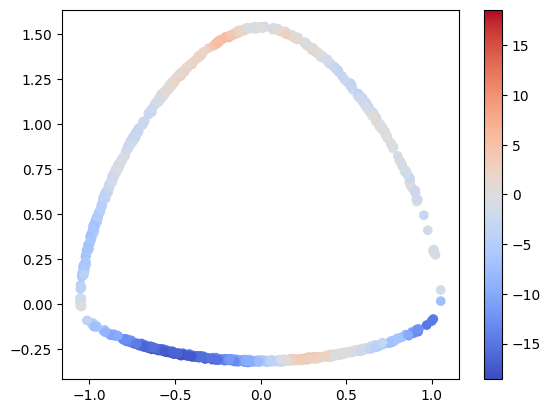

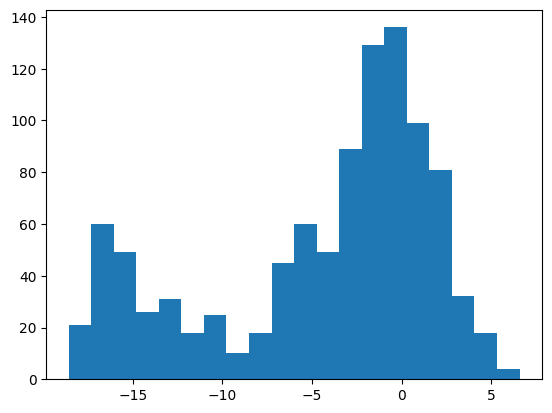

Accuracy: 0.5870000123977661


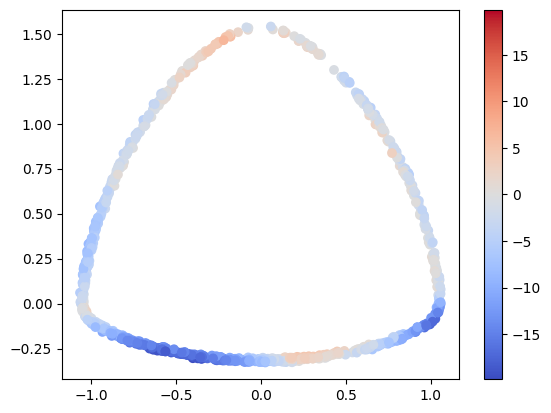

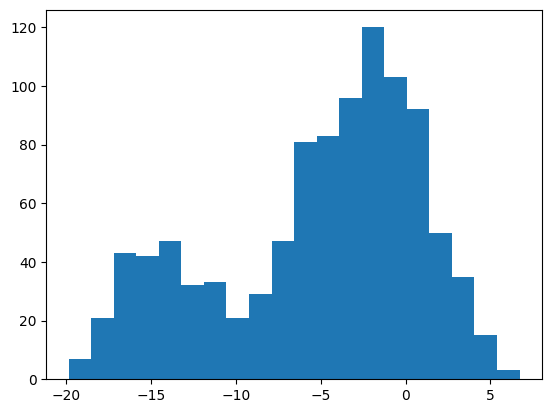

Accuracy: 0.628000020980835


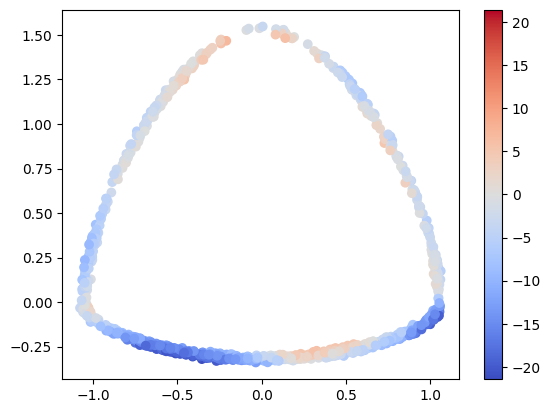

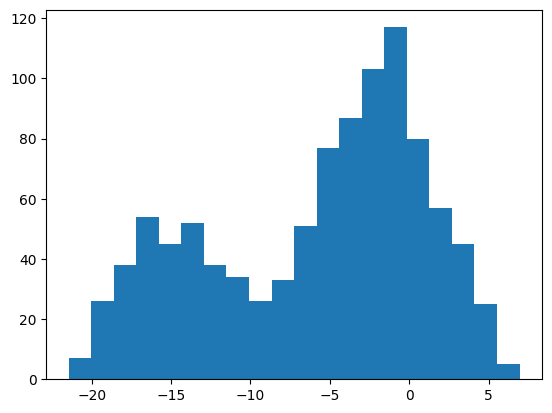

Accuracy: 0.6179999709129333


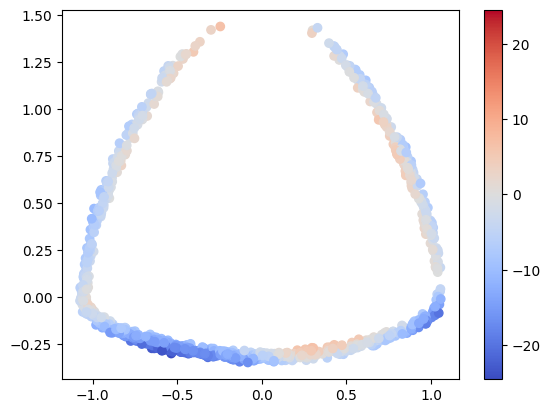

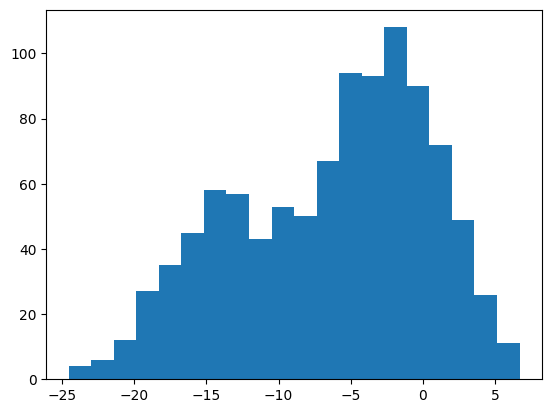

Accuracy: 0.7300000190734863


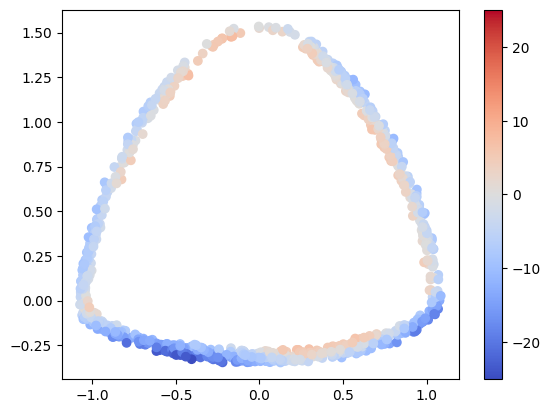

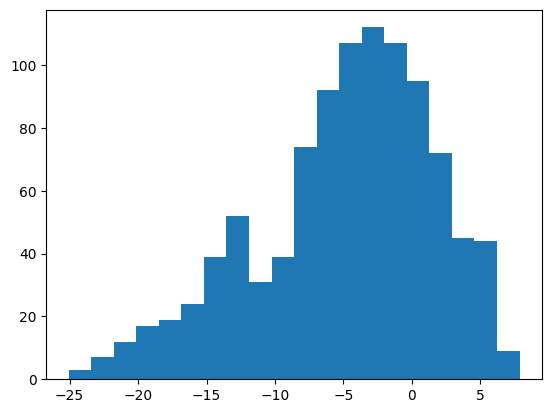

Accuracy: 0.7609999775886536


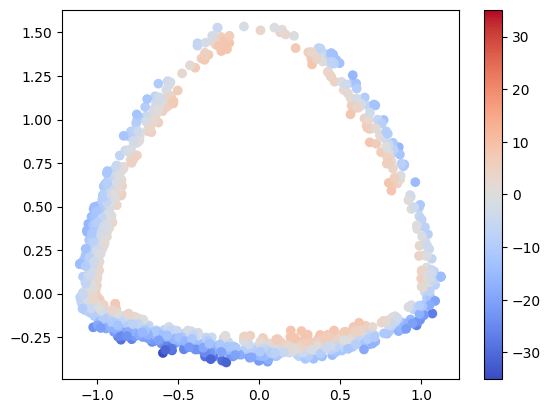

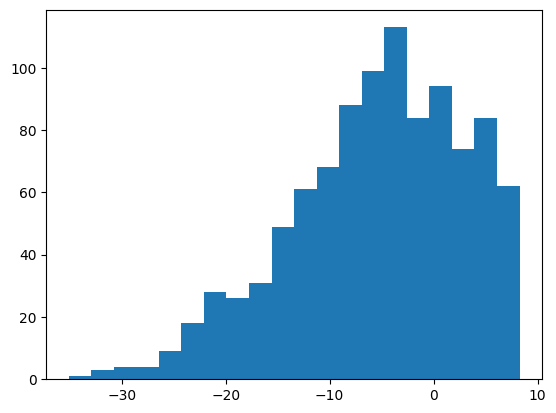

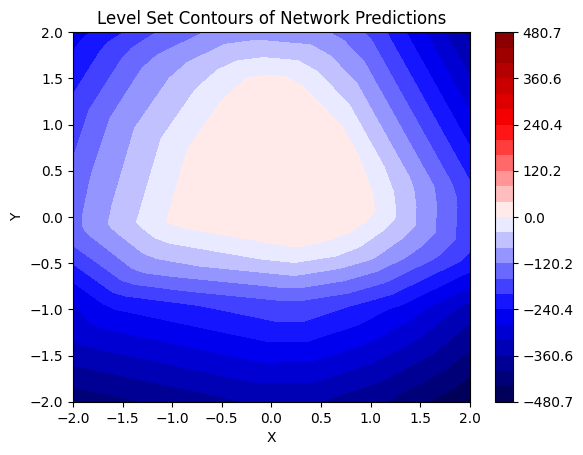

Overall Training Progress: 100%|██████████| 400/400 [23:32<00:00,  3.53s/it, Training Accuracy=1, Validation1 Accuracy=0.975, Validation001 Accuracy=0.517, Validation002 Accuracy=0.587, Validation003 Accuracy=0.635, Validation004 Accuracy=0.613, Validation005 Accuracy=0.64, Validation010 Accuracy=0.756]     


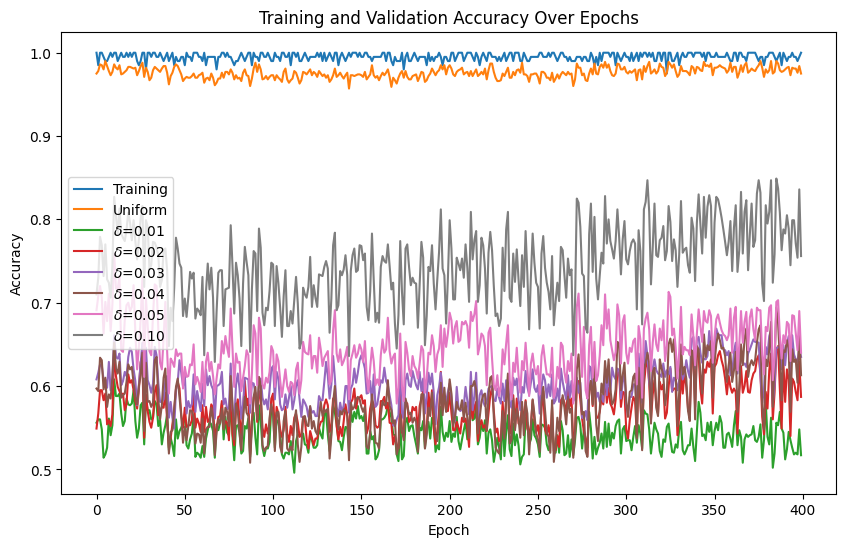

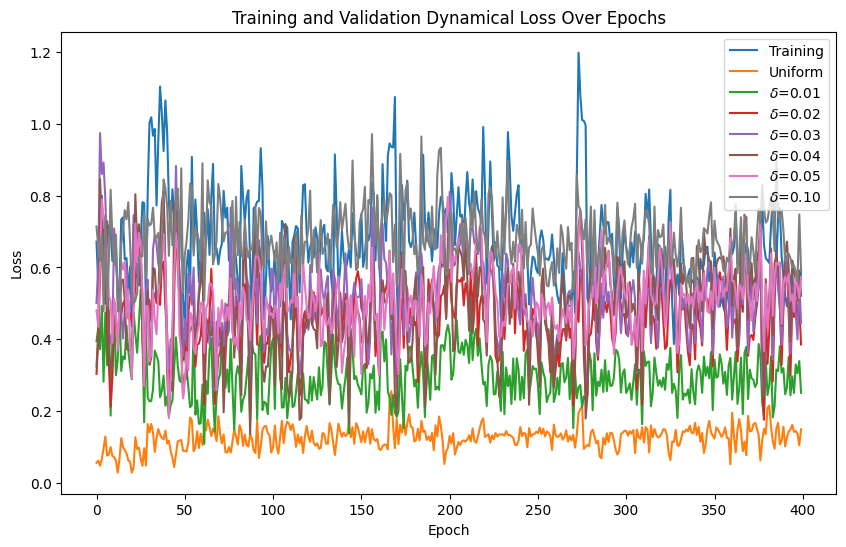

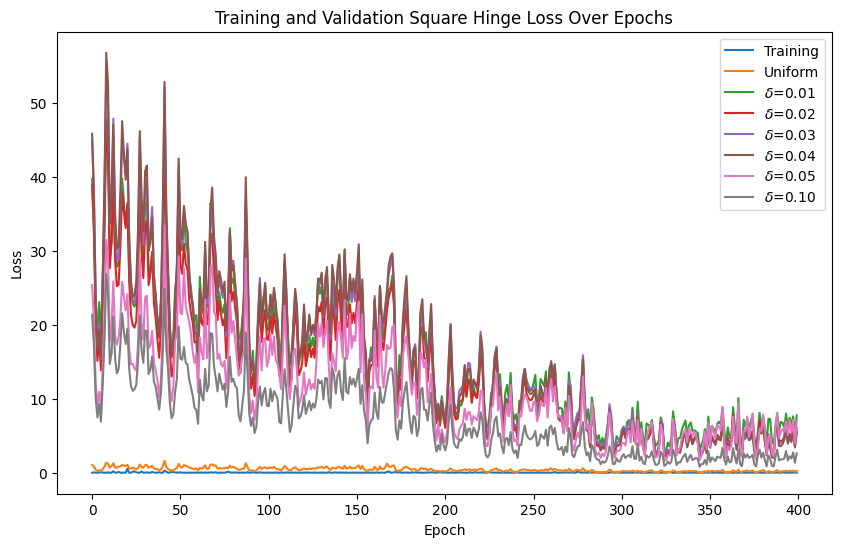

Accuracy: 0.9750000238418579


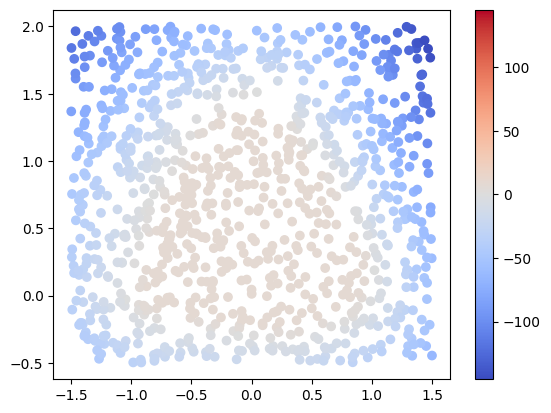

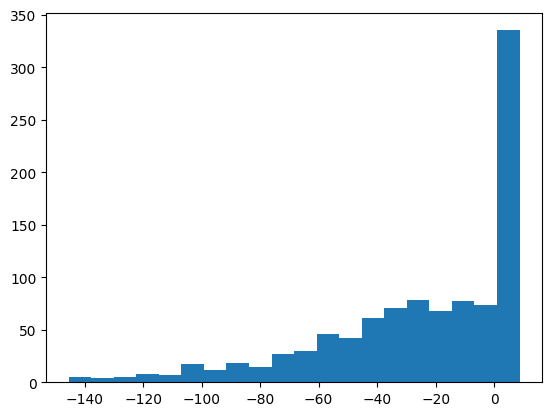

Accuracy: 0.5170000195503235


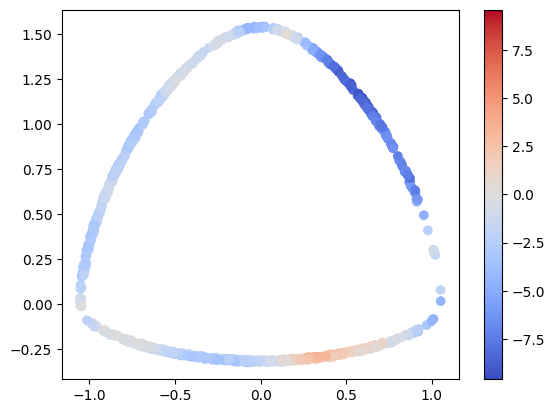

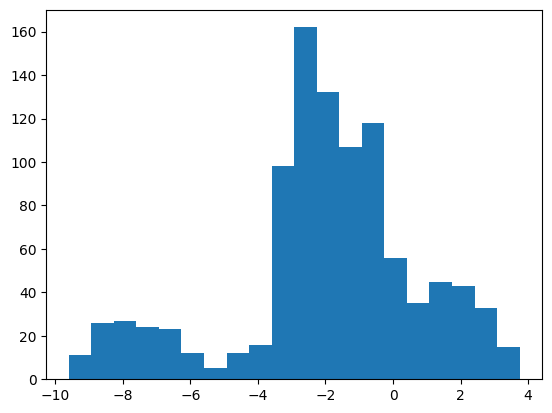

Accuracy: 0.5870000123977661


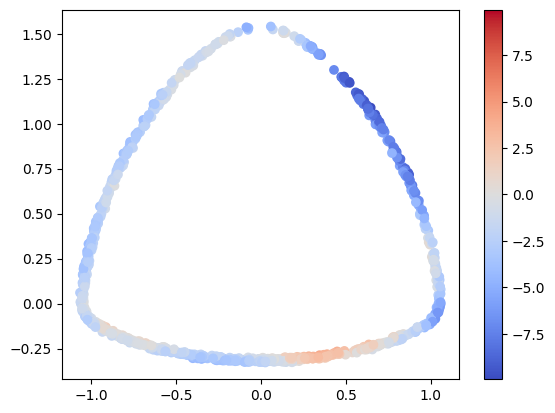

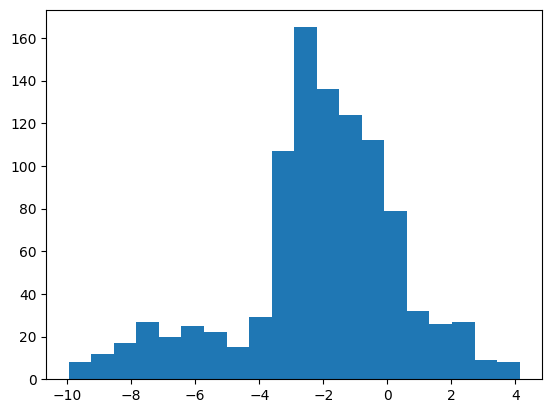

Accuracy: 0.6349999904632568


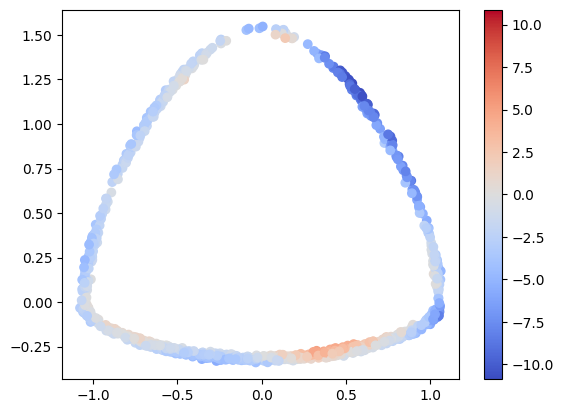

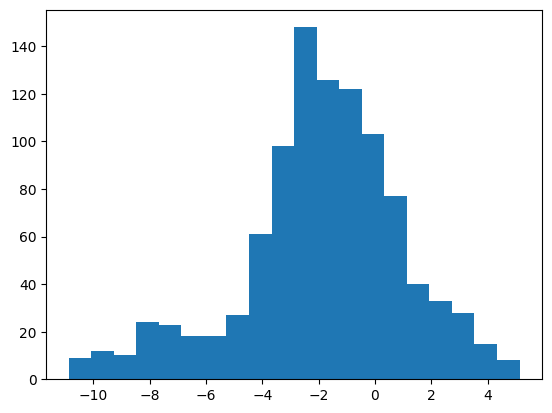

Accuracy: 0.6129999756813049


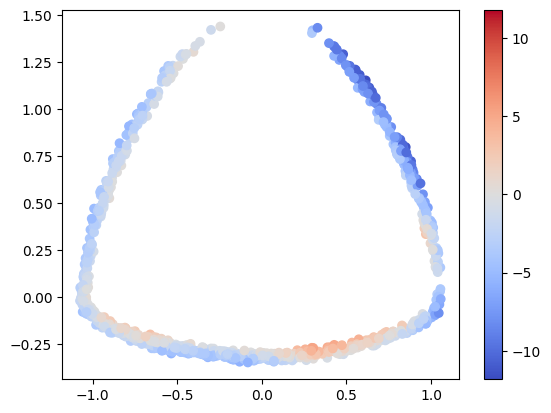

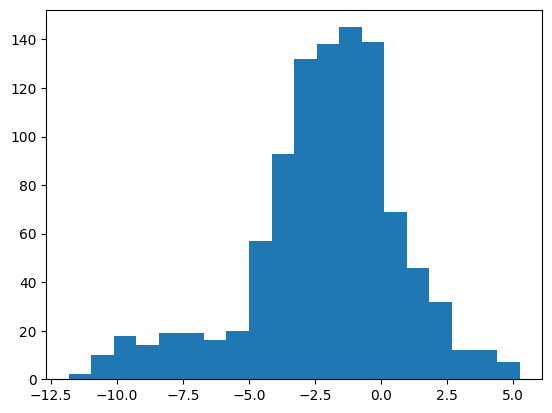

Accuracy: 0.6399999856948853


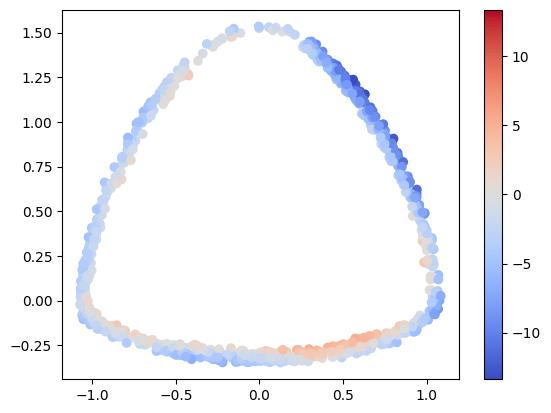

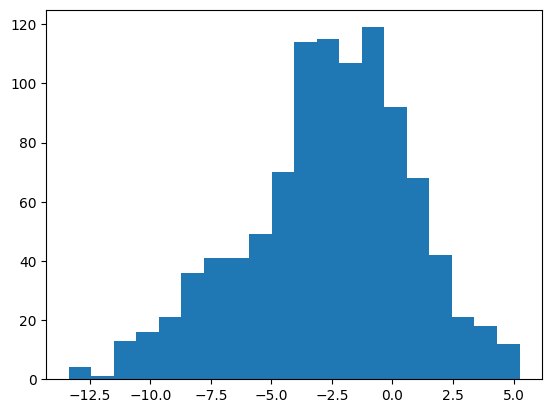

Accuracy: 0.7559999823570251


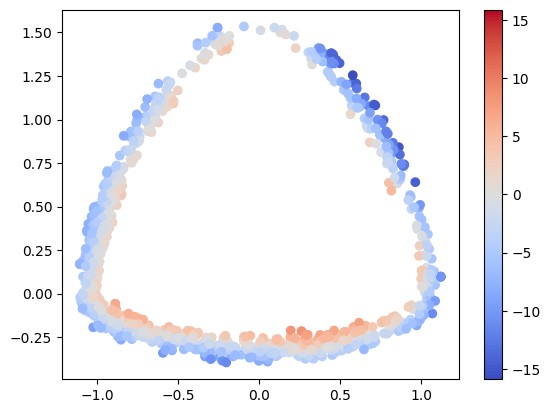

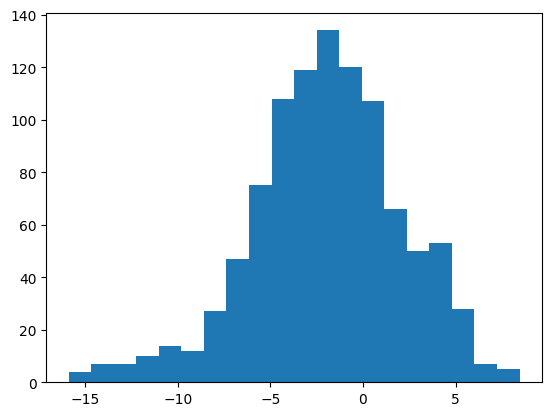

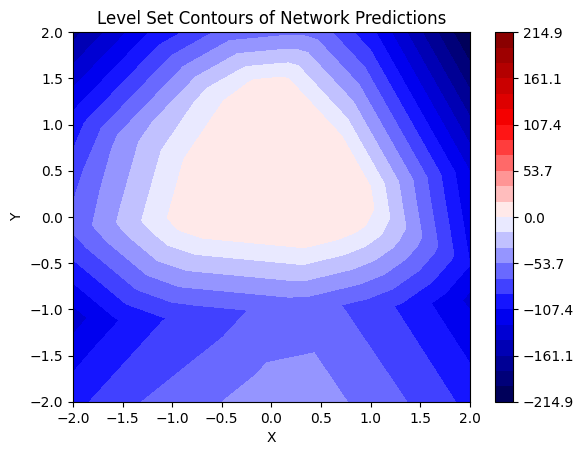

In [72]:
dataset_train_copy = deepcopy(dataset_train)
net_6 = Net()
train_model_dynamical_adaptive(net_6, dataset_train_copy, dataset_validation_uniform, dataset_validation_near_001, dataset_validation_near_002, dataset_validation_near_003,
                    dataset_validation_near_004, dataset_validation_near_005, dataset_validation_near_010, batchsize=64, epochs=1000, lr=0.0005, iterations=15)

Accuracy: 0.968999981880188


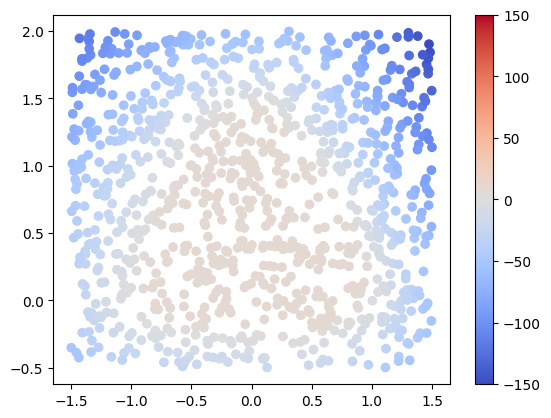

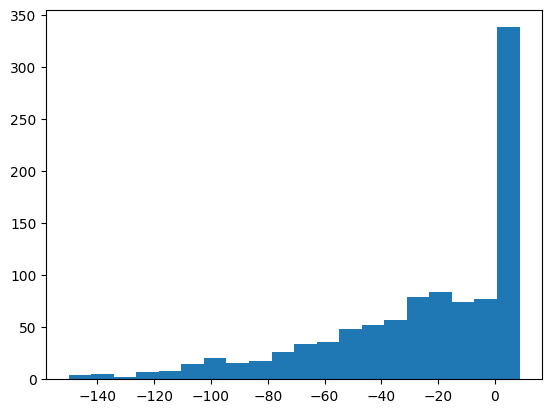

tensor(0.9690)

In [81]:
test_model(net_6, dataset_test_uniform)

Accuracy: 0.5239999890327454


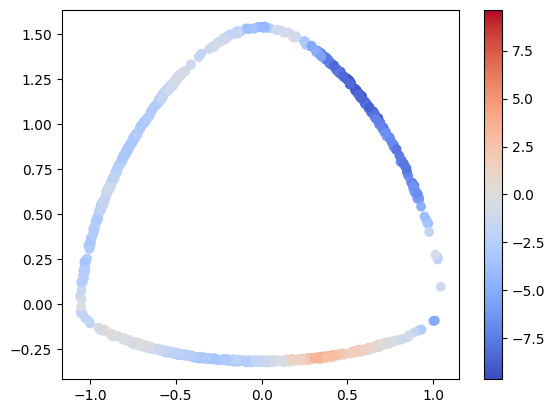

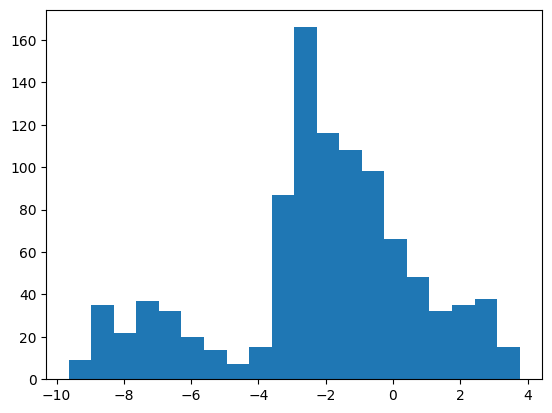

tensor(0.5240)

In [82]:
test_model(net_6, dataset_test_near_001)

Accuracy: 0.5590000152587891


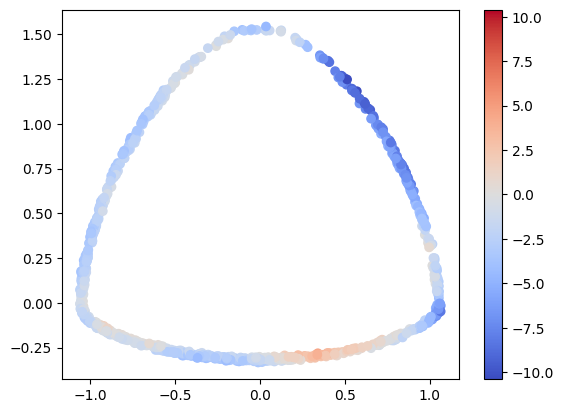

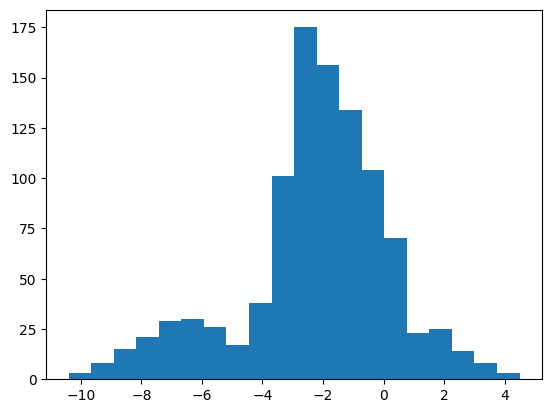

tensor(0.5590)

In [83]:
test_model(net_6, dataset_test_near_002)

Accuracy: 0.5899999737739563


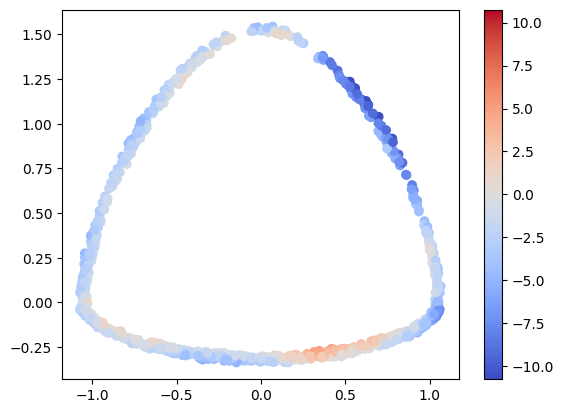

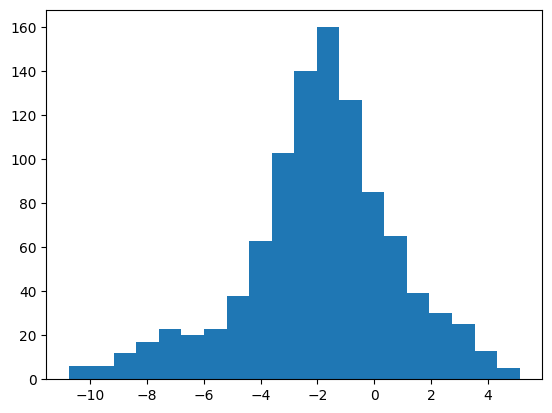

tensor(0.5900)

In [84]:
test_model(net_6, dataset_test_near_003)

Accuracy: 0.6349999904632568


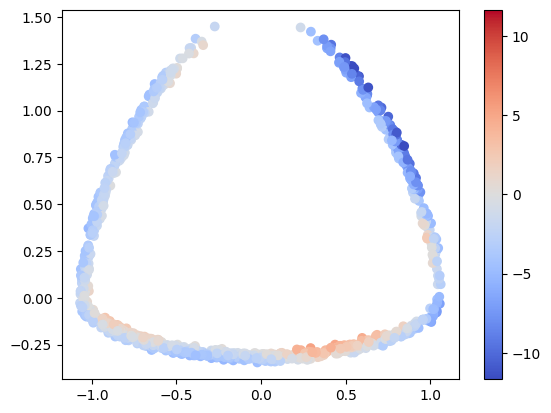

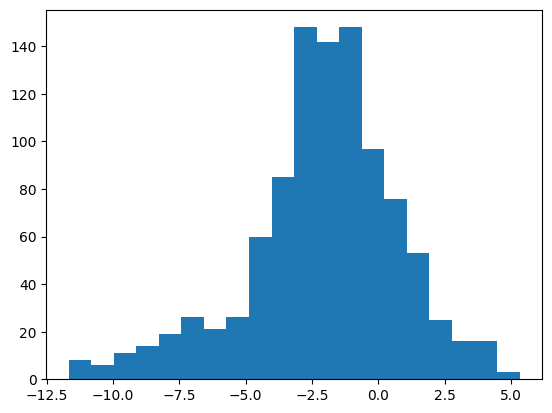

tensor(0.6350)

In [85]:
test_model(net_6, dataset_test_near_004)

Accuracy: 0.6660000085830688


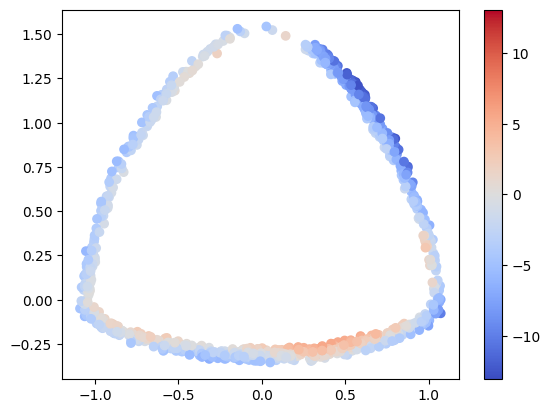

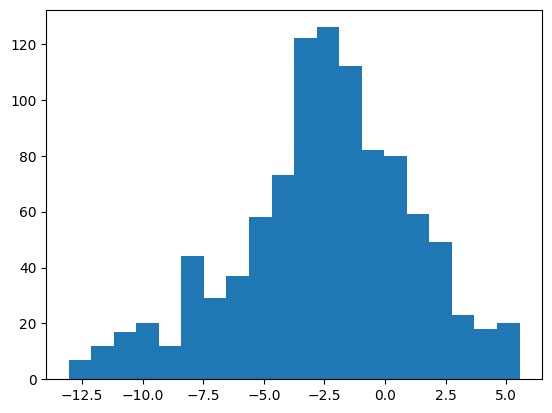

tensor(0.6660)

In [86]:
test_model(net_6, dataset_test_near_005)

Accuracy: 0.796999990940094


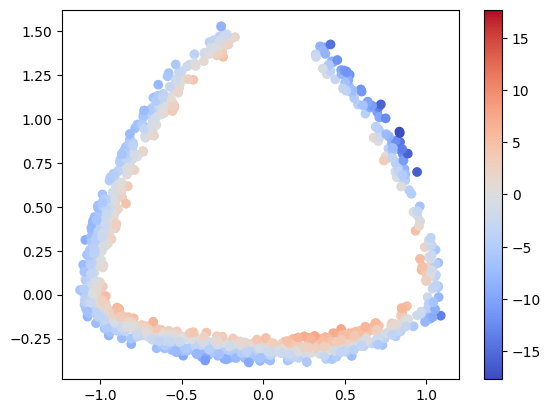

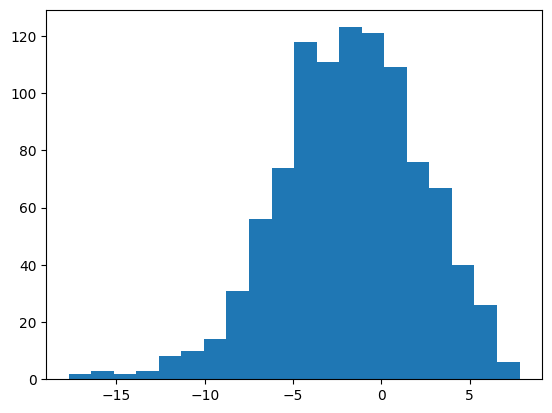

tensor(0.7970)

In [87]:
test_model(net_6, dataset_test_near_010)

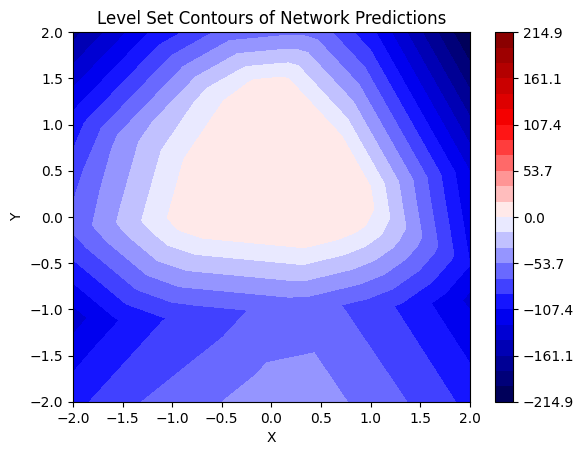

In [88]:
plot_contour(net_6)